# XGBoost

### Librerías

In [1]:
import pandas as pd
import numpy as np
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score as r2
from sklearn.metrics import mean_squared_error as rmse
from sklearn.metrics import mean_absolute_error as mae
from sklearn import preprocessing

### Funciones

In [2]:
# Formatea las variables de tal forma que las pueda admitir la ANN
def fix_parameters(X, m, delta):
    left_stop = (m + delta)
    tam = X.size - left_stop
    i = X.size - 1
    X_fixed = []
    y_fixed = []
    while i >= left_stop:
        X_fixed = np.append(X_fixed, X[(i + 1 - left_stop):(i + 1) - delta])
        y_fixed = np.append(y_fixed, X[i])
        i = i - 1
    X_fixed = np.reshape(X_fixed, (tam, m))
  
    return X_fixed, y_fixed

In [3]:
#Obtiene los parametros optimos para nuestro algoritmo
def find_optimal_algorithm(md_values, eta_values, dtrain, dtest):
    # Parametros fijos del algoritmo
    evallist = [(dtrain, 'train'), (dtest, 'eval')]
    num_round = 250
    # Cuanto menor sea el valor de best_score, más preciso será nuestro algoritmo
    best_score = 1000
    # Valores por defecto tanto del max_depth como del eta
    optimal_md = 6
    optimal_eta = 0.3
    # Algoritmo con la mejor puntuacion
    best_alg = 0
    for md in md_values:
        for eta in eta_values:
            # Establecemos la nueva configuracion de los parametros del algoritmo
            param = {'max_depth': md, 'eta': eta, 'eval_metric' : 'rmse'}
            # Entrenamos el algoritmo
            aux = xgb.train(param, dtrain, num_round, evallist, early_stopping_rounds=5)
            # Predecimos los resultados de los valores de test
            y_predicted = aux.predict(dtest)
            # Si la puntuación es mejor que la que tenemos, la sobreescribimos
            if aux.best_score < best_score:
                best_score = aux.best_score
                optimal_md = md
                optimal_eta = eta
                best_alg = aux
    print("Best Max. Depth: ", optimal_md, ", Best ETA: ", optimal_eta,  ",Best RMSE: ", best_score)
    return best_alg

In [4]:
# Mostramos la tabla comparativa entre los valores originales y los predichos
def print_comparative_plot(m, delta, y, pred):
    plt.figure(num= str(m) +", "+ str(delta), figsize=(40, 10))
    plt.suptitle("M: " + str(m) +", Delta: "+ str(delta))
    plt.plot(range(y.size), np.flip(y), c="b")
    plt.plot(range(pred.size), np.flip(pred), c="r")            
    plt.show()

In [5]:
# Mostrar la gráfica con la evolución de los errores
def print_error_plot(m, delta, y, pred):
    plt.figure(num= "Error: " + str(m) +", "+ str(delta), figsize=(40, 10))
    plt.suptitle("Error para M: " + str(m) +", Delta: "+ str(delta))
    plt.plot(range(y.size), np.flip(np.abs(np.subtract(y, pred))), c="g")
    plt.show()

### Preprocesamos los datos 

In [6]:
# Extraemos los datos del .csv
col_list = ["Wind Speed (m/s)", "LV ActivePower (kW)", "Wind Direction (°)"] # "Wind Speed (m/s)", "LV ActivePower (kW)", "Wind Direction (°)"
# Tan solo escogemos los datos medidos cada 20 minutos
data = pd.read_csv('dataset.csv', usecols=col_list, encoding='utf-8', skiprows=lambda x: (x != 0) and not x % 2)

data

,LV ActivePower (kW),Wind Speed (m/s),Wind Direction (°)
0,380.047791,5.311336,259.994904
1,306.376587,5.216037,272.564789
2,380.650696,5.577941,265.674286
3,447.605713,5.793008,266.163605
4,463.651215,5.584629,253.480698
...,...,...,...
25260,2771.110107,10.154550,82.335197
25261,3455.282959,12.195660,82.210617
25262,3514.269043,12.559170,80.495262
25263,1684.353027,7.332648,84.062599


### Establecemos los parámetros 

In [11]:
# Definimos el porcentaje de division d los datasets de train y test
test_size = 0.4
# Definimos los parametros de tiempo 
m_values = np.array([72, 216, 504]) # 1, 3 días
delta_values = np.array([3, 18, 36, 72]) # 1 hora, 12 horas y 1 día
# Definimos los parametros del algoritmo
eta_values = np.arange(0, 1, 0.1)
md_values = np.arange(0, 10, 1)

In [12]:
# Configuramos el tamaño de las gráficas
plt.rcParams["figure.figsize"] = (90, 10)

### Ejecutamos el código para cada columna del dataset

LV ActivePower (kW)
[0]	train-rmse:1.11891	eval-rmse:1.03630
[1]	train-rmse:1.11891	eval-rmse:1.03630
[2]	train-rmse:1.11891	eval-rmse:1.03630
[3]	train-rmse:1.11891	eval-rmse:1.03630
[4]	train-rmse:1.11891	eval-rmse:1.03630
[5]	train-rmse:1.11891	eval-rmse:1.03630
[0]	train-rmse:1.09732	eval-rmse:1.02917
[1]	train-rmse:1.07952	eval-rmse:1.02483
[2]	train-rmse:1.06488	eval-rmse:1.02260
[3]	train-rmse:1.05288	eval-rmse:1.02198
[4]	train-rmse:1.04305	eval-rmse:1.02254
[5]	train-rmse:1.03502	eval-rmse:1.02395
[6]	train-rmse:1.02848	eval-rmse:1.02594
[7]	train-rmse:1.02314	eval-rmse:1.02833
[8]	train-rmse:1.01880	eval-rmse:1.03095
[0]	train-rmse:1.07764	eval-rmse:1.02446
[1]	train-rmse:1.05038	eval-rmse:1.02202
[2]	train-rmse:1.03256	eval-rmse:1.02460
[3]	train-rmse:1.02098	eval-rmse:1.02954
[4]	train-rmse:1.01351	eval-rmse:1.03532
[5]	train-rmse:1.00869	eval-rmse:1.04109
[0]	train-rmse:1.05997	eval-rmse:1.02220
[1]	train-rmse:1.02986	eval-rmse:1.02544
[2]	train-rmse:1.01479	eval-rmse:1.03

[3]	train-rmse:0.55571	eval-rmse:0.52816
[4]	train-rmse:0.50949	eval-rmse:0.48079
[5]	train-rmse:0.48119	eval-rmse:0.45709
[6]	train-rmse:0.45992	eval-rmse:0.43342
[7]	train-rmse:0.44730	eval-rmse:0.41993
[8]	train-rmse:0.43808	eval-rmse:0.41100
[9]	train-rmse:0.43243	eval-rmse:0.40477
[10]	train-rmse:0.42839	eval-rmse:0.40042
[11]	train-rmse:0.42569	eval-rmse:0.39654
[12]	train-rmse:0.42386	eval-rmse:0.39430
[13]	train-rmse:0.42247	eval-rmse:0.39290
[14]	train-rmse:0.42146	eval-rmse:0.39132
[15]	train-rmse:0.42071	eval-rmse:0.39006
[16]	train-rmse:0.42018	eval-rmse:0.38975
[17]	train-rmse:0.41976	eval-rmse:0.38916
[18]	train-rmse:0.41940	eval-rmse:0.38901
[19]	train-rmse:0.41908	eval-rmse:0.38888
[20]	train-rmse:0.41883	eval-rmse:0.38856
[21]	train-rmse:0.41863	eval-rmse:0.38849
[22]	train-rmse:0.41844	eval-rmse:0.38830
[23]	train-rmse:0.41825	eval-rmse:0.38854
[24]	train-rmse:0.41805	eval-rmse:0.38818
[25]	train-rmse:0.41790	eval-rmse:0.38833
[26]	train-rmse:0.41776	eval-rmse:0.38794

[27]	train-rmse:0.42436	eval-rmse:0.39861
[28]	train-rmse:0.42388	eval-rmse:0.39698
[29]	train-rmse:0.42354	eval-rmse:0.39753
[30]	train-rmse:0.42319	eval-rmse:0.39613
[31]	train-rmse:0.42289	eval-rmse:0.39655
[32]	train-rmse:0.42262	eval-rmse:0.39708
[33]	train-rmse:0.42227	eval-rmse:0.39571
[34]	train-rmse:0.42200	eval-rmse:0.39625
[35]	train-rmse:0.42170	eval-rmse:0.39574
[36]	train-rmse:0.42145	eval-rmse:0.39602
[37]	train-rmse:0.42124	eval-rmse:0.39535
[38]	train-rmse:0.42101	eval-rmse:0.39528
[39]	train-rmse:0.42081	eval-rmse:0.39504
[40]	train-rmse:0.42063	eval-rmse:0.39534
[41]	train-rmse:0.42035	eval-rmse:0.39420
[42]	train-rmse:0.42013	eval-rmse:0.39471
[43]	train-rmse:0.41986	eval-rmse:0.39355
[44]	train-rmse:0.41966	eval-rmse:0.39405
[45]	train-rmse:0.41944	eval-rmse:0.39317
[46]	train-rmse:0.41923	eval-rmse:0.39345
[47]	train-rmse:0.41903	eval-rmse:0.39254
[48]	train-rmse:0.41884	eval-rmse:0.39304
[49]	train-rmse:0.41865	eval-rmse:0.39213
[50]	train-rmse:0.41847	eval-rmse:

[14]	train-rmse:0.47399	eval-rmse:0.44207
[15]	train-rmse:0.46349	eval-rmse:0.43170
[16]	train-rmse:0.45441	eval-rmse:0.42331
[17]	train-rmse:0.44667	eval-rmse:0.41630
[18]	train-rmse:0.44028	eval-rmse:0.41014
[19]	train-rmse:0.43473	eval-rmse:0.40544
[20]	train-rmse:0.43023	eval-rmse:0.40086
[21]	train-rmse:0.42603	eval-rmse:0.39721
[22]	train-rmse:0.42285	eval-rmse:0.39402
[23]	train-rmse:0.41985	eval-rmse:0.39138
[24]	train-rmse:0.41728	eval-rmse:0.38935
[25]	train-rmse:0.41534	eval-rmse:0.38733
[26]	train-rmse:0.41349	eval-rmse:0.38586
[27]	train-rmse:0.41186	eval-rmse:0.38451
[28]	train-rmse:0.41056	eval-rmse:0.38360
[29]	train-rmse:0.40937	eval-rmse:0.38272
[30]	train-rmse:0.40843	eval-rmse:0.38178
[31]	train-rmse:0.40750	eval-rmse:0.38099
[32]	train-rmse:0.40673	eval-rmse:0.38045
[33]	train-rmse:0.40609	eval-rmse:0.37991
[34]	train-rmse:0.40552	eval-rmse:0.37941
[35]	train-rmse:0.40502	eval-rmse:0.37906
[36]	train-rmse:0.40457	eval-rmse:0.37861
[37]	train-rmse:0.40403	eval-rmse:

[9]	train-rmse:0.54265	eval-rmse:0.51437
[10]	train-rmse:0.51812	eval-rmse:0.49206
[11]	train-rmse:0.49720	eval-rmse:0.47347
[12]	train-rmse:0.47953	eval-rmse:0.45803
[13]	train-rmse:0.46442	eval-rmse:0.44452
[14]	train-rmse:0.45162	eval-rmse:0.43336
[15]	train-rmse:0.44073	eval-rmse:0.42374
[16]	train-rmse:0.43181	eval-rmse:0.41592
[17]	train-rmse:0.42412	eval-rmse:0.40962
[18]	train-rmse:0.41765	eval-rmse:0.40417
[19]	train-rmse:0.41211	eval-rmse:0.39962
[20]	train-rmse:0.40741	eval-rmse:0.39585
[21]	train-rmse:0.40332	eval-rmse:0.39273
[22]	train-rmse:0.39989	eval-rmse:0.39017
[23]	train-rmse:0.39689	eval-rmse:0.38798
[24]	train-rmse:0.39430	eval-rmse:0.38614
[25]	train-rmse:0.39196	eval-rmse:0.38487
[26]	train-rmse:0.38995	eval-rmse:0.38374
[27]	train-rmse:0.38814	eval-rmse:0.38253
[28]	train-rmse:0.38649	eval-rmse:0.38157
[29]	train-rmse:0.38514	eval-rmse:0.38083
[30]	train-rmse:0.38375	eval-rmse:0.38038
[31]	train-rmse:0.38270	eval-rmse:0.37999
[32]	train-rmse:0.38168	eval-rmse:0

[4]	train-rmse:0.51939	eval-rmse:0.50143
[5]	train-rmse:0.47436	eval-rmse:0.46274
[6]	train-rmse:0.44191	eval-rmse:0.43641
[7]	train-rmse:0.41959	eval-rmse:0.41754
[8]	train-rmse:0.40315	eval-rmse:0.40467
[9]	train-rmse:0.39170	eval-rmse:0.39635
[10]	train-rmse:0.38320	eval-rmse:0.39092
[11]	train-rmse:0.37667	eval-rmse:0.38726
[12]	train-rmse:0.37151	eval-rmse:0.38469
[13]	train-rmse:0.36732	eval-rmse:0.38336
[14]	train-rmse:0.36462	eval-rmse:0.38216
[15]	train-rmse:0.36249	eval-rmse:0.38144
[16]	train-rmse:0.35920	eval-rmse:0.38171
[17]	train-rmse:0.35737	eval-rmse:0.38152
[18]	train-rmse:0.35538	eval-rmse:0.38115
[19]	train-rmse:0.35418	eval-rmse:0.38095
[20]	train-rmse:0.35254	eval-rmse:0.38076
[21]	train-rmse:0.35126	eval-rmse:0.38071
[22]	train-rmse:0.34871	eval-rmse:0.38106
[23]	train-rmse:0.34758	eval-rmse:0.38122
[24]	train-rmse:0.34669	eval-rmse:0.38119
[25]	train-rmse:0.34562	eval-rmse:0.38130
[26]	train-rmse:0.34481	eval-rmse:0.38131
[0]	train-rmse:0.83339	eval-rmse:0.77941

[2]	train-rmse:0.38798	eval-rmse:0.41096
[3]	train-rmse:0.36475	eval-rmse:0.39694
[4]	train-rmse:0.34855	eval-rmse:0.39436
[5]	train-rmse:0.34011	eval-rmse:0.39419
[6]	train-rmse:0.33443	eval-rmse:0.39560
[7]	train-rmse:0.33069	eval-rmse:0.39691
[8]	train-rmse:0.32860	eval-rmse:0.39682
[9]	train-rmse:0.32067	eval-rmse:0.39881
[0]	train-rmse:0.57091	eval-rmse:0.55419
[1]	train-rmse:0.41007	eval-rmse:0.42213
[2]	train-rmse:0.36758	eval-rmse:0.39797
[3]	train-rmse:0.35196	eval-rmse:0.39477
[4]	train-rmse:0.34394	eval-rmse:0.39497
[5]	train-rmse:0.33767	eval-rmse:0.39537
[6]	train-rmse:0.33627	eval-rmse:0.39602
[7]	train-rmse:0.33512	eval-rmse:0.39610
[0]	train-rmse:0.49859	eval-rmse:0.49260
[1]	train-rmse:0.38221	eval-rmse:0.40654
[2]	train-rmse:0.35883	eval-rmse:0.39985
[3]	train-rmse:0.34692	eval-rmse:0.40471
[4]	train-rmse:0.33983	eval-rmse:0.40700
[5]	train-rmse:0.33638	eval-rmse:0.40847
[6]	train-rmse:0.33342	eval-rmse:0.40909
[0]	train-rmse:0.43958	eval-rmse:0.44305
[1]	train-rmse:0

[26]	train-rmse:0.28552	eval-rmse:0.39347
[27]	train-rmse:0.28212	eval-rmse:0.39262
[28]	train-rmse:0.27834	eval-rmse:0.39210
[29]	train-rmse:0.27462	eval-rmse:0.39171
[30]	train-rmse:0.27154	eval-rmse:0.39121
[31]	train-rmse:0.26849	eval-rmse:0.39100
[32]	train-rmse:0.26516	eval-rmse:0.39079
[33]	train-rmse:0.26197	eval-rmse:0.39117
[34]	train-rmse:0.25966	eval-rmse:0.39110
[35]	train-rmse:0.25687	eval-rmse:0.39096
[36]	train-rmse:0.25451	eval-rmse:0.39086
[37]	train-rmse:0.25306	eval-rmse:0.39090
[0]	train-rmse:0.92105	eval-rmse:0.86285
[1]	train-rmse:0.76693	eval-rmse:0.72868
[2]	train-rmse:0.64740	eval-rmse:0.62880
[3]	train-rmse:0.55543	eval-rmse:0.55565
[4]	train-rmse:0.48501	eval-rmse:0.50344
[5]	train-rmse:0.43234	eval-rmse:0.46671
[6]	train-rmse:0.39285	eval-rmse:0.44094
[7]	train-rmse:0.36192	eval-rmse:0.42379
[8]	train-rmse:0.34008	eval-rmse:0.41217
[9]	train-rmse:0.32379	eval-rmse:0.40406
[10]	train-rmse:0.30963	eval-rmse:0.39963
[11]	train-rmse:0.29855	eval-rmse:0.39671
[1

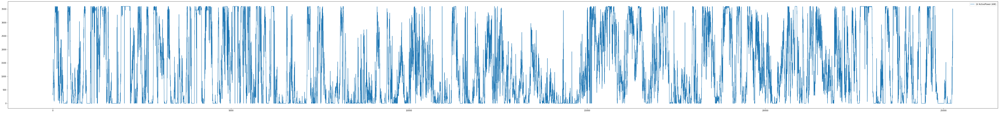

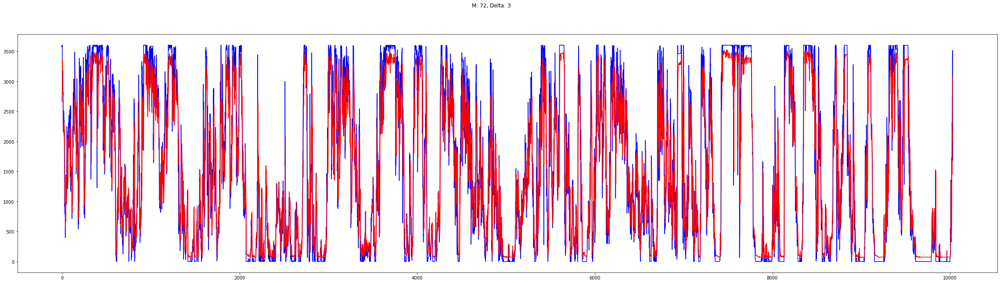

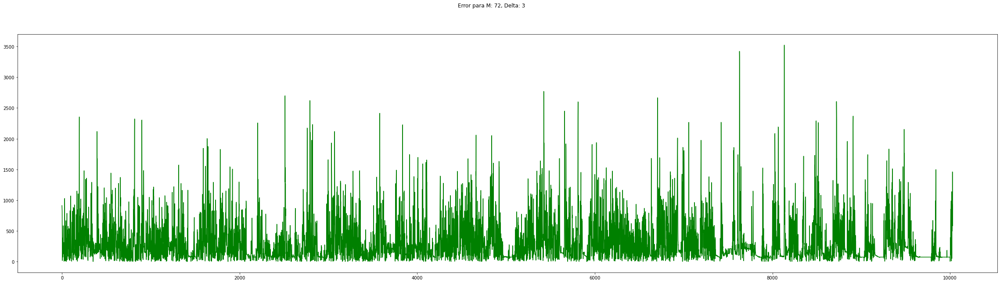

[0]	train-rmse:1.11866	eval-rmse:1.03627
[1]	train-rmse:1.11866	eval-rmse:1.03627
[2]	train-rmse:1.11866	eval-rmse:1.03627
[3]	train-rmse:1.11866	eval-rmse:1.03627
[4]	train-rmse:1.11866	eval-rmse:1.03627
[5]	train-rmse:1.11866	eval-rmse:1.03627
[0]	train-rmse:1.09691	eval-rmse:1.02904
[1]	train-rmse:1.07897	eval-rmse:1.02461
[2]	train-rmse:1.06422	eval-rmse:1.02232
[3]	train-rmse:1.05212	eval-rmse:1.02166
[4]	train-rmse:1.04221	eval-rmse:1.02218
[5]	train-rmse:1.03411	eval-rmse:1.02357
[6]	train-rmse:1.02751	eval-rmse:1.02555
[7]	train-rmse:1.02214	eval-rmse:1.02793
[0]	train-rmse:1.07707	eval-rmse:1.02424
[1]	train-rmse:1.04960	eval-rmse:1.02169
[2]	train-rmse:1.03162	eval-rmse:1.02422
[3]	train-rmse:1.01996	eval-rmse:1.02914
[4]	train-rmse:1.01242	eval-rmse:1.03492
[5]	train-rmse:1.00757	eval-rmse:1.04070
[0]	train-rmse:1.05926	eval-rmse:1.02190
[1]	train-rmse:1.02891	eval-rmse:1.02506
[2]	train-rmse:1.01370	eval-rmse:1.03372
[3]	train-rmse:1.00617	eval-rmse:1.04287
[4]	train-rmse:1

[30]	train-rmse:0.71708	eval-rmse:0.73979
[31]	train-rmse:0.71631	eval-rmse:0.73975
[32]	train-rmse:0.71548	eval-rmse:0.73963
[33]	train-rmse:0.71493	eval-rmse:0.73922
[34]	train-rmse:0.71439	eval-rmse:0.73960
[35]	train-rmse:0.71364	eval-rmse:0.73945
[36]	train-rmse:0.71307	eval-rmse:0.73931
[37]	train-rmse:0.71258	eval-rmse:0.73968
[0]	train-rmse:0.99932	eval-rmse:0.94169
[1]	train-rmse:0.91415	eval-rmse:0.87564
[2]	train-rmse:0.85423	eval-rmse:0.82945
[3]	train-rmse:0.81211	eval-rmse:0.79845
[4]	train-rmse:0.78356	eval-rmse:0.77920
[5]	train-rmse:0.76415	eval-rmse:0.76568
[6]	train-rmse:0.75071	eval-rmse:0.75638
[7]	train-rmse:0.74153	eval-rmse:0.75113
[8]	train-rmse:0.73484	eval-rmse:0.74775
[9]	train-rmse:0.72994	eval-rmse:0.74446
[10]	train-rmse:0.72654	eval-rmse:0.74228
[11]	train-rmse:0.72364	eval-rmse:0.74194
[12]	train-rmse:0.72101	eval-rmse:0.74165
[13]	train-rmse:0.71929	eval-rmse:0.74050
[14]	train-rmse:0.71745	eval-rmse:0.74019
[15]	train-rmse:0.71608	eval-rmse:0.74037
[1

[2]	train-rmse:0.72604	eval-rmse:0.74532
[3]	train-rmse:0.71406	eval-rmse:0.73953
[4]	train-rmse:0.70631	eval-rmse:0.74025
[5]	train-rmse:0.70329	eval-rmse:0.73918
[6]	train-rmse:0.69952	eval-rmse:0.73956
[7]	train-rmse:0.69727	eval-rmse:0.74223
[8]	train-rmse:0.69626	eval-rmse:0.74273
[9]	train-rmse:0.69343	eval-rmse:0.74187
[0]	train-rmse:0.80504	eval-rmse:0.79511
[1]	train-rmse:0.73543	eval-rmse:0.75396
[2]	train-rmse:0.71689	eval-rmse:0.74661
[3]	train-rmse:0.70879	eval-rmse:0.74501
[4]	train-rmse:0.70363	eval-rmse:0.74504
[5]	train-rmse:0.69874	eval-rmse:0.74757
[6]	train-rmse:0.69636	eval-rmse:0.74809
[7]	train-rmse:0.69341	eval-rmse:0.74929
[8]	train-rmse:0.69139	eval-rmse:0.75003
[0]	train-rmse:0.77317	eval-rmse:0.77277
[1]	train-rmse:0.72599	eval-rmse:0.74812
[2]	train-rmse:0.71368	eval-rmse:0.74738
[3]	train-rmse:0.70835	eval-rmse:0.74687
[4]	train-rmse:0.70312	eval-rmse:0.74543
[5]	train-rmse:0.70100	eval-rmse:0.74679
[6]	train-rmse:0.69657	eval-rmse:0.75245
[7]	train-rmse:0

[5]	train-rmse:0.72359	eval-rmse:0.76418
[6]	train-rmse:0.70679	eval-rmse:0.75573
[7]	train-rmse:0.69302	eval-rmse:0.75077
[8]	train-rmse:0.68190	eval-rmse:0.74807
[9]	train-rmse:0.67383	eval-rmse:0.74625
[10]	train-rmse:0.66737	eval-rmse:0.74547
[11]	train-rmse:0.66173	eval-rmse:0.74537
[12]	train-rmse:0.65737	eval-rmse:0.74396
[13]	train-rmse:0.65293	eval-rmse:0.74539
[14]	train-rmse:0.64969	eval-rmse:0.74597
[15]	train-rmse:0.64545	eval-rmse:0.74640
[16]	train-rmse:0.64289	eval-rmse:0.74796
[17]	train-rmse:0.63974	eval-rmse:0.74806
[0]	train-rmse:0.93153	eval-rmse:0.89862
[1]	train-rmse:0.82051	eval-rmse:0.82209
[2]	train-rmse:0.75525	eval-rmse:0.78024
[3]	train-rmse:0.71696	eval-rmse:0.76165
[4]	train-rmse:0.69532	eval-rmse:0.75267
[5]	train-rmse:0.68086	eval-rmse:0.74765
[6]	train-rmse:0.67041	eval-rmse:0.74693
[7]	train-rmse:0.66056	eval-rmse:0.74621
[8]	train-rmse:0.65322	eval-rmse:0.74775
[9]	train-rmse:0.64634	eval-rmse:0.75081
[10]	train-rmse:0.64243	eval-rmse:0.75385
[11]	tr

[19]	train-rmse:0.58797	eval-rmse:0.75691
[20]	train-rmse:0.58115	eval-rmse:0.75681
[21]	train-rmse:0.57467	eval-rmse:0.75660
[22]	train-rmse:0.56897	eval-rmse:0.75676
[23]	train-rmse:0.56357	eval-rmse:0.75733
[24]	train-rmse:0.55913	eval-rmse:0.75746
[25]	train-rmse:0.55426	eval-rmse:0.75820
[0]	train-rmse:0.98001	eval-rmse:0.94361
[1]	train-rmse:0.87490	eval-rmse:0.87677
[2]	train-rmse:0.79903	eval-rmse:0.82984
[3]	train-rmse:0.74479	eval-rmse:0.80147
[4]	train-rmse:0.69964	eval-rmse:0.78474
[5]	train-rmse:0.66530	eval-rmse:0.77238
[6]	train-rmse:0.63959	eval-rmse:0.76549
[7]	train-rmse:0.62352	eval-rmse:0.76037
[8]	train-rmse:0.60696	eval-rmse:0.75938
[9]	train-rmse:0.59268	eval-rmse:0.75928
[10]	train-rmse:0.57888	eval-rmse:0.76057
[11]	train-rmse:0.56886	eval-rmse:0.76005
[12]	train-rmse:0.56068	eval-rmse:0.76191
[13]	train-rmse:0.55442	eval-rmse:0.76311
[0]	train-rmse:0.91599	eval-rmse:0.90372
[1]	train-rmse:0.78966	eval-rmse:0.82954
[2]	train-rmse:0.71003	eval-rmse:0.79091
[3]	t

[0]	train-rmse:0.96572	eval-rmse:0.94358
[1]	train-rmse:0.84655	eval-rmse:0.88225
[2]	train-rmse:0.75347	eval-rmse:0.83814
[3]	train-rmse:0.67949	eval-rmse:0.81266
[4]	train-rmse:0.62631	eval-rmse:0.80012
[5]	train-rmse:0.58193	eval-rmse:0.79015
[6]	train-rmse:0.54290	eval-rmse:0.78584
[7]	train-rmse:0.51688	eval-rmse:0.78333
[8]	train-rmse:0.49295	eval-rmse:0.78383
[9]	train-rmse:0.47564	eval-rmse:0.78326
[10]	train-rmse:0.45680	eval-rmse:0.78433
[11]	train-rmse:0.44003	eval-rmse:0.78678
[12]	train-rmse:0.42819	eval-rmse:0.78718
[13]	train-rmse:0.42093	eval-rmse:0.78829
[0]	train-rmse:0.89413	eval-rmse:0.90514
[1]	train-rmse:0.74236	eval-rmse:0.83547
[2]	train-rmse:0.64697	eval-rmse:0.79953
[3]	train-rmse:0.57249	eval-rmse:0.78876
[4]	train-rmse:0.52322	eval-rmse:0.78804
[5]	train-rmse:0.48776	eval-rmse:0.78950
[6]	train-rmse:0.46187	eval-rmse:0.79046
[7]	train-rmse:0.44698	eval-rmse:0.79278
[8]	train-rmse:0.43611	eval-rmse:0.79503
[0]	train-rmse:0.82694	eval-rmse:0.87292
[1]	train-rm

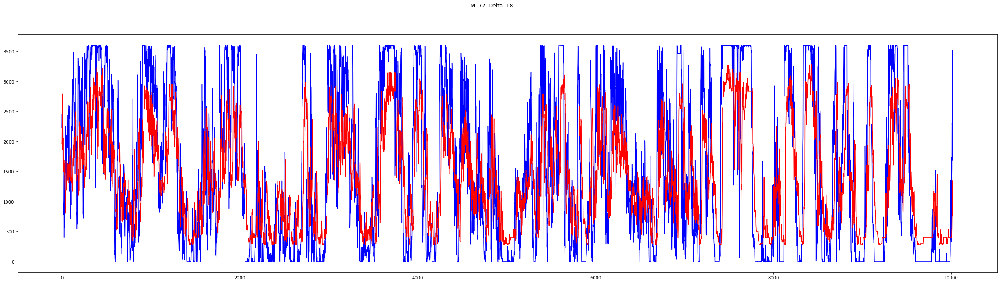

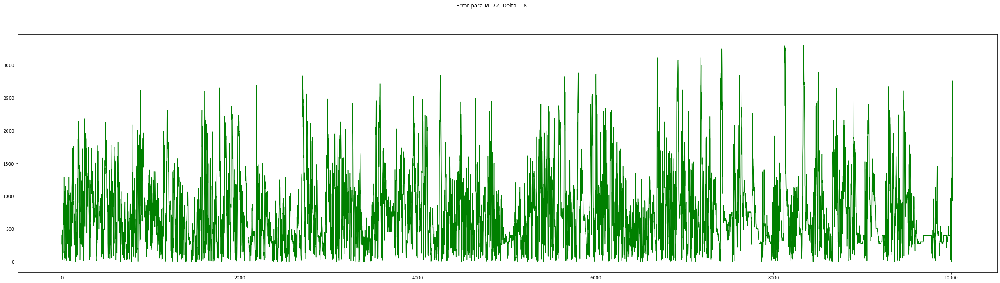

[0]	train-rmse:1.11845	eval-rmse:1.03700
[1]	train-rmse:1.11845	eval-rmse:1.03700
[2]	train-rmse:1.11845	eval-rmse:1.03700
[3]	train-rmse:1.11845	eval-rmse:1.03700
[4]	train-rmse:1.11845	eval-rmse:1.03700
[5]	train-rmse:1.11845	eval-rmse:1.03700
[0]	train-rmse:1.09651	eval-rmse:1.02972
[1]	train-rmse:1.07841	eval-rmse:1.02526
[2]	train-rmse:1.06353	eval-rmse:1.02296
[3]	train-rmse:1.05132	eval-rmse:1.02229
[4]	train-rmse:1.04132	eval-rmse:1.02283
[5]	train-rmse:1.03315	eval-rmse:1.02423
[6]	train-rmse:1.02648	eval-rmse:1.02623
[7]	train-rmse:1.02106	eval-rmse:1.02863
[0]	train-rmse:1.07651	eval-rmse:1.02489
[1]	train-rmse:1.04877	eval-rmse:1.02232
[2]	train-rmse:1.03064	eval-rmse:1.02488
[3]	train-rmse:1.01886	eval-rmse:1.02986
[4]	train-rmse:1.01125	eval-rmse:1.03568
[5]	train-rmse:1.00635	eval-rmse:1.04151
[6]	train-rmse:1.00320	eval-rmse:1.04690
[0]	train-rmse:1.05853	eval-rmse:1.02253
[1]	train-rmse:1.02790	eval-rmse:1.02573
[2]	train-rmse:1.01255	eval-rmse:1.03447
[3]	train-rmse:1

[11]	train-rmse:0.85415	eval-rmse:0.90164
[12]	train-rmse:0.85335	eval-rmse:0.90450
[0]	train-rmse:0.90933	eval-rmse:0.92997
[1]	train-rmse:0.88209	eval-rmse:0.91284
[2]	train-rmse:0.87443	eval-rmse:0.90916
[3]	train-rmse:0.87160	eval-rmse:0.91365
[4]	train-rmse:0.86799	eval-rmse:0.90804
[5]	train-rmse:0.86457	eval-rmse:0.90717
[6]	train-rmse:0.86181	eval-rmse:0.90522
[7]	train-rmse:0.86016	eval-rmse:0.90849
[8]	train-rmse:0.85855	eval-rmse:0.90383
[9]	train-rmse:0.85690	eval-rmse:0.90469
[10]	train-rmse:0.85476	eval-rmse:0.90343
[11]	train-rmse:0.85417	eval-rmse:0.90633
[12]	train-rmse:0.85317	eval-rmse:0.90383
[13]	train-rmse:0.85235	eval-rmse:0.90482
[14]	train-rmse:0.85140	eval-rmse:0.90421
[0]	train-rmse:0.90201	eval-rmse:0.93420
[1]	train-rmse:0.88231	eval-rmse:0.91378
[2]	train-rmse:0.87647	eval-rmse:0.91080
[3]	train-rmse:0.87284	eval-rmse:0.91514
[4]	train-rmse:0.87031	eval-rmse:0.91347
[5]	train-rmse:0.86573	eval-rmse:0.91267
[6]	train-rmse:0.86241	eval-rmse:0.90639
[7]	train

[6]	train-rmse:0.87809	eval-rmse:0.91592
[7]	train-rmse:0.85970	eval-rmse:0.91080
[8]	train-rmse:0.84317	eval-rmse:0.90754
[9]	train-rmse:0.82917	eval-rmse:0.90449
[10]	train-rmse:0.81696	eval-rmse:0.90348
[11]	train-rmse:0.80624	eval-rmse:0.90243
[12]	train-rmse:0.79675	eval-rmse:0.90168
[13]	train-rmse:0.78681	eval-rmse:0.90132
[14]	train-rmse:0.78000	eval-rmse:0.90132
[15]	train-rmse:0.77190	eval-rmse:0.90243
[16]	train-rmse:0.76441	eval-rmse:0.90406
[17]	train-rmse:0.75807	eval-rmse:0.90456
[18]	train-rmse:0.75365	eval-rmse:0.90574
[19]	train-rmse:0.74826	eval-rmse:0.90575
[0]	train-rmse:1.01849	eval-rmse:0.98059
[1]	train-rmse:0.94556	eval-rmse:0.94426
[2]	train-rmse:0.89336	eval-rmse:0.92185
[3]	train-rmse:0.85462	eval-rmse:0.91087
[4]	train-rmse:0.82514	eval-rmse:0.90497
[5]	train-rmse:0.80236	eval-rmse:0.90333
[6]	train-rmse:0.78395	eval-rmse:0.90296
[7]	train-rmse:0.76960	eval-rmse:0.90594
[8]	train-rmse:0.75837	eval-rmse:0.90646
[9]	train-rmse:0.74832	eval-rmse:0.90832
[10]	t

[0]	train-rmse:0.82089	eval-rmse:0.93492
[1]	train-rmse:0.71662	eval-rmse:0.94494
[2]	train-rmse:0.66000	eval-rmse:0.96493
[3]	train-rmse:0.63845	eval-rmse:0.97696
[4]	train-rmse:0.62826	eval-rmse:0.98193
[5]	train-rmse:0.59930	eval-rmse:0.98864
[0]	train-rmse:0.79056	eval-rmse:0.93771
[1]	train-rmse:0.68146	eval-rmse:0.97767
[2]	train-rmse:0.64652	eval-rmse:1.00246
[3]	train-rmse:0.64057	eval-rmse:1.00340
[4]	train-rmse:0.63230	eval-rmse:1.00980
[5]	train-rmse:0.62154	eval-rmse:1.01086
[0]	train-rmse:0.76786	eval-rmse:0.94638
[1]	train-rmse:0.68230	eval-rmse:0.97257
[2]	train-rmse:0.65721	eval-rmse:0.99066
[3]	train-rmse:0.65348	eval-rmse:0.99235
[4]	train-rmse:0.64037	eval-rmse:0.99889
[5]	train-rmse:0.63615	eval-rmse:1.00097
[0]	train-rmse:0.75350	eval-rmse:0.96075
[1]	train-rmse:0.67670	eval-rmse:1.01429
[2]	train-rmse:0.67209	eval-rmse:1.01657
[3]	train-rmse:0.66257	eval-rmse:1.01491
[4]	train-rmse:0.64622	eval-rmse:1.02421
[0]	train-rmse:1.11845	eval-rmse:1.03700
[1]	train-rmse:1

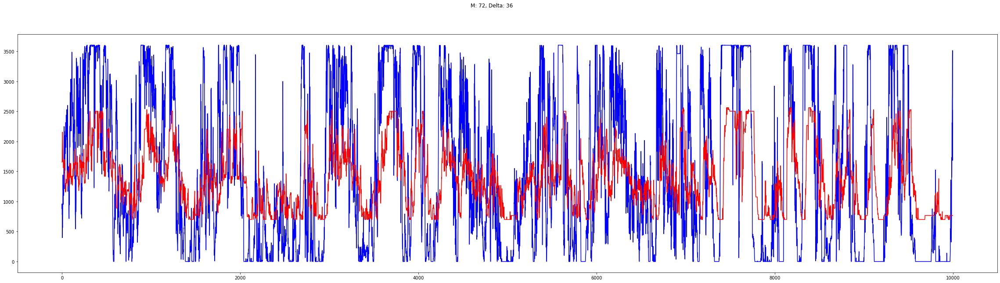

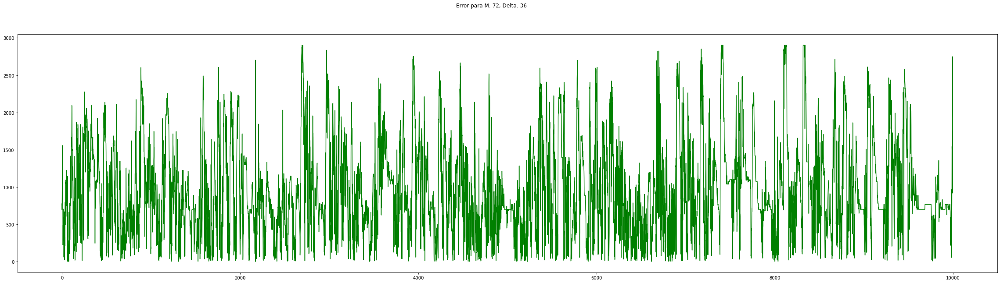

[0]	train-rmse:1.11856	eval-rmse:1.03840
[1]	train-rmse:1.11856	eval-rmse:1.03840
[2]	train-rmse:1.11856	eval-rmse:1.03840
[3]	train-rmse:1.11856	eval-rmse:1.03840
[4]	train-rmse:1.11856	eval-rmse:1.03840
[5]	train-rmse:1.11856	eval-rmse:1.03840
[0]	train-rmse:1.09632	eval-rmse:1.03113
[1]	train-rmse:1.07798	eval-rmse:1.02670
[2]	train-rmse:1.06289	eval-rmse:1.02445
[3]	train-rmse:1.05050	eval-rmse:1.02384
[4]	train-rmse:1.04037	eval-rmse:1.02444
[5]	train-rmse:1.03208	eval-rmse:1.02591
[6]	train-rmse:1.02532	eval-rmse:1.02799
[7]	train-rmse:1.01981	eval-rmse:1.03046
[8]	train-rmse:1.01533	eval-rmse:1.03317
[0]	train-rmse:1.07604	eval-rmse:1.02633
[1]	train-rmse:1.04793	eval-rmse:1.02389
[2]	train-rmse:1.02953	eval-rmse:1.02659
[3]	train-rmse:1.01758	eval-rmse:1.03172
[4]	train-rmse:1.00986	eval-rmse:1.03769
[5]	train-rmse:1.00488	eval-rmse:1.04364
[6]	train-rmse:1.00169	eval-rmse:1.04914
[0]	train-rmse:1.05782	eval-rmse:1.02404
[1]	train-rmse:1.02675	eval-rmse:1.02747
[2]	train-rmse:1

[0]	train-rmse:0.94523	eval-rmse:0.99090
[1]	train-rmse:0.93718	eval-rmse:1.00987
[2]	train-rmse:0.93289	eval-rmse:1.01390
[3]	train-rmse:0.92922	eval-rmse:1.01464
[4]	train-rmse:0.92498	eval-rmse:1.02269
[0]	train-rmse:1.11856	eval-rmse:1.03840
[1]	train-rmse:1.11856	eval-rmse:1.03840
[2]	train-rmse:1.11856	eval-rmse:1.03840
[3]	train-rmse:1.11856	eval-rmse:1.03840
[4]	train-rmse:1.11856	eval-rmse:1.03840
[5]	train-rmse:1.11856	eval-rmse:1.03840
[0]	train-rmse:1.08613	eval-rmse:1.02243
[1]	train-rmse:1.05885	eval-rmse:1.01066
[2]	train-rmse:1.03627	eval-rmse:1.00132
[3]	train-rmse:1.01732	eval-rmse:0.99465
[4]	train-rmse:1.00134	eval-rmse:0.99069
[5]	train-rmse:0.98817	eval-rmse:0.98695
[6]	train-rmse:0.97675	eval-rmse:0.98553
[7]	train-rmse:0.96734	eval-rmse:0.98403
[8]	train-rmse:0.95953	eval-rmse:0.98448
[9]	train-rmse:0.95270	eval-rmse:0.98541
[10]	train-rmse:0.94668	eval-rmse:0.98580
[11]	train-rmse:0.94173	eval-rmse:0.98676
[12]	train-rmse:0.93726	eval-rmse:0.98766
[0]	train-rms

[2]	train-rmse:0.87173	eval-rmse:1.04579
[3]	train-rmse:0.86065	eval-rmse:1.05414
[4]	train-rmse:0.85705	eval-rmse:1.06011
[5]	train-rmse:0.85282	eval-rmse:1.06266
[0]	train-rmse:0.90915	eval-rmse:1.02053
[1]	train-rmse:0.88106	eval-rmse:1.04766
[2]	train-rmse:0.87345	eval-rmse:1.05301
[3]	train-rmse:0.86801	eval-rmse:1.06487
[4]	train-rmse:0.86500	eval-rmse:1.06608
[0]	train-rmse:1.11856	eval-rmse:1.03840
[1]	train-rmse:1.11856	eval-rmse:1.03840
[2]	train-rmse:1.11856	eval-rmse:1.03840
[3]	train-rmse:1.11856	eval-rmse:1.03840
[4]	train-rmse:1.11856	eval-rmse:1.03840
[0]	train-rmse:1.07854	eval-rmse:1.02205
[1]	train-rmse:1.04433	eval-rmse:1.00969
[2]	train-rmse:1.01472	eval-rmse:1.00174
[3]	train-rmse:0.98995	eval-rmse:0.99544
[4]	train-rmse:0.96786	eval-rmse:0.99089
[5]	train-rmse:0.94996	eval-rmse:0.98875
[6]	train-rmse:0.93334	eval-rmse:0.98669
[7]	train-rmse:0.91970	eval-rmse:0.98609
[8]	train-rmse:0.90690	eval-rmse:0.98724
[9]	train-rmse:0.89497	eval-rmse:0.98736
[10]	train-rmse:

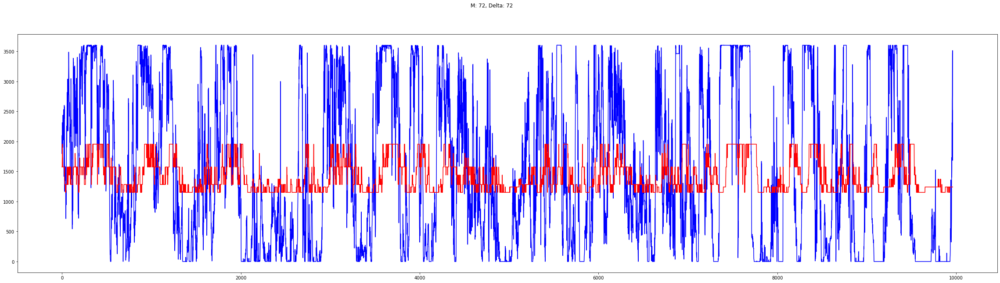

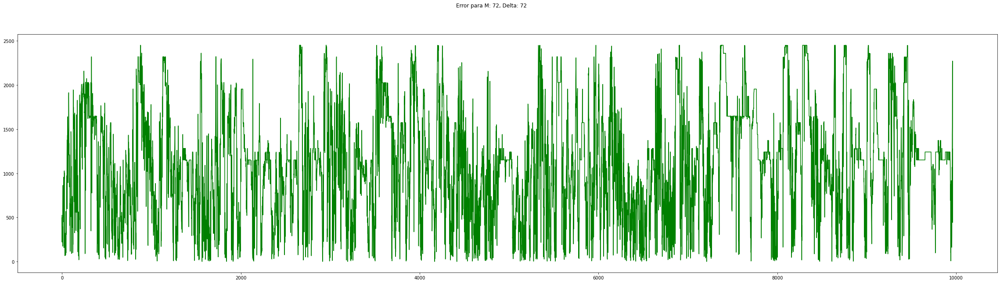

[0]	train-rmse:1.11966	eval-rmse:1.04146
[1]	train-rmse:1.11966	eval-rmse:1.04146
[2]	train-rmse:1.11966	eval-rmse:1.04146
[3]	train-rmse:1.11966	eval-rmse:1.04146
[4]	train-rmse:1.11966	eval-rmse:1.04146
[5]	train-rmse:1.11966	eval-rmse:1.04146
[0]	train-rmse:1.09748	eval-rmse:1.03406
[1]	train-rmse:1.07918	eval-rmse:1.02951
[2]	train-rmse:1.06414	eval-rmse:1.02715
[3]	train-rmse:1.05179	eval-rmse:1.02643
[4]	train-rmse:1.04168	eval-rmse:1.02693
[5]	train-rmse:1.03342	eval-rmse:1.02831
[6]	train-rmse:1.02668	eval-rmse:1.03029
[7]	train-rmse:1.02119	eval-rmse:1.03268
[8]	train-rmse:1.01672	eval-rmse:1.03531
[0]	train-rmse:1.07726	eval-rmse:1.02913
[1]	train-rmse:1.04923	eval-rmse:1.02645
[2]	train-rmse:1.03088	eval-rmse:1.02895
[3]	train-rmse:1.01897	eval-rmse:1.03390
[4]	train-rmse:1.01127	eval-rmse:1.03972
[5]	train-rmse:1.00631	eval-rmse:1.04555
[0]	train-rmse:1.05909	eval-rmse:1.02670
[1]	train-rmse:1.02811	eval-rmse:1.02979
[2]	train-rmse:1.01259	eval-rmse:1.03851
[3]	train-rmse:1

[51]	train-rmse:0.40979	eval-rmse:0.38155
[52]	train-rmse:0.40970	eval-rmse:0.38166
[0]	train-rmse:0.88310	eval-rmse:0.82341
[1]	train-rmse:0.73086	eval-rmse:0.69398
[2]	train-rmse:0.62238	eval-rmse:0.58519
[3]	train-rmse:0.55418	eval-rmse:0.53032
[4]	train-rmse:0.50788	eval-rmse:0.48242
[5]	train-rmse:0.47939	eval-rmse:0.45858
[6]	train-rmse:0.45803	eval-rmse:0.43444
[7]	train-rmse:0.44560	eval-rmse:0.42098
[8]	train-rmse:0.43632	eval-rmse:0.41202
[9]	train-rmse:0.43071	eval-rmse:0.40479
[10]	train-rmse:0.42647	eval-rmse:0.40021
[11]	train-rmse:0.42385	eval-rmse:0.39735
[12]	train-rmse:0.42199	eval-rmse:0.39502
[13]	train-rmse:0.42063	eval-rmse:0.39292
[14]	train-rmse:0.41967	eval-rmse:0.39144
[15]	train-rmse:0.41893	eval-rmse:0.39062
[16]	train-rmse:0.41839	eval-rmse:0.38991
[17]	train-rmse:0.41795	eval-rmse:0.38962
[18]	train-rmse:0.41761	eval-rmse:0.38920
[19]	train-rmse:0.41730	eval-rmse:0.38895
[20]	train-rmse:0.41699	eval-rmse:0.38883
[21]	train-rmse:0.41675	eval-rmse:0.38873
[2

[24]	train-rmse:0.42405	eval-rmse:0.40166
[25]	train-rmse:0.42345	eval-rmse:0.39936
[26]	train-rmse:0.42289	eval-rmse:0.39972
[27]	train-rmse:0.42245	eval-rmse:0.39997
[28]	train-rmse:0.42202	eval-rmse:0.40101
[29]	train-rmse:0.42149	eval-rmse:0.39854
[30]	train-rmse:0.42109	eval-rmse:0.39953
[31]	train-rmse:0.42062	eval-rmse:0.39769
[32]	train-rmse:0.42028	eval-rmse:0.39865
[33]	train-rmse:0.41990	eval-rmse:0.39889
[34]	train-rmse:0.41958	eval-rmse:0.39756
[35]	train-rmse:0.41925	eval-rmse:0.39812
[36]	train-rmse:0.41898	eval-rmse:0.39873
[37]	train-rmse:0.41864	eval-rmse:0.39709
[38]	train-rmse:0.41831	eval-rmse:0.39809
[39]	train-rmse:0.41798	eval-rmse:0.39625
[40]	train-rmse:0.41761	eval-rmse:0.39643
[41]	train-rmse:0.41730	eval-rmse:0.39506
[42]	train-rmse:0.41700	eval-rmse:0.39596
[43]	train-rmse:0.41671	eval-rmse:0.39564
[44]	train-rmse:0.41643	eval-rmse:0.39571
[45]	train-rmse:0.41620	eval-rmse:0.39626
[46]	train-rmse:0.41595	eval-rmse:0.39599
[0]	train-rmse:0.60150	eval-rmse:0

[22]	train-rmse:0.39934	eval-rmse:0.37885
[23]	train-rmse:0.39899	eval-rmse:0.37870
[24]	train-rmse:0.39852	eval-rmse:0.37871
[25]	train-rmse:0.39825	eval-rmse:0.37874
[26]	train-rmse:0.39764	eval-rmse:0.37863
[27]	train-rmse:0.39716	eval-rmse:0.37866
[28]	train-rmse:0.39682	eval-rmse:0.37875
[29]	train-rmse:0.39652	eval-rmse:0.37883
[30]	train-rmse:0.39630	eval-rmse:0.37862
[31]	train-rmse:0.39593	eval-rmse:0.37859
[32]	train-rmse:0.39578	eval-rmse:0.37839
[33]	train-rmse:0.39542	eval-rmse:0.37839
[34]	train-rmse:0.39510	eval-rmse:0.37844
[35]	train-rmse:0.39496	eval-rmse:0.37840
[36]	train-rmse:0.39480	eval-rmse:0.37842
[37]	train-rmse:0.39452	eval-rmse:0.37848
[38]	train-rmse:0.39417	eval-rmse:0.37822
[39]	train-rmse:0.39376	eval-rmse:0.37825
[40]	train-rmse:0.39353	eval-rmse:0.37824
[41]	train-rmse:0.39321	eval-rmse:0.37810
[42]	train-rmse:0.39309	eval-rmse:0.37809
[43]	train-rmse:0.39276	eval-rmse:0.37828
[44]	train-rmse:0.39242	eval-rmse:0.37825
[45]	train-rmse:0.39228	eval-rmse:

[7]	train-rmse:0.44223	eval-rmse:0.41858
[8]	train-rmse:0.42811	eval-rmse:0.40640
[9]	train-rmse:0.41780	eval-rmse:0.39697
[10]	train-rmse:0.41063	eval-rmse:0.39119
[11]	train-rmse:0.40544	eval-rmse:0.38675
[12]	train-rmse:0.40162	eval-rmse:0.38368
[13]	train-rmse:0.39876	eval-rmse:0.38248
[14]	train-rmse:0.39647	eval-rmse:0.38150
[15]	train-rmse:0.39479	eval-rmse:0.38054
[16]	train-rmse:0.39322	eval-rmse:0.38009
[17]	train-rmse:0.39180	eval-rmse:0.37952
[18]	train-rmse:0.39053	eval-rmse:0.37936
[19]	train-rmse:0.38936	eval-rmse:0.37922
[20]	train-rmse:0.38842	eval-rmse:0.37904
[21]	train-rmse:0.38794	eval-rmse:0.37911
[22]	train-rmse:0.38700	eval-rmse:0.37917
[23]	train-rmse:0.38614	eval-rmse:0.37905
[24]	train-rmse:0.38571	eval-rmse:0.37925
[25]	train-rmse:0.38484	eval-rmse:0.37950
[0]	train-rmse:0.84015	eval-rmse:0.78590
[1]	train-rmse:0.65879	eval-rmse:0.61923
[2]	train-rmse:0.54742	eval-rmse:0.51512
[3]	train-rmse:0.48151	eval-rmse:0.45490
[4]	train-rmse:0.44389	eval-rmse:0.41995


[1]	train-rmse:0.47963	eval-rmse:0.46485
[2]	train-rmse:0.41670	eval-rmse:0.40929
[3]	train-rmse:0.39560	eval-rmse:0.39370
[4]	train-rmse:0.38591	eval-rmse:0.38891
[5]	train-rmse:0.38035	eval-rmse:0.38712
[6]	train-rmse:0.37549	eval-rmse:0.38712
[7]	train-rmse:0.37308	eval-rmse:0.38786
[8]	train-rmse:0.37233	eval-rmse:0.38803
[9]	train-rmse:0.36745	eval-rmse:0.38837
[10]	train-rmse:0.36544	eval-rmse:0.38862
[0]	train-rmse:0.58346	eval-rmse:0.55475
[1]	train-rmse:0.43396	eval-rmse:0.42321
[2]	train-rmse:0.39893	eval-rmse:0.39527
[3]	train-rmse:0.38843	eval-rmse:0.38913
[4]	train-rmse:0.38252	eval-rmse:0.39086
[5]	train-rmse:0.37771	eval-rmse:0.39025
[6]	train-rmse:0.37543	eval-rmse:0.39065
[7]	train-rmse:0.37214	eval-rmse:0.39143
[8]	train-rmse:0.36989	eval-rmse:0.39274
[0]	train-rmse:0.51407	eval-rmse:0.49162
[1]	train-rmse:0.40934	eval-rmse:0.39968
[2]	train-rmse:0.39163	eval-rmse:0.38984
[3]	train-rmse:0.38520	eval-rmse:0.38960
[4]	train-rmse:0.38247	eval-rmse:0.39108
[5]	train-rmse:

[8]	train-rmse:0.55144	eval-rmse:0.54398
[9]	train-rmse:0.52033	eval-rmse:0.51802
[10]	train-rmse:0.49361	eval-rmse:0.49624
[11]	train-rmse:0.47000	eval-rmse:0.47720
[12]	train-rmse:0.44944	eval-rmse:0.46141
[13]	train-rmse:0.43225	eval-rmse:0.44810
[14]	train-rmse:0.41673	eval-rmse:0.43761
[15]	train-rmse:0.40335	eval-rmse:0.42841
[16]	train-rmse:0.39198	eval-rmse:0.42077
[17]	train-rmse:0.38176	eval-rmse:0.41437
[18]	train-rmse:0.37309	eval-rmse:0.40937
[19]	train-rmse:0.36591	eval-rmse:0.40504
[20]	train-rmse:0.35957	eval-rmse:0.40160
[21]	train-rmse:0.35410	eval-rmse:0.39867
[22]	train-rmse:0.34927	eval-rmse:0.39596
[23]	train-rmse:0.34505	eval-rmse:0.39390
[24]	train-rmse:0.34135	eval-rmse:0.39224
[25]	train-rmse:0.33784	eval-rmse:0.39093
[26]	train-rmse:0.33413	eval-rmse:0.38994
[27]	train-rmse:0.33078	eval-rmse:0.38920
[28]	train-rmse:0.32892	eval-rmse:0.38843
[29]	train-rmse:0.32569	eval-rmse:0.38792
[30]	train-rmse:0.32388	eval-rmse:0.38717
[31]	train-rmse:0.32198	eval-rmse:0.

[12]	train-rmse:0.27536	eval-rmse:0.40088
[13]	train-rmse:0.26956	eval-rmse:0.40112
[0]	train-rmse:0.73355	eval-rmse:0.70679
[1]	train-rmse:0.52267	eval-rmse:0.52823
[2]	train-rmse:0.41302	eval-rmse:0.44875
[3]	train-rmse:0.35731	eval-rmse:0.41608
[4]	train-rmse:0.32959	eval-rmse:0.40468
[5]	train-rmse:0.31195	eval-rmse:0.40158
[6]	train-rmse:0.29907	eval-rmse:0.40230
[7]	train-rmse:0.28775	eval-rmse:0.40219
[8]	train-rmse:0.28043	eval-rmse:0.40495
[9]	train-rmse:0.27573	eval-rmse:0.40587
[10]	train-rmse:0.27297	eval-rmse:0.40637
[0]	train-rmse:0.64415	eval-rmse:0.63165
[1]	train-rmse:0.43986	eval-rmse:0.46830
[2]	train-rmse:0.35894	eval-rmse:0.41897
[3]	train-rmse:0.32375	eval-rmse:0.41023
[4]	train-rmse:0.30648	eval-rmse:0.40763
[5]	train-rmse:0.29570	eval-rmse:0.40971
[6]	train-rmse:0.28718	eval-rmse:0.40980
[7]	train-rmse:0.28271	eval-rmse:0.41088
[8]	train-rmse:0.27790	eval-rmse:0.41174
[0]	train-rmse:0.56038	eval-rmse:0.56274
[1]	train-rmse:0.38697	eval-rmse:0.43190
[2]	train-rms

[14]	train-rmse:0.35744	eval-rmse:0.44082
[15]	train-rmse:0.34036	eval-rmse:0.43286
[16]	train-rmse:0.32506	eval-rmse:0.42530
[17]	train-rmse:0.31058	eval-rmse:0.42059
[18]	train-rmse:0.29930	eval-rmse:0.41554
[19]	train-rmse:0.28820	eval-rmse:0.41166
[20]	train-rmse:0.27780	eval-rmse:0.40797
[21]	train-rmse:0.26909	eval-rmse:0.40503
[22]	train-rmse:0.25999	eval-rmse:0.40278
[23]	train-rmse:0.25221	eval-rmse:0.40104
[24]	train-rmse:0.24527	eval-rmse:0.39957
[25]	train-rmse:0.23943	eval-rmse:0.39863
[26]	train-rmse:0.23445	eval-rmse:0.39797
[27]	train-rmse:0.22962	eval-rmse:0.39708
[28]	train-rmse:0.22470	eval-rmse:0.39629
[29]	train-rmse:0.21822	eval-rmse:0.39576
[30]	train-rmse:0.21320	eval-rmse:0.39566
[31]	train-rmse:0.20834	eval-rmse:0.39570
[32]	train-rmse:0.20374	eval-rmse:0.39559
[33]	train-rmse:0.19854	eval-rmse:0.39570
[34]	train-rmse:0.19368	eval-rmse:0.39559
[35]	train-rmse:0.18982	eval-rmse:0.39574
[36]	train-rmse:0.18585	eval-rmse:0.39570
[37]	train-rmse:0.18318	eval-rmse:

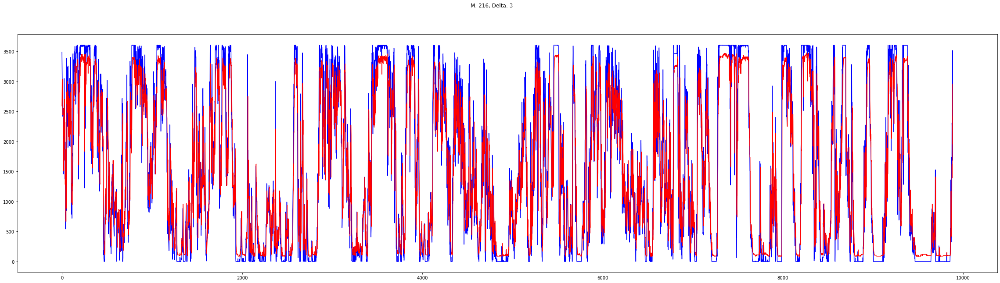

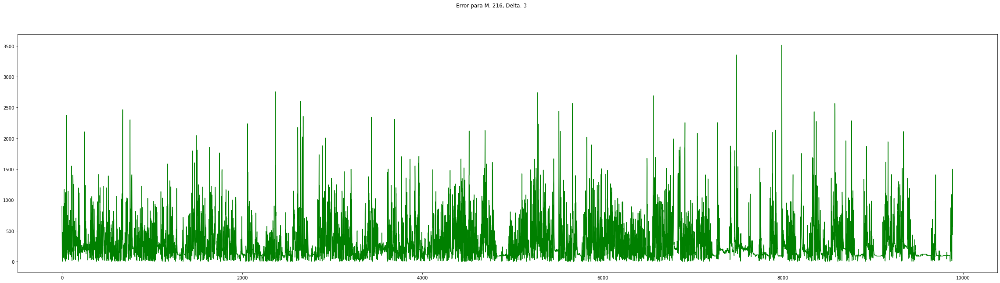

[0]	train-rmse:1.12002	eval-rmse:1.04179
[1]	train-rmse:1.12002	eval-rmse:1.04179
[2]	train-rmse:1.12002	eval-rmse:1.04179
[3]	train-rmse:1.12002	eval-rmse:1.04179
[4]	train-rmse:1.12002	eval-rmse:1.04179
[5]	train-rmse:1.12002	eval-rmse:1.04179
[0]	train-rmse:1.09786	eval-rmse:1.03433
[1]	train-rmse:1.07957	eval-rmse:1.02972
[2]	train-rmse:1.06453	eval-rmse:1.02730
[3]	train-rmse:1.05219	eval-rmse:1.02653
[4]	train-rmse:1.04209	eval-rmse:1.02699
[5]	train-rmse:1.03383	eval-rmse:1.02832
[6]	train-rmse:1.02709	eval-rmse:1.03027
[7]	train-rmse:1.02161	eval-rmse:1.03263
[0]	train-rmse:1.07764	eval-rmse:1.02933
[1]	train-rmse:1.04962	eval-rmse:1.02655
[2]	train-rmse:1.03129	eval-rmse:1.02895
[3]	train-rmse:1.01938	eval-rmse:1.03383
[4]	train-rmse:1.01168	eval-rmse:1.03960
[5]	train-rmse:1.00673	eval-rmse:1.04539
[6]	train-rmse:1.00355	eval-rmse:1.05075
[0]	train-rmse:1.05949	eval-rmse:1.02684
[1]	train-rmse:1.02852	eval-rmse:1.02978
[2]	train-rmse:1.01300	eval-rmse:1.03839
[3]	train-rmse:1

[3]	train-rmse:0.75881	eval-rmse:0.76440
[4]	train-rmse:0.74181	eval-rmse:0.75330
[5]	train-rmse:0.73191	eval-rmse:0.74737
[6]	train-rmse:0.72495	eval-rmse:0.74378
[7]	train-rmse:0.72002	eval-rmse:0.74372
[8]	train-rmse:0.71576	eval-rmse:0.74294
[9]	train-rmse:0.71271	eval-rmse:0.74291
[10]	train-rmse:0.70962	eval-rmse:0.74368
[11]	train-rmse:0.70737	eval-rmse:0.74288
[12]	train-rmse:0.70507	eval-rmse:0.74343
[13]	train-rmse:0.70363	eval-rmse:0.74229
[14]	train-rmse:0.70165	eval-rmse:0.74379
[15]	train-rmse:0.70048	eval-rmse:0.74366
[16]	train-rmse:0.69859	eval-rmse:0.74402
[17]	train-rmse:0.69671	eval-rmse:0.74309
[0]	train-rmse:0.89648	eval-rmse:0.86534
[1]	train-rmse:0.79671	eval-rmse:0.79248
[2]	train-rmse:0.75407	eval-rmse:0.76055
[3]	train-rmse:0.73558	eval-rmse:0.74860
[4]	train-rmse:0.72601	eval-rmse:0.74761
[5]	train-rmse:0.71970	eval-rmse:0.74427
[6]	train-rmse:0.71535	eval-rmse:0.74606
[7]	train-rmse:0.71130	eval-rmse:0.74547
[8]	train-rmse:0.70840	eval-rmse:0.74721
[9]	trai

[5]	train-rmse:0.59762	eval-rmse:0.80625
[6]	train-rmse:0.58901	eval-rmse:0.80905
[0]	train-rmse:0.70016	eval-rmse:0.78862
[1]	train-rmse:0.66996	eval-rmse:0.79638
[2]	train-rmse:0.64228	eval-rmse:0.80244
[3]	train-rmse:0.62145	eval-rmse:0.81108
[4]	train-rmse:0.61206	eval-rmse:0.81660
[5]	train-rmse:0.59938	eval-rmse:0.82072
[0]	train-rmse:1.12002	eval-rmse:1.04179
[1]	train-rmse:1.12002	eval-rmse:1.04179
[2]	train-rmse:1.12002	eval-rmse:1.04179
[3]	train-rmse:1.12002	eval-rmse:1.04179
[4]	train-rmse:1.12002	eval-rmse:1.04179
[5]	train-rmse:1.12002	eval-rmse:1.04179
[0]	train-rmse:1.04966	eval-rmse:0.99332
[1]	train-rmse:0.98821	eval-rmse:0.95220
[2]	train-rmse:0.93486	eval-rmse:0.91623
[3]	train-rmse:0.88862	eval-rmse:0.88929
[4]	train-rmse:0.84816	eval-rmse:0.86477
[5]	train-rmse:0.81280	eval-rmse:0.84345
[6]	train-rmse:0.78212	eval-rmse:0.82773
[7]	train-rmse:0.75419	eval-rmse:0.81324
[8]	train-rmse:0.73080	eval-rmse:0.80366
[9]	train-rmse:0.71018	eval-rmse:0.79475
[10]	train-rmse:

[4]	train-rmse:0.48295	eval-rmse:0.82943
[5]	train-rmse:0.47442	eval-rmse:0.83329
[0]	train-rmse:0.69606	eval-rmse:0.81573
[1]	train-rmse:0.58246	eval-rmse:0.80982
[2]	train-rmse:0.53550	eval-rmse:0.81901
[3]	train-rmse:0.50880	eval-rmse:0.82095
[4]	train-rmse:0.50303	eval-rmse:0.82241
[5]	train-rmse:0.48757	eval-rmse:0.83023
[0]	train-rmse:0.66459	eval-rmse:0.81238
[1]	train-rmse:0.57495	eval-rmse:0.82476
[2]	train-rmse:0.54817	eval-rmse:0.83888
[3]	train-rmse:0.50545	eval-rmse:0.85137
[4]	train-rmse:0.49711	eval-rmse:0.85420
[5]	train-rmse:0.48140	eval-rmse:0.86094
[0]	train-rmse:0.64471	eval-rmse:0.81740
[1]	train-rmse:0.58725	eval-rmse:0.83610
[2]	train-rmse:0.54949	eval-rmse:0.85304
[3]	train-rmse:0.54174	eval-rmse:0.85720
[4]	train-rmse:0.49799	eval-rmse:0.86391
[0]	train-rmse:1.12002	eval-rmse:1.04179
[1]	train-rmse:1.12002	eval-rmse:1.04179
[2]	train-rmse:1.12002	eval-rmse:1.04179
[3]	train-rmse:1.12002	eval-rmse:1.04179
[4]	train-rmse:1.12002	eval-rmse:1.04179
[0]	train-rmse:1

[1]	train-rmse:0.50156	eval-rmse:0.84284
[2]	train-rmse:0.41162	eval-rmse:0.85016
[3]	train-rmse:0.36817	eval-rmse:0.85890
[4]	train-rmse:0.33563	eval-rmse:0.86272
[5]	train-rmse:0.31124	eval-rmse:0.86455
[6]	train-rmse:0.30974	eval-rmse:0.86429
[0]	train-rmse:0.63787	eval-rmse:0.83992
[1]	train-rmse:0.47388	eval-rmse:0.85452
[2]	train-rmse:0.40022	eval-rmse:0.86663
[3]	train-rmse:0.36327	eval-rmse:0.87311
[4]	train-rmse:0.32497	eval-rmse:0.88251
[5]	train-rmse:0.30051	eval-rmse:0.88467
[0]	train-rmse:0.59928	eval-rmse:0.84474
[1]	train-rmse:0.46873	eval-rmse:0.87033
[2]	train-rmse:0.39563	eval-rmse:0.89362
[3]	train-rmse:0.38025	eval-rmse:0.89831
[4]	train-rmse:0.34767	eval-rmse:0.90617
[5]	train-rmse:0.34171	eval-rmse:0.90679
[0]	train-rmse:0.57421	eval-rmse:0.85867
[1]	train-rmse:0.45933	eval-rmse:0.90846
[2]	train-rmse:0.38152	eval-rmse:0.92880
[3]	train-rmse:0.33457	eval-rmse:0.94695
[4]	train-rmse:0.33191	eval-rmse:0.94721
[5]	train-rmse:0.30609	eval-rmse:0.95245
Best Max. Depth:

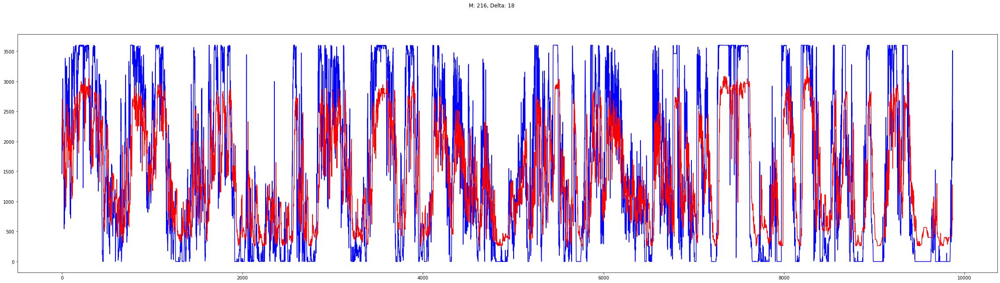

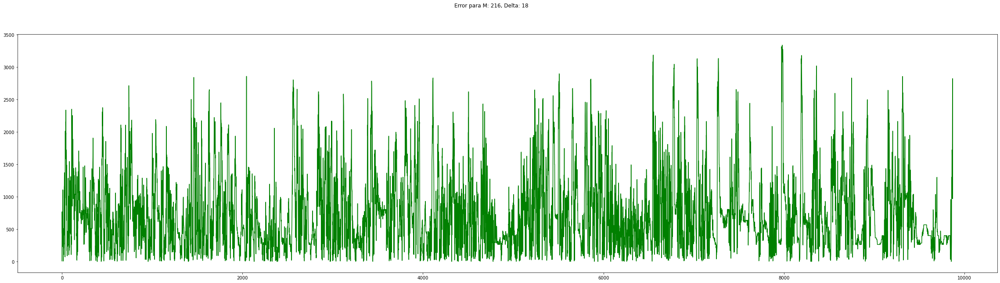

[0]	train-rmse:1.12019	eval-rmse:1.04255
[1]	train-rmse:1.12019	eval-rmse:1.04255
[2]	train-rmse:1.12019	eval-rmse:1.04255
[3]	train-rmse:1.12019	eval-rmse:1.04255
[4]	train-rmse:1.12019	eval-rmse:1.04255
[0]	train-rmse:1.09805	eval-rmse:1.03505
[1]	train-rmse:1.07979	eval-rmse:1.03040
[2]	train-rmse:1.06476	eval-rmse:1.02794
[3]	train-rmse:1.05244	eval-rmse:1.02713
[4]	train-rmse:1.04234	eval-rmse:1.02755
[5]	train-rmse:1.03409	eval-rmse:1.02885
[6]	train-rmse:1.02737	eval-rmse:1.03077
[7]	train-rmse:1.02188	eval-rmse:1.03310
[8]	train-rmse:1.01743	eval-rmse:1.03567
[0]	train-rmse:1.07786	eval-rmse:1.03001
[1]	train-rmse:1.04987	eval-rmse:1.02714
[2]	train-rmse:1.03156	eval-rmse:1.02947
[3]	train-rmse:1.01967	eval-rmse:1.03429
[4]	train-rmse:1.01198	eval-rmse:1.04000
[5]	train-rmse:1.00704	eval-rmse:1.04575
[0]	train-rmse:1.05972	eval-rmse:1.02746
[1]	train-rmse:1.02879	eval-rmse:1.03029
[2]	train-rmse:1.01329	eval-rmse:1.03881
[3]	train-rmse:1.00561	eval-rmse:1.04791
[4]	train-rmse:1

[14]	train-rmse:0.84456	eval-rmse:0.90654
[0]	train-rmse:0.91072	eval-rmse:0.93140
[1]	train-rmse:0.88294	eval-rmse:0.91407
[2]	train-rmse:0.87522	eval-rmse:0.91138
[3]	train-rmse:0.86844	eval-rmse:0.91110
[4]	train-rmse:0.86479	eval-rmse:0.91417
[5]	train-rmse:0.86194	eval-rmse:0.91169
[6]	train-rmse:0.85946	eval-rmse:0.91218
[7]	train-rmse:0.85671	eval-rmse:0.90782
[8]	train-rmse:0.85483	eval-rmse:0.91135
[9]	train-rmse:0.85282	eval-rmse:0.91313
[10]	train-rmse:0.85093	eval-rmse:0.90831
[11]	train-rmse:0.84943	eval-rmse:0.90751
[12]	train-rmse:0.84808	eval-rmse:0.90876
[13]	train-rmse:0.84584	eval-rmse:0.90558
[14]	train-rmse:0.84456	eval-rmse:0.90679
[15]	train-rmse:0.84343	eval-rmse:0.90924
[16]	train-rmse:0.84230	eval-rmse:0.90818
[17]	train-rmse:0.84119	eval-rmse:0.90619
[18]	train-rmse:0.84023	eval-rmse:0.90457
[19]	train-rmse:0.83915	eval-rmse:0.90627
[20]	train-rmse:0.83834	eval-rmse:0.90785
[21]	train-rmse:0.83752	eval-rmse:0.90902
[22]	train-rmse:0.83640	eval-rmse:0.90816
[0

[8]	train-rmse:0.80001	eval-rmse:0.91108
[0]	train-rmse:0.92897	eval-rmse:0.92975
[1]	train-rmse:0.86681	eval-rmse:0.90213
[2]	train-rmse:0.84286	eval-rmse:0.89848
[3]	train-rmse:0.82936	eval-rmse:0.90036
[4]	train-rmse:0.81808	eval-rmse:0.90753
[5]	train-rmse:0.80961	eval-rmse:0.91055
[6]	train-rmse:0.80514	eval-rmse:0.90822
[7]	train-rmse:0.80000	eval-rmse:0.91235
[0]	train-rmse:0.90330	eval-rmse:0.91851
[1]	train-rmse:0.85290	eval-rmse:0.90241
[2]	train-rmse:0.83357	eval-rmse:0.90158
[3]	train-rmse:0.82039	eval-rmse:0.90516
[4]	train-rmse:0.81093	eval-rmse:0.90455
[5]	train-rmse:0.80410	eval-rmse:0.90530
[6]	train-rmse:0.79692	eval-rmse:0.90809
[0]	train-rmse:0.88282	eval-rmse:0.91149
[1]	train-rmse:0.84356	eval-rmse:0.90907
[2]	train-rmse:0.82874	eval-rmse:0.91402
[3]	train-rmse:0.81569	eval-rmse:0.91874
[4]	train-rmse:0.81051	eval-rmse:0.92051
[5]	train-rmse:0.80343	eval-rmse:0.92220
[6]	train-rmse:0.79652	eval-rmse:0.92693
[0]	train-rmse:0.86788	eval-rmse:0.90877
[1]	train-rmse:0

[4]	train-rmse:0.72741	eval-rmse:0.96658
[5]	train-rmse:0.71216	eval-rmse:0.96842
[0]	train-rmse:0.81764	eval-rmse:0.94630
[1]	train-rmse:0.78002	eval-rmse:0.96291
[2]	train-rmse:0.75950	eval-rmse:0.96624
[3]	train-rmse:0.73030	eval-rmse:0.97909
[4]	train-rmse:0.71738	eval-rmse:0.98639
[0]	train-rmse:1.12019	eval-rmse:1.04255
[1]	train-rmse:1.12019	eval-rmse:1.04255
[2]	train-rmse:1.12019	eval-rmse:1.04255
[3]	train-rmse:1.12019	eval-rmse:1.04255
[4]	train-rmse:1.12019	eval-rmse:1.04255
[0]	train-rmse:1.06417	eval-rmse:1.01336
[1]	train-rmse:1.01640	eval-rmse:0.98857
[2]	train-rmse:0.97413	eval-rmse:0.97126
[3]	train-rmse:0.93819	eval-rmse:0.95655
[4]	train-rmse:0.90458	eval-rmse:0.94464
[5]	train-rmse:0.87635	eval-rmse:0.93599
[6]	train-rmse:0.85113	eval-rmse:0.92992
[7]	train-rmse:0.82907	eval-rmse:0.92354
[8]	train-rmse:0.80939	eval-rmse:0.91955
[9]	train-rmse:0.79141	eval-rmse:0.91673
[10]	train-rmse:0.77489	eval-rmse:0.91552
[11]	train-rmse:0.76230	eval-rmse:0.91333
[12]	train-rms

[5]	train-rmse:0.65282	eval-rmse:0.92630
[6]	train-rmse:0.60905	eval-rmse:0.92617
[7]	train-rmse:0.58054	eval-rmse:0.92912
[8]	train-rmse:0.54948	eval-rmse:0.93059
[9]	train-rmse:0.52175	eval-rmse:0.93420
[10]	train-rmse:0.50085	eval-rmse:0.93663
[0]	train-rmse:0.93145	eval-rmse:0.97622
[1]	train-rmse:0.80858	eval-rmse:0.95380
[2]	train-rmse:0.71337	eval-rmse:0.94725
[3]	train-rmse:0.65773	eval-rmse:0.94557
[4]	train-rmse:0.59407	eval-rmse:0.94974
[5]	train-rmse:0.54971	eval-rmse:0.95409
[6]	train-rmse:0.52072	eval-rmse:0.95927
[7]	train-rmse:0.49063	eval-rmse:0.96148
[0]	train-rmse:0.87666	eval-rmse:0.96650
[1]	train-rmse:0.73787	eval-rmse:0.95071
[2]	train-rmse:0.64148	eval-rmse:0.95103
[3]	train-rmse:0.56745	eval-rmse:0.96575
[4]	train-rmse:0.52353	eval-rmse:0.97387
[5]	train-rmse:0.49045	eval-rmse:0.97814
[6]	train-rmse:0.45998	eval-rmse:0.98106
[0]	train-rmse:0.82733	eval-rmse:0.96338
[1]	train-rmse:0.68344	eval-rmse:0.95589
[2]	train-rmse:0.57969	eval-rmse:0.97139
[3]	train-rmse:

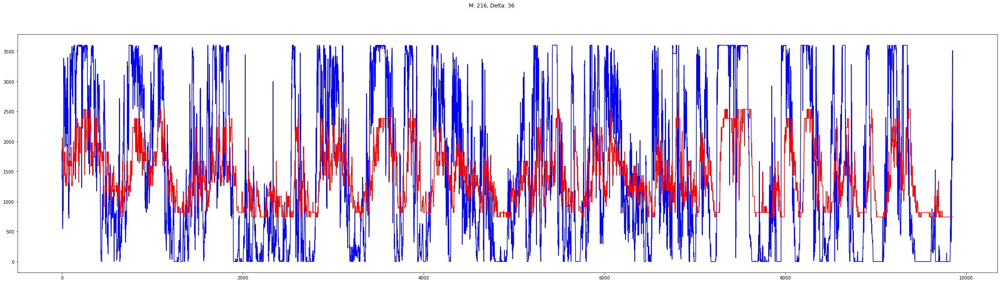

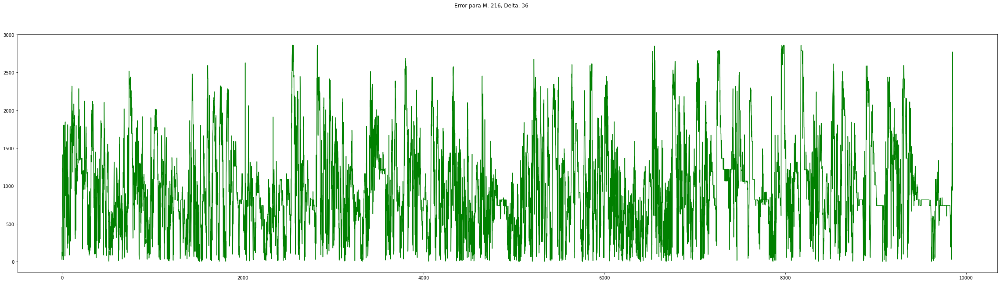

[0]	train-rmse:1.12073	eval-rmse:1.04331
[1]	train-rmse:1.12073	eval-rmse:1.04331
[2]	train-rmse:1.12073	eval-rmse:1.04331
[3]	train-rmse:1.12073	eval-rmse:1.04331
[4]	train-rmse:1.12073	eval-rmse:1.04331
[0]	train-rmse:1.09867	eval-rmse:1.03575
[1]	train-rmse:1.08047	eval-rmse:1.03103
[2]	train-rmse:1.06549	eval-rmse:1.02851
[3]	train-rmse:1.05321	eval-rmse:1.02764
[4]	train-rmse:1.04316	eval-rmse:1.02799
[5]	train-rmse:1.03495	eval-rmse:1.02923
[6]	train-rmse:1.02824	eval-rmse:1.03109
[7]	train-rmse:1.02279	eval-rmse:1.03337
[8]	train-rmse:1.01834	eval-rmse:1.03590
[0]	train-rmse:1.07855	eval-rmse:1.03063
[1]	train-rmse:1.05066	eval-rmse:1.02762
[2]	train-rmse:1.03242	eval-rmse:1.02983
[3]	train-rmse:1.02057	eval-rmse:1.03454
[4]	train-rmse:1.01292	eval-rmse:1.04016
[5]	train-rmse:1.00799	eval-rmse:1.04583
[6]	train-rmse:1.00482	eval-rmse:1.05109
[0]	train-rmse:1.06047	eval-rmse:1.02800
[1]	train-rmse:1.02967	eval-rmse:1.03062
[2]	train-rmse:1.01423	eval-rmse:1.03898
[3]	train-rmse:1

[1]	train-rmse:1.12073	eval-rmse:1.04331
[2]	train-rmse:1.12073	eval-rmse:1.04331
[3]	train-rmse:1.12073	eval-rmse:1.04331
[4]	train-rmse:1.12073	eval-rmse:1.04331
[0]	train-rmse:1.08689	eval-rmse:1.02825
[1]	train-rmse:1.05834	eval-rmse:1.01687
[2]	train-rmse:1.03454	eval-rmse:1.00802
[3]	train-rmse:1.01454	eval-rmse:1.00197
[4]	train-rmse:0.99791	eval-rmse:0.99837
[5]	train-rmse:0.98407	eval-rmse:0.99547
[6]	train-rmse:0.97174	eval-rmse:0.99286
[7]	train-rmse:0.96167	eval-rmse:0.99269
[8]	train-rmse:0.95286	eval-rmse:0.99325
[9]	train-rmse:0.94570	eval-rmse:0.99263
[10]	train-rmse:0.93910	eval-rmse:0.99319
[11]	train-rmse:0.93308	eval-rmse:0.99436
[12]	train-rmse:0.92818	eval-rmse:0.99536
[13]	train-rmse:0.92340	eval-rmse:0.99635
[0]	train-rmse:1.05569	eval-rmse:1.01596
[1]	train-rmse:1.01076	eval-rmse:1.00103
[2]	train-rmse:0.97999	eval-rmse:0.99591
[3]	train-rmse:0.95781	eval-rmse:0.99272
[4]	train-rmse:0.94290	eval-rmse:0.99302
[5]	train-rmse:0.93095	eval-rmse:0.99560
[6]	train-rm

[2]	train-rmse:0.81346	eval-rmse:1.07207
[3]	train-rmse:0.80259	eval-rmse:1.08137
[4]	train-rmse:0.77903	eval-rmse:1.09073
[5]	train-rmse:0.76421	eval-rmse:1.09136
[0]	train-rmse:1.12073	eval-rmse:1.04331
[1]	train-rmse:1.12073	eval-rmse:1.04331
[2]	train-rmse:1.12073	eval-rmse:1.04331
[3]	train-rmse:1.12073	eval-rmse:1.04331
[4]	train-rmse:1.12073	eval-rmse:1.04331
[0]	train-rmse:1.07495	eval-rmse:1.02849
[1]	train-rmse:1.03498	eval-rmse:1.01588
[2]	train-rmse:0.99951	eval-rmse:1.00787
[3]	train-rmse:0.96926	eval-rmse:1.00174
[4]	train-rmse:0.94264	eval-rmse:0.99860
[5]	train-rmse:0.91950	eval-rmse:0.99661
[6]	train-rmse:0.89807	eval-rmse:0.99626
[7]	train-rmse:0.87912	eval-rmse:0.99511
[8]	train-rmse:0.86215	eval-rmse:0.99618
[9]	train-rmse:0.84623	eval-rmse:0.99738
[10]	train-rmse:0.83217	eval-rmse:0.99942
[11]	train-rmse:0.81955	eval-rmse:1.00168
[12]	train-rmse:0.80868	eval-rmse:1.00482
[0]	train-rmse:1.03226	eval-rmse:1.01777
[1]	train-rmse:0.96556	eval-rmse:1.00477
[2]	train-rms

[1]	train-rmse:1.12073	eval-rmse:1.04331
[2]	train-rmse:1.12073	eval-rmse:1.04331
[3]	train-rmse:1.12073	eval-rmse:1.04331
[4]	train-rmse:1.12073	eval-rmse:1.04331
[5]	train-rmse:1.12073	eval-rmse:1.04331
[0]	train-rmse:1.05408	eval-rmse:1.03091
[1]	train-rmse:0.99595	eval-rmse:1.02020
[2]	train-rmse:0.94483	eval-rmse:1.01255
[3]	train-rmse:0.89826	eval-rmse:1.00731
[4]	train-rmse:0.85794	eval-rmse:1.00595
[5]	train-rmse:0.82227	eval-rmse:1.00492
[6]	train-rmse:0.78704	eval-rmse:1.00440
[7]	train-rmse:0.75691	eval-rmse:1.00566
[8]	train-rmse:0.72337	eval-rmse:1.00768
[9]	train-rmse:0.69577	eval-rmse:1.01147
[10]	train-rmse:0.67052	eval-rmse:1.01481
[0]	train-rmse:0.99052	eval-rmse:1.02517
[1]	train-rmse:0.89160	eval-rmse:1.01311
[2]	train-rmse:0.80957	eval-rmse:1.01128
[3]	train-rmse:0.74366	eval-rmse:1.01667
[4]	train-rmse:0.68612	eval-rmse:1.02496
[5]	train-rmse:0.63957	eval-rmse:1.03374
[6]	train-rmse:0.59708	eval-rmse:1.03896
[7]	train-rmse:0.55843	eval-rmse:1.04657
[0]	train-rmse:

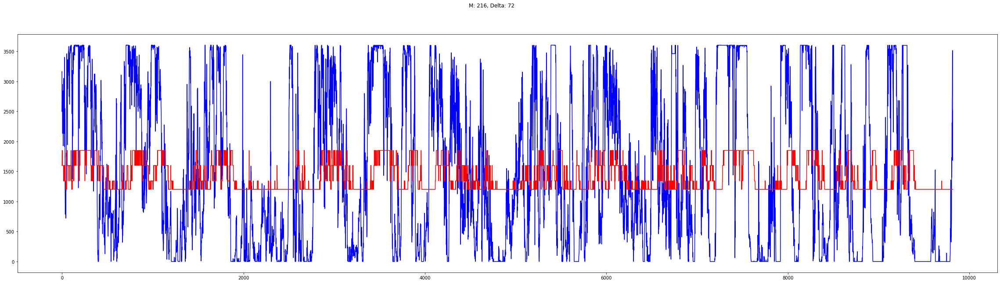

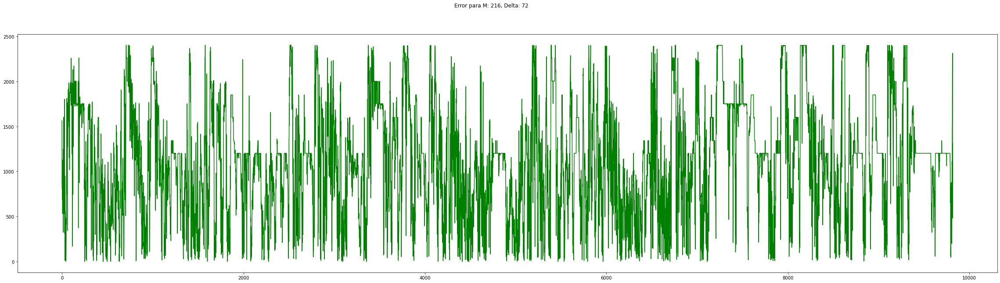

[0]	train-rmse:1.11868	eval-rmse:1.04097
[1]	train-rmse:1.11868	eval-rmse:1.04097
[2]	train-rmse:1.11868	eval-rmse:1.04097
[3]	train-rmse:1.11868	eval-rmse:1.04097
[4]	train-rmse:1.11868	eval-rmse:1.04097
[5]	train-rmse:1.11868	eval-rmse:1.04097
[0]	train-rmse:1.09634	eval-rmse:1.03202
[1]	train-rmse:1.07790	eval-rmse:1.02608
[2]	train-rmse:1.06273	eval-rmse:1.02247
[3]	train-rmse:1.05029	eval-rmse:1.02063
[4]	train-rmse:1.04009	eval-rmse:1.02015
[5]	train-rmse:1.03176	eval-rmse:1.02064
[6]	train-rmse:1.02496	eval-rmse:1.02185
[7]	train-rmse:1.01943	eval-rmse:1.02355
[8]	train-rmse:1.01492	eval-rmse:1.02558
[0]	train-rmse:1.07595	eval-rmse:1.02554
[1]	train-rmse:1.04769	eval-rmse:1.02041
[2]	train-rmse:1.02920	eval-rmse:1.02100
[3]	train-rmse:1.01719	eval-rmse:1.02448
[4]	train-rmse:1.00942	eval-rmse:1.02916
[5]	train-rmse:1.00442	eval-rmse:1.03411
[0]	train-rmse:1.05764	eval-rmse:1.02157
[1]	train-rmse:1.02641	eval-rmse:1.02153
[2]	train-rmse:1.01074	eval-rmse:1.02816
[3]	train-rmse:1

[44]	train-rmse:0.41095	eval-rmse:0.38094
[45]	train-rmse:0.41083	eval-rmse:0.38089
[0]	train-rmse:0.88276	eval-rmse:0.82209
[1]	train-rmse:0.73066	eval-rmse:0.69142
[2]	train-rmse:0.62268	eval-rmse:0.58342
[3]	train-rmse:0.55464	eval-rmse:0.52809
[4]	train-rmse:0.50849	eval-rmse:0.48081
[5]	train-rmse:0.48018	eval-rmse:0.45688
[6]	train-rmse:0.45887	eval-rmse:0.43312
[7]	train-rmse:0.44644	eval-rmse:0.41989
[8]	train-rmse:0.43723	eval-rmse:0.41093
[9]	train-rmse:0.43160	eval-rmse:0.40386
[10]	train-rmse:0.42737	eval-rmse:0.39932
[11]	train-rmse:0.42468	eval-rmse:0.39659
[12]	train-rmse:0.42283	eval-rmse:0.39430
[13]	train-rmse:0.42141	eval-rmse:0.39220
[14]	train-rmse:0.42046	eval-rmse:0.39074
[15]	train-rmse:0.41969	eval-rmse:0.38990
[16]	train-rmse:0.41913	eval-rmse:0.38921
[17]	train-rmse:0.41865	eval-rmse:0.38870
[18]	train-rmse:0.41828	eval-rmse:0.38852
[19]	train-rmse:0.41795	eval-rmse:0.38835
[20]	train-rmse:0.41765	eval-rmse:0.38822
[21]	train-rmse:0.41740	eval-rmse:0.38815
[2

[36]	train-rmse:0.41943	eval-rmse:0.39926
[37]	train-rmse:0.41905	eval-rmse:0.39737
[0]	train-rmse:0.60216	eval-rmse:0.58056
[1]	train-rmse:0.51959	eval-rmse:0.50882
[2]	train-rmse:0.48289	eval-rmse:0.45851
[3]	train-rmse:0.47596	eval-rmse:0.45495
[4]	train-rmse:0.46613	eval-rmse:0.44172
[5]	train-rmse:0.46196	eval-rmse:0.44045
[6]	train-rmse:0.45505	eval-rmse:0.42977
[7]	train-rmse:0.45222	eval-rmse:0.42287
[8]	train-rmse:0.44637	eval-rmse:0.42109
[9]	train-rmse:0.44325	eval-rmse:0.41372
[10]	train-rmse:0.44091	eval-rmse:0.41429
[11]	train-rmse:0.43812	eval-rmse:0.40911
[12]	train-rmse:0.43649	eval-rmse:0.40995
[13]	train-rmse:0.43470	eval-rmse:0.40658
[14]	train-rmse:0.43371	eval-rmse:0.40647
[15]	train-rmse:0.43266	eval-rmse:0.40778
[16]	train-rmse:0.43110	eval-rmse:0.40279
[17]	train-rmse:0.43008	eval-rmse:0.40404
[18]	train-rmse:0.42885	eval-rmse:0.39992
[19]	train-rmse:0.42798	eval-rmse:0.40125
[20]	train-rmse:0.42694	eval-rmse:0.39794
[21]	train-rmse:0.42627	eval-rmse:0.39915
[2

[2]	train-rmse:0.44599	eval-rmse:0.41743
[3]	train-rmse:0.42417	eval-rmse:0.39649
[4]	train-rmse:0.41464	eval-rmse:0.38937
[5]	train-rmse:0.41084	eval-rmse:0.38805
[6]	train-rmse:0.40865	eval-rmse:0.38724
[7]	train-rmse:0.40755	eval-rmse:0.38647
[8]	train-rmse:0.40606	eval-rmse:0.38626
[9]	train-rmse:0.40474	eval-rmse:0.38655
[10]	train-rmse:0.40378	eval-rmse:0.38709
[11]	train-rmse:0.40291	eval-rmse:0.38735
[12]	train-rmse:0.40209	eval-rmse:0.38755
[0]	train-rmse:0.61001	eval-rmse:0.57441
[1]	train-rmse:0.46377	eval-rmse:0.43980
[2]	train-rmse:0.42698	eval-rmse:0.40475
[3]	train-rmse:0.41665	eval-rmse:0.39480
[4]	train-rmse:0.41288	eval-rmse:0.39153
[5]	train-rmse:0.41122	eval-rmse:0.39062
[6]	train-rmse:0.40962	eval-rmse:0.39090
[7]	train-rmse:0.40831	eval-rmse:0.39080
[8]	train-rmse:0.40720	eval-rmse:0.39137
[9]	train-rmse:0.40623	eval-rmse:0.39152
[0]	train-rmse:0.54664	eval-rmse:0.51709
[1]	train-rmse:0.44211	eval-rmse:0.41765
[2]	train-rmse:0.42255	eval-rmse:0.40020
[3]	train-rms

[1]	train-rmse:0.42272	eval-rmse:0.39601
[2]	train-rmse:0.40611	eval-rmse:0.38639
[3]	train-rmse:0.40035	eval-rmse:0.38485
[4]	train-rmse:0.39687	eval-rmse:0.38676
[5]	train-rmse:0.39440	eval-rmse:0.38666
[6]	train-rmse:0.39161	eval-rmse:0.38537
[7]	train-rmse:0.38924	eval-rmse:0.38605
[8]	train-rmse:0.38701	eval-rmse:0.38725
[0]	train-rmse:0.47225	eval-rmse:0.44130
[1]	train-rmse:0.41330	eval-rmse:0.38842
[2]	train-rmse:0.40350	eval-rmse:0.38720
[3]	train-rmse:0.40012	eval-rmse:0.38696
[4]	train-rmse:0.39680	eval-rmse:0.38858
[5]	train-rmse:0.39344	eval-rmse:0.38962
[6]	train-rmse:0.39100	eval-rmse:0.39191
[7]	train-rmse:0.38850	eval-rmse:0.39341
[8]	train-rmse:0.38609	eval-rmse:0.39379
[0]	train-rmse:0.43683	eval-rmse:0.40505
[1]	train-rmse:0.40812	eval-rmse:0.39117
[2]	train-rmse:0.40149	eval-rmse:0.39381
[3]	train-rmse:0.39871	eval-rmse:0.39349
[4]	train-rmse:0.39582	eval-rmse:0.39581
[5]	train-rmse:0.39254	eval-rmse:0.39872
[0]	train-rmse:1.11868	eval-rmse:1.04097
[1]	train-rmse:1

[26]	train-rmse:0.35416	eval-rmse:0.38663
[27]	train-rmse:0.35223	eval-rmse:0.38582
[28]	train-rmse:0.34962	eval-rmse:0.38543
[29]	train-rmse:0.34790	eval-rmse:0.38494
[30]	train-rmse:0.34624	eval-rmse:0.38441
[31]	train-rmse:0.34423	eval-rmse:0.38373
[32]	train-rmse:0.34243	eval-rmse:0.38348
[33]	train-rmse:0.34142	eval-rmse:0.38333
[34]	train-rmse:0.33959	eval-rmse:0.38289
[35]	train-rmse:0.33791	eval-rmse:0.38255
[36]	train-rmse:0.33568	eval-rmse:0.38261
[37]	train-rmse:0.33473	eval-rmse:0.38252
[38]	train-rmse:0.33384	eval-rmse:0.38255
[39]	train-rmse:0.33264	eval-rmse:0.38255
[40]	train-rmse:0.33127	eval-rmse:0.38262
[41]	train-rmse:0.33008	eval-rmse:0.38252
[42]	train-rmse:0.32933	eval-rmse:0.38274
[43]	train-rmse:0.32761	eval-rmse:0.38278
[44]	train-rmse:0.32690	eval-rmse:0.38271
[45]	train-rmse:0.32622	eval-rmse:0.38269
[46]	train-rmse:0.32516	eval-rmse:0.38283
[0]	train-rmse:0.92576	eval-rmse:0.86751
[1]	train-rmse:0.77673	eval-rmse:0.73313
[2]	train-rmse:0.66300	eval-rmse:0.6

[1]	train-rmse:0.52875	eval-rmse:0.53107
[2]	train-rmse:0.42342	eval-rmse:0.45182
[3]	train-rmse:0.37018	eval-rmse:0.42077
[4]	train-rmse:0.34293	eval-rmse:0.40828
[5]	train-rmse:0.32509	eval-rmse:0.40552
[6]	train-rmse:0.31642	eval-rmse:0.40533
[7]	train-rmse:0.31050	eval-rmse:0.40646
[8]	train-rmse:0.30334	eval-rmse:0.40750
[9]	train-rmse:0.29686	eval-rmse:0.40829
[10]	train-rmse:0.29529	eval-rmse:0.40878
[11]	train-rmse:0.29215	eval-rmse:0.40900
[0]	train-rmse:0.64913	eval-rmse:0.62716
[1]	train-rmse:0.45057	eval-rmse:0.46717
[2]	train-rmse:0.37538	eval-rmse:0.41669
[3]	train-rmse:0.34513	eval-rmse:0.40529
[4]	train-rmse:0.33062	eval-rmse:0.40370
[5]	train-rmse:0.32154	eval-rmse:0.40340
[6]	train-rmse:0.31625	eval-rmse:0.40331
[7]	train-rmse:0.30712	eval-rmse:0.40502
[8]	train-rmse:0.30161	eval-rmse:0.40727
[9]	train-rmse:0.30049	eval-rmse:0.40767
[10]	train-rmse:0.29084	eval-rmse:0.40868
[0]	train-rmse:0.56709	eval-rmse:0.55803
[1]	train-rmse:0.39933	eval-rmse:0.43277
[2]	train-rms

[5]	train-rmse:0.65636	eval-rmse:0.64577
[6]	train-rmse:0.60580	eval-rmse:0.60656
[7]	train-rmse:0.56075	eval-rmse:0.57241
[8]	train-rmse:0.52094	eval-rmse:0.54301
[9]	train-rmse:0.48512	eval-rmse:0.51864
[10]	train-rmse:0.45389	eval-rmse:0.49759
[11]	train-rmse:0.42683	eval-rmse:0.47923
[12]	train-rmse:0.40293	eval-rmse:0.46441
[13]	train-rmse:0.38218	eval-rmse:0.45182
[14]	train-rmse:0.36347	eval-rmse:0.44159
[15]	train-rmse:0.34661	eval-rmse:0.43329
[16]	train-rmse:0.33203	eval-rmse:0.42582
[17]	train-rmse:0.31872	eval-rmse:0.41980
[18]	train-rmse:0.30804	eval-rmse:0.41537
[19]	train-rmse:0.29694	eval-rmse:0.41189
[20]	train-rmse:0.28702	eval-rmse:0.40860
[21]	train-rmse:0.27948	eval-rmse:0.40565
[22]	train-rmse:0.27147	eval-rmse:0.40334
[23]	train-rmse:0.26419	eval-rmse:0.40198
[24]	train-rmse:0.25784	eval-rmse:0.40094
[25]	train-rmse:0.25168	eval-rmse:0.39942
[26]	train-rmse:0.24645	eval-rmse:0.39853
[27]	train-rmse:0.24277	eval-rmse:0.39785
[28]	train-rmse:0.23836	eval-rmse:0.397

[6]	train-rmse:0.24272	eval-rmse:0.42124
[7]	train-rmse:0.21846	eval-rmse:0.41882
[8]	train-rmse:0.20504	eval-rmse:0.41888
[9]	train-rmse:0.19535	eval-rmse:0.41801
[10]	train-rmse:0.18054	eval-rmse:0.41720
[11]	train-rmse:0.16869	eval-rmse:0.41795
[12]	train-rmse:0.15939	eval-rmse:0.41839
[13]	train-rmse:0.15313	eval-rmse:0.41874
[14]	train-rmse:0.14802	eval-rmse:0.41902
[15]	train-rmse:0.14134	eval-rmse:0.41942
[0]	train-rmse:0.72168	eval-rmse:0.70725
[1]	train-rmse:0.49198	eval-rmse:0.53671
[2]	train-rmse:0.36421	eval-rmse:0.46472
[3]	train-rmse:0.28766	eval-rmse:0.43923
[4]	train-rmse:0.24753	eval-rmse:0.42947
[5]	train-rmse:0.22231	eval-rmse:0.42609
[6]	train-rmse:0.20419	eval-rmse:0.42635
[7]	train-rmse:0.18751	eval-rmse:0.42723
[8]	train-rmse:0.17723	eval-rmse:0.42787
[9]	train-rmse:0.16977	eval-rmse:0.42888
[0]	train-rmse:0.62841	eval-rmse:0.63453
[1]	train-rmse:0.40154	eval-rmse:0.48279
[2]	train-rmse:0.29605	eval-rmse:0.43964
[3]	train-rmse:0.24833	eval-rmse:0.42933
[4]	train-

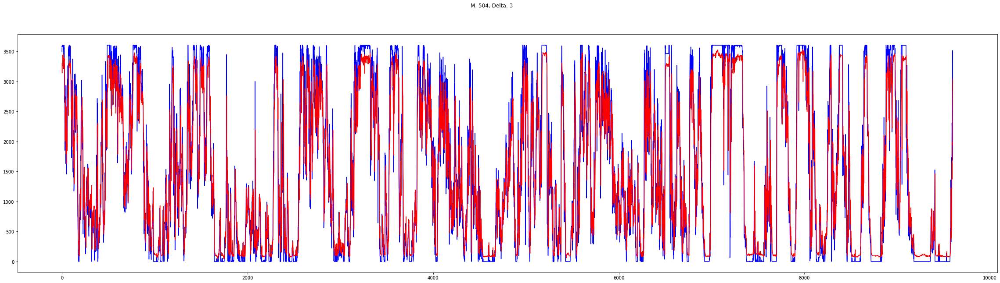

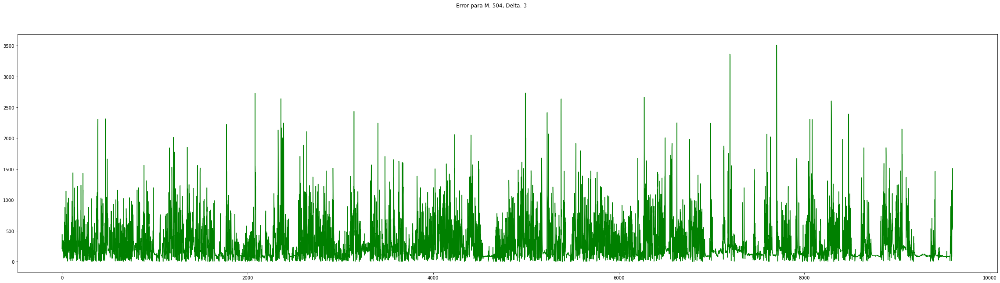

[0]	train-rmse:1.11888	eval-rmse:1.04031
[1]	train-rmse:1.11888	eval-rmse:1.04031
[2]	train-rmse:1.11888	eval-rmse:1.04031
[3]	train-rmse:1.11888	eval-rmse:1.04031
[4]	train-rmse:1.11888	eval-rmse:1.04031
[0]	train-rmse:1.09657	eval-rmse:1.03124
[1]	train-rmse:1.07816	eval-rmse:1.02518
[2]	train-rmse:1.06302	eval-rmse:1.02146
[3]	train-rmse:1.05059	eval-rmse:1.01953
[4]	train-rmse:1.04042	eval-rmse:1.01896
[5]	train-rmse:1.03210	eval-rmse:1.01937
[6]	train-rmse:1.02532	eval-rmse:1.02052
[7]	train-rmse:1.01979	eval-rmse:1.02215
[8]	train-rmse:1.01529	eval-rmse:1.02412
[9]	train-rmse:1.01163	eval-rmse:1.02629
[0]	train-rmse:1.07622	eval-rmse:1.02463
[1]	train-rmse:1.04801	eval-rmse:1.01929
[2]	train-rmse:1.02954	eval-rmse:1.01971
[3]	train-rmse:1.01755	eval-rmse:1.02305
[4]	train-rmse:1.00980	eval-rmse:1.02762
[5]	train-rmse:1.00481	eval-rmse:1.03249
[0]	train-rmse:1.05794	eval-rmse:1.02053
[1]	train-rmse:1.02676	eval-rmse:1.02020
[2]	train-rmse:1.01113	eval-rmse:1.02664
[3]	train-rmse:1

[3]	train-rmse:0.91429	eval-rmse:0.88295
[4]	train-rmse:0.88018	eval-rmse:0.85814
[5]	train-rmse:0.85067	eval-rmse:0.83656
[6]	train-rmse:0.82596	eval-rmse:0.81866
[7]	train-rmse:0.80484	eval-rmse:0.80357
[8]	train-rmse:0.78703	eval-rmse:0.79201
[9]	train-rmse:0.77181	eval-rmse:0.78139
[10]	train-rmse:0.75908	eval-rmse:0.77444
[11]	train-rmse:0.74801	eval-rmse:0.76914
[12]	train-rmse:0.73849	eval-rmse:0.76436
[13]	train-rmse:0.73028	eval-rmse:0.76041
[14]	train-rmse:0.72312	eval-rmse:0.75665
[15]	train-rmse:0.71685	eval-rmse:0.75397
[16]	train-rmse:0.71116	eval-rmse:0.75269
[17]	train-rmse:0.70625	eval-rmse:0.75082
[18]	train-rmse:0.70217	eval-rmse:0.74874
[19]	train-rmse:0.69845	eval-rmse:0.74719
[20]	train-rmse:0.69503	eval-rmse:0.74657
[21]	train-rmse:0.69164	eval-rmse:0.74566
[22]	train-rmse:0.68896	eval-rmse:0.74522
[23]	train-rmse:0.68549	eval-rmse:0.74491
[24]	train-rmse:0.68266	eval-rmse:0.74450
[25]	train-rmse:0.67979	eval-rmse:0.74385
[26]	train-rmse:0.67747	eval-rmse:0.74384

[3]	train-rmse:0.64435	eval-rmse:0.79609
[4]	train-rmse:0.62896	eval-rmse:0.79789
[5]	train-rmse:0.61931	eval-rmse:0.80160
[6]	train-rmse:0.60748	eval-rmse:0.80845
[0]	train-rmse:0.72774	eval-rmse:0.78468
[1]	train-rmse:0.68054	eval-rmse:0.78830
[2]	train-rmse:0.65641	eval-rmse:0.79545
[3]	train-rmse:0.63977	eval-rmse:0.80421
[4]	train-rmse:0.62725	eval-rmse:0.80533
[5]	train-rmse:0.61440	eval-rmse:0.81162
[0]	train-rmse:0.71201	eval-rmse:0.78228
[1]	train-rmse:0.67994	eval-rmse:0.78752
[2]	train-rmse:0.66184	eval-rmse:0.80392
[3]	train-rmse:0.64096	eval-rmse:0.81310
[4]	train-rmse:0.62582	eval-rmse:0.82195
[5]	train-rmse:0.61304	eval-rmse:0.82360
[0]	train-rmse:1.11888	eval-rmse:1.04031
[1]	train-rmse:1.11888	eval-rmse:1.04031
[2]	train-rmse:1.11888	eval-rmse:1.04031
[3]	train-rmse:1.11888	eval-rmse:1.04031
[4]	train-rmse:1.11888	eval-rmse:1.04031
[0]	train-rmse:1.05013	eval-rmse:0.99081
[1]	train-rmse:0.99009	eval-rmse:0.94855
[2]	train-rmse:0.93834	eval-rmse:0.91361
[3]	train-rmse:0

[2]	train-rmse:0.56264	eval-rmse:0.82259
[3]	train-rmse:0.52252	eval-rmse:0.83473
[4]	train-rmse:0.50586	eval-rmse:0.84003
[5]	train-rmse:0.47863	eval-rmse:0.85884
[0]	train-rmse:0.67740	eval-rmse:0.80842
[1]	train-rmse:0.59665	eval-rmse:0.83254
[2]	train-rmse:0.54620	eval-rmse:0.85329
[3]	train-rmse:0.53327	eval-rmse:0.85673
[4]	train-rmse:0.52138	eval-rmse:0.85861
[5]	train-rmse:0.50328	eval-rmse:0.86612
[0]	train-rmse:0.65860	eval-rmse:0.81300
[1]	train-rmse:0.59007	eval-rmse:0.84931
[2]	train-rmse:0.54251	eval-rmse:0.87287
[3]	train-rmse:0.51147	eval-rmse:0.88418
[4]	train-rmse:0.48543	eval-rmse:0.88980
[5]	train-rmse:0.47952	eval-rmse:0.89035
[0]	train-rmse:1.11888	eval-rmse:1.04031
[1]	train-rmse:1.11888	eval-rmse:1.04031
[2]	train-rmse:1.11888	eval-rmse:1.04031
[3]	train-rmse:1.11888	eval-rmse:1.04031
[4]	train-rmse:1.11888	eval-rmse:1.04031
[0]	train-rmse:1.04224	eval-rmse:0.98888
[1]	train-rmse:0.97545	eval-rmse:0.94674
[2]	train-rmse:0.91484	eval-rmse:0.91542
[3]	train-rmse:0

[0]	train-rmse:1.11888	eval-rmse:1.04031
[1]	train-rmse:1.11888	eval-rmse:1.04031
[2]	train-rmse:1.11888	eval-rmse:1.04031
[3]	train-rmse:1.11888	eval-rmse:1.04031
[4]	train-rmse:1.11888	eval-rmse:1.04031
[0]	train-rmse:1.03305	eval-rmse:0.99188
[1]	train-rmse:0.95652	eval-rmse:0.95070
[2]	train-rmse:0.88480	eval-rmse:0.91887
[3]	train-rmse:0.82076	eval-rmse:0.89064
[4]	train-rmse:0.76641	eval-rmse:0.86690
[5]	train-rmse:0.71445	eval-rmse:0.84995
[6]	train-rmse:0.66751	eval-rmse:0.83480
[7]	train-rmse:0.62651	eval-rmse:0.82338
[8]	train-rmse:0.58936	eval-rmse:0.81397
[9]	train-rmse:0.55521	eval-rmse:0.80585
[10]	train-rmse:0.52306	eval-rmse:0.80029
[11]	train-rmse:0.49396	eval-rmse:0.79617
[12]	train-rmse:0.46735	eval-rmse:0.79177
[13]	train-rmse:0.44252	eval-rmse:0.78880
[14]	train-rmse:0.41949	eval-rmse:0.78662
[15]	train-rmse:0.39739	eval-rmse:0.78551
[16]	train-rmse:0.37811	eval-rmse:0.78520
[17]	train-rmse:0.36079	eval-rmse:0.78401
[18]	train-rmse:0.34449	eval-rmse:0.78320
[19]	tr

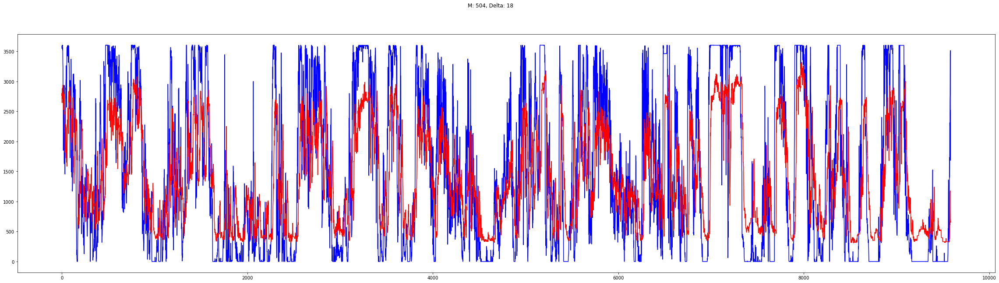

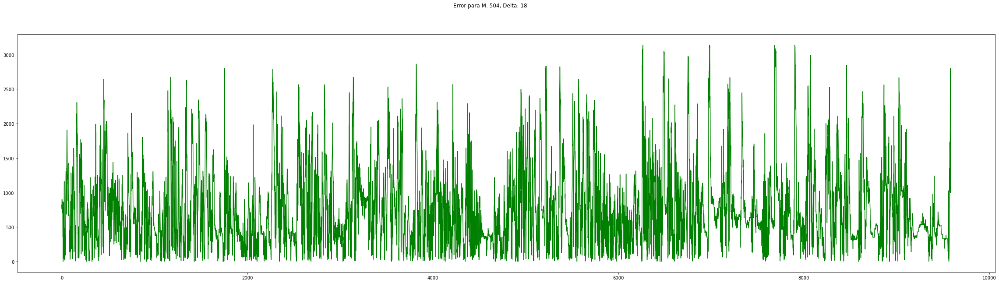

[0]	train-rmse:1.11859	eval-rmse:1.03998
[1]	train-rmse:1.11859	eval-rmse:1.03998
[2]	train-rmse:1.11859	eval-rmse:1.03998
[3]	train-rmse:1.11859	eval-rmse:1.03998
[4]	train-rmse:1.11859	eval-rmse:1.03998
[5]	train-rmse:1.11859	eval-rmse:1.03998
[0]	train-rmse:1.09635	eval-rmse:1.03080
[1]	train-rmse:1.07803	eval-rmse:1.02463
[2]	train-rmse:1.06294	eval-rmse:1.02081
[3]	train-rmse:1.05056	eval-rmse:1.01878
[4]	train-rmse:1.04043	eval-rmse:1.01811
[5]	train-rmse:1.03215	eval-rmse:1.01844
[6]	train-rmse:1.02539	eval-rmse:1.01950
[7]	train-rmse:1.01988	eval-rmse:1.02106
[8]	train-rmse:1.01540	eval-rmse:1.02296
[0]	train-rmse:1.07609	eval-rmse:1.02407
[1]	train-rmse:1.04799	eval-rmse:1.01851
[2]	train-rmse:1.02960	eval-rmse:1.01874
[3]	train-rmse:1.01765	eval-rmse:1.02192
[4]	train-rmse:1.00993	eval-rmse:1.02637
[5]	train-rmse:1.00497	eval-rmse:1.03112
[6]	train-rmse:1.00177	eval-rmse:1.03569
[0]	train-rmse:1.05788	eval-rmse:1.01984
[1]	train-rmse:1.02682	eval-rmse:1.01920
[2]	train-rmse:1

[5]	train-rmse:1.11859	eval-rmse:1.03998
[0]	train-rmse:1.07493	eval-rmse:1.01020
[1]	train-rmse:1.03792	eval-rmse:0.98550
[2]	train-rmse:1.00683	eval-rmse:0.96530
[3]	train-rmse:0.98069	eval-rmse:0.94874
[4]	train-rmse:0.95877	eval-rmse:0.93532
[5]	train-rmse:0.94011	eval-rmse:0.92624
[6]	train-rmse:0.92475	eval-rmse:0.91759
[7]	train-rmse:0.91192	eval-rmse:0.91056
[8]	train-rmse:0.90087	eval-rmse:0.90614
[9]	train-rmse:0.89172	eval-rmse:0.90171
[10]	train-rmse:0.88369	eval-rmse:0.89842
[11]	train-rmse:0.87705	eval-rmse:0.89654
[12]	train-rmse:0.87113	eval-rmse:0.89579
[13]	train-rmse:0.86598	eval-rmse:0.89589
[14]	train-rmse:0.86083	eval-rmse:0.89530
[15]	train-rmse:0.85687	eval-rmse:0.89465
[16]	train-rmse:0.85297	eval-rmse:0.89459
[17]	train-rmse:0.84982	eval-rmse:0.89443
[18]	train-rmse:0.84707	eval-rmse:0.89492
[19]	train-rmse:0.84415	eval-rmse:0.89525
[20]	train-rmse:0.84177	eval-rmse:0.89597
[21]	train-rmse:0.83963	eval-rmse:0.89560
[0]	train-rmse:1.03431	eval-rmse:0.98345
[1]	

[2]	train-rmse:0.90064	eval-rmse:0.92717
[3]	train-rmse:0.86277	eval-rmse:0.91684
[4]	train-rmse:0.83469	eval-rmse:0.90861
[5]	train-rmse:0.81267	eval-rmse:0.90450
[6]	train-rmse:0.79520	eval-rmse:0.90330
[7]	train-rmse:0.77936	eval-rmse:0.90381
[8]	train-rmse:0.76564	eval-rmse:0.90431
[9]	train-rmse:0.75645	eval-rmse:0.90492
[10]	train-rmse:0.74621	eval-rmse:0.90529
[11]	train-rmse:0.73562	eval-rmse:0.90720
[0]	train-rmse:0.97970	eval-rmse:0.96175
[1]	train-rmse:0.89497	eval-rmse:0.92784
[2]	train-rmse:0.84397	eval-rmse:0.91192
[3]	train-rmse:0.80887	eval-rmse:0.90654
[4]	train-rmse:0.78691	eval-rmse:0.90346
[5]	train-rmse:0.76760	eval-rmse:0.90844
[6]	train-rmse:0.75135	eval-rmse:0.90921
[7]	train-rmse:0.73622	eval-rmse:0.91434
[8]	train-rmse:0.72275	eval-rmse:0.91702
[0]	train-rmse:0.94101	eval-rmse:0.94374
[1]	train-rmse:0.85335	eval-rmse:0.91624
[2]	train-rmse:0.80721	eval-rmse:0.91469
[3]	train-rmse:0.78154	eval-rmse:0.91731
[4]	train-rmse:0.75826	eval-rmse:0.92126
[5]	train-rmse

[4]	train-rmse:0.54616	eval-rmse:1.08346
[5]	train-rmse:0.53345	eval-rmse:1.08743
[0]	train-rmse:0.75525	eval-rmse:1.00132
[1]	train-rmse:0.68095	eval-rmse:1.03254
[2]	train-rmse:0.65303	eval-rmse:1.03963
[3]	train-rmse:0.60894	eval-rmse:1.06940
[4]	train-rmse:0.56934	eval-rmse:1.08791
[0]	train-rmse:1.11859	eval-rmse:1.03998
[1]	train-rmse:1.11859	eval-rmse:1.03998
[2]	train-rmse:1.11859	eval-rmse:1.03998
[3]	train-rmse:1.11859	eval-rmse:1.03998
[4]	train-rmse:1.11859	eval-rmse:1.03998
[5]	train-rmse:1.11859	eval-rmse:1.03998
[0]	train-rmse:1.05171	eval-rmse:1.01205
[1]	train-rmse:0.99207	eval-rmse:0.98696
[2]	train-rmse:0.93958	eval-rmse:0.96866
[3]	train-rmse:0.89248	eval-rmse:0.95588
[4]	train-rmse:0.84962	eval-rmse:0.94739
[5]	train-rmse:0.81069	eval-rmse:0.93969
[6]	train-rmse:0.77550	eval-rmse:0.93414
[7]	train-rmse:0.74412	eval-rmse:0.92780
[8]	train-rmse:0.71512	eval-rmse:0.92597
[9]	train-rmse:0.68846	eval-rmse:0.92383
[10]	train-rmse:0.66470	eval-rmse:0.92334
[11]	train-rmse

[2]	train-rmse:0.42085	eval-rmse:1.02456
[3]	train-rmse:0.34927	eval-rmse:1.03752
[4]	train-rmse:0.29933	eval-rmse:1.04366
[5]	train-rmse:0.25513	eval-rmse:1.04853
[0]	train-rmse:0.68805	eval-rmse:1.01644
[1]	train-rmse:0.49281	eval-rmse:1.04857
[2]	train-rmse:0.37283	eval-rmse:1.07839
[3]	train-rmse:0.33489	eval-rmse:1.08340
[4]	train-rmse:0.27863	eval-rmse:1.09416
[0]	train-rmse:0.63827	eval-rmse:1.04267
[1]	train-rmse:0.46436	eval-rmse:1.09189
[2]	train-rmse:0.36241	eval-rmse:1.10440
[3]	train-rmse:0.30868	eval-rmse:1.11140
[4]	train-rmse:0.29658	eval-rmse:1.11366
[5]	train-rmse:0.27096	eval-rmse:1.10846
[0]	train-rmse:0.59961	eval-rmse:1.07652
[1]	train-rmse:0.44702	eval-rmse:1.11126
[2]	train-rmse:0.34876	eval-rmse:1.12812
[3]	train-rmse:0.33939	eval-rmse:1.12811
[4]	train-rmse:0.30064	eval-rmse:1.13392
[0]	train-rmse:0.57431	eval-rmse:1.11731
[1]	train-rmse:0.47916	eval-rmse:1.15018
[2]	train-rmse:0.39931	eval-rmse:1.16494
[3]	train-rmse:0.32356	eval-rmse:1.18665
[4]	train-rmse:0

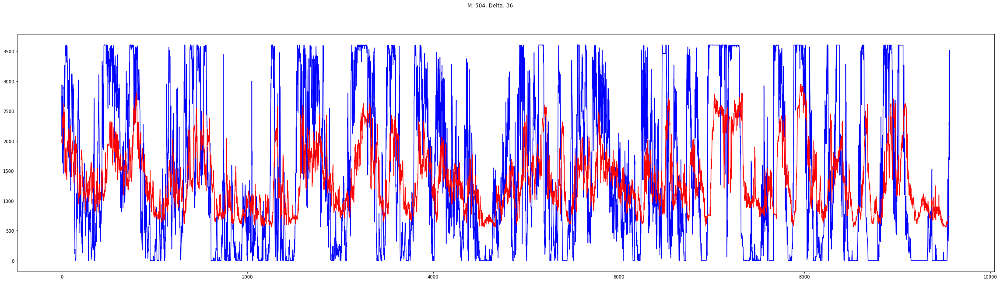

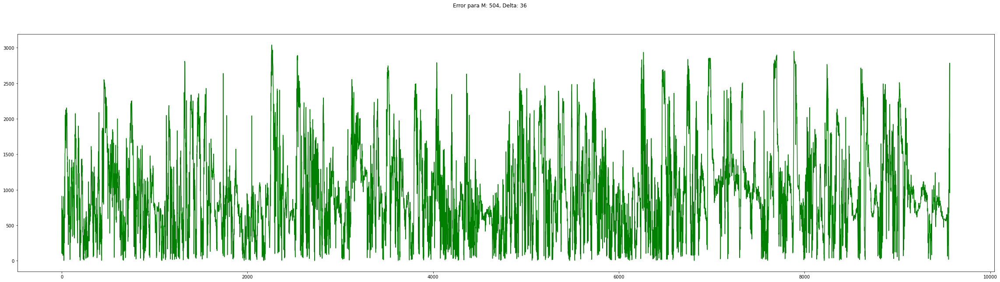

[0]	train-rmse:1.11884	eval-rmse:1.04120
[1]	train-rmse:1.11884	eval-rmse:1.04120
[2]	train-rmse:1.11884	eval-rmse:1.04120
[3]	train-rmse:1.11884	eval-rmse:1.04120
[4]	train-rmse:1.11884	eval-rmse:1.04120
[0]	train-rmse:1.09672	eval-rmse:1.03191
[1]	train-rmse:1.07847	eval-rmse:1.02563
[2]	train-rmse:1.06347	eval-rmse:1.02170
[3]	train-rmse:1.05115	eval-rmse:1.01956
[4]	train-rmse:1.04107	eval-rmse:1.01879
[5]	train-rmse:1.03283	eval-rmse:1.01902
[6]	train-rmse:1.02610	eval-rmse:1.01998
[7]	train-rmse:1.02063	eval-rmse:1.02146
[8]	train-rmse:1.01618	eval-rmse:1.02328
[9]	train-rmse:1.01255	eval-rmse:1.02532
[0]	train-rmse:1.07654	eval-rmse:1.02506
[1]	train-rmse:1.04859	eval-rmse:1.01927
[2]	train-rmse:1.03029	eval-rmse:1.01929
[3]	train-rmse:1.01841	eval-rmse:1.02229
[4]	train-rmse:1.01074	eval-rmse:1.02658
[5]	train-rmse:1.00579	eval-rmse:1.03120
[6]	train-rmse:1.00262	eval-rmse:1.03566
[0]	train-rmse:1.05842	eval-rmse:1.02069
[1]	train-rmse:1.02754	eval-rmse:1.01971
[2]	train-rmse:1

[2]	train-rmse:0.91050	eval-rmse:1.02563
[3]	train-rmse:0.90206	eval-rmse:1.03462
[4]	train-rmse:0.89721	eval-rmse:1.03427
[5]	train-rmse:0.89082	eval-rmse:1.04221
[0]	train-rmse:0.93819	eval-rmse:1.00625
[1]	train-rmse:0.92125	eval-rmse:1.02415
[2]	train-rmse:0.91074	eval-rmse:1.03109
[3]	train-rmse:0.90151	eval-rmse:1.03842
[4]	train-rmse:0.89703	eval-rmse:1.04148
[0]	train-rmse:1.11884	eval-rmse:1.04120
[1]	train-rmse:1.11884	eval-rmse:1.04120
[2]	train-rmse:1.11884	eval-rmse:1.04120
[3]	train-rmse:1.11884	eval-rmse:1.04120
[4]	train-rmse:1.11884	eval-rmse:1.04120
[0]	train-rmse:1.08342	eval-rmse:1.02578
[1]	train-rmse:1.05331	eval-rmse:1.01353
[2]	train-rmse:1.02772	eval-rmse:1.00691
[3]	train-rmse:1.00572	eval-rmse:1.00135
[4]	train-rmse:0.98717	eval-rmse:0.99791
[5]	train-rmse:0.97095	eval-rmse:0.99279
[6]	train-rmse:0.95698	eval-rmse:0.99085
[7]	train-rmse:0.94536	eval-rmse:0.99053
[8]	train-rmse:0.93508	eval-rmse:0.99167
[9]	train-rmse:0.92527	eval-rmse:0.99130
[10]	train-rmse:

[4]	train-rmse:0.73426	eval-rmse:1.09224
[5]	train-rmse:0.69630	eval-rmse:1.11577
[0]	train-rmse:0.85733	eval-rmse:1.05027
[1]	train-rmse:0.79806	eval-rmse:1.09951
[2]	train-rmse:0.78439	eval-rmse:1.10806
[3]	train-rmse:0.76699	eval-rmse:1.10650
[4]	train-rmse:0.71369	eval-rmse:1.14742
[0]	train-rmse:1.11884	eval-rmse:1.04120
[1]	train-rmse:1.11884	eval-rmse:1.04120
[2]	train-rmse:1.11884	eval-rmse:1.04120
[3]	train-rmse:1.11884	eval-rmse:1.04120
[4]	train-rmse:1.11884	eval-rmse:1.04120
[5]	train-rmse:1.11884	eval-rmse:1.04120
[0]	train-rmse:1.06652	eval-rmse:1.02626
[1]	train-rmse:1.01961	eval-rmse:1.01358
[2]	train-rmse:0.97993	eval-rmse:1.00883
[3]	train-rmse:0.94062	eval-rmse:1.00038
[4]	train-rmse:0.90763	eval-rmse:0.99699
[5]	train-rmse:0.87683	eval-rmse:0.99514
[6]	train-rmse:0.85046	eval-rmse:0.99675
[7]	train-rmse:0.82730	eval-rmse:0.99598
[8]	train-rmse:0.80394	eval-rmse:0.99782
[9]	train-rmse:0.78373	eval-rmse:1.00003
[0]	train-rmse:1.01741	eval-rmse:1.01630
[1]	train-rmse:0

[2]	train-rmse:1.11884	eval-rmse:1.04120
[3]	train-rmse:1.11884	eval-rmse:1.04120
[4]	train-rmse:1.11884	eval-rmse:1.04120
[5]	train-rmse:1.11884	eval-rmse:1.04120
[0]	train-rmse:1.04188	eval-rmse:1.02767
[1]	train-rmse:0.97383	eval-rmse:1.01829
[2]	train-rmse:0.90956	eval-rmse:1.00981
[3]	train-rmse:0.85248	eval-rmse:1.01101
[4]	train-rmse:0.79951	eval-rmse:1.01037
[5]	train-rmse:0.75267	eval-rmse:1.01224
[6]	train-rmse:0.70962	eval-rmse:1.01565
[7]	train-rmse:0.67326	eval-rmse:1.01860
[0]	train-rmse:0.96772	eval-rmse:1.02183
[1]	train-rmse:0.84498	eval-rmse:1.01758
[2]	train-rmse:0.74408	eval-rmse:1.01833
[3]	train-rmse:0.66653	eval-rmse:1.02873
[4]	train-rmse:0.60328	eval-rmse:1.04046
[5]	train-rmse:0.54962	eval-rmse:1.05002
[6]	train-rmse:0.49900	eval-rmse:1.06154
[0]	train-rmse:0.89705	eval-rmse:1.02380
[1]	train-rmse:0.73632	eval-rmse:1.03741
[2]	train-rmse:0.62656	eval-rmse:1.05093
[3]	train-rmse:0.54140	eval-rmse:1.06427
[4]	train-rmse:0.46410	eval-rmse:1.08355
[0]	train-rmse:0

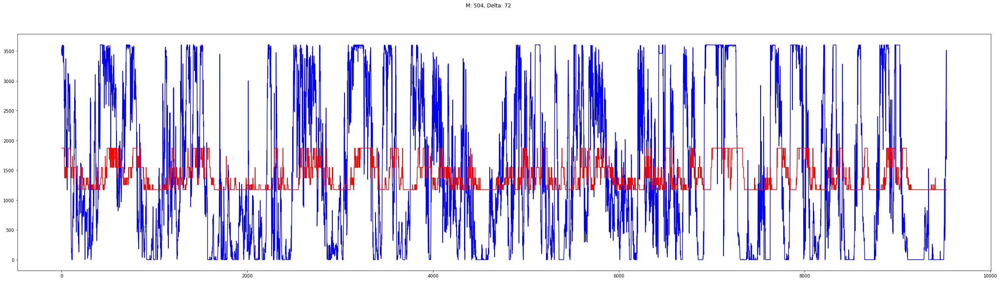

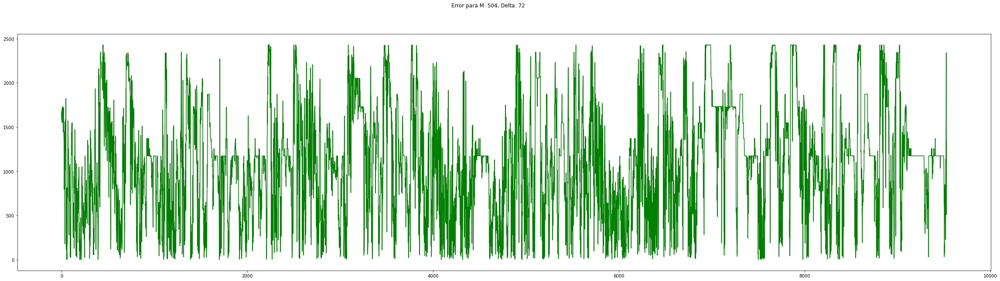

Wind Speed (m/s)
[0]	train-rmse:1.11975	eval-rmse:0.93363
[1]	train-rmse:1.11975	eval-rmse:0.93363
[2]	train-rmse:1.11975	eval-rmse:0.93363
[3]	train-rmse:1.11975	eval-rmse:0.93363
[4]	train-rmse:1.11975	eval-rmse:0.93363
[0]	train-rmse:1.09823	eval-rmse:0.92089
[1]	train-rmse:1.08049	eval-rmse:0.91162
[2]	train-rmse:1.06590	eval-rmse:0.90512
[3]	train-rmse:1.05394	eval-rmse:0.90080
[4]	train-rmse:1.04415	eval-rmse:0.89816
[5]	train-rmse:1.03615	eval-rmse:0.89682
[6]	train-rmse:1.02962	eval-rmse:0.89644
[7]	train-rmse:1.02431	eval-rmse:0.89677
[8]	train-rmse:1.01998	eval-rmse:0.89762
[9]	train-rmse:1.01646	eval-rmse:0.89883
[10]	train-rmse:1.01360	eval-rmse:0.90027
[0]	train-rmse:1.07862	eval-rmse:0.91072
[1]	train-rmse:1.05145	eval-rmse:0.90004
[2]	train-rmse:1.03369	eval-rmse:0.89659
[3]	train-rmse:1.02215	eval-rmse:0.89712
[4]	train-rmse:1.01471	eval-rmse:0.89966
[5]	train-rmse:1.00991	eval-rmse:0.90303
[6]	train-rmse:1.00683	eval-rmse:0.90657
[0]	train-rmse:1.06101	eval-rmse:0.9032

[129]	train-rmse:0.35858	eval-rmse:0.33122
[130]	train-rmse:0.35854	eval-rmse:0.33121
[131]	train-rmse:0.35849	eval-rmse:0.33120
[132]	train-rmse:0.35845	eval-rmse:0.33120
[133]	train-rmse:0.35840	eval-rmse:0.33120
[134]	train-rmse:0.35836	eval-rmse:0.33119
[135]	train-rmse:0.35832	eval-rmse:0.33119
[136]	train-rmse:0.35828	eval-rmse:0.33121
[137]	train-rmse:0.35823	eval-rmse:0.33121
[138]	train-rmse:0.35819	eval-rmse:0.33118
[139]	train-rmse:0.35815	eval-rmse:0.33118
[140]	train-rmse:0.35811	eval-rmse:0.33118
[141]	train-rmse:0.35807	eval-rmse:0.33116
[142]	train-rmse:0.35803	eval-rmse:0.33115
[143]	train-rmse:0.35800	eval-rmse:0.33115
[144]	train-rmse:0.35796	eval-rmse:0.33115
[145]	train-rmse:0.35792	eval-rmse:0.33115
[146]	train-rmse:0.35789	eval-rmse:0.33115
[147]	train-rmse:0.35785	eval-rmse:0.33115
[0]	train-rmse:0.97661	eval-rmse:0.80876
[1]	train-rmse:0.86559	eval-rmse:0.70712
[2]	train-rmse:0.77619	eval-rmse:0.63857
[3]	train-rmse:0.70478	eval-rmse:0.57392
[4]	train-rmse:0.64

[18]	train-rmse:0.38803	eval-rmse:0.36652
[19]	train-rmse:0.38732	eval-rmse:0.36566
[20]	train-rmse:0.38651	eval-rmse:0.36476
[21]	train-rmse:0.38584	eval-rmse:0.36474
[22]	train-rmse:0.38529	eval-rmse:0.36416
[23]	train-rmse:0.38446	eval-rmse:0.36315
[24]	train-rmse:0.38384	eval-rmse:0.36298
[25]	train-rmse:0.38338	eval-rmse:0.36234
[26]	train-rmse:0.38270	eval-rmse:0.36154
[27]	train-rmse:0.38222	eval-rmse:0.36089
[28]	train-rmse:0.38165	eval-rmse:0.35954
[29]	train-rmse:0.38116	eval-rmse:0.35939
[30]	train-rmse:0.38074	eval-rmse:0.35895
[31]	train-rmse:0.38028	eval-rmse:0.35836
[32]	train-rmse:0.37976	eval-rmse:0.35768
[33]	train-rmse:0.37937	eval-rmse:0.35720
[34]	train-rmse:0.37893	eval-rmse:0.35668
[35]	train-rmse:0.37849	eval-rmse:0.35558
[36]	train-rmse:0.37810	eval-rmse:0.35582
[37]	train-rmse:0.37776	eval-rmse:0.35558
[38]	train-rmse:0.37742	eval-rmse:0.35556
[39]	train-rmse:0.37712	eval-rmse:0.35557
[40]	train-rmse:0.37685	eval-rmse:0.35546
[41]	train-rmse:0.37655	eval-rmse:

[13]	train-rmse:0.40406	eval-rmse:0.38587
[14]	train-rmse:0.40174	eval-rmse:0.38291
[15]	train-rmse:0.39988	eval-rmse:0.37825
[16]	train-rmse:0.39827	eval-rmse:0.37715
[17]	train-rmse:0.39693	eval-rmse:0.37772
[18]	train-rmse:0.39544	eval-rmse:0.37607
[19]	train-rmse:0.39365	eval-rmse:0.37386
[20]	train-rmse:0.39242	eval-rmse:0.37065
[21]	train-rmse:0.39131	eval-rmse:0.36920
[22]	train-rmse:0.38976	eval-rmse:0.36729
[23]	train-rmse:0.38833	eval-rmse:0.36578
[24]	train-rmse:0.38746	eval-rmse:0.36583
[25]	train-rmse:0.38655	eval-rmse:0.36470
[26]	train-rmse:0.38541	eval-rmse:0.36312
[27]	train-rmse:0.38465	eval-rmse:0.36225
[28]	train-rmse:0.38375	eval-rmse:0.36108
[29]	train-rmse:0.38297	eval-rmse:0.35892
[30]	train-rmse:0.38213	eval-rmse:0.35866
[31]	train-rmse:0.38137	eval-rmse:0.35863
[32]	train-rmse:0.38068	eval-rmse:0.35840
[33]	train-rmse:0.38013	eval-rmse:0.35818
[34]	train-rmse:0.37943	eval-rmse:0.35736
[35]	train-rmse:0.37877	eval-rmse:0.35658
[36]	train-rmse:0.37824	eval-rmse:

[63]	train-rmse:0.36490	eval-rmse:0.34397
[64]	train-rmse:0.36470	eval-rmse:0.34326
[65]	train-rmse:0.36451	eval-rmse:0.34328
[66]	train-rmse:0.36434	eval-rmse:0.34348
[67]	train-rmse:0.36416	eval-rmse:0.34357
[68]	train-rmse:0.36400	eval-rmse:0.34361
[69]	train-rmse:0.36378	eval-rmse:0.34315
[70]	train-rmse:0.36363	eval-rmse:0.34314
[71]	train-rmse:0.36344	eval-rmse:0.34247
[72]	train-rmse:0.36329	eval-rmse:0.34225
[73]	train-rmse:0.36307	eval-rmse:0.34227
[74]	train-rmse:0.36287	eval-rmse:0.34198
[75]	train-rmse:0.36269	eval-rmse:0.34198
[76]	train-rmse:0.36252	eval-rmse:0.34175
[77]	train-rmse:0.36233	eval-rmse:0.34175
[78]	train-rmse:0.36218	eval-rmse:0.34182
[79]	train-rmse:0.36203	eval-rmse:0.34179
[80]	train-rmse:0.36187	eval-rmse:0.34180
[0]	train-rmse:1.11975	eval-rmse:0.93363
[1]	train-rmse:1.11975	eval-rmse:0.93363
[2]	train-rmse:1.11975	eval-rmse:0.93363
[3]	train-rmse:1.11975	eval-rmse:0.93363
[4]	train-rmse:1.11975	eval-rmse:0.93363
[5]	train-rmse:1.11975	eval-rmse:0.9336

[20]	train-rmse:0.35875	eval-rmse:0.33927
[21]	train-rmse:0.35836	eval-rmse:0.33933
[22]	train-rmse:0.35812	eval-rmse:0.33932
[23]	train-rmse:0.35763	eval-rmse:0.33908
[24]	train-rmse:0.35732	eval-rmse:0.33908
[25]	train-rmse:0.35710	eval-rmse:0.33899
[26]	train-rmse:0.35686	eval-rmse:0.33914
[27]	train-rmse:0.35611	eval-rmse:0.33926
[28]	train-rmse:0.35563	eval-rmse:0.33909
[29]	train-rmse:0.35513	eval-rmse:0.33888
[30]	train-rmse:0.35479	eval-rmse:0.33890
[31]	train-rmse:0.35458	eval-rmse:0.33892
[32]	train-rmse:0.35429	eval-rmse:0.33898
[33]	train-rmse:0.35401	eval-rmse:0.33903
[0]	train-rmse:0.61310	eval-rmse:0.52680
[1]	train-rmse:0.44241	eval-rmse:0.39676
[2]	train-rmse:0.39669	eval-rmse:0.36535
[3]	train-rmse:0.38552	eval-rmse:0.35881
[4]	train-rmse:0.38162	eval-rmse:0.35390
[5]	train-rmse:0.37872	eval-rmse:0.35443
[6]	train-rmse:0.37725	eval-rmse:0.35433
[7]	train-rmse:0.37562	eval-rmse:0.35352
[8]	train-rmse:0.37343	eval-rmse:0.35249
[9]	train-rmse:0.37158	eval-rmse:0.34986
[1

[8]	train-rmse:0.36125	eval-rmse:0.33163
[9]	train-rmse:0.35861	eval-rmse:0.33101
[10]	train-rmse:0.35685	eval-rmse:0.33071
[11]	train-rmse:0.35518	eval-rmse:0.33041
[12]	train-rmse:0.35422	eval-rmse:0.33018
[13]	train-rmse:0.35322	eval-rmse:0.33026
[14]	train-rmse:0.35269	eval-rmse:0.33046
[15]	train-rmse:0.35190	eval-rmse:0.33058
[16]	train-rmse:0.35145	eval-rmse:0.33058
[0]	train-rmse:0.74089	eval-rmse:0.62372
[1]	train-rmse:0.53647	eval-rmse:0.46070
[2]	train-rmse:0.43724	eval-rmse:0.38393
[3]	train-rmse:0.39272	eval-rmse:0.35151
[4]	train-rmse:0.37395	eval-rmse:0.33974
[5]	train-rmse:0.36509	eval-rmse:0.33493
[6]	train-rmse:0.36035	eval-rmse:0.33374
[7]	train-rmse:0.35815	eval-rmse:0.33339
[8]	train-rmse:0.35629	eval-rmse:0.33328
[9]	train-rmse:0.35453	eval-rmse:0.33375
[10]	train-rmse:0.35372	eval-rmse:0.33381
[11]	train-rmse:0.35265	eval-rmse:0.33353
[12]	train-rmse:0.35150	eval-rmse:0.33346
[0]	train-rmse:0.65400	eval-rmse:0.55444
[1]	train-rmse:0.46028	eval-rmse:0.40299
[2]	tr

[8]	train-rmse:0.34189	eval-rmse:0.33315
[9]	train-rmse:0.33956	eval-rmse:0.33398
[10]	train-rmse:0.33807	eval-rmse:0.33417
[0]	train-rmse:0.56269	eval-rmse:0.48103
[1]	train-rmse:0.40109	eval-rmse:0.35997
[2]	train-rmse:0.36358	eval-rmse:0.33624
[3]	train-rmse:0.35390	eval-rmse:0.33364
[4]	train-rmse:0.34980	eval-rmse:0.33345
[5]	train-rmse:0.34596	eval-rmse:0.33488
[6]	train-rmse:0.34290	eval-rmse:0.33543
[7]	train-rmse:0.34163	eval-rmse:0.33533
[8]	train-rmse:0.33798	eval-rmse:0.33601
[0]	train-rmse:0.48825	eval-rmse:0.42361
[1]	train-rmse:0.37352	eval-rmse:0.34339
[2]	train-rmse:0.35578	eval-rmse:0.33681
[3]	train-rmse:0.35158	eval-rmse:0.33624
[4]	train-rmse:0.34963	eval-rmse:0.33625
[5]	train-rmse:0.34568	eval-rmse:0.33793
[6]	train-rmse:0.34261	eval-rmse:0.34027
[7]	train-rmse:0.33897	eval-rmse:0.34186
[0]	train-rmse:0.42713	eval-rmse:0.37835
[1]	train-rmse:0.36388	eval-rmse:0.33706
[2]	train-rmse:0.35741	eval-rmse:0.33561
[3]	train-rmse:0.35244	eval-rmse:0.33824
[4]	train-rmse:

[26]	train-rmse:0.32068	eval-rmse:0.33550
[27]	train-rmse:0.31818	eval-rmse:0.33482
[28]	train-rmse:0.31589	eval-rmse:0.33457
[29]	train-rmse:0.31399	eval-rmse:0.33421
[30]	train-rmse:0.31196	eval-rmse:0.33383
[31]	train-rmse:0.31028	eval-rmse:0.33381
[32]	train-rmse:0.30852	eval-rmse:0.33360
[33]	train-rmse:0.30706	eval-rmse:0.33364
[34]	train-rmse:0.30561	eval-rmse:0.33370
[35]	train-rmse:0.30404	eval-rmse:0.33381
[36]	train-rmse:0.30320	eval-rmse:0.33388
[0]	train-rmse:0.92086	eval-rmse:0.77087
[1]	train-rmse:0.76595	eval-rmse:0.64565
[2]	train-rmse:0.64689	eval-rmse:0.55193
[3]	train-rmse:0.55658	eval-rmse:0.48255
[4]	train-rmse:0.48925	eval-rmse:0.43297
[5]	train-rmse:0.43943	eval-rmse:0.39874
[6]	train-rmse:0.40348	eval-rmse:0.37562
[7]	train-rmse:0.37703	eval-rmse:0.36017
[8]	train-rmse:0.35844	eval-rmse:0.34998
[9]	train-rmse:0.34532	eval-rmse:0.34372
[10]	train-rmse:0.33566	eval-rmse:0.33978
[11]	train-rmse:0.32825	eval-rmse:0.33776
[12]	train-rmse:0.32233	eval-rmse:0.33623
[1

[7]	train-rmse:0.28024	eval-rmse:0.35157
[8]	train-rmse:0.27858	eval-rmse:0.35158
[0]	train-rmse:0.47089	eval-rmse:0.42170
[1]	train-rmse:0.34195	eval-rmse:0.34760
[2]	train-rmse:0.31605	eval-rmse:0.34520
[3]	train-rmse:0.30426	eval-rmse:0.34812
[4]	train-rmse:0.29172	eval-rmse:0.35447
[5]	train-rmse:0.28302	eval-rmse:0.35588
[6]	train-rmse:0.27959	eval-rmse:0.35736
[0]	train-rmse:0.40555	eval-rmse:0.37672
[1]	train-rmse:0.33010	eval-rmse:0.34207
[2]	train-rmse:0.31128	eval-rmse:0.34794
[3]	train-rmse:0.29849	eval-rmse:0.35272
[4]	train-rmse:0.29131	eval-rmse:0.35503
[5]	train-rmse:0.28740	eval-rmse:0.35600
[0]	train-rmse:0.36021	eval-rmse:0.34901
[1]	train-rmse:0.32719	eval-rmse:0.34629
[2]	train-rmse:0.31215	eval-rmse:0.35290
[3]	train-rmse:0.30597	eval-rmse:0.35482
[4]	train-rmse:0.29811	eval-rmse:0.35706
[5]	train-rmse:0.29378	eval-rmse:0.35845
[6]	train-rmse:0.28734	eval-rmse:0.36072
[0]	train-rmse:1.11975	eval-rmse:0.93363
[1]	train-rmse:1.11975	eval-rmse:0.93363
[2]	train-rmse:1

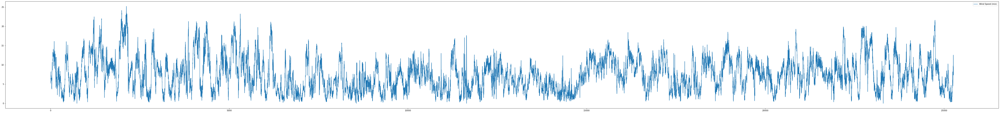

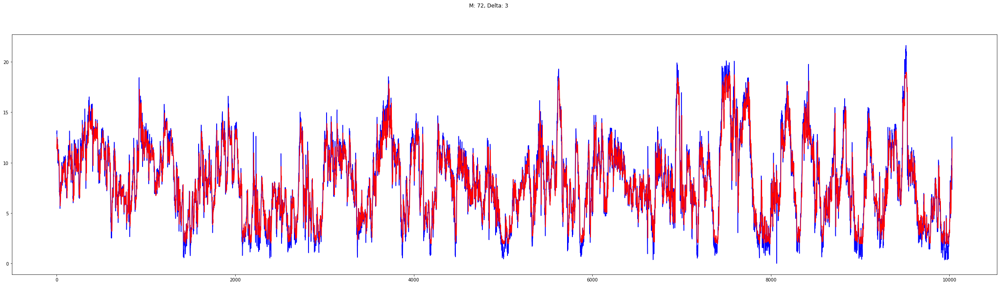

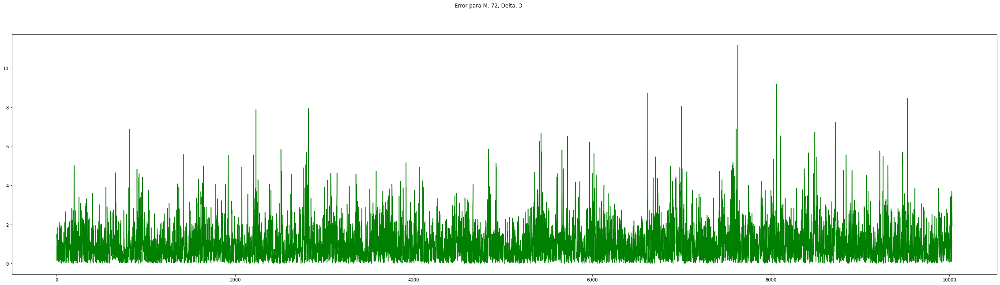

[0]	train-rmse:1.11999	eval-rmse:0.93405
[1]	train-rmse:1.11999	eval-rmse:0.93405
[2]	train-rmse:1.11999	eval-rmse:0.93405
[3]	train-rmse:1.11999	eval-rmse:0.93405
[4]	train-rmse:1.11999	eval-rmse:0.93405
[5]	train-rmse:1.11999	eval-rmse:0.93405
[0]	train-rmse:1.09836	eval-rmse:0.92121
[1]	train-rmse:1.08053	eval-rmse:0.91187
[2]	train-rmse:1.06586	eval-rmse:0.90531
[3]	train-rmse:1.05384	eval-rmse:0.90095
[4]	train-rmse:1.04399	eval-rmse:0.89828
[5]	train-rmse:1.03595	eval-rmse:0.89691
[6]	train-rmse:1.02939	eval-rmse:0.89651
[7]	train-rmse:1.02404	eval-rmse:0.89683
[8]	train-rmse:1.01969	eval-rmse:0.89767
[9]	train-rmse:1.01615	eval-rmse:0.89887
[10]	train-rmse:1.01328	eval-rmse:0.90031
[0]	train-rmse:1.07865	eval-rmse:0.91096
[1]	train-rmse:1.05133	eval-rmse:0.90018
[2]	train-rmse:1.03347	eval-rmse:0.89667
[3]	train-rmse:1.02188	eval-rmse:0.89717
[4]	train-rmse:1.01439	eval-rmse:0.89970
[5]	train-rmse:1.00956	eval-rmse:0.90307
[6]	train-rmse:1.00646	eval-rmse:0.90662
[0]	train-rmse:

[41]	train-rmse:0.68027	eval-rmse:0.64176
[42]	train-rmse:0.68001	eval-rmse:0.64177
[43]	train-rmse:0.67974	eval-rmse:0.64174
[44]	train-rmse:0.67949	eval-rmse:0.64186
[45]	train-rmse:0.67924	eval-rmse:0.64160
[46]	train-rmse:0.67899	eval-rmse:0.64196
[47]	train-rmse:0.67876	eval-rmse:0.64193
[48]	train-rmse:0.67855	eval-rmse:0.64196
[49]	train-rmse:0.67834	eval-rmse:0.64174
[50]	train-rmse:0.67812	eval-rmse:0.64149
[51]	train-rmse:0.67791	eval-rmse:0.64174
[52]	train-rmse:0.67769	eval-rmse:0.64172
[53]	train-rmse:0.67749	eval-rmse:0.64188
[54]	train-rmse:0.67729	eval-rmse:0.64203
[55]	train-rmse:0.67710	eval-rmse:0.64201
[0]	train-rmse:0.97239	eval-rmse:0.81615
[1]	train-rmse:0.88150	eval-rmse:0.75450
[2]	train-rmse:0.81776	eval-rmse:0.70882
[3]	train-rmse:0.78151	eval-rmse:0.68811
[4]	train-rmse:0.75222	eval-rmse:0.67384
[5]	train-rmse:0.73475	eval-rmse:0.66463
[6]	train-rmse:0.72259	eval-rmse:0.65726
[7]	train-rmse:0.71357	eval-rmse:0.65707
[8]	train-rmse:0.70710	eval-rmse:0.65594
[

[0]	train-rmse:0.80922	eval-rmse:0.73973
[1]	train-rmse:0.76564	eval-rmse:0.71360
[2]	train-rmse:0.73571	eval-rmse:0.69868
[3]	train-rmse:0.72694	eval-rmse:0.68069
[4]	train-rmse:0.71897	eval-rmse:0.68403
[5]	train-rmse:0.71568	eval-rmse:0.68096
[6]	train-rmse:0.71124	eval-rmse:0.67268
[7]	train-rmse:0.70603	eval-rmse:0.66952
[8]	train-rmse:0.70354	eval-rmse:0.66499
[9]	train-rmse:0.70081	eval-rmse:0.66350
[10]	train-rmse:0.69880	eval-rmse:0.66429
[11]	train-rmse:0.69695	eval-rmse:0.66214
[12]	train-rmse:0.69547	eval-rmse:0.65936
[13]	train-rmse:0.69381	eval-rmse:0.65921
[14]	train-rmse:0.69239	eval-rmse:0.65901
[15]	train-rmse:0.69125	eval-rmse:0.65801
[16]	train-rmse:0.69015	eval-rmse:0.65595
[17]	train-rmse:0.68918	eval-rmse:0.65695
[18]	train-rmse:0.68842	eval-rmse:0.65645
[19]	train-rmse:0.68717	eval-rmse:0.65551
[20]	train-rmse:0.68652	eval-rmse:0.65588
[21]	train-rmse:0.68555	eval-rmse:0.65634
[22]	train-rmse:0.68501	eval-rmse:0.65665
[23]	train-rmse:0.68401	eval-rmse:0.65503
[2

[13]	train-rmse:0.71034	eval-rmse:0.65295
[14]	train-rmse:0.70351	eval-rmse:0.65014
[15]	train-rmse:0.69774	eval-rmse:0.64819
[16]	train-rmse:0.69275	eval-rmse:0.64648
[17]	train-rmse:0.68850	eval-rmse:0.64544
[18]	train-rmse:0.68485	eval-rmse:0.64435
[19]	train-rmse:0.68171	eval-rmse:0.64377
[20]	train-rmse:0.67882	eval-rmse:0.64359
[21]	train-rmse:0.67646	eval-rmse:0.64320
[22]	train-rmse:0.67427	eval-rmse:0.64299
[23]	train-rmse:0.67247	eval-rmse:0.64287
[24]	train-rmse:0.67067	eval-rmse:0.64334
[25]	train-rmse:0.66914	eval-rmse:0.64313
[26]	train-rmse:0.66752	eval-rmse:0.64336
[27]	train-rmse:0.66616	eval-rmse:0.64328
[28]	train-rmse:0.66492	eval-rmse:0.64301
[0]	train-rmse:0.98822	eval-rmse:0.83493
[1]	train-rmse:0.89306	eval-rmse:0.76540
[2]	train-rmse:0.82538	eval-rmse:0.71866
[3]	train-rmse:0.77777	eval-rmse:0.68912
[4]	train-rmse:0.74445	eval-rmse:0.67000
[5]	train-rmse:0.72156	eval-rmse:0.65761
[6]	train-rmse:0.70543	eval-rmse:0.65047
[7]	train-rmse:0.69419	eval-rmse:0.64686


[1]	train-rmse:0.98797	eval-rmse:0.84007
[2]	train-rmse:0.93482	eval-rmse:0.80404
[3]	train-rmse:0.88897	eval-rmse:0.77316
[4]	train-rmse:0.84961	eval-rmse:0.74805
[5]	train-rmse:0.81608	eval-rmse:0.72704
[6]	train-rmse:0.78732	eval-rmse:0.71037
[7]	train-rmse:0.76275	eval-rmse:0.69672
[8]	train-rmse:0.74189	eval-rmse:0.68590
[9]	train-rmse:0.72420	eval-rmse:0.67691
[10]	train-rmse:0.70911	eval-rmse:0.67032
[11]	train-rmse:0.69586	eval-rmse:0.66444
[12]	train-rmse:0.68448	eval-rmse:0.66060
[13]	train-rmse:0.67465	eval-rmse:0.65724
[14]	train-rmse:0.66624	eval-rmse:0.65509
[15]	train-rmse:0.65825	eval-rmse:0.65367
[16]	train-rmse:0.65209	eval-rmse:0.65202
[17]	train-rmse:0.64618	eval-rmse:0.65106
[18]	train-rmse:0.64074	eval-rmse:0.65115
[19]	train-rmse:0.63640	eval-rmse:0.65054
[20]	train-rmse:0.63223	eval-rmse:0.65036
[21]	train-rmse:0.62836	eval-rmse:0.65052
[22]	train-rmse:0.62523	eval-rmse:0.65062
[23]	train-rmse:0.62192	eval-rmse:0.65037
[24]	train-rmse:0.61910	eval-rmse:0.65073
[

[8]	train-rmse:0.69847	eval-rmse:0.69136
[9]	train-rmse:0.67656	eval-rmse:0.68302
[10]	train-rmse:0.65582	eval-rmse:0.67760
[11]	train-rmse:0.63963	eval-rmse:0.67300
[12]	train-rmse:0.62471	eval-rmse:0.66973
[13]	train-rmse:0.61169	eval-rmse:0.66722
[14]	train-rmse:0.59962	eval-rmse:0.66552
[15]	train-rmse:0.58904	eval-rmse:0.66447
[16]	train-rmse:0.57910	eval-rmse:0.66395
[17]	train-rmse:0.57027	eval-rmse:0.66427
[18]	train-rmse:0.56232	eval-rmse:0.66377
[19]	train-rmse:0.55607	eval-rmse:0.66318
[20]	train-rmse:0.54946	eval-rmse:0.66332
[21]	train-rmse:0.54443	eval-rmse:0.66351
[22]	train-rmse:0.53886	eval-rmse:0.66409
[23]	train-rmse:0.53320	eval-rmse:0.66513
[24]	train-rmse:0.52850	eval-rmse:0.66629
[0]	train-rmse:0.97150	eval-rmse:0.83645
[1]	train-rmse:0.85991	eval-rmse:0.76963
[2]	train-rmse:0.77670	eval-rmse:0.72526
[3]	train-rmse:0.71665	eval-rmse:0.69702
[4]	train-rmse:0.67085	eval-rmse:0.67804
[5]	train-rmse:0.63724	eval-rmse:0.66986
[6]	train-rmse:0.60942	eval-rmse:0.66443
[

[5]	train-rmse:0.56308	eval-rmse:0.68175
[6]	train-rmse:0.52621	eval-rmse:0.67771
[7]	train-rmse:0.49958	eval-rmse:0.67670
[8]	train-rmse:0.47768	eval-rmse:0.67744
[9]	train-rmse:0.45736	eval-rmse:0.67988
[10]	train-rmse:0.44226	eval-rmse:0.68207
[11]	train-rmse:0.42994	eval-rmse:0.68398
[0]	train-rmse:0.88375	eval-rmse:0.79828
[1]	train-rmse:0.72954	eval-rmse:0.72884
[2]	train-rmse:0.63087	eval-rmse:0.69560
[3]	train-rmse:0.56164	eval-rmse:0.68237
[4]	train-rmse:0.51472	eval-rmse:0.68260
[5]	train-rmse:0.48317	eval-rmse:0.68396
[6]	train-rmse:0.45791	eval-rmse:0.68786
[7]	train-rmse:0.43669	eval-rmse:0.69246
[8]	train-rmse:0.41900	eval-rmse:0.69625
[0]	train-rmse:0.81228	eval-rmse:0.76489
[1]	train-rmse:0.64439	eval-rmse:0.70356
[2]	train-rmse:0.55257	eval-rmse:0.68773
[3]	train-rmse:0.49909	eval-rmse:0.68952
[4]	train-rmse:0.46187	eval-rmse:0.69595
[5]	train-rmse:0.43443	eval-rmse:0.70196
[6]	train-rmse:0.41525	eval-rmse:0.70682
[0]	train-rmse:0.74624	eval-rmse:0.73889
[1]	train-rmse

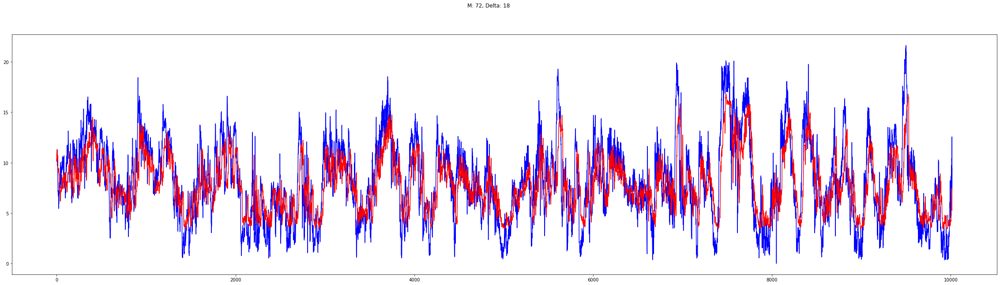

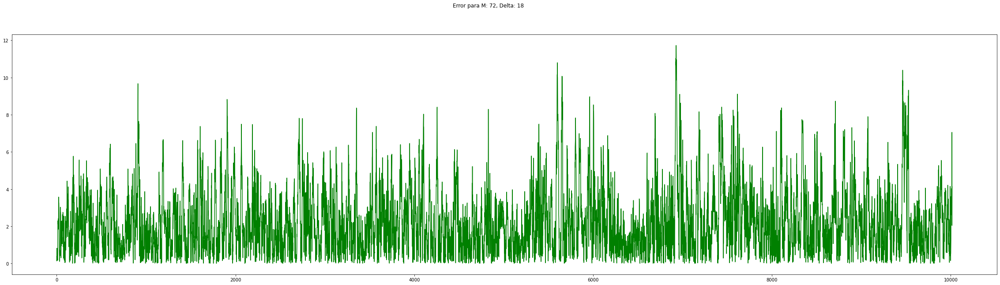

[0]	train-rmse:1.12027	eval-rmse:0.93478
[1]	train-rmse:1.12027	eval-rmse:0.93478
[2]	train-rmse:1.12027	eval-rmse:0.93478
[3]	train-rmse:1.12027	eval-rmse:0.93478
[4]	train-rmse:1.12027	eval-rmse:0.93478
[0]	train-rmse:1.09852	eval-rmse:0.92189
[1]	train-rmse:1.08058	eval-rmse:0.91251
[2]	train-rmse:1.06582	eval-rmse:0.90594
[3]	train-rmse:1.05372	eval-rmse:0.90156
[4]	train-rmse:1.04381	eval-rmse:0.89888
[5]	train-rmse:1.03572	eval-rmse:0.89751
[6]	train-rmse:1.02912	eval-rmse:0.89712
[7]	train-rmse:1.02374	eval-rmse:0.89745
[8]	train-rmse:1.01936	eval-rmse:0.89830
[9]	train-rmse:1.01580	eval-rmse:0.89951
[10]	train-rmse:1.01291	eval-rmse:0.90097
[11]	train-rmse:1.01056	eval-rmse:0.90256
[0]	train-rmse:1.07868	eval-rmse:0.91160
[1]	train-rmse:1.05120	eval-rmse:0.90079
[2]	train-rmse:1.03323	eval-rmse:0.89728
[3]	train-rmse:1.02156	eval-rmse:0.89780
[4]	train-rmse:1.01402	eval-rmse:0.90035
[5]	train-rmse:1.00917	eval-rmse:0.90374
[6]	train-rmse:1.00605	eval-rmse:0.90731
[7]	train-rmse

[6]	train-rmse:0.83603	eval-rmse:0.80266
[7]	train-rmse:0.83350	eval-rmse:0.80262
[8]	train-rmse:0.83200	eval-rmse:0.80482
[9]	train-rmse:0.83032	eval-rmse:0.80454
[10]	train-rmse:0.82916	eval-rmse:0.79983
[11]	train-rmse:0.82794	eval-rmse:0.79795
[12]	train-rmse:0.82680	eval-rmse:0.79722
[13]	train-rmse:0.82576	eval-rmse:0.80069
[14]	train-rmse:0.82489	eval-rmse:0.80088
[15]	train-rmse:0.82420	eval-rmse:0.80072
[16]	train-rmse:0.82353	eval-rmse:0.80012
[17]	train-rmse:0.82276	eval-rmse:0.79650
[18]	train-rmse:0.82174	eval-rmse:0.79968
[19]	train-rmse:0.82102	eval-rmse:0.79913
[20]	train-rmse:0.82045	eval-rmse:0.79941
[21]	train-rmse:0.82002	eval-rmse:0.80020
[22]	train-rmse:0.81961	eval-rmse:0.80123
[0]	train-rmse:0.89452	eval-rmse:0.84457
[1]	train-rmse:0.85902	eval-rmse:0.81804
[2]	train-rmse:0.85142	eval-rmse:0.82795
[3]	train-rmse:0.84705	eval-rmse:0.81251
[4]	train-rmse:0.84191	eval-rmse:0.81524
[5]	train-rmse:0.83896	eval-rmse:0.81269
[6]	train-rmse:0.83594	eval-rmse:0.80304
[7]

[6]	train-rmse:0.79293	eval-rmse:0.79357
[0]	train-rmse:0.85899	eval-rmse:0.78358
[1]	train-rmse:0.81988	eval-rmse:0.78517
[2]	train-rmse:0.80971	eval-rmse:0.79011
[3]	train-rmse:0.80335	eval-rmse:0.79577
[4]	train-rmse:0.79926	eval-rmse:0.79581
[0]	train-rmse:0.84227	eval-rmse:0.78142
[1]	train-rmse:0.81755	eval-rmse:0.78679
[2]	train-rmse:0.80879	eval-rmse:0.79235
[3]	train-rmse:0.80468	eval-rmse:0.79787
[4]	train-rmse:0.80206	eval-rmse:0.79849
[0]	train-rmse:0.83206	eval-rmse:0.78464
[1]	train-rmse:0.81691	eval-rmse:0.79689
[2]	train-rmse:0.81145	eval-rmse:0.79858
[3]	train-rmse:0.80459	eval-rmse:0.79572
[4]	train-rmse:0.79919	eval-rmse:0.80145
[0]	train-rmse:1.12027	eval-rmse:0.93478
[1]	train-rmse:1.12027	eval-rmse:0.93478
[2]	train-rmse:1.12027	eval-rmse:0.93478
[3]	train-rmse:1.12027	eval-rmse:0.93478
[4]	train-rmse:1.12027	eval-rmse:0.93478
[0]	train-rmse:1.06906	eval-rmse:0.90027
[1]	train-rmse:1.02539	eval-rmse:0.87228
[2]	train-rmse:0.98810	eval-rmse:0.84959
[3]	train-rmse:0

[0]	train-rmse:0.71988	eval-rmse:0.84391
[1]	train-rmse:0.67098	eval-rmse:0.86589
[2]	train-rmse:0.63190	eval-rmse:0.88319
[3]	train-rmse:0.61421	eval-rmse:0.88571
[4]	train-rmse:0.58425	eval-rmse:0.89329
[5]	train-rmse:0.57608	eval-rmse:0.89624
[0]	train-rmse:1.12027	eval-rmse:0.93478
[1]	train-rmse:1.12027	eval-rmse:0.93478
[2]	train-rmse:1.12027	eval-rmse:0.93478
[3]	train-rmse:1.12027	eval-rmse:0.93478
[4]	train-rmse:1.12027	eval-rmse:0.93478
[0]	train-rmse:1.05145	eval-rmse:0.89950
[1]	train-rmse:0.99286	eval-rmse:0.87141
[2]	train-rmse:0.94081	eval-rmse:0.85005
[3]	train-rmse:0.89376	eval-rmse:0.83358
[4]	train-rmse:0.85189	eval-rmse:0.81962
[5]	train-rmse:0.81429	eval-rmse:0.80992
[6]	train-rmse:0.78074	eval-rmse:0.80276
[7]	train-rmse:0.75163	eval-rmse:0.79840
[8]	train-rmse:0.72600	eval-rmse:0.79493
[9]	train-rmse:0.70293	eval-rmse:0.79330
[10]	train-rmse:0.68226	eval-rmse:0.79275
[11]	train-rmse:0.66298	eval-rmse:0.79407
[12]	train-rmse:0.64473	eval-rmse:0.79430
[13]	train-rm

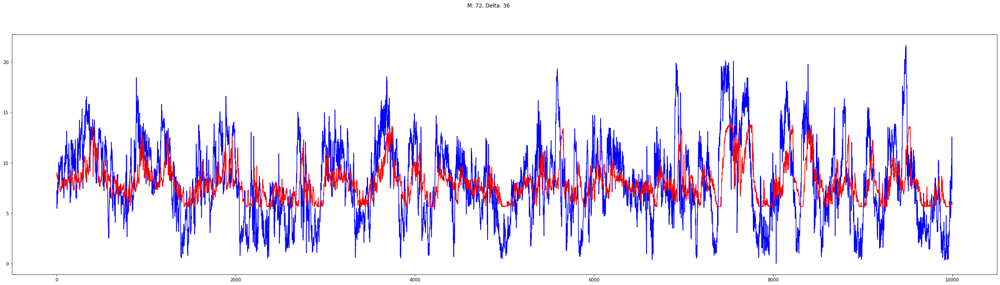

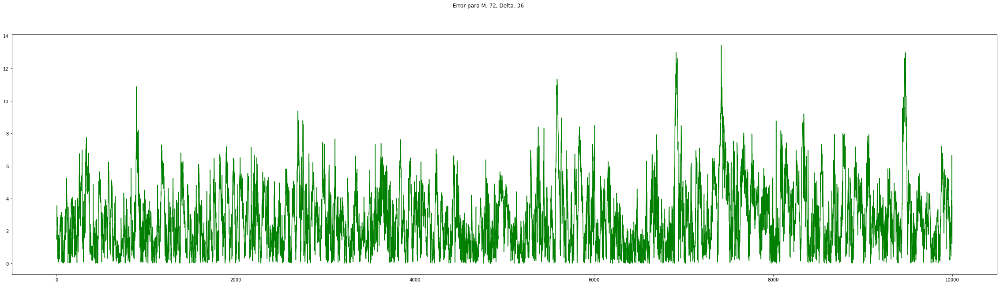

[0]	train-rmse:1.12127	eval-rmse:0.93611
[1]	train-rmse:1.12127	eval-rmse:0.93611
[2]	train-rmse:1.12127	eval-rmse:0.93611
[3]	train-rmse:1.12127	eval-rmse:0.93611
[4]	train-rmse:1.12127	eval-rmse:0.93611
[5]	train-rmse:1.12127	eval-rmse:0.93611
[0]	train-rmse:1.09935	eval-rmse:0.92321
[1]	train-rmse:1.08126	eval-rmse:0.91383
[2]	train-rmse:1.06638	eval-rmse:0.90727
[3]	train-rmse:1.05418	eval-rmse:0.90292
[4]	train-rmse:1.04419	eval-rmse:0.90028
[5]	train-rmse:1.03602	eval-rmse:0.89895
[6]	train-rmse:1.02936	eval-rmse:0.89860
[7]	train-rmse:1.02394	eval-rmse:0.89898
[8]	train-rmse:1.01952	eval-rmse:0.89987
[9]	train-rmse:1.01593	eval-rmse:0.90112
[10]	train-rmse:1.01301	eval-rmse:0.90262
[0]	train-rmse:1.07935	eval-rmse:0.91293
[1]	train-rmse:1.05164	eval-rmse:0.90216
[2]	train-rmse:1.03351	eval-rmse:0.89873
[3]	train-rmse:1.02174	eval-rmse:0.89934
[4]	train-rmse:1.01414	eval-rmse:0.90198
[5]	train-rmse:1.00924	eval-rmse:0.90546
[6]	train-rmse:1.00609	eval-rmse:0.90910
[7]	train-rmse:

[3]	train-rmse:0.92843	eval-rmse:0.86077
[4]	train-rmse:0.90687	eval-rmse:0.86170
[5]	train-rmse:0.89245	eval-rmse:0.86303
[6]	train-rmse:0.88050	eval-rmse:0.86558
[7]	train-rmse:0.87145	eval-rmse:0.86881
[8]	train-rmse:0.86458	eval-rmse:0.87125
[0]	train-rmse:1.01315	eval-rmse:0.88217
[1]	train-rmse:0.94862	eval-rmse:0.86286
[2]	train-rmse:0.91176	eval-rmse:0.86028
[3]	train-rmse:0.89101	eval-rmse:0.86108
[4]	train-rmse:0.87444	eval-rmse:0.86928
[5]	train-rmse:0.86289	eval-rmse:0.87575
[6]	train-rmse:0.85117	eval-rmse:0.87960
[0]	train-rmse:0.98364	eval-rmse:0.87171
[1]	train-rmse:0.92225	eval-rmse:0.86094
[2]	train-rmse:0.88958	eval-rmse:0.86932
[3]	train-rmse:0.87260	eval-rmse:0.87839
[4]	train-rmse:0.86238	eval-rmse:0.88386
[5]	train-rmse:0.85025	eval-rmse:0.88808
[0]	train-rmse:0.95794	eval-rmse:0.86528
[1]	train-rmse:0.90308	eval-rmse:0.86596
[2]	train-rmse:0.87734	eval-rmse:0.87819
[3]	train-rmse:0.86150	eval-rmse:0.88585
[4]	train-rmse:0.84995	eval-rmse:0.89080
[5]	train-rmse:0

[7]	train-rmse:0.85688	eval-rmse:0.86873
[8]	train-rmse:0.83955	eval-rmse:0.86931
[9]	train-rmse:0.82494	eval-rmse:0.86963
[10]	train-rmse:0.80958	eval-rmse:0.86991
[11]	train-rmse:0.79720	eval-rmse:0.87190
[0]	train-rmse:1.02444	eval-rmse:0.89791
[1]	train-rmse:0.95073	eval-rmse:0.88091
[2]	train-rmse:0.89486	eval-rmse:0.87456
[3]	train-rmse:0.85287	eval-rmse:0.87373
[4]	train-rmse:0.82089	eval-rmse:0.87501
[5]	train-rmse:0.79384	eval-rmse:0.87813
[6]	train-rmse:0.77036	eval-rmse:0.88317
[7]	train-rmse:0.75604	eval-rmse:0.88888
[8]	train-rmse:0.73627	eval-rmse:0.89424
[0]	train-rmse:0.98112	eval-rmse:0.88648
[1]	train-rmse:0.89084	eval-rmse:0.87799
[2]	train-rmse:0.83017	eval-rmse:0.88139
[3]	train-rmse:0.78327	eval-rmse:0.88672
[4]	train-rmse:0.75255	eval-rmse:0.89705
[5]	train-rmse:0.72689	eval-rmse:0.90248
[0]	train-rmse:0.94184	eval-rmse:0.88046
[1]	train-rmse:0.84423	eval-rmse:0.88532
[2]	train-rmse:0.79668	eval-rmse:0.89304
[3]	train-rmse:0.76042	eval-rmse:0.90867
[4]	train-rmse

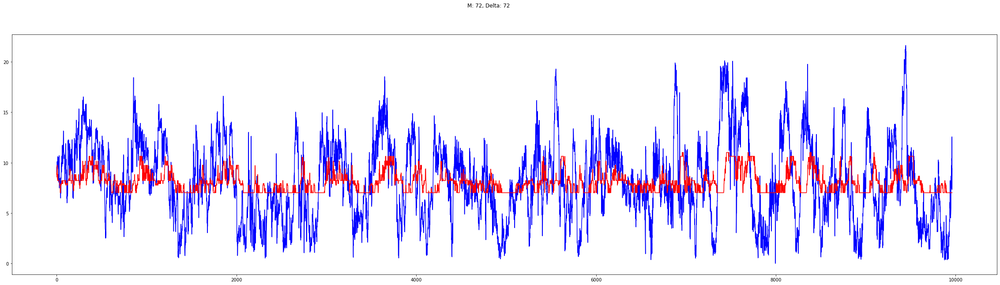

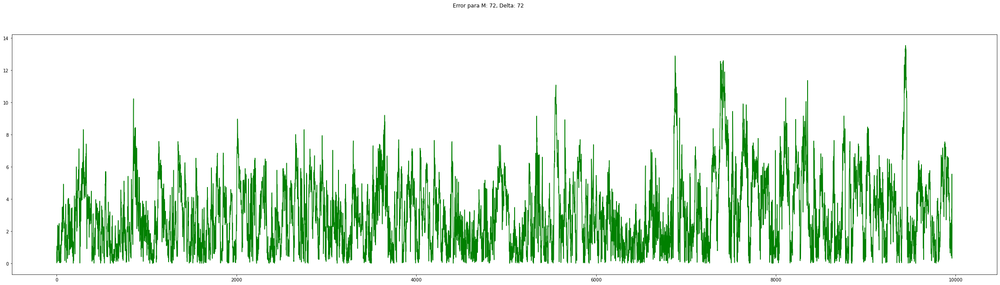

[0]	train-rmse:1.12276	eval-rmse:0.93933
[1]	train-rmse:1.12276	eval-rmse:0.93933
[2]	train-rmse:1.12276	eval-rmse:0.93933
[3]	train-rmse:1.12276	eval-rmse:0.93933
[4]	train-rmse:1.12276	eval-rmse:0.93933
[5]	train-rmse:1.12276	eval-rmse:0.93933
[0]	train-rmse:1.10090	eval-rmse:0.92636
[1]	train-rmse:1.08288	eval-rmse:0.91691
[2]	train-rmse:1.06805	eval-rmse:0.91028
[3]	train-rmse:1.05589	eval-rmse:0.90585
[4]	train-rmse:1.04594	eval-rmse:0.90313
[5]	train-rmse:1.03781	eval-rmse:0.90172
[6]	train-rmse:1.03117	eval-rmse:0.90130
[7]	train-rmse:1.02577	eval-rmse:0.90161
[8]	train-rmse:1.02137	eval-rmse:0.90243
[9]	train-rmse:1.01779	eval-rmse:0.90363
[10]	train-rmse:1.01488	eval-rmse:0.90507
[0]	train-rmse:1.08097	eval-rmse:0.91600
[1]	train-rmse:1.05336	eval-rmse:0.90507
[2]	train-rmse:1.03530	eval-rmse:0.90148
[3]	train-rmse:1.02358	eval-rmse:0.90194
[4]	train-rmse:1.01601	eval-rmse:0.90445
[5]	train-rmse:1.01113	eval-rmse:0.90782
[6]	train-rmse:1.00799	eval-rmse:0.91137
[7]	train-rmse:

[11]	train-rmse:0.44486	eval-rmse:0.38720
[12]	train-rmse:0.43312	eval-rmse:0.37709
[13]	train-rmse:0.42296	eval-rmse:0.36984
[14]	train-rmse:0.41335	eval-rmse:0.36599
[15]	train-rmse:0.40658	eval-rmse:0.36074
[16]	train-rmse:0.40037	eval-rmse:0.35711
[17]	train-rmse:0.39539	eval-rmse:0.35347
[18]	train-rmse:0.39073	eval-rmse:0.35192
[19]	train-rmse:0.38726	eval-rmse:0.34868
[20]	train-rmse:0.38416	eval-rmse:0.34655
[21]	train-rmse:0.38132	eval-rmse:0.34537
[22]	train-rmse:0.37911	eval-rmse:0.34486
[23]	train-rmse:0.37700	eval-rmse:0.34322
[24]	train-rmse:0.37533	eval-rmse:0.34193
[25]	train-rmse:0.37390	eval-rmse:0.34152
[26]	train-rmse:0.37274	eval-rmse:0.34087
[27]	train-rmse:0.37165	eval-rmse:0.34013
[28]	train-rmse:0.37080	eval-rmse:0.34002
[29]	train-rmse:0.36999	eval-rmse:0.33937
[30]	train-rmse:0.36926	eval-rmse:0.33938
[31]	train-rmse:0.36864	eval-rmse:0.33879
[32]	train-rmse:0.36805	eval-rmse:0.33881
[33]	train-rmse:0.36754	eval-rmse:0.33849
[34]	train-rmse:0.36706	eval-rmse:

[16]	train-rmse:0.39770	eval-rmse:0.37416
[17]	train-rmse:0.39666	eval-rmse:0.37258
[18]	train-rmse:0.39513	eval-rmse:0.37110
[19]	train-rmse:0.39411	eval-rmse:0.37148
[20]	train-rmse:0.39306	eval-rmse:0.36901
[21]	train-rmse:0.39205	eval-rmse:0.36816
[22]	train-rmse:0.39106	eval-rmse:0.36678
[23]	train-rmse:0.38995	eval-rmse:0.36538
[24]	train-rmse:0.38915	eval-rmse:0.36432
[25]	train-rmse:0.38822	eval-rmse:0.36423
[26]	train-rmse:0.38746	eval-rmse:0.36422
[27]	train-rmse:0.38687	eval-rmse:0.36360
[28]	train-rmse:0.38589	eval-rmse:0.36139
[29]	train-rmse:0.38525	eval-rmse:0.36133
[30]	train-rmse:0.38467	eval-rmse:0.36113
[31]	train-rmse:0.38416	eval-rmse:0.36116
[32]	train-rmse:0.38369	eval-rmse:0.36051
[33]	train-rmse:0.38286	eval-rmse:0.35974
[34]	train-rmse:0.38219	eval-rmse:0.35828
[35]	train-rmse:0.38154	eval-rmse:0.35748
[36]	train-rmse:0.38097	eval-rmse:0.35669
[37]	train-rmse:0.38031	eval-rmse:0.35621
[38]	train-rmse:0.37987	eval-rmse:0.35638
[39]	train-rmse:0.37950	eval-rmse:

[20]	train-rmse:0.38738	eval-rmse:0.36647
[21]	train-rmse:0.38632	eval-rmse:0.36545
[22]	train-rmse:0.38482	eval-rmse:0.36325
[23]	train-rmse:0.38359	eval-rmse:0.35996
[24]	train-rmse:0.38229	eval-rmse:0.36003
[25]	train-rmse:0.38121	eval-rmse:0.36001
[26]	train-rmse:0.38027	eval-rmse:0.36117
[27]	train-rmse:0.37945	eval-rmse:0.36092
[28]	train-rmse:0.37883	eval-rmse:0.36084
[0]	train-rmse:1.12276	eval-rmse:0.93933
[1]	train-rmse:1.12276	eval-rmse:0.93933
[2]	train-rmse:1.12276	eval-rmse:0.93933
[3]	train-rmse:1.12276	eval-rmse:0.93933
[4]	train-rmse:1.12276	eval-rmse:0.93933
[0]	train-rmse:1.02985	eval-rmse:0.86178
[1]	train-rmse:0.94732	eval-rmse:0.79364
[2]	train-rmse:0.87343	eval-rmse:0.73295
[3]	train-rmse:0.80809	eval-rmse:0.67635
[4]	train-rmse:0.74973	eval-rmse:0.62865
[5]	train-rmse:0.69845	eval-rmse:0.58456
[6]	train-rmse:0.65312	eval-rmse:0.54910
[7]	train-rmse:0.61315	eval-rmse:0.51673
[8]	train-rmse:0.57797	eval-rmse:0.48881
[9]	train-rmse:0.54750	eval-rmse:0.46532
[10]	tr

[2]	train-rmse:0.40008	eval-rmse:0.37441
[3]	train-rmse:0.38416	eval-rmse:0.35421
[4]	train-rmse:0.38115	eval-rmse:0.35414
[5]	train-rmse:0.37782	eval-rmse:0.35201
[6]	train-rmse:0.37114	eval-rmse:0.34802
[7]	train-rmse:0.36847	eval-rmse:0.34629
[8]	train-rmse:0.36664	eval-rmse:0.34590
[9]	train-rmse:0.36485	eval-rmse:0.34615
[10]	train-rmse:0.36353	eval-rmse:0.34677
[11]	train-rmse:0.36236	eval-rmse:0.34773
[12]	train-rmse:0.36150	eval-rmse:0.34786
[13]	train-rmse:0.35986	eval-rmse:0.34587
[14]	train-rmse:0.35895	eval-rmse:0.34575
[15]	train-rmse:0.35813	eval-rmse:0.34588
[16]	train-rmse:0.35729	eval-rmse:0.34662
[17]	train-rmse:0.35671	eval-rmse:0.34654
[18]	train-rmse:0.35537	eval-rmse:0.34568
[19]	train-rmse:0.35481	eval-rmse:0.34588
[20]	train-rmse:0.35383	eval-rmse:0.34708
[21]	train-rmse:0.35320	eval-rmse:0.34727
[22]	train-rmse:0.35260	eval-rmse:0.34714
[0]	train-rmse:1.12276	eval-rmse:0.93933
[1]	train-rmse:1.12276	eval-rmse:0.93933
[2]	train-rmse:1.12276	eval-rmse:0.93933
[3]

[13]	train-rmse:0.43289	eval-rmse:0.38392
[14]	train-rmse:0.41859	eval-rmse:0.37400
[15]	train-rmse:0.40661	eval-rmse:0.36542
[16]	train-rmse:0.39648	eval-rmse:0.35853
[17]	train-rmse:0.38798	eval-rmse:0.35281
[18]	train-rmse:0.38068	eval-rmse:0.34839
[19]	train-rmse:0.37446	eval-rmse:0.34483
[20]	train-rmse:0.36924	eval-rmse:0.34205
[21]	train-rmse:0.36481	eval-rmse:0.33985
[22]	train-rmse:0.36097	eval-rmse:0.33804
[23]	train-rmse:0.35780	eval-rmse:0.33635
[24]	train-rmse:0.35484	eval-rmse:0.33511
[25]	train-rmse:0.35242	eval-rmse:0.33428
[26]	train-rmse:0.35007	eval-rmse:0.33353
[27]	train-rmse:0.34814	eval-rmse:0.33309
[28]	train-rmse:0.34638	eval-rmse:0.33266
[29]	train-rmse:0.34479	eval-rmse:0.33230
[30]	train-rmse:0.34336	eval-rmse:0.33200
[31]	train-rmse:0.34199	eval-rmse:0.33185
[32]	train-rmse:0.34097	eval-rmse:0.33175
[33]	train-rmse:0.34001	eval-rmse:0.33182
[34]	train-rmse:0.33889	eval-rmse:0.33172
[35]	train-rmse:0.33788	eval-rmse:0.33165
[36]	train-rmse:0.33691	eval-rmse:

[10]	train-rmse:0.32121	eval-rmse:0.33427
[11]	train-rmse:0.31800	eval-rmse:0.33476
[12]	train-rmse:0.31596	eval-rmse:0.33513
[13]	train-rmse:0.31272	eval-rmse:0.33520
[0]	train-rmse:0.73272	eval-rmse:0.62093
[1]	train-rmse:0.52186	eval-rmse:0.45456
[2]	train-rmse:0.41741	eval-rmse:0.38011
[3]	train-rmse:0.36940	eval-rmse:0.35007
[4]	train-rmse:0.34642	eval-rmse:0.34021
[5]	train-rmse:0.33576	eval-rmse:0.33628
[6]	train-rmse:0.32903	eval-rmse:0.33615
[7]	train-rmse:0.32378	eval-rmse:0.33591
[8]	train-rmse:0.31951	eval-rmse:0.33610
[9]	train-rmse:0.31625	eval-rmse:0.33756
[10]	train-rmse:0.31490	eval-rmse:0.33809
[11]	train-rmse:0.31109	eval-rmse:0.33832
[0]	train-rmse:0.64216	eval-rmse:0.54874
[1]	train-rmse:0.44164	eval-rmse:0.39669
[2]	train-rmse:0.37024	eval-rmse:0.35008
[3]	train-rmse:0.34452	eval-rmse:0.33770
[4]	train-rmse:0.33469	eval-rmse:0.33590
[5]	train-rmse:0.32785	eval-rmse:0.33669
[6]	train-rmse:0.32278	eval-rmse:0.33847
[7]	train-rmse:0.31967	eval-rmse:0.33952
[8]	train-

[11]	train-rmse:0.43992	eval-rmse:0.41154
[12]	train-rmse:0.41761	eval-rmse:0.39710
[13]	train-rmse:0.39809	eval-rmse:0.38544
[14]	train-rmse:0.38128	eval-rmse:0.37567
[15]	train-rmse:0.36664	eval-rmse:0.36788
[16]	train-rmse:0.35383	eval-rmse:0.36146
[17]	train-rmse:0.34291	eval-rmse:0.35578
[18]	train-rmse:0.33349	eval-rmse:0.35140
[19]	train-rmse:0.32512	eval-rmse:0.34785
[20]	train-rmse:0.31753	eval-rmse:0.34524
[21]	train-rmse:0.31141	eval-rmse:0.34300
[22]	train-rmse:0.30564	eval-rmse:0.34113
[23]	train-rmse:0.30020	eval-rmse:0.33980
[24]	train-rmse:0.29526	eval-rmse:0.33893
[25]	train-rmse:0.29118	eval-rmse:0.33833
[26]	train-rmse:0.28786	eval-rmse:0.33753
[27]	train-rmse:0.28457	eval-rmse:0.33678
[28]	train-rmse:0.28082	eval-rmse:0.33644
[29]	train-rmse:0.27789	eval-rmse:0.33609
[30]	train-rmse:0.27469	eval-rmse:0.33598
[31]	train-rmse:0.27233	eval-rmse:0.33570
[32]	train-rmse:0.27004	eval-rmse:0.33572
[33]	train-rmse:0.26726	eval-rmse:0.33557
[34]	train-rmse:0.26542	eval-rmse:

[4]	train-rmse:0.29369	eval-rmse:0.35008
[5]	train-rmse:0.27125	eval-rmse:0.34869
[6]	train-rmse:0.25872	eval-rmse:0.34837
[7]	train-rmse:0.24880	eval-rmse:0.35092
[8]	train-rmse:0.23694	eval-rmse:0.35363
[9]	train-rmse:0.23107	eval-rmse:0.35459
[10]	train-rmse:0.22758	eval-rmse:0.35461
[0]	train-rmse:0.63224	eval-rmse:0.54795
[1]	train-rmse:0.41424	eval-rmse:0.39982
[2]	train-rmse:0.32758	eval-rmse:0.35649
[3]	train-rmse:0.29105	eval-rmse:0.34748
[4]	train-rmse:0.26930	eval-rmse:0.34943
[5]	train-rmse:0.25553	eval-rmse:0.35124
[6]	train-rmse:0.24706	eval-rmse:0.35365
[7]	train-rmse:0.23841	eval-rmse:0.35510
[0]	train-rmse:0.54410	eval-rmse:0.48212
[1]	train-rmse:0.35356	eval-rmse:0.37010
[2]	train-rmse:0.29996	eval-rmse:0.35259
[3]	train-rmse:0.27528	eval-rmse:0.35417
[4]	train-rmse:0.26262	eval-rmse:0.35708
[5]	train-rmse:0.24883	eval-rmse:0.35993
[6]	train-rmse:0.24081	eval-rmse:0.36080
[7]	train-rmse:0.23244	eval-rmse:0.36149
[0]	train-rmse:0.46390	eval-rmse:0.42525
[1]	train-rmse:

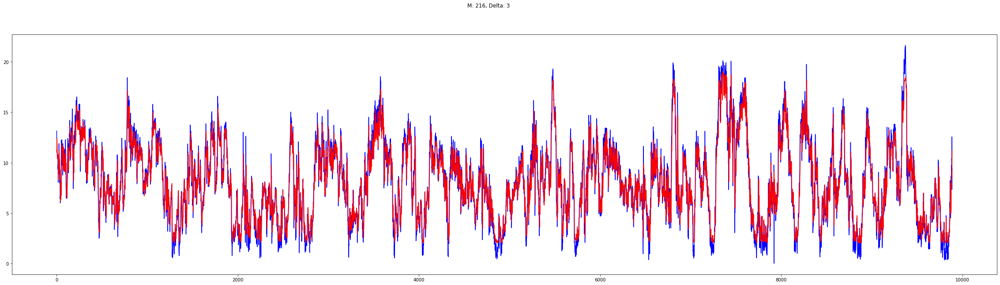

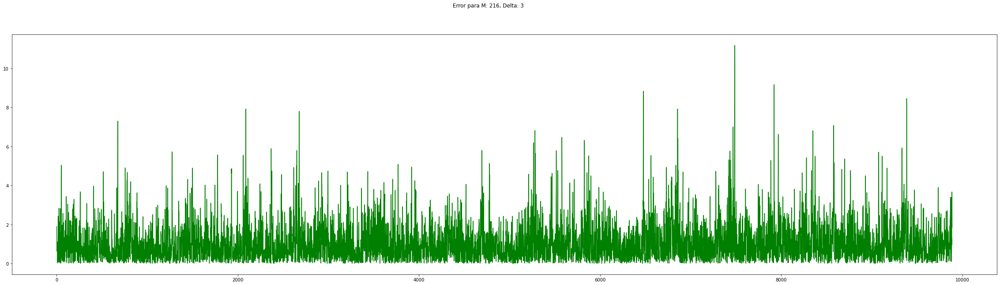

[0]	train-rmse:1.12316	eval-rmse:0.93988
[1]	train-rmse:1.12316	eval-rmse:0.93988
[2]	train-rmse:1.12316	eval-rmse:0.93988
[3]	train-rmse:1.12316	eval-rmse:0.93988
[4]	train-rmse:1.12316	eval-rmse:0.93988
[0]	train-rmse:1.10132	eval-rmse:0.92686
[1]	train-rmse:1.08330	eval-rmse:0.91737
[2]	train-rmse:1.06849	eval-rmse:0.91070
[3]	train-rmse:1.05633	eval-rmse:0.90623
[4]	train-rmse:1.04638	eval-rmse:0.90347
[5]	train-rmse:1.03826	eval-rmse:0.90203
[6]	train-rmse:1.03163	eval-rmse:0.90158
[7]	train-rmse:1.02622	eval-rmse:0.90186
[8]	train-rmse:1.02183	eval-rmse:0.90266
[9]	train-rmse:1.01825	eval-rmse:0.90383
[10]	train-rmse:1.01535	eval-rmse:0.90525
[0]	train-rmse:1.08140	eval-rmse:0.91645
[1]	train-rmse:1.05381	eval-rmse:0.90544
[2]	train-rmse:1.03576	eval-rmse:0.90177
[3]	train-rmse:1.02404	eval-rmse:0.90218
[4]	train-rmse:1.01647	eval-rmse:0.90465
[5]	train-rmse:1.01159	eval-rmse:0.90797
[6]	train-rmse:1.00846	eval-rmse:0.91150
[7]	train-rmse:1.00645	eval-rmse:0.91486
[0]	train-rmse:

[17]	train-rmse:0.68486	eval-rmse:0.64792
[18]	train-rmse:0.68399	eval-rmse:0.64797
[19]	train-rmse:0.68312	eval-rmse:0.64782
[20]	train-rmse:0.68227	eval-rmse:0.64808
[21]	train-rmse:0.68139	eval-rmse:0.64777
[22]	train-rmse:0.68063	eval-rmse:0.64752
[23]	train-rmse:0.67991	eval-rmse:0.64793
[24]	train-rmse:0.67924	eval-rmse:0.64760
[25]	train-rmse:0.67853	eval-rmse:0.64686
[26]	train-rmse:0.67788	eval-rmse:0.64698
[27]	train-rmse:0.67723	eval-rmse:0.64689
[28]	train-rmse:0.67662	eval-rmse:0.64770
[29]	train-rmse:0.67602	eval-rmse:0.64702
[0]	train-rmse:0.93334	eval-rmse:0.79040
[1]	train-rmse:0.83655	eval-rmse:0.73001
[2]	train-rmse:0.77635	eval-rmse:0.68890
[3]	train-rmse:0.74552	eval-rmse:0.67563
[4]	train-rmse:0.72458	eval-rmse:0.66268
[5]	train-rmse:0.71397	eval-rmse:0.66308
[6]	train-rmse:0.70713	eval-rmse:0.65831
[7]	train-rmse:0.70160	eval-rmse:0.65730
[8]	train-rmse:0.69727	eval-rmse:0.65611
[9]	train-rmse:0.69395	eval-rmse:0.65414
[10]	train-rmse:0.69177	eval-rmse:0.65323
[1

[0]	train-rmse:1.12316	eval-rmse:0.93988
[1]	train-rmse:1.12316	eval-rmse:0.93988
[2]	train-rmse:1.12316	eval-rmse:0.93988
[3]	train-rmse:1.12316	eval-rmse:0.93988
[4]	train-rmse:1.12316	eval-rmse:0.93988
[0]	train-rmse:1.05342	eval-rmse:0.88776
[1]	train-rmse:0.99252	eval-rmse:0.84431
[2]	train-rmse:0.94039	eval-rmse:0.80690
[3]	train-rmse:0.89524	eval-rmse:0.77576
[4]	train-rmse:0.85685	eval-rmse:0.75000
[5]	train-rmse:0.82350	eval-rmse:0.73001
[6]	train-rmse:0.79556	eval-rmse:0.71272
[7]	train-rmse:0.77087	eval-rmse:0.69925
[8]	train-rmse:0.74990	eval-rmse:0.68937
[9]	train-rmse:0.73212	eval-rmse:0.67979
[10]	train-rmse:0.71626	eval-rmse:0.67246
[11]	train-rmse:0.70319	eval-rmse:0.66694
[12]	train-rmse:0.69174	eval-rmse:0.66332
[13]	train-rmse:0.68204	eval-rmse:0.65932
[14]	train-rmse:0.67304	eval-rmse:0.65661
[15]	train-rmse:0.66537	eval-rmse:0.65431
[16]	train-rmse:0.65854	eval-rmse:0.65259
[17]	train-rmse:0.65264	eval-rmse:0.65232
[18]	train-rmse:0.64696	eval-rmse:0.65124
[19]	tr

[1]	train-rmse:0.98177	eval-rmse:0.84278
[2]	train-rmse:0.92354	eval-rmse:0.80691
[3]	train-rmse:0.87373	eval-rmse:0.77610
[4]	train-rmse:0.82972	eval-rmse:0.75098
[5]	train-rmse:0.79134	eval-rmse:0.73054
[6]	train-rmse:0.75737	eval-rmse:0.71461
[7]	train-rmse:0.72803	eval-rmse:0.70070
[8]	train-rmse:0.70181	eval-rmse:0.68980
[9]	train-rmse:0.67974	eval-rmse:0.68066
[10]	train-rmse:0.66040	eval-rmse:0.67420
[11]	train-rmse:0.64219	eval-rmse:0.66904
[12]	train-rmse:0.62641	eval-rmse:0.66633
[13]	train-rmse:0.61280	eval-rmse:0.66460
[14]	train-rmse:0.60113	eval-rmse:0.66190
[15]	train-rmse:0.58959	eval-rmse:0.66074
[16]	train-rmse:0.57889	eval-rmse:0.66000
[17]	train-rmse:0.57043	eval-rmse:0.65847
[18]	train-rmse:0.56224	eval-rmse:0.65868
[19]	train-rmse:0.55573	eval-rmse:0.65814
[20]	train-rmse:0.54856	eval-rmse:0.65824
[21]	train-rmse:0.54292	eval-rmse:0.65846
[22]	train-rmse:0.53696	eval-rmse:0.65858
[23]	train-rmse:0.53092	eval-rmse:0.65947
[0]	train-rmse:0.97510	eval-rmse:0.83835
[1

[13]	train-rmse:0.52397	eval-rmse:0.67324
[14]	train-rmse:0.50864	eval-rmse:0.67212
[15]	train-rmse:0.49324	eval-rmse:0.67081
[16]	train-rmse:0.47990	eval-rmse:0.67067
[17]	train-rmse:0.46734	eval-rmse:0.67002
[18]	train-rmse:0.45564	eval-rmse:0.66974
[19]	train-rmse:0.44430	eval-rmse:0.67013
[20]	train-rmse:0.43490	eval-rmse:0.67073
[21]	train-rmse:0.42592	eval-rmse:0.67105
[22]	train-rmse:0.41662	eval-rmse:0.67211
[0]	train-rmse:0.96085	eval-rmse:0.83837
[1]	train-rmse:0.83479	eval-rmse:0.77223
[2]	train-rmse:0.73746	eval-rmse:0.72985
[3]	train-rmse:0.66236	eval-rmse:0.70670
[4]	train-rmse:0.60263	eval-rmse:0.69204
[5]	train-rmse:0.55662	eval-rmse:0.68336
[6]	train-rmse:0.52119	eval-rmse:0.67932
[7]	train-rmse:0.49196	eval-rmse:0.67694
[8]	train-rmse:0.46610	eval-rmse:0.67694
[9]	train-rmse:0.44615	eval-rmse:0.67977
[10]	train-rmse:0.43038	eval-rmse:0.68140
[11]	train-rmse:0.41350	eval-rmse:0.68233
[12]	train-rmse:0.40273	eval-rmse:0.68504
[0]	train-rmse:0.88431	eval-rmse:0.79624
[1]

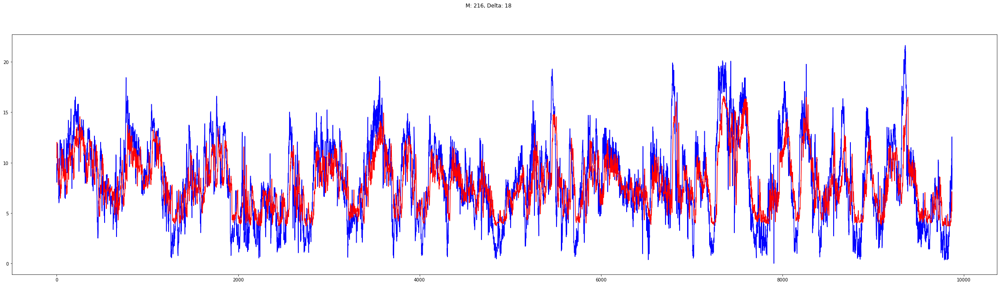

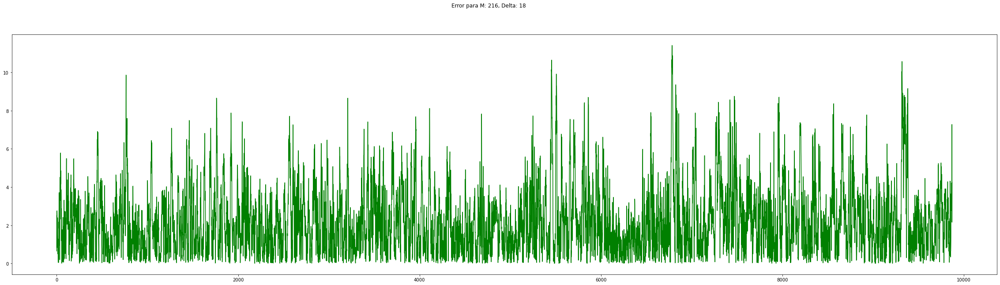

[0]	train-rmse:1.12329	eval-rmse:0.94068
[1]	train-rmse:1.12329	eval-rmse:0.94068
[2]	train-rmse:1.12329	eval-rmse:0.94068
[3]	train-rmse:1.12329	eval-rmse:0.94068
[4]	train-rmse:1.12329	eval-rmse:0.94068
[0]	train-rmse:1.10148	eval-rmse:0.92764
[1]	train-rmse:1.08350	eval-rmse:0.91812
[2]	train-rmse:1.06871	eval-rmse:0.91142
[3]	train-rmse:1.05657	eval-rmse:0.90692
[4]	train-rmse:1.04664	eval-rmse:0.90414
[5]	train-rmse:1.03853	eval-rmse:0.90268
[6]	train-rmse:1.03191	eval-rmse:0.90219
[7]	train-rmse:1.02652	eval-rmse:0.90245
[8]	train-rmse:1.02213	eval-rmse:0.90323
[9]	train-rmse:1.01856	eval-rmse:0.90438
[10]	train-rmse:1.01566	eval-rmse:0.90577
[11]	train-rmse:1.01331	eval-rmse:0.90732
[0]	train-rmse:1.08160	eval-rmse:0.91720
[1]	train-rmse:1.05405	eval-rmse:0.90613
[2]	train-rmse:1.03603	eval-rmse:0.90241
[3]	train-rmse:1.02434	eval-rmse:0.90276
[4]	train-rmse:1.01678	eval-rmse:0.90517
[5]	train-rmse:1.01191	eval-rmse:0.90846
[6]	train-rmse:1.00879	eval-rmse:0.91195
[0]	train-rmse

[6]	train-rmse:0.78338	eval-rmse:0.79584
[7]	train-rmse:0.77002	eval-rmse:0.79697
[8]	train-rmse:0.75805	eval-rmse:0.79818
[9]	train-rmse:0.74925	eval-rmse:0.79935
[10]	train-rmse:0.74081	eval-rmse:0.79935
[0]	train-rmse:0.97244	eval-rmse:0.85456
[1]	train-rmse:0.88498	eval-rmse:0.81619
[2]	train-rmse:0.83253	eval-rmse:0.79865
[3]	train-rmse:0.79908	eval-rmse:0.79242
[4]	train-rmse:0.77743	eval-rmse:0.79148
[5]	train-rmse:0.76089	eval-rmse:0.79441
[6]	train-rmse:0.74676	eval-rmse:0.79519
[7]	train-rmse:0.73842	eval-rmse:0.79695
[8]	train-rmse:0.73119	eval-rmse:0.80078
[9]	train-rmse:0.71831	eval-rmse:0.80472
[0]	train-rmse:0.93006	eval-rmse:0.83557
[1]	train-rmse:0.84072	eval-rmse:0.80437
[2]	train-rmse:0.79743	eval-rmse:0.79763
[3]	train-rmse:0.77101	eval-rmse:0.79990
[4]	train-rmse:0.75085	eval-rmse:0.80592
[5]	train-rmse:0.73557	eval-rmse:0.80769
[6]	train-rmse:0.72342	eval-rmse:0.80820
[7]	train-rmse:0.71482	eval-rmse:0.81403
[0]	train-rmse:0.89261	eval-rmse:0.82206
[1]	train-rmse:

[1]	train-rmse:0.69590	eval-rmse:0.87088
[2]	train-rmse:0.65266	eval-rmse:0.88085
[3]	train-rmse:0.62953	eval-rmse:0.88560
[4]	train-rmse:0.60504	eval-rmse:0.89140
[5]	train-rmse:0.58139	eval-rmse:0.90008
[0]	train-rmse:0.74527	eval-rmse:0.86232
[1]	train-rmse:0.68725	eval-rmse:0.90200
[2]	train-rmse:0.64006	eval-rmse:0.92030
[3]	train-rmse:0.63006	eval-rmse:0.92551
[4]	train-rmse:0.60028	eval-rmse:0.93029
[5]	train-rmse:0.58323	eval-rmse:0.93703
[0]	train-rmse:1.12329	eval-rmse:0.94068
[1]	train-rmse:1.12329	eval-rmse:0.94068
[2]	train-rmse:1.12329	eval-rmse:0.94068
[3]	train-rmse:1.12329	eval-rmse:0.94068
[4]	train-rmse:1.12329	eval-rmse:0.94068
[5]	train-rmse:1.12329	eval-rmse:0.94068
[0]	train-rmse:1.05725	eval-rmse:0.90879
[1]	train-rmse:0.99854	eval-rmse:0.88340
[2]	train-rmse:0.94744	eval-rmse:0.86286
[3]	train-rmse:0.90229	eval-rmse:0.84701
[4]	train-rmse:0.86229	eval-rmse:0.83426
[5]	train-rmse:0.82844	eval-rmse:0.82552
[6]	train-rmse:0.79689	eval-rmse:0.81736
[7]	train-rmse:0

[7]	train-rmse:0.41433	eval-rmse:0.86536
[0]	train-rmse:0.83838	eval-rmse:0.85093
[1]	train-rmse:0.67322	eval-rmse:0.83755
[2]	train-rmse:0.57861	eval-rmse:0.84046
[3]	train-rmse:0.51261	eval-rmse:0.84781
[4]	train-rmse:0.46966	eval-rmse:0.85702
[5]	train-rmse:0.43085	eval-rmse:0.86703
[6]	train-rmse:0.39264	eval-rmse:0.87666
[0]	train-rmse:0.77844	eval-rmse:0.84811
[1]	train-rmse:0.61982	eval-rmse:0.85196
[2]	train-rmse:0.53736	eval-rmse:0.86846
[3]	train-rmse:0.47348	eval-rmse:0.88027
[4]	train-rmse:0.43150	eval-rmse:0.88927
[5]	train-rmse:0.39782	eval-rmse:0.89639
[0]	train-rmse:0.72539	eval-rmse:0.85362
[1]	train-rmse:0.56883	eval-rmse:0.87226
[2]	train-rmse:0.49345	eval-rmse:0.89834
[3]	train-rmse:0.44448	eval-rmse:0.91688
[4]	train-rmse:0.38773	eval-rmse:0.93096
[5]	train-rmse:0.36102	eval-rmse:0.94028
[0]	train-rmse:0.68083	eval-rmse:0.86731
[1]	train-rmse:0.55208	eval-rmse:0.90371
[2]	train-rmse:0.47796	eval-rmse:0.93190
[3]	train-rmse:0.43615	eval-rmse:0.94572
[4]	train-rmse:0

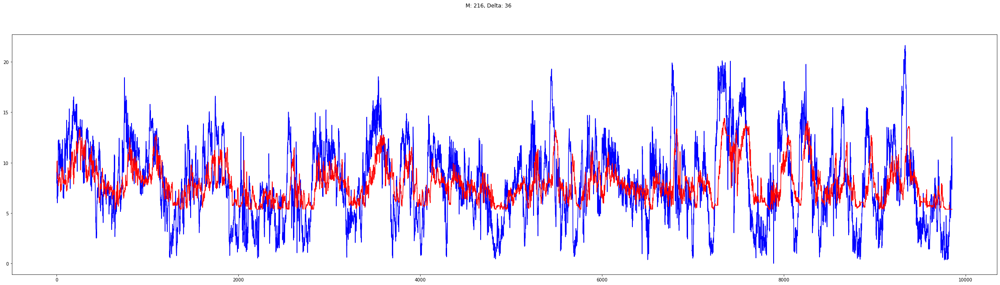

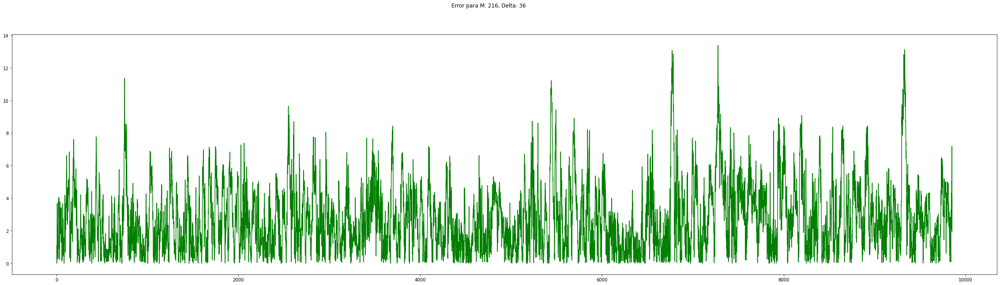

[0]	train-rmse:1.12408	eval-rmse:0.94194
[1]	train-rmse:1.12408	eval-rmse:0.94194
[2]	train-rmse:1.12408	eval-rmse:0.94194
[3]	train-rmse:1.12408	eval-rmse:0.94194
[4]	train-rmse:1.12408	eval-rmse:0.94194
[5]	train-rmse:1.12408	eval-rmse:0.94194
[0]	train-rmse:1.10233	eval-rmse:0.92887
[1]	train-rmse:1.08439	eval-rmse:0.91932
[2]	train-rmse:1.06964	eval-rmse:0.91257
[3]	train-rmse:1.05754	eval-rmse:0.90804
[4]	train-rmse:1.04764	eval-rmse:0.90521
[5]	train-rmse:1.03955	eval-rmse:0.90370
[6]	train-rmse:1.03295	eval-rmse:0.90319
[7]	train-rmse:1.02757	eval-rmse:0.90340
[8]	train-rmse:1.02320	eval-rmse:0.90415
[9]	train-rmse:1.01964	eval-rmse:0.90526
[10]	train-rmse:1.01675	eval-rmse:0.90663
[0]	train-rmse:1.08250	eval-rmse:0.91839
[1]	train-rmse:1.05503	eval-rmse:0.90723
[2]	train-rmse:1.03706	eval-rmse:0.90342
[3]	train-rmse:1.02540	eval-rmse:0.90370
[4]	train-rmse:1.01786	eval-rmse:0.90604
[5]	train-rmse:1.01301	eval-rmse:0.90927
[6]	train-rmse:1.00989	eval-rmse:0.91271
[7]	train-rmse:

[2]	train-rmse:0.90082	eval-rmse:0.90056
[3]	train-rmse:0.89142	eval-rmse:0.89948
[4]	train-rmse:0.88433	eval-rmse:0.90037
[5]	train-rmse:0.87798	eval-rmse:0.91199
[0]	train-rmse:0.93256	eval-rmse:0.87757
[1]	train-rmse:0.91082	eval-rmse:0.89313
[2]	train-rmse:0.90116	eval-rmse:0.90561
[3]	train-rmse:0.89155	eval-rmse:0.90436
[4]	train-rmse:0.88877	eval-rmse:0.91007
[0]	train-rmse:1.12408	eval-rmse:0.94194
[1]	train-rmse:1.12408	eval-rmse:0.94194
[2]	train-rmse:1.12408	eval-rmse:0.94194
[3]	train-rmse:1.12408	eval-rmse:0.94194
[4]	train-rmse:1.12408	eval-rmse:0.94194
[5]	train-rmse:1.12408	eval-rmse:0.94194
[0]	train-rmse:1.08689	eval-rmse:0.92282
[1]	train-rmse:1.05562	eval-rmse:0.90789
[2]	train-rmse:1.02884	eval-rmse:0.89684
[3]	train-rmse:1.00666	eval-rmse:0.88790
[4]	train-rmse:0.98761	eval-rmse:0.88244
[5]	train-rmse:0.97061	eval-rmse:0.87874
[6]	train-rmse:0.95630	eval-rmse:0.87604
[7]	train-rmse:0.94446	eval-rmse:0.87431
[8]	train-rmse:0.93410	eval-rmse:0.87496
[9]	train-rmse:0

[2]	train-rmse:0.62659	eval-rmse:0.99942
[3]	train-rmse:0.57401	eval-rmse:1.00951
[4]	train-rmse:0.51349	eval-rmse:1.02824
[5]	train-rmse:0.49200	eval-rmse:1.03422
[0]	train-rmse:0.77267	eval-rmse:0.93473
[1]	train-rmse:0.70713	eval-rmse:0.98183
[2]	train-rmse:0.66489	eval-rmse:0.99512
[3]	train-rmse:0.61270	eval-rmse:1.01503
[4]	train-rmse:0.54446	eval-rmse:1.03184
[5]	train-rmse:0.52746	eval-rmse:1.03160
[0]	train-rmse:1.12408	eval-rmse:0.94194
[1]	train-rmse:1.12408	eval-rmse:0.94194
[2]	train-rmse:1.12408	eval-rmse:0.94194
[3]	train-rmse:1.12408	eval-rmse:0.94194
[4]	train-rmse:1.12408	eval-rmse:0.94194
[5]	train-rmse:1.12408	eval-rmse:0.94194
[0]	train-rmse:1.06082	eval-rmse:0.92229
[1]	train-rmse:1.00345	eval-rmse:0.90680
[2]	train-rmse:0.95327	eval-rmse:0.89819
[3]	train-rmse:0.90788	eval-rmse:0.89118
[4]	train-rmse:0.86678	eval-rmse:0.88922
[5]	train-rmse:0.82766	eval-rmse:0.88863
[6]	train-rmse:0.79759	eval-rmse:0.88819
[7]	train-rmse:0.76453	eval-rmse:0.89010
[8]	train-rmse:0

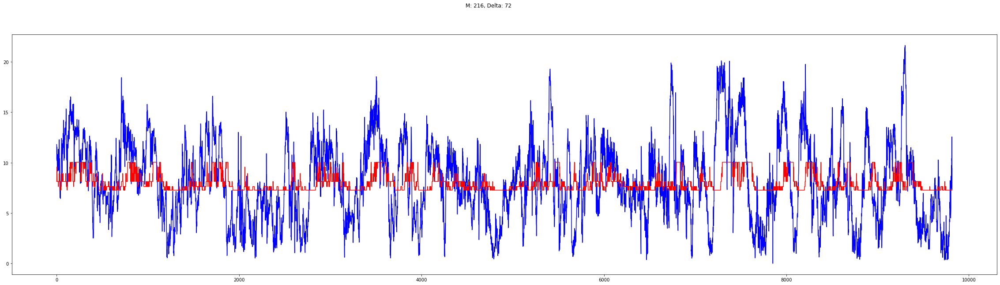

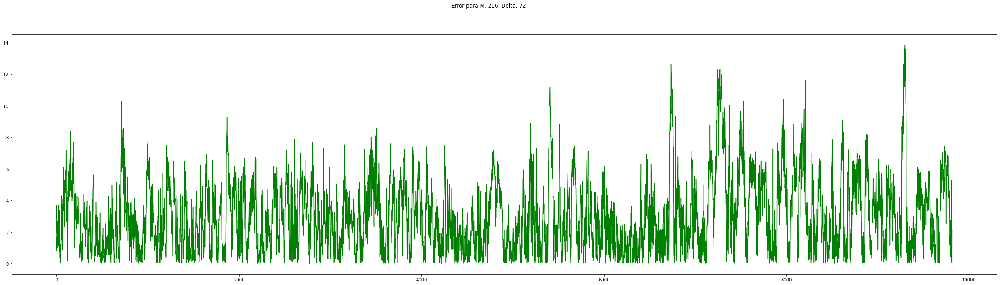

[0]	train-rmse:1.12202	eval-rmse:0.94479
[1]	train-rmse:1.12202	eval-rmse:0.94479
[2]	train-rmse:1.12202	eval-rmse:0.94479
[3]	train-rmse:1.12202	eval-rmse:0.94479
[4]	train-rmse:1.12202	eval-rmse:0.94479
[5]	train-rmse:1.12202	eval-rmse:0.94479
[0]	train-rmse:1.10038	eval-rmse:0.93068
[1]	train-rmse:1.08254	eval-rmse:0.92015
[2]	train-rmse:1.06787	eval-rmse:0.91250
[3]	train-rmse:1.05584	eval-rmse:0.90712
[4]	train-rmse:1.04599	eval-rmse:0.90352
[5]	train-rmse:1.03794	eval-rmse:0.90131
[6]	train-rmse:1.03138	eval-rmse:0.90015
[7]	train-rmse:1.02603	eval-rmse:0.89979
[8]	train-rmse:1.02168	eval-rmse:0.90001
[9]	train-rmse:1.01814	eval-rmse:0.90065
[10]	train-rmse:1.01527	eval-rmse:0.90159
[11]	train-rmse:1.01293	eval-rmse:0.90273
[12]	train-rmse:1.01103	eval-rmse:0.90399
[0]	train-rmse:1.08066	eval-rmse:0.91911
[1]	train-rmse:1.05333	eval-rmse:0.90613
[2]	train-rmse:1.03547	eval-rmse:0.90079
[3]	train-rmse:1.02387	eval-rmse:0.89983
[4]	train-rmse:1.01637	eval-rmse:0.90118
[5]	train-rms

[20]	train-rmse:0.38414	eval-rmse:0.34867
[21]	train-rmse:0.38147	eval-rmse:0.34611
[22]	train-rmse:0.37915	eval-rmse:0.34433
[23]	train-rmse:0.37714	eval-rmse:0.34356
[24]	train-rmse:0.37562	eval-rmse:0.34231
[25]	train-rmse:0.37414	eval-rmse:0.34199
[26]	train-rmse:0.37292	eval-rmse:0.34088
[27]	train-rmse:0.37192	eval-rmse:0.34009
[28]	train-rmse:0.37102	eval-rmse:0.34010
[29]	train-rmse:0.37024	eval-rmse:0.34000
[30]	train-rmse:0.36948	eval-rmse:0.33945
[31]	train-rmse:0.36885	eval-rmse:0.33921
[32]	train-rmse:0.36826	eval-rmse:0.33924
[33]	train-rmse:0.36773	eval-rmse:0.33885
[34]	train-rmse:0.36727	eval-rmse:0.33891
[35]	train-rmse:0.36684	eval-rmse:0.33864
[36]	train-rmse:0.36647	eval-rmse:0.33850
[37]	train-rmse:0.36611	eval-rmse:0.33836
[38]	train-rmse:0.36578	eval-rmse:0.33837
[39]	train-rmse:0.36545	eval-rmse:0.33837
[40]	train-rmse:0.36515	eval-rmse:0.33835
[41]	train-rmse:0.36488	eval-rmse:0.33816
[42]	train-rmse:0.36462	eval-rmse:0.33816
[43]	train-rmse:0.36436	eval-rmse:

[64]	train-rmse:0.37068	eval-rmse:0.34946
[65]	train-rmse:0.37044	eval-rmse:0.34947
[66]	train-rmse:0.37018	eval-rmse:0.34946
[0]	train-rmse:0.74634	eval-rmse:0.62509
[1]	train-rmse:0.59578	eval-rmse:0.52284
[2]	train-rmse:0.49067	eval-rmse:0.44282
[3]	train-rmse:0.46004	eval-rmse:0.43230
[4]	train-rmse:0.43626	eval-rmse:0.41111
[5]	train-rmse:0.42579	eval-rmse:0.40307
[6]	train-rmse:0.41979	eval-rmse:0.39696
[7]	train-rmse:0.41586	eval-rmse:0.39131
[8]	train-rmse:0.41245	eval-rmse:0.39077
[9]	train-rmse:0.40952	eval-rmse:0.38847
[10]	train-rmse:0.40770	eval-rmse:0.38652
[11]	train-rmse:0.40447	eval-rmse:0.38245
[12]	train-rmse:0.40260	eval-rmse:0.38037
[13]	train-rmse:0.40085	eval-rmse:0.37826
[14]	train-rmse:0.39881	eval-rmse:0.37595
[15]	train-rmse:0.39752	eval-rmse:0.37435
[16]	train-rmse:0.39590	eval-rmse:0.37277
[17]	train-rmse:0.39472	eval-rmse:0.37282
[18]	train-rmse:0.39382	eval-rmse:0.37337
[19]	train-rmse:0.39284	eval-rmse:0.37244
[20]	train-rmse:0.39161	eval-rmse:0.37091
[2

[20]	train-rmse:0.38760	eval-rmse:0.36296
[21]	train-rmse:0.38586	eval-rmse:0.36192
[22]	train-rmse:0.38486	eval-rmse:0.36197
[23]	train-rmse:0.38379	eval-rmse:0.36195
[24]	train-rmse:0.38300	eval-rmse:0.36289
[25]	train-rmse:0.38203	eval-rmse:0.36059
[26]	train-rmse:0.38125	eval-rmse:0.36019
[27]	train-rmse:0.38041	eval-rmse:0.35994
[28]	train-rmse:0.37978	eval-rmse:0.35937
[29]	train-rmse:0.37866	eval-rmse:0.35807
[30]	train-rmse:0.37790	eval-rmse:0.35807
[31]	train-rmse:0.37686	eval-rmse:0.35693
[32]	train-rmse:0.37627	eval-rmse:0.35716
[33]	train-rmse:0.37578	eval-rmse:0.35730
[34]	train-rmse:0.37519	eval-rmse:0.35694
[35]	train-rmse:0.37426	eval-rmse:0.35558
[36]	train-rmse:0.37350	eval-rmse:0.35404
[37]	train-rmse:0.37284	eval-rmse:0.35279
[38]	train-rmse:0.37220	eval-rmse:0.35221
[39]	train-rmse:0.37146	eval-rmse:0.35140
[40]	train-rmse:0.37095	eval-rmse:0.35139
[41]	train-rmse:0.37041	eval-rmse:0.35082
[42]	train-rmse:0.36991	eval-rmse:0.35084
[43]	train-rmse:0.36944	eval-rmse:

[7]	train-rmse:0.37292	eval-rmse:0.34982
[8]	train-rmse:0.37097	eval-rmse:0.34919
[9]	train-rmse:0.36986	eval-rmse:0.34901
[10]	train-rmse:0.36900	eval-rmse:0.34922
[11]	train-rmse:0.36769	eval-rmse:0.34997
[12]	train-rmse:0.36400	eval-rmse:0.34722
[13]	train-rmse:0.36266	eval-rmse:0.34775
[14]	train-rmse:0.36185	eval-rmse:0.34770
[15]	train-rmse:0.36091	eval-rmse:0.34778
[16]	train-rmse:0.35924	eval-rmse:0.34753
[17]	train-rmse:0.35859	eval-rmse:0.34790
[0]	train-rmse:0.49956	eval-rmse:0.44732
[1]	train-rmse:0.41506	eval-rmse:0.38904
[2]	train-rmse:0.40391	eval-rmse:0.38444
[3]	train-rmse:0.40063	eval-rmse:0.38017
[4]	train-rmse:0.39335	eval-rmse:0.36805
[5]	train-rmse:0.38696	eval-rmse:0.36278
[6]	train-rmse:0.37953	eval-rmse:0.35687
[7]	train-rmse:0.37606	eval-rmse:0.35473
[8]	train-rmse:0.37188	eval-rmse:0.35125
[9]	train-rmse:0.36936	eval-rmse:0.34972
[10]	train-rmse:0.36760	eval-rmse:0.35077
[11]	train-rmse:0.36523	eval-rmse:0.34596
[12]	train-rmse:0.36326	eval-rmse:0.34470
[13]	

[9]	train-rmse:0.35107	eval-rmse:0.35384
[10]	train-rmse:0.34620	eval-rmse:0.35047
[11]	train-rmse:0.34287	eval-rmse:0.34722
[12]	train-rmse:0.34135	eval-rmse:0.34808
[13]	train-rmse:0.33979	eval-rmse:0.34849
[14]	train-rmse:0.33803	eval-rmse:0.34815
[15]	train-rmse:0.33641	eval-rmse:0.34902
[16]	train-rmse:0.33454	eval-rmse:0.34970
[0]	train-rmse:1.12202	eval-rmse:0.94479
[1]	train-rmse:1.12202	eval-rmse:0.94479
[2]	train-rmse:1.12202	eval-rmse:0.94479
[3]	train-rmse:1.12202	eval-rmse:0.94479
[4]	train-rmse:1.12202	eval-rmse:0.94479
[0]	train-rmse:1.02275	eval-rmse:0.86188
[1]	train-rmse:0.93449	eval-rmse:0.78875
[2]	train-rmse:0.85624	eval-rmse:0.72403
[3]	train-rmse:0.78711	eval-rmse:0.66701
[4]	train-rmse:0.72615	eval-rmse:0.61717
[5]	train-rmse:0.67260	eval-rmse:0.57411
[6]	train-rmse:0.62573	eval-rmse:0.53614
[7]	train-rmse:0.58473	eval-rmse:0.50340
[8]	train-rmse:0.54919	eval-rmse:0.47557
[9]	train-rmse:0.51845	eval-rmse:0.45121
[10]	train-rmse:0.49190	eval-rmse:0.43057
[11]	tra

[1]	train-rmse:0.34656	eval-rmse:0.35218
[2]	train-rmse:0.32111	eval-rmse:0.34990
[3]	train-rmse:0.30879	eval-rmse:0.35246
[4]	train-rmse:0.30383	eval-rmse:0.35321
[5]	train-rmse:0.29943	eval-rmse:0.35470
[6]	train-rmse:0.29097	eval-rmse:0.35852
[7]	train-rmse:0.28240	eval-rmse:0.36193
[0]	train-rmse:0.40949	eval-rmse:0.38030
[1]	train-rmse:0.33650	eval-rmse:0.34855
[2]	train-rmse:0.31926	eval-rmse:0.35488
[3]	train-rmse:0.30760	eval-rmse:0.36078
[4]	train-rmse:0.29958	eval-rmse:0.36284
[5]	train-rmse:0.29443	eval-rmse:0.36492
[0]	train-rmse:0.36496	eval-rmse:0.35287
[1]	train-rmse:0.33100	eval-rmse:0.35416
[2]	train-rmse:0.32138	eval-rmse:0.35674
[3]	train-rmse:0.31517	eval-rmse:0.35780
[4]	train-rmse:0.30779	eval-rmse:0.36025
[5]	train-rmse:0.30002	eval-rmse:0.36292
[0]	train-rmse:1.12202	eval-rmse:0.94479
[1]	train-rmse:1.12202	eval-rmse:0.94479
[2]	train-rmse:1.12202	eval-rmse:0.94479
[3]	train-rmse:1.12202	eval-rmse:0.94479
[4]	train-rmse:1.12202	eval-rmse:0.94479
[5]	train-rmse:1

[2]	train-rmse:0.63773	eval-rmse:0.55970
[3]	train-rmse:0.54177	eval-rmse:0.48992
[4]	train-rmse:0.46818	eval-rmse:0.44428
[5]	train-rmse:0.41141	eval-rmse:0.41071
[6]	train-rmse:0.36771	eval-rmse:0.38843
[7]	train-rmse:0.33524	eval-rmse:0.37429
[8]	train-rmse:0.31032	eval-rmse:0.36411
[9]	train-rmse:0.29224	eval-rmse:0.35837
[10]	train-rmse:0.27714	eval-rmse:0.35492
[11]	train-rmse:0.26546	eval-rmse:0.35200
[12]	train-rmse:0.25450	eval-rmse:0.35177
[13]	train-rmse:0.24608	eval-rmse:0.35052
[14]	train-rmse:0.23791	eval-rmse:0.34955
[15]	train-rmse:0.23065	eval-rmse:0.34962
[16]	train-rmse:0.22573	eval-rmse:0.34955
[17]	train-rmse:0.22060	eval-rmse:0.34963
[18]	train-rmse:0.21618	eval-rmse:0.34947
[19]	train-rmse:0.21067	eval-rmse:0.35001
[20]	train-rmse:0.20466	eval-rmse:0.35059
[21]	train-rmse:0.20090	eval-rmse:0.35068
[22]	train-rmse:0.19800	eval-rmse:0.35094
[0]	train-rmse:0.82066	eval-rmse:0.70093
[1]	train-rmse:0.61846	eval-rmse:0.54635
[2]	train-rmse:0.48484	eval-rmse:0.45434
[3]

[0]	train-rmse:0.45429	eval-rmse:0.43952
[1]	train-rmse:0.30090	eval-rmse:0.37807
[2]	train-rmse:0.26113	eval-rmse:0.38290
[3]	train-rmse:0.24016	eval-rmse:0.38638
[4]	train-rmse:0.22375	eval-rmse:0.39226
[5]	train-rmse:0.21926	eval-rmse:0.39247
[6]	train-rmse:0.20138	eval-rmse:0.39591
[0]	train-rmse:0.38447	eval-rmse:0.39877
[1]	train-rmse:0.28416	eval-rmse:0.38348
[2]	train-rmse:0.24677	eval-rmse:0.39715
[3]	train-rmse:0.22561	eval-rmse:0.40240
[4]	train-rmse:0.21465	eval-rmse:0.40407
[5]	train-rmse:0.20483	eval-rmse:0.40688
[6]	train-rmse:0.19030	eval-rmse:0.41018
[0]	train-rmse:0.33498	eval-rmse:0.37590
[1]	train-rmse:0.27910	eval-rmse:0.39342
[2]	train-rmse:0.26085	eval-rmse:0.39976
[3]	train-rmse:0.23883	eval-rmse:0.40303
[4]	train-rmse:0.22637	eval-rmse:0.40668
Best Max. Depth:  3 , Best ETA:  0.1 ,Best RMSE:  0.331483
M:  504 , Delta:  3
RMSE:  1.448599015128235 , MAE:  1.0810903786575876 , R2:  0.8642793304667731


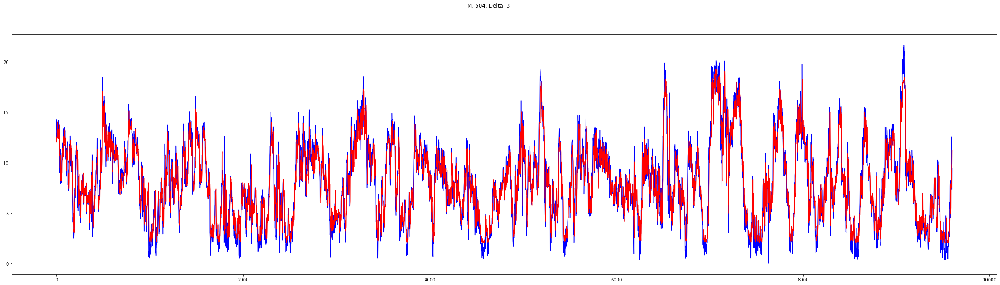

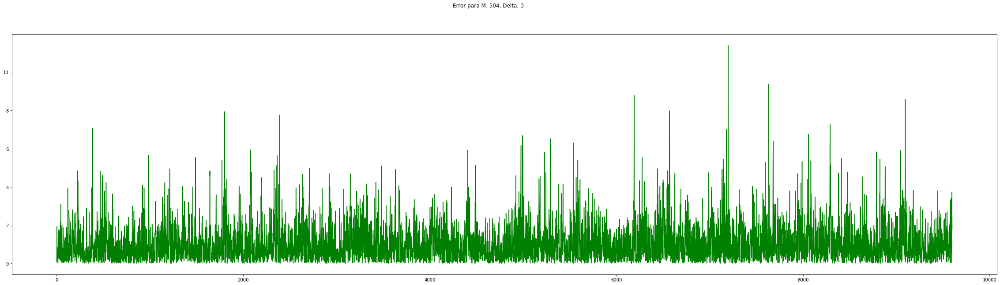

[0]	train-rmse:1.12231	eval-rmse:0.94486
[1]	train-rmse:1.12231	eval-rmse:0.94486
[2]	train-rmse:1.12231	eval-rmse:0.94486
[3]	train-rmse:1.12231	eval-rmse:0.94486
[4]	train-rmse:1.12231	eval-rmse:0.94486
[0]	train-rmse:1.10070	eval-rmse:0.93066
[1]	train-rmse:1.08288	eval-rmse:0.92005
[2]	train-rmse:1.06823	eval-rmse:0.91231
[3]	train-rmse:1.05621	eval-rmse:0.90685
[4]	train-rmse:1.04638	eval-rmse:0.90319
[5]	train-rmse:1.03834	eval-rmse:0.90091
[6]	train-rmse:1.03179	eval-rmse:0.89970
[7]	train-rmse:1.02645	eval-rmse:0.89928
[8]	train-rmse:1.02210	eval-rmse:0.89945
[9]	train-rmse:1.01857	eval-rmse:0.90005
[10]	train-rmse:1.01570	eval-rmse:0.90095
[11]	train-rmse:1.01337	eval-rmse:0.90206
[12]	train-rmse:1.01147	eval-rmse:0.90328
[0]	train-rmse:1.08100	eval-rmse:0.91900
[1]	train-rmse:1.05371	eval-rmse:0.90585
[2]	train-rmse:1.03587	eval-rmse:0.90038
[3]	train-rmse:1.02429	eval-rmse:0.89930
[4]	train-rmse:1.01680	eval-rmse:0.90056
[5]	train-rmse:1.01199	eval-rmse:0.90292
[6]	train-rms

[9]	train-rmse:0.69799	eval-rmse:0.68211
[10]	train-rmse:0.69349	eval-rmse:0.67900
[11]	train-rmse:0.69132	eval-rmse:0.67563
[12]	train-rmse:0.68915	eval-rmse:0.67478
[13]	train-rmse:0.68697	eval-rmse:0.67449
[14]	train-rmse:0.68529	eval-rmse:0.67359
[15]	train-rmse:0.68357	eval-rmse:0.67310
[16]	train-rmse:0.68218	eval-rmse:0.67224
[17]	train-rmse:0.68057	eval-rmse:0.67099
[18]	train-rmse:0.67920	eval-rmse:0.67468
[19]	train-rmse:0.67759	eval-rmse:0.67214
[20]	train-rmse:0.67595	eval-rmse:0.67026
[21]	train-rmse:0.67462	eval-rmse:0.67007
[22]	train-rmse:0.67323	eval-rmse:0.66921
[23]	train-rmse:0.67213	eval-rmse:0.67046
[24]	train-rmse:0.67087	eval-rmse:0.67119
[25]	train-rmse:0.66972	eval-rmse:0.67164
[26]	train-rmse:0.66863	eval-rmse:0.67148
[27]	train-rmse:0.66742	eval-rmse:0.66957
[0]	train-rmse:0.82369	eval-rmse:0.73715
[1]	train-rmse:0.76746	eval-rmse:0.70695
[2]	train-rmse:0.73227	eval-rmse:0.68835
[3]	train-rmse:0.72493	eval-rmse:0.68958
[4]	train-rmse:0.71959	eval-rmse:0.6931

[13]	train-rmse:0.63759	eval-rmse:0.65811
[14]	train-rmse:0.63309	eval-rmse:0.65785
[15]	train-rmse:0.62840	eval-rmse:0.66068
[16]	train-rmse:0.62456	eval-rmse:0.65956
[0]	train-rmse:0.92941	eval-rmse:0.80237
[1]	train-rmse:0.81536	eval-rmse:0.72603
[2]	train-rmse:0.74874	eval-rmse:0.68785
[3]	train-rmse:0.70815	eval-rmse:0.67212
[4]	train-rmse:0.68464	eval-rmse:0.66208
[5]	train-rmse:0.66865	eval-rmse:0.66275
[6]	train-rmse:0.65756	eval-rmse:0.66095
[7]	train-rmse:0.64748	eval-rmse:0.66551
[8]	train-rmse:0.64009	eval-rmse:0.66620
[9]	train-rmse:0.63304	eval-rmse:0.66525
[10]	train-rmse:0.62793	eval-rmse:0.66664
[0]	train-rmse:0.87344	eval-rmse:0.76305
[1]	train-rmse:0.75872	eval-rmse:0.68955
[2]	train-rmse:0.70350	eval-rmse:0.66829
[3]	train-rmse:0.67541	eval-rmse:0.66744
[4]	train-rmse:0.65880	eval-rmse:0.66553
[5]	train-rmse:0.64644	eval-rmse:0.66653
[6]	train-rmse:0.63743	eval-rmse:0.66547
[7]	train-rmse:0.63148	eval-rmse:0.66547
[8]	train-rmse:0.62630	eval-rmse:0.66648
[9]	train-r

[28]	train-rmse:0.52582	eval-rmse:0.66514
[0]	train-rmse:0.97823	eval-rmse:0.85187
[1]	train-rmse:0.87032	eval-rmse:0.78432
[2]	train-rmse:0.78953	eval-rmse:0.73741
[3]	train-rmse:0.73022	eval-rmse:0.71121
[4]	train-rmse:0.68578	eval-rmse:0.69093
[5]	train-rmse:0.65118	eval-rmse:0.67861
[6]	train-rmse:0.62506	eval-rmse:0.67477
[7]	train-rmse:0.60428	eval-rmse:0.67312
[8]	train-rmse:0.58861	eval-rmse:0.67059
[9]	train-rmse:0.57470	eval-rmse:0.66943
[10]	train-rmse:0.56251	eval-rmse:0.67001
[11]	train-rmse:0.55278	eval-rmse:0.67009
[12]	train-rmse:0.54339	eval-rmse:0.67014
[13]	train-rmse:0.53369	eval-rmse:0.67044
[0]	train-rmse:0.91147	eval-rmse:0.81180
[1]	train-rmse:0.78013	eval-rmse:0.73946
[2]	train-rmse:0.69918	eval-rmse:0.69928
[3]	train-rmse:0.64664	eval-rmse:0.68372
[4]	train-rmse:0.61387	eval-rmse:0.67785
[5]	train-rmse:0.58956	eval-rmse:0.67378
[6]	train-rmse:0.56809	eval-rmse:0.67537
[7]	train-rmse:0.55121	eval-rmse:0.67556
[8]	train-rmse:0.53573	eval-rmse:0.67635
[9]	train-r

[5]	train-rmse:0.57265	eval-rmse:0.69795
[6]	train-rmse:0.53598	eval-rmse:0.69325
[7]	train-rmse:0.50391	eval-rmse:0.69127
[8]	train-rmse:0.48450	eval-rmse:0.68907
[9]	train-rmse:0.46506	eval-rmse:0.68838
[10]	train-rmse:0.44637	eval-rmse:0.68910
[11]	train-rmse:0.43106	eval-rmse:0.68780
[12]	train-rmse:0.41312	eval-rmse:0.68854
[13]	train-rmse:0.39684	eval-rmse:0.69192
[14]	train-rmse:0.38358	eval-rmse:0.69353
[15]	train-rmse:0.37175	eval-rmse:0.69441
[16]	train-rmse:0.36071	eval-rmse:0.69759
[0]	train-rmse:0.88765	eval-rmse:0.81644
[1]	train-rmse:0.73637	eval-rmse:0.74437
[2]	train-rmse:0.63952	eval-rmse:0.71444
[3]	train-rmse:0.56895	eval-rmse:0.70410
[4]	train-rmse:0.52071	eval-rmse:0.69660
[5]	train-rmse:0.48261	eval-rmse:0.69744
[6]	train-rmse:0.45080	eval-rmse:0.69656
[7]	train-rmse:0.42729	eval-rmse:0.69899
[8]	train-rmse:0.40453	eval-rmse:0.69880
[9]	train-rmse:0.38793	eval-rmse:0.70434
[10]	train-rmse:0.37190	eval-rmse:0.70577
[11]	train-rmse:0.35917	eval-rmse:0.70827
[0]	tra

[5]	train-rmse:0.36307	eval-rmse:0.72948
[6]	train-rmse:0.32554	eval-rmse:0.73108
[7]	train-rmse:0.29390	eval-rmse:0.73250
[8]	train-rmse:0.26953	eval-rmse:0.73552
[9]	train-rmse:0.25320	eval-rmse:0.73728
[0]	train-rmse:0.78310	eval-rmse:0.79690
[1]	train-rmse:0.58883	eval-rmse:0.75011
[2]	train-rmse:0.46720	eval-rmse:0.73384
[3]	train-rmse:0.39127	eval-rmse:0.73397
[4]	train-rmse:0.33425	eval-rmse:0.74037
[5]	train-rmse:0.29576	eval-rmse:0.74385
[6]	train-rmse:0.26977	eval-rmse:0.74582
[0]	train-rmse:0.70799	eval-rmse:0.77867
[1]	train-rmse:0.51023	eval-rmse:0.74266
[2]	train-rmse:0.40861	eval-rmse:0.73753
[3]	train-rmse:0.34444	eval-rmse:0.74635
[4]	train-rmse:0.30916	eval-rmse:0.75191
[5]	train-rmse:0.27628	eval-rmse:0.75765
[6]	train-rmse:0.25023	eval-rmse:0.76113
[0]	train-rmse:0.63959	eval-rmse:0.76933
[1]	train-rmse:0.44863	eval-rmse:0.75234
[2]	train-rmse:0.36826	eval-rmse:0.76122
[3]	train-rmse:0.30792	eval-rmse:0.77243
[4]	train-rmse:0.27136	eval-rmse:0.77924
[5]	train-rmse:0

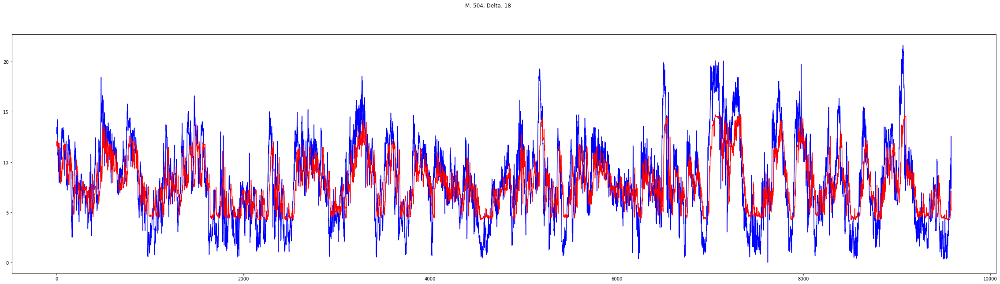

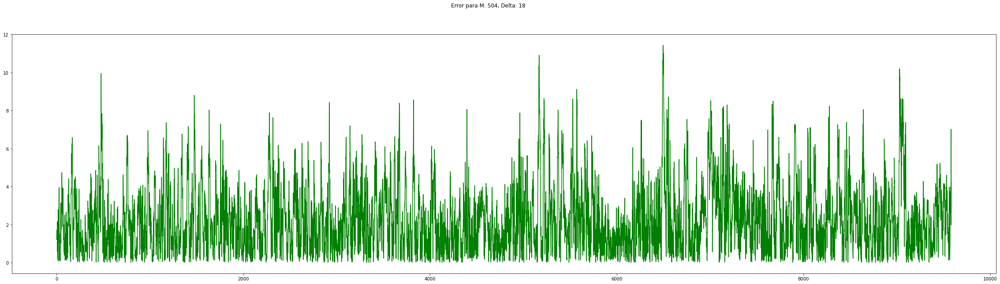

[0]	train-rmse:1.12194	eval-rmse:0.94518
[1]	train-rmse:1.12194	eval-rmse:0.94518
[2]	train-rmse:1.12194	eval-rmse:0.94518
[3]	train-rmse:1.12194	eval-rmse:0.94518
[4]	train-rmse:1.12194	eval-rmse:0.94518
[0]	train-rmse:1.10041	eval-rmse:0.93091
[1]	train-rmse:1.08267	eval-rmse:0.92023
[2]	train-rmse:1.06808	eval-rmse:0.91242
[3]	train-rmse:1.05611	eval-rmse:0.90689
[4]	train-rmse:1.04632	eval-rmse:0.90315
[5]	train-rmse:1.03831	eval-rmse:0.90080
[6]	train-rmse:1.03179	eval-rmse:0.89951
[7]	train-rmse:1.02647	eval-rmse:0.89903
[8]	train-rmse:1.02214	eval-rmse:0.89915
[9]	train-rmse:1.01863	eval-rmse:0.89969
[10]	train-rmse:1.01577	eval-rmse:0.90055
[11]	train-rmse:1.01344	eval-rmse:0.90160
[12]	train-rmse:1.01156	eval-rmse:0.90278
[0]	train-rmse:1.08079	eval-rmse:0.91917
[1]	train-rmse:1.05362	eval-rmse:0.90586
[2]	train-rmse:1.03585	eval-rmse:0.90024
[3]	train-rmse:1.02432	eval-rmse:0.89902
[4]	train-rmse:1.01687	eval-rmse:0.90017
[5]	train-rmse:1.01207	eval-rmse:0.90243
[6]	train-rms

[11]	train-rmse:0.79873	eval-rmse:0.80589
[0]	train-rmse:0.98880	eval-rmse:0.85674
[1]	train-rmse:0.91344	eval-rmse:0.81879
[2]	train-rmse:0.86908	eval-rmse:0.80345
[3]	train-rmse:0.84376	eval-rmse:0.79735
[4]	train-rmse:0.82623	eval-rmse:0.80408
[5]	train-rmse:0.81408	eval-rmse:0.80683
[6]	train-rmse:0.80486	eval-rmse:0.80912
[7]	train-rmse:0.79848	eval-rmse:0.81168
[0]	train-rmse:0.95189	eval-rmse:0.83578
[1]	train-rmse:0.87599	eval-rmse:0.80412
[2]	train-rmse:0.83973	eval-rmse:0.79678
[3]	train-rmse:0.81837	eval-rmse:0.80584
[4]	train-rmse:0.80719	eval-rmse:0.81409
[5]	train-rmse:0.79730	eval-rmse:0.81543
[6]	train-rmse:0.78937	eval-rmse:0.82137
[7]	train-rmse:0.78140	eval-rmse:0.82138
[0]	train-rmse:0.91949	eval-rmse:0.81969
[1]	train-rmse:0.85103	eval-rmse:0.79888
[2]	train-rmse:0.82466	eval-rmse:0.80532
[3]	train-rmse:0.80902	eval-rmse:0.80652
[4]	train-rmse:0.79790	eval-rmse:0.81992
[5]	train-rmse:0.78981	eval-rmse:0.82622
[0]	train-rmse:0.89211	eval-rmse:0.80874
[1]	train-rmse:

[1]	train-rmse:0.75115	eval-rmse:0.86567
[2]	train-rmse:0.72238	eval-rmse:0.87336
[3]	train-rmse:0.70153	eval-rmse:0.88314
[4]	train-rmse:0.67683	eval-rmse:0.89651
[0]	train-rmse:0.79527	eval-rmse:0.86536
[1]	train-rmse:0.74428	eval-rmse:0.87824
[2]	train-rmse:0.71086	eval-rmse:0.89472
[3]	train-rmse:0.68963	eval-rmse:0.89849
[4]	train-rmse:0.67105	eval-rmse:0.90702
[0]	train-rmse:0.78282	eval-rmse:0.88052
[1]	train-rmse:0.74141	eval-rmse:0.89539
[2]	train-rmse:0.72015	eval-rmse:0.90247
[3]	train-rmse:0.69674	eval-rmse:0.90931
[4]	train-rmse:0.67677	eval-rmse:0.91509
[0]	train-rmse:1.12194	eval-rmse:0.94518
[1]	train-rmse:1.12194	eval-rmse:0.94518
[2]	train-rmse:1.12194	eval-rmse:0.94518
[3]	train-rmse:1.12194	eval-rmse:0.94518
[4]	train-rmse:1.12194	eval-rmse:0.94518
[5]	train-rmse:1.12194	eval-rmse:0.94518
[0]	train-rmse:1.06058	eval-rmse:0.91711
[1]	train-rmse:1.00713	eval-rmse:0.89644
[2]	train-rmse:0.96049	eval-rmse:0.87901
[3]	train-rmse:0.91941	eval-rmse:0.86393
[4]	train-rmse:0

[2]	train-rmse:0.67672	eval-rmse:0.85752
[3]	train-rmse:0.61085	eval-rmse:0.85411
[4]	train-rmse:0.56471	eval-rmse:0.86112
[5]	train-rmse:0.53033	eval-rmse:0.86553
[6]	train-rmse:0.49428	eval-rmse:0.87260
[7]	train-rmse:0.46594	eval-rmse:0.87811
[0]	train-rmse:0.85436	eval-rmse:0.87322
[1]	train-rmse:0.69820	eval-rmse:0.85713
[2]	train-rmse:0.60384	eval-rmse:0.87007
[3]	train-rmse:0.54239	eval-rmse:0.88394
[4]	train-rmse:0.50731	eval-rmse:0.89199
[5]	train-rmse:0.46555	eval-rmse:0.89927
[6]	train-rmse:0.43424	eval-rmse:0.90392
[0]	train-rmse:0.79914	eval-rmse:0.87280
[1]	train-rmse:0.64744	eval-rmse:0.87353
[2]	train-rmse:0.56929	eval-rmse:0.88792
[3]	train-rmse:0.51668	eval-rmse:0.90380
[4]	train-rmse:0.47559	eval-rmse:0.91511
[5]	train-rmse:0.44902	eval-rmse:0.92038
[0]	train-rmse:0.75080	eval-rmse:0.87968
[1]	train-rmse:0.61029	eval-rmse:0.89064
[2]	train-rmse:0.55066	eval-rmse:0.90833
[3]	train-rmse:0.49508	eval-rmse:0.92391
[4]	train-rmse:0.44842	eval-rmse:0.93598
[0]	train-rmse:0

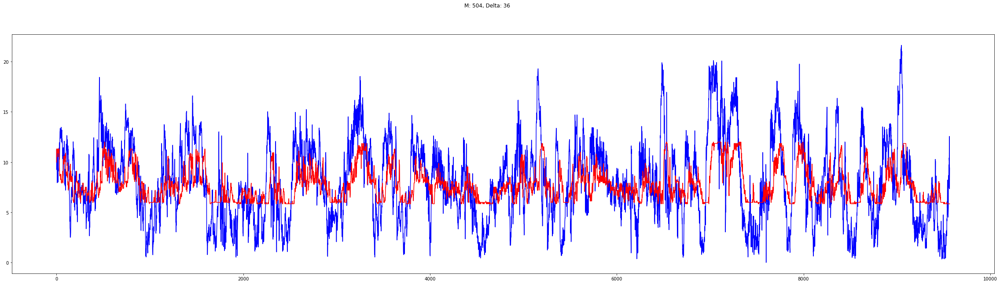

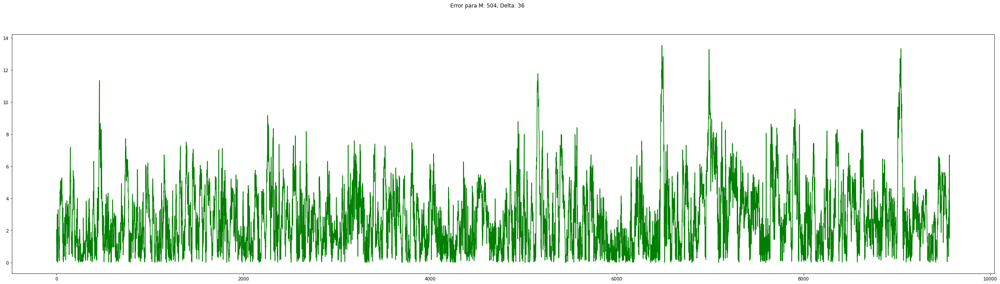

[0]	train-rmse:1.12256	eval-rmse:0.94679
[1]	train-rmse:1.12256	eval-rmse:0.94679
[2]	train-rmse:1.12256	eval-rmse:0.94679
[3]	train-rmse:1.12256	eval-rmse:0.94679
[4]	train-rmse:1.12256	eval-rmse:0.94679
[5]	train-rmse:1.12256	eval-rmse:0.94679
[0]	train-rmse:1.10112	eval-rmse:0.93248
[1]	train-rmse:1.08343	eval-rmse:0.92173
[2]	train-rmse:1.06889	eval-rmse:0.91386
[3]	train-rmse:1.05697	eval-rmse:0.90827
[4]	train-rmse:1.04721	eval-rmse:0.90446
[5]	train-rmse:1.03924	eval-rmse:0.90205
[6]	train-rmse:1.03274	eval-rmse:0.90071
[7]	train-rmse:1.02745	eval-rmse:0.90017
[8]	train-rmse:1.02314	eval-rmse:0.90023
[9]	train-rmse:1.01963	eval-rmse:0.90073
[10]	train-rmse:1.01678	eval-rmse:0.90154
[11]	train-rmse:1.01447	eval-rmse:0.90255
[0]	train-rmse:1.08157	eval-rmse:0.92067
[1]	train-rmse:1.05449	eval-rmse:0.90722
[2]	train-rmse:1.03679	eval-rmse:0.90147
[3]	train-rmse:1.02530	eval-rmse:0.90014
[4]	train-rmse:1.01788	eval-rmse:0.90117
[5]	train-rmse:1.01310	eval-rmse:0.90335
[6]	train-rmse

[4]	train-rmse:0.86697	eval-rmse:0.94601
[5]	train-rmse:0.85703	eval-rmse:0.94837
[0]	train-rmse:0.92893	eval-rmse:0.88083
[1]	train-rmse:0.89848	eval-rmse:0.93302
[2]	train-rmse:0.87980	eval-rmse:0.94050
[3]	train-rmse:0.87234	eval-rmse:0.93913
[4]	train-rmse:0.86214	eval-rmse:0.95367
[0]	train-rmse:1.12256	eval-rmse:0.94679
[1]	train-rmse:1.12256	eval-rmse:0.94679
[2]	train-rmse:1.12256	eval-rmse:0.94679
[3]	train-rmse:1.12256	eval-rmse:0.94679
[4]	train-rmse:1.12256	eval-rmse:0.94679
[5]	train-rmse:1.12256	eval-rmse:0.94679
[0]	train-rmse:1.08406	eval-rmse:0.92741
[1]	train-rmse:1.05094	eval-rmse:0.91387
[2]	train-rmse:1.02203	eval-rmse:0.90689
[3]	train-rmse:0.99702	eval-rmse:0.90132
[4]	train-rmse:0.97537	eval-rmse:0.89757
[5]	train-rmse:0.95689	eval-rmse:0.89257
[6]	train-rmse:0.94081	eval-rmse:0.89215
[7]	train-rmse:0.92700	eval-rmse:0.89248
[8]	train-rmse:0.91531	eval-rmse:0.89300
[9]	train-rmse:0.90494	eval-rmse:0.89539
[10]	train-rmse:0.89583	eval-rmse:0.89627
[0]	train-rmse:

[4]	train-rmse:1.12256	eval-rmse:0.94679
[5]	train-rmse:1.12256	eval-rmse:0.94679
[0]	train-rmse:1.06511	eval-rmse:0.93449
[1]	train-rmse:1.01384	eval-rmse:0.92412
[2]	train-rmse:0.96974	eval-rmse:0.91823
[3]	train-rmse:0.92766	eval-rmse:0.91518
[4]	train-rmse:0.89345	eval-rmse:0.91461
[5]	train-rmse:0.85831	eval-rmse:0.91523
[6]	train-rmse:0.82911	eval-rmse:0.91578
[7]	train-rmse:0.80513	eval-rmse:0.91932
[8]	train-rmse:0.78045	eval-rmse:0.92208
[0]	train-rmse:1.01090	eval-rmse:0.92710
[1]	train-rmse:0.92282	eval-rmse:0.92035
[2]	train-rmse:0.85793	eval-rmse:0.92318
[3]	train-rmse:0.79895	eval-rmse:0.92624
[4]	train-rmse:0.75464	eval-rmse:0.93393
[5]	train-rmse:0.72093	eval-rmse:0.94351
[0]	train-rmse:0.96049	eval-rmse:0.92474
[1]	train-rmse:0.85011	eval-rmse:0.92648
[2]	train-rmse:0.77354	eval-rmse:0.93642
[3]	train-rmse:0.71771	eval-rmse:0.95681
[4]	train-rmse:0.67591	eval-rmse:0.96376
[0]	train-rmse:0.91451	eval-rmse:0.92745
[1]	train-rmse:0.79831	eval-rmse:0.94595
[2]	train-rmse:0

[2]	train-rmse:0.52988	eval-rmse:1.00422
[3]	train-rmse:0.45140	eval-rmse:1.01583
[4]	train-rmse:0.39191	eval-rmse:1.02436
[0]	train-rmse:0.76385	eval-rmse:0.95962
[1]	train-rmse:0.57415	eval-rmse:1.00447
[2]	train-rmse:0.46530	eval-rmse:1.04501
[3]	train-rmse:0.39713	eval-rmse:1.06857
[4]	train-rmse:0.34226	eval-rmse:1.07654
[0]	train-rmse:0.70778	eval-rmse:0.98527
[1]	train-rmse:0.52631	eval-rmse:1.04436
[2]	train-rmse:0.42186	eval-rmse:1.07284
[3]	train-rmse:0.37087	eval-rmse:1.08327
[4]	train-rmse:0.30491	eval-rmse:1.09568
[0]	train-rmse:0.66035	eval-rmse:1.01766
[1]	train-rmse:0.48425	eval-rmse:1.07391
[2]	train-rmse:0.39352	eval-rmse:1.09582
[3]	train-rmse:0.31761	eval-rmse:1.10943
[4]	train-rmse:0.28050	eval-rmse:1.11481
[5]	train-rmse:0.26295	eval-rmse:1.11882
[0]	train-rmse:0.62351	eval-rmse:1.05617
[1]	train-rmse:0.46979	eval-rmse:1.10899
[2]	train-rmse:0.37211	eval-rmse:1.13248
[3]	train-rmse:0.33303	eval-rmse:1.13903
[4]	train-rmse:0.31969	eval-rmse:1.14162
[0]	train-rmse:0

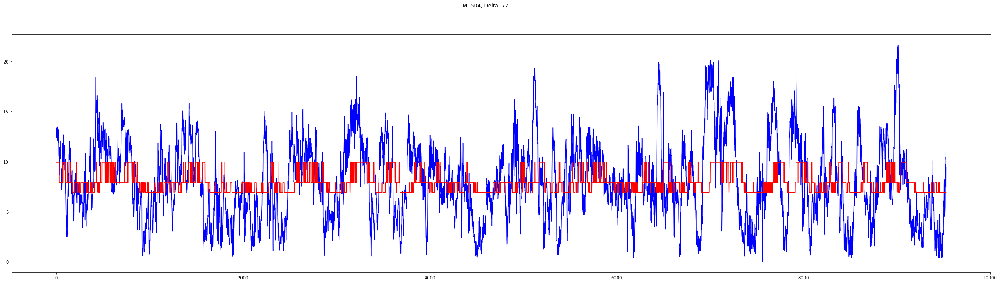

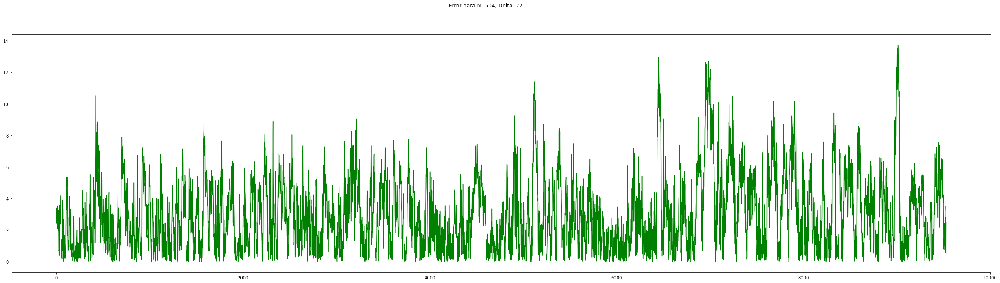

Wind Direction (°)
[0]	train-rmse:1.12026	eval-rmse:1.24678
[1]	train-rmse:1.12026	eval-rmse:1.24678
[2]	train-rmse:1.12026	eval-rmse:1.24678
[3]	train-rmse:1.12026	eval-rmse:1.24678
[4]	train-rmse:1.12026	eval-rmse:1.24678
[5]	train-rmse:1.12026	eval-rmse:1.24678
[0]	train-rmse:1.09845	eval-rmse:1.21175
[1]	train-rmse:1.08046	eval-rmse:1.18118
[2]	train-rmse:1.06566	eval-rmse:1.15450
[3]	train-rmse:1.05353	eval-rmse:1.13122
[4]	train-rmse:1.04359	eval-rmse:1.11088
[5]	train-rmse:1.03548	eval-rmse:1.09312
[6]	train-rmse:1.02886	eval-rmse:1.07759
[7]	train-rmse:1.02346	eval-rmse:1.06399
[8]	train-rmse:1.01907	eval-rmse:1.05207
[9]	train-rmse:1.01550	eval-rmse:1.04162
[10]	train-rmse:1.01260	eval-rmse:1.03244
[11]	train-rmse:1.01024	eval-rmse:1.02437
[12]	train-rmse:1.00833	eval-rmse:1.01726
[13]	train-rmse:1.00678	eval-rmse:1.01099
[14]	train-rmse:1.00552	eval-rmse:1.00545
[15]	train-rmse:1.00450	eval-rmse:1.00055
[16]	train-rmse:1.00367	eval-rmse:0.99622
[17]	train-rmse:1.00300	eval-rm

[13]	train-rmse:1.00014	eval-rmse:0.96177
[14]	train-rmse:1.00014	eval-rmse:0.96137
[15]	train-rmse:1.00014	eval-rmse:0.96109
[16]	train-rmse:1.00014	eval-rmse:0.96089
[17]	train-rmse:1.00013	eval-rmse:0.96075
[18]	train-rmse:1.00013	eval-rmse:0.96066
[19]	train-rmse:1.00013	eval-rmse:0.96059
[20]	train-rmse:1.00013	eval-rmse:0.96054
[21]	train-rmse:1.00013	eval-rmse:0.96051
[22]	train-rmse:1.00013	eval-rmse:0.96049
[23]	train-rmse:1.00013	eval-rmse:0.96047
[24]	train-rmse:1.00013	eval-rmse:0.96046
[25]	train-rmse:1.00013	eval-rmse:0.96045
[26]	train-rmse:1.00013	eval-rmse:0.96044
[27]	train-rmse:1.00013	eval-rmse:0.96044
[28]	train-rmse:1.00013	eval-rmse:0.96044
[29]	train-rmse:1.00013	eval-rmse:0.96044
[30]	train-rmse:1.00013	eval-rmse:0.96043
[31]	train-rmse:1.00013	eval-rmse:0.96043
[32]	train-rmse:1.00013	eval-rmse:0.96043
[33]	train-rmse:1.00013	eval-rmse:0.96043
[34]	train-rmse:1.00013	eval-rmse:0.96043
[35]	train-rmse:1.00013	eval-rmse:0.96043
[36]	train-rmse:1.00013	eval-rmse:

[12]	train-rmse:0.56303	eval-rmse:0.47268
[13]	train-rmse:0.56183	eval-rmse:0.47307
[14]	train-rmse:0.56060	eval-rmse:0.47025
[15]	train-rmse:0.55960	eval-rmse:0.47050
[16]	train-rmse:0.55890	eval-rmse:0.46954
[17]	train-rmse:0.55822	eval-rmse:0.46987
[18]	train-rmse:0.55754	eval-rmse:0.47042
[19]	train-rmse:0.55689	eval-rmse:0.47103
[20]	train-rmse:0.55632	eval-rmse:0.47085
[21]	train-rmse:0.55571	eval-rmse:0.47096
[0]	train-rmse:0.73340	eval-rmse:0.71508
[1]	train-rmse:0.63388	eval-rmse:0.56220
[2]	train-rmse:0.60246	eval-rmse:0.51796
[3]	train-rmse:0.58935	eval-rmse:0.49324
[4]	train-rmse:0.58295	eval-rmse:0.48590
[5]	train-rmse:0.57943	eval-rmse:0.48467
[6]	train-rmse:0.57624	eval-rmse:0.47837
[7]	train-rmse:0.57308	eval-rmse:0.47666
[8]	train-rmse:0.56953	eval-rmse:0.47599
[9]	train-rmse:0.56722	eval-rmse:0.47614
[10]	train-rmse:0.56603	eval-rmse:0.47677
[11]	train-rmse:0.56489	eval-rmse:0.47397
[12]	train-rmse:0.56385	eval-rmse:0.47368
[13]	train-rmse:0.56264	eval-rmse:0.47326
[1

[1]	train-rmse:0.56705	eval-rmse:0.48630
[2]	train-rmse:0.54838	eval-rmse:0.46724
[3]	train-rmse:0.54084	eval-rmse:0.46896
[4]	train-rmse:0.53460	eval-rmse:0.47532
[5]	train-rmse:0.52987	eval-rmse:0.47656
[6]	train-rmse:0.52743	eval-rmse:0.47789
[7]	train-rmse:0.52349	eval-rmse:0.48048
[0]	train-rmse:0.60705	eval-rmse:0.54008
[1]	train-rmse:0.55838	eval-rmse:0.47946
[2]	train-rmse:0.54765	eval-rmse:0.47458
[3]	train-rmse:0.54165	eval-rmse:0.48773
[4]	train-rmse:0.53605	eval-rmse:0.48890
[5]	train-rmse:0.53207	eval-rmse:0.49212
[6]	train-rmse:0.52886	eval-rmse:0.49444
[0]	train-rmse:0.58374	eval-rmse:0.49694
[1]	train-rmse:0.55495	eval-rmse:0.47111
[2]	train-rmse:0.54500	eval-rmse:0.47979
[3]	train-rmse:0.53928	eval-rmse:0.48085
[4]	train-rmse:0.53198	eval-rmse:0.48446
[5]	train-rmse:0.52839	eval-rmse:0.48694
[0]	train-rmse:1.12026	eval-rmse:1.24678
[1]	train-rmse:1.12026	eval-rmse:1.24678
[2]	train-rmse:1.12026	eval-rmse:1.24678
[3]	train-rmse:1.12026	eval-rmse:1.24678
[4]	train-rmse:1

[0]	train-rmse:0.95366	eval-rmse:1.03884
[1]	train-rmse:0.82652	eval-rmse:0.87991
[2]	train-rmse:0.73243	eval-rmse:0.75916
[3]	train-rmse:0.66322	eval-rmse:0.67061
[4]	train-rmse:0.61296	eval-rmse:0.60630
[5]	train-rmse:0.57762	eval-rmse:0.56103
[6]	train-rmse:0.55169	eval-rmse:0.52990
[7]	train-rmse:0.53017	eval-rmse:0.51018
[8]	train-rmse:0.51648	eval-rmse:0.49618
[9]	train-rmse:0.50585	eval-rmse:0.48646
[10]	train-rmse:0.49708	eval-rmse:0.48129
[11]	train-rmse:0.48929	eval-rmse:0.47935
[12]	train-rmse:0.48180	eval-rmse:0.47733
[13]	train-rmse:0.47615	eval-rmse:0.47594
[14]	train-rmse:0.47042	eval-rmse:0.47597
[15]	train-rmse:0.46722	eval-rmse:0.47492
[16]	train-rmse:0.46322	eval-rmse:0.47557
[17]	train-rmse:0.45964	eval-rmse:0.47553
[18]	train-rmse:0.45472	eval-rmse:0.47519
[19]	train-rmse:0.45011	eval-rmse:0.47650
[0]	train-rmse:0.87490	eval-rmse:0.93867
[1]	train-rmse:0.71930	eval-rmse:0.74012
[2]	train-rmse:0.62514	eval-rmse:0.61816
[3]	train-rmse:0.56996	eval-rmse:0.54827
[4]	tr

[4]	train-rmse:0.42850	eval-rmse:0.50696
[5]	train-rmse:0.42227	eval-rmse:0.50682
[6]	train-rmse:0.41420	eval-rmse:0.50786
[0]	train-rmse:0.55368	eval-rmse:0.54556
[1]	train-rmse:0.48595	eval-rmse:0.49730
[2]	train-rmse:0.45907	eval-rmse:0.50408
[3]	train-rmse:0.44356	eval-rmse:0.51731
[4]	train-rmse:0.43436	eval-rmse:0.51945
[5]	train-rmse:0.43187	eval-rmse:0.52107
[0]	train-rmse:0.52578	eval-rmse:0.51041
[1]	train-rmse:0.48200	eval-rmse:0.50978
[2]	train-rmse:0.47066	eval-rmse:0.51264
[3]	train-rmse:0.46472	eval-rmse:0.51680
[4]	train-rmse:0.45104	eval-rmse:0.52880
[5]	train-rmse:0.43802	eval-rmse:0.53634
[6]	train-rmse:0.42324	eval-rmse:0.53937
[0]	train-rmse:1.12026	eval-rmse:1.24678
[1]	train-rmse:1.12026	eval-rmse:1.24678
[2]	train-rmse:1.12026	eval-rmse:1.24678
[3]	train-rmse:1.12026	eval-rmse:1.24678
[4]	train-rmse:1.12026	eval-rmse:1.24678
[5]	train-rmse:1.12026	eval-rmse:1.24678
[0]	train-rmse:1.03109	eval-rmse:1.14178
[1]	train-rmse:0.95200	eval-rmse:1.04837
[2]	train-rmse:0

[44]	train-rmse:0.28116	eval-rmse:0.47859
[45]	train-rmse:0.28035	eval-rmse:0.47854
[46]	train-rmse:0.27581	eval-rmse:0.47847
[47]	train-rmse:0.27513	eval-rmse:0.47869
[48]	train-rmse:0.27138	eval-rmse:0.47852
[49]	train-rmse:0.27026	eval-rmse:0.47860
[50]	train-rmse:0.26638	eval-rmse:0.47889
[51]	train-rmse:0.26585	eval-rmse:0.47887
[0]	train-rmse:0.94006	eval-rmse:1.03919
[1]	train-rmse:0.79751	eval-rmse:0.87988
[2]	train-rmse:0.68692	eval-rmse:0.76183
[3]	train-rmse:0.60045	eval-rmse:0.67399
[4]	train-rmse:0.53411	eval-rmse:0.61303
[5]	train-rmse:0.48458	eval-rmse:0.56954
[6]	train-rmse:0.44610	eval-rmse:0.54002
[7]	train-rmse:0.41778	eval-rmse:0.52136
[8]	train-rmse:0.39444	eval-rmse:0.50949
[9]	train-rmse:0.37561	eval-rmse:0.50118
[10]	train-rmse:0.36231	eval-rmse:0.49553
[11]	train-rmse:0.34974	eval-rmse:0.49138
[12]	train-rmse:0.33897	eval-rmse:0.48901
[13]	train-rmse:0.32618	eval-rmse:0.48867
[14]	train-rmse:0.31645	eval-rmse:0.48965
[15]	train-rmse:0.31062	eval-rmse:0.48893
[1

[3]	train-rmse:0.33882	eval-rmse:0.52691
[4]	train-rmse:0.32277	eval-rmse:0.52797
[5]	train-rmse:0.30114	eval-rmse:0.52970
[6]	train-rmse:0.28546	eval-rmse:0.53331
[0]	train-rmse:0.53667	eval-rmse:0.61995
[1]	train-rmse:0.40295	eval-rmse:0.53008
[2]	train-rmse:0.35686	eval-rmse:0.52517
[3]	train-rmse:0.32010	eval-rmse:0.52899
[4]	train-rmse:0.28515	eval-rmse:0.53653
[5]	train-rmse:0.27581	eval-rmse:0.53911
[6]	train-rmse:0.26545	eval-rmse:0.54104
[7]	train-rmse:0.24389	eval-rmse:0.54594
[0]	train-rmse:0.48329	eval-rmse:0.57303
[1]	train-rmse:0.38040	eval-rmse:0.53260
[2]	train-rmse:0.33225	eval-rmse:0.55584
[3]	train-rmse:0.32415	eval-rmse:0.56033
[4]	train-rmse:0.31693	eval-rmse:0.56158
[5]	train-rmse:0.28762	eval-rmse:0.57155
[0]	train-rmse:0.44726	eval-rmse:0.54789
[1]	train-rmse:0.36734	eval-rmse:0.54285
[2]	train-rmse:0.34375	eval-rmse:0.55297
[3]	train-rmse:0.30931	eval-rmse:0.56191
[4]	train-rmse:0.28963	eval-rmse:0.56303
[5]	train-rmse:0.28429	eval-rmse:0.56332
Best Max. Depth:

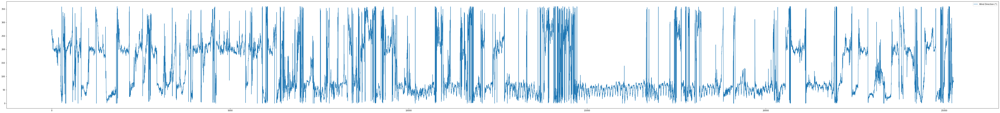

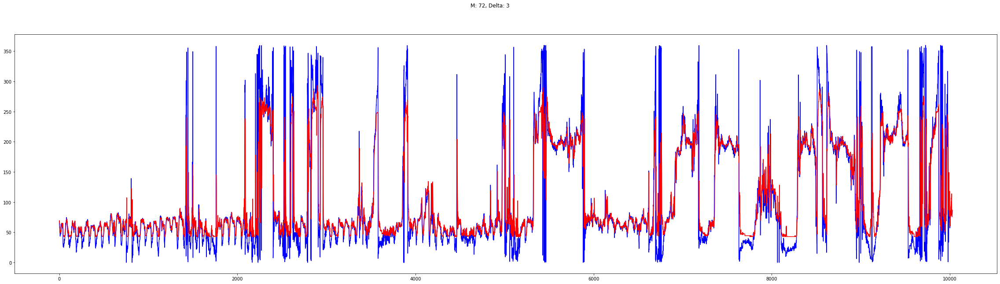

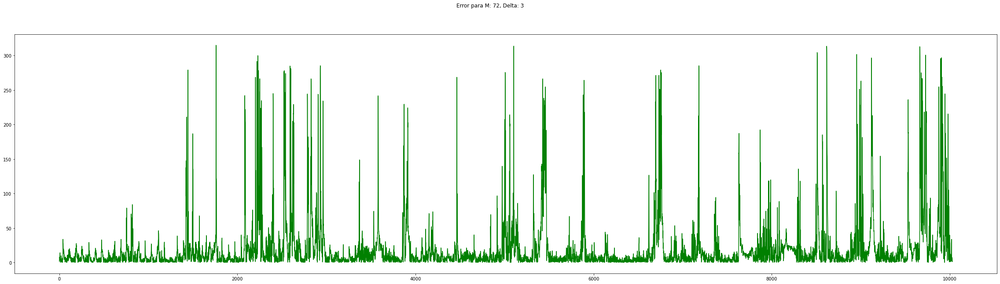

[0]	train-rmse:1.12081	eval-rmse:1.24655
[1]	train-rmse:1.12081	eval-rmse:1.24655
[2]	train-rmse:1.12081	eval-rmse:1.24655
[3]	train-rmse:1.12081	eval-rmse:1.24655
[4]	train-rmse:1.12081	eval-rmse:1.24655
[0]	train-rmse:1.09896	eval-rmse:1.21150
[1]	train-rmse:1.08093	eval-rmse:1.18092
[2]	train-rmse:1.06611	eval-rmse:1.15423
[3]	train-rmse:1.05394	eval-rmse:1.13095
[4]	train-rmse:1.04399	eval-rmse:1.11061
[5]	train-rmse:1.03586	eval-rmse:1.09285
[6]	train-rmse:1.02922	eval-rmse:1.07732
[7]	train-rmse:1.02382	eval-rmse:1.06373
[8]	train-rmse:1.01942	eval-rmse:1.05182
[9]	train-rmse:1.01584	eval-rmse:1.04137
[10]	train-rmse:1.01293	eval-rmse:1.03220
[11]	train-rmse:1.01057	eval-rmse:1.02413
[12]	train-rmse:1.00865	eval-rmse:1.01703
[13]	train-rmse:1.00710	eval-rmse:1.01076
[14]	train-rmse:1.00584	eval-rmse:1.00523
[15]	train-rmse:1.00481	eval-rmse:1.00034
[16]	train-rmse:1.00398	eval-rmse:0.99601
[17]	train-rmse:1.00331	eval-rmse:0.99218
[18]	train-rmse:1.00277	eval-rmse:0.98877
[19]	tr

[12]	train-rmse:1.00045	eval-rmse:0.96220
[13]	train-rmse:1.00045	eval-rmse:0.96163
[14]	train-rmse:1.00044	eval-rmse:0.96122
[15]	train-rmse:1.00044	eval-rmse:0.96095
[16]	train-rmse:1.00044	eval-rmse:0.96075
[17]	train-rmse:1.00044	eval-rmse:0.96061
[18]	train-rmse:1.00044	eval-rmse:0.96052
[19]	train-rmse:1.00044	eval-rmse:0.96045
[20]	train-rmse:1.00044	eval-rmse:0.96040
[21]	train-rmse:1.00044	eval-rmse:0.96037
[22]	train-rmse:1.00044	eval-rmse:0.96035
[23]	train-rmse:1.00044	eval-rmse:0.96033
[24]	train-rmse:1.00044	eval-rmse:0.96032
[25]	train-rmse:1.00044	eval-rmse:0.96031
[26]	train-rmse:1.00044	eval-rmse:0.96030
[27]	train-rmse:1.00044	eval-rmse:0.96030
[28]	train-rmse:1.00044	eval-rmse:0.96030
[29]	train-rmse:1.00044	eval-rmse:0.96030
[30]	train-rmse:1.00044	eval-rmse:0.96030
[31]	train-rmse:1.00044	eval-rmse:0.96029
[32]	train-rmse:1.00044	eval-rmse:0.96029
[33]	train-rmse:1.00044	eval-rmse:0.96029
[34]	train-rmse:1.00044	eval-rmse:0.96029
[35]	train-rmse:1.00044	eval-rmse:

[3]	train-rmse:0.76764	eval-rmse:0.67699
[4]	train-rmse:0.76460	eval-rmse:0.67704
[5]	train-rmse:0.76272	eval-rmse:0.67856
[6]	train-rmse:0.76099	eval-rmse:0.67576
[7]	train-rmse:0.75978	eval-rmse:0.67538
[8]	train-rmse:0.75873	eval-rmse:0.67626
[9]	train-rmse:0.75784	eval-rmse:0.67540
[10]	train-rmse:0.75697	eval-rmse:0.67629
[11]	train-rmse:0.75614	eval-rmse:0.67494
[12]	train-rmse:0.75477	eval-rmse:0.67467
[13]	train-rmse:0.75395	eval-rmse:0.67269
[14]	train-rmse:0.75311	eval-rmse:0.67306
[15]	train-rmse:0.75217	eval-rmse:0.67218
[16]	train-rmse:0.75144	eval-rmse:0.67311
[17]	train-rmse:0.75070	eval-rmse:0.67470
[18]	train-rmse:0.75008	eval-rmse:0.67636
[19]	train-rmse:0.74948	eval-rmse:0.67700
[20]	train-rmse:0.74887	eval-rmse:0.67719
[0]	train-rmse:0.79538	eval-rmse:0.71366
[1]	train-rmse:0.77924	eval-rmse:0.68429
[2]	train-rmse:0.77360	eval-rmse:0.68389
[3]	train-rmse:0.77041	eval-rmse:0.68413
[4]	train-rmse:0.76773	eval-rmse:0.68008
[5]	train-rmse:0.76600	eval-rmse:0.67712
[6]	t

[15]	train-rmse:0.68844	eval-rmse:0.67529
[16]	train-rmse:0.68542	eval-rmse:0.67518
[17]	train-rmse:0.68243	eval-rmse:0.67596
[18]	train-rmse:0.67968	eval-rmse:0.67725
[19]	train-rmse:0.67659	eval-rmse:0.67754
[0]	train-rmse:0.94976	eval-rmse:1.00620
[1]	train-rmse:0.84950	eval-rmse:0.85917
[2]	train-rmse:0.79152	eval-rmse:0.77587
[3]	train-rmse:0.75764	eval-rmse:0.72906
[4]	train-rmse:0.73672	eval-rmse:0.70199
[5]	train-rmse:0.72216	eval-rmse:0.68936
[6]	train-rmse:0.71305	eval-rmse:0.68070
[7]	train-rmse:0.70319	eval-rmse:0.67886
[8]	train-rmse:0.69825	eval-rmse:0.67805
[9]	train-rmse:0.69359	eval-rmse:0.67903
[10]	train-rmse:0.68920	eval-rmse:0.67759
[11]	train-rmse:0.68511	eval-rmse:0.67902
[12]	train-rmse:0.68103	eval-rmse:0.68145
[13]	train-rmse:0.67799	eval-rmse:0.68344
[14]	train-rmse:0.67623	eval-rmse:0.68426
[15]	train-rmse:0.67394	eval-rmse:0.68527
[0]	train-rmse:0.90097	eval-rmse:0.93405
[1]	train-rmse:0.79983	eval-rmse:0.78019
[2]	train-rmse:0.75550	eval-rmse:0.71428
[3]	t

[4]	train-rmse:0.87005	eval-rmse:0.92537
[5]	train-rmse:0.83776	eval-rmse:0.88553
[6]	train-rmse:0.81047	eval-rmse:0.85071
[7]	train-rmse:0.78572	eval-rmse:0.82175
[8]	train-rmse:0.76438	eval-rmse:0.79609
[9]	train-rmse:0.74609	eval-rmse:0.77524
[10]	train-rmse:0.72891	eval-rmse:0.75835
[11]	train-rmse:0.71375	eval-rmse:0.74474
[12]	train-rmse:0.70124	eval-rmse:0.73239
[13]	train-rmse:0.68925	eval-rmse:0.72323
[14]	train-rmse:0.67991	eval-rmse:0.71481
[15]	train-rmse:0.67093	eval-rmse:0.70886
[16]	train-rmse:0.66275	eval-rmse:0.70393
[17]	train-rmse:0.65461	eval-rmse:0.69882
[18]	train-rmse:0.64726	eval-rmse:0.69603
[19]	train-rmse:0.64148	eval-rmse:0.69307
[20]	train-rmse:0.63655	eval-rmse:0.69080
[21]	train-rmse:0.63143	eval-rmse:0.68855
[22]	train-rmse:0.62698	eval-rmse:0.68719
[23]	train-rmse:0.62232	eval-rmse:0.68597
[24]	train-rmse:0.61838	eval-rmse:0.68492
[25]	train-rmse:0.61469	eval-rmse:0.68398
[26]	train-rmse:0.61068	eval-rmse:0.68332
[27]	train-rmse:0.60642	eval-rmse:0.6837

[4]	train-rmse:0.56914	eval-rmse:0.71738
[5]	train-rmse:0.54143	eval-rmse:0.72089
[6]	train-rmse:0.53063	eval-rmse:0.72398
[7]	train-rmse:0.51903	eval-rmse:0.73005
[0]	train-rmse:0.73868	eval-rmse:0.76369
[1]	train-rmse:0.64940	eval-rmse:0.71278
[2]	train-rmse:0.60621	eval-rmse:0.72089
[3]	train-rmse:0.58535	eval-rmse:0.72631
[4]	train-rmse:0.54905	eval-rmse:0.74699
[5]	train-rmse:0.52817	eval-rmse:0.75354
[0]	train-rmse:0.71135	eval-rmse:0.72854
[1]	train-rmse:0.64530	eval-rmse:0.70983
[2]	train-rmse:0.60536	eval-rmse:0.72107
[3]	train-rmse:0.57263	eval-rmse:0.72551
[4]	train-rmse:0.55388	eval-rmse:0.73001
[5]	train-rmse:0.53727	eval-rmse:0.73477
[0]	train-rmse:0.69416	eval-rmse:0.70701
[1]	train-rmse:0.63719	eval-rmse:0.72362
[2]	train-rmse:0.61368	eval-rmse:0.74104
[3]	train-rmse:0.57448	eval-rmse:0.76365
[4]	train-rmse:0.53989	eval-rmse:0.78415
[5]	train-rmse:0.53385	eval-rmse:0.78570
[0]	train-rmse:1.12081	eval-rmse:1.24655
[1]	train-rmse:1.12081	eval-rmse:1.24655
[2]	train-rmse:1

[6]	train-rmse:0.48390	eval-rmse:0.71511
[7]	train-rmse:0.46091	eval-rmse:0.71357
[8]	train-rmse:0.43440	eval-rmse:0.71633
[9]	train-rmse:0.41773	eval-rmse:0.71708
[10]	train-rmse:0.39542	eval-rmse:0.71693
[11]	train-rmse:0.37818	eval-rmse:0.71839
[12]	train-rmse:0.35950	eval-rmse:0.71909
[0]	train-rmse:0.83786	eval-rmse:0.93805
[1]	train-rmse:0.67134	eval-rmse:0.79475
[2]	train-rmse:0.58304	eval-rmse:0.73635
[3]	train-rmse:0.52735	eval-rmse:0.71893
[4]	train-rmse:0.48660	eval-rmse:0.71476
[5]	train-rmse:0.44181	eval-rmse:0.71892
[6]	train-rmse:0.41780	eval-rmse:0.72214
[7]	train-rmse:0.39884	eval-rmse:0.72388
[8]	train-rmse:0.37445	eval-rmse:0.72603
[0]	train-rmse:0.77847	eval-rmse:0.87645
[1]	train-rmse:0.62005	eval-rmse:0.75694
[2]	train-rmse:0.54769	eval-rmse:0.72232
[3]	train-rmse:0.49274	eval-rmse:0.71839
[4]	train-rmse:0.43712	eval-rmse:0.72532
[5]	train-rmse:0.41013	eval-rmse:0.72667
[6]	train-rmse:0.37148	eval-rmse:0.73326
[7]	train-rmse:0.33845	eval-rmse:0.74062
[0]	train-rms

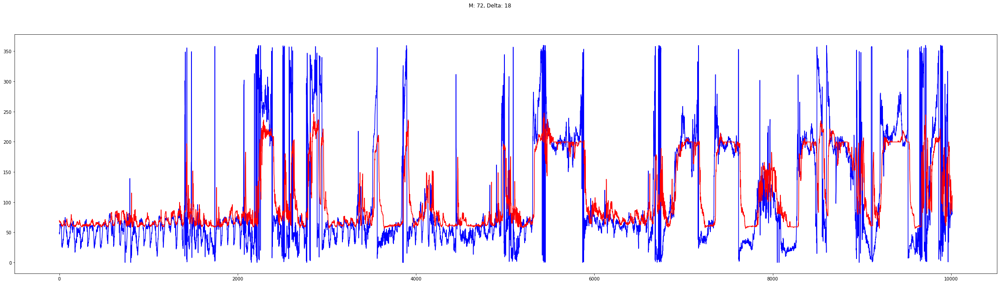

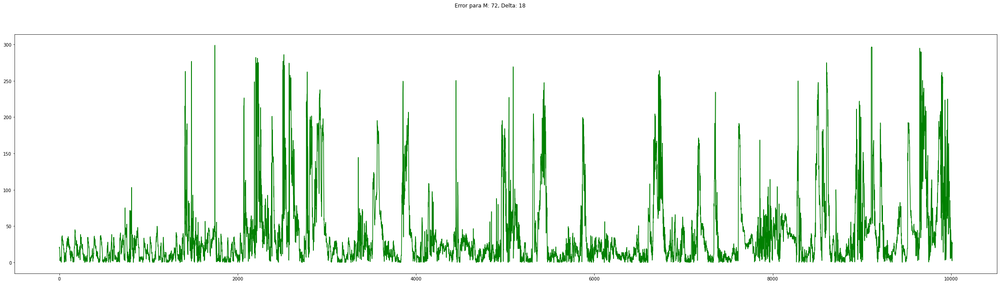

[0]	train-rmse:1.12147	eval-rmse:1.24639
[1]	train-rmse:1.12147	eval-rmse:1.24639
[2]	train-rmse:1.12147	eval-rmse:1.24639
[3]	train-rmse:1.12147	eval-rmse:1.24639
[4]	train-rmse:1.12147	eval-rmse:1.24639
[0]	train-rmse:1.09956	eval-rmse:1.21132
[1]	train-rmse:1.08150	eval-rmse:1.18072
[2]	train-rmse:1.06663	eval-rmse:1.15402
[3]	train-rmse:1.05444	eval-rmse:1.13073
[4]	train-rmse:1.04446	eval-rmse:1.11040
[5]	train-rmse:1.03631	eval-rmse:1.09263
[6]	train-rmse:1.02966	eval-rmse:1.07711
[7]	train-rmse:1.02424	eval-rmse:1.06352
[8]	train-rmse:1.01983	eval-rmse:1.05162
[9]	train-rmse:1.01624	eval-rmse:1.04118
[10]	train-rmse:1.01332	eval-rmse:1.03201
[11]	train-rmse:1.01096	eval-rmse:1.02395
[12]	train-rmse:1.00904	eval-rmse:1.01685
[13]	train-rmse:1.00748	eval-rmse:1.01060
[14]	train-rmse:1.00621	eval-rmse:1.00507
[15]	train-rmse:1.00519	eval-rmse:1.00019
[16]	train-rmse:1.00435	eval-rmse:0.99587
[17]	train-rmse:1.00368	eval-rmse:0.99204
[18]	train-rmse:1.00313	eval-rmse:0.98864
[19]	tr

[19]	train-rmse:1.00080	eval-rmse:0.96037
[20]	train-rmse:1.00080	eval-rmse:0.96033
[21]	train-rmse:1.00080	eval-rmse:0.96030
[22]	train-rmse:1.00080	eval-rmse:0.96027
[23]	train-rmse:1.00080	eval-rmse:0.96026
[24]	train-rmse:1.00080	eval-rmse:0.96025
[25]	train-rmse:1.00080	eval-rmse:0.96024
[26]	train-rmse:1.00080	eval-rmse:0.96023
[27]	train-rmse:1.00080	eval-rmse:0.96023
[28]	train-rmse:1.00080	eval-rmse:0.96023
[29]	train-rmse:1.00080	eval-rmse:0.96022
[30]	train-rmse:1.00080	eval-rmse:0.96022
[31]	train-rmse:1.00080	eval-rmse:0.96022
[32]	train-rmse:1.00080	eval-rmse:0.96022
[33]	train-rmse:1.00080	eval-rmse:0.96022
[34]	train-rmse:1.00080	eval-rmse:0.96022
[35]	train-rmse:1.00080	eval-rmse:0.96022
[36]	train-rmse:1.00080	eval-rmse:0.96022
[37]	train-rmse:1.00080	eval-rmse:0.96022
[38]	train-rmse:1.00080	eval-rmse:0.96022
[0]	train-rmse:1.04585	eval-rmse:1.11331
[1]	train-rmse:1.01725	eval-rmse:1.04420
[2]	train-rmse:1.00676	eval-rmse:1.00750
[3]	train-rmse:1.00295	eval-rmse:0.98

[54]	train-rmse:0.82681	eval-rmse:0.73521
[55]	train-rmse:0.82664	eval-rmse:0.73527
[56]	train-rmse:0.82648	eval-rmse:0.73512
[57]	train-rmse:0.82632	eval-rmse:0.73481
[58]	train-rmse:0.82617	eval-rmse:0.73477
[59]	train-rmse:0.82602	eval-rmse:0.73484
[60]	train-rmse:0.82588	eval-rmse:0.73456
[61]	train-rmse:0.82573	eval-rmse:0.73441
[62]	train-rmse:0.82559	eval-rmse:0.73433
[63]	train-rmse:0.82546	eval-rmse:0.73412
[64]	train-rmse:0.82532	eval-rmse:0.73430
[65]	train-rmse:0.82518	eval-rmse:0.73395
[66]	train-rmse:0.82505	eval-rmse:0.73403
[67]	train-rmse:0.82492	eval-rmse:0.73393
[68]	train-rmse:0.82480	eval-rmse:0.73407
[69]	train-rmse:0.82467	eval-rmse:0.73385
[70]	train-rmse:0.82455	eval-rmse:0.73378
[71]	train-rmse:0.82443	eval-rmse:0.73396
[72]	train-rmse:0.82431	eval-rmse:0.73364
[73]	train-rmse:0.82419	eval-rmse:0.73376
[74]	train-rmse:0.82408	eval-rmse:0.73384
[75]	train-rmse:0.82397	eval-rmse:0.73367
[76]	train-rmse:0.82386	eval-rmse:0.73350
[77]	train-rmse:0.82375	eval-rmse:

[5]	train-rmse:0.83712	eval-rmse:0.74549
[6]	train-rmse:0.83545	eval-rmse:0.74670
[7]	train-rmse:0.83349	eval-rmse:0.74357
[8]	train-rmse:0.83247	eval-rmse:0.74359
[9]	train-rmse:0.83135	eval-rmse:0.74588
[10]	train-rmse:0.83037	eval-rmse:0.74372
[11]	train-rmse:0.82939	eval-rmse:0.74215
[12]	train-rmse:0.82861	eval-rmse:0.74231
[13]	train-rmse:0.82790	eval-rmse:0.74270
[14]	train-rmse:0.82716	eval-rmse:0.74376
[15]	train-rmse:0.82639	eval-rmse:0.74258
[0]	train-rmse:1.12147	eval-rmse:1.24639
[1]	train-rmse:1.12147	eval-rmse:1.24639
[2]	train-rmse:1.12147	eval-rmse:1.24639
[3]	train-rmse:1.12147	eval-rmse:1.24639
[4]	train-rmse:1.12147	eval-rmse:1.24639
[0]	train-rmse:1.07408	eval-rmse:1.17417
[1]	train-rmse:1.03402	eval-rmse:1.11160
[2]	train-rmse:1.00011	eval-rmse:1.05744
[3]	train-rmse:0.97160	eval-rmse:1.01100
[4]	train-rmse:0.94748	eval-rmse:0.97097
[5]	train-rmse:0.92733	eval-rmse:0.93639
[6]	train-rmse:0.91052	eval-rmse:0.90670
[7]	train-rmse:0.89640	eval-rmse:0.88173
[8]	train-

[8]	train-rmse:0.75487	eval-rmse:0.79268
[0]	train-rmse:0.85346	eval-rmse:0.83126
[1]	train-rmse:0.80905	eval-rmse:0.77612
[2]	train-rmse:0.79361	eval-rmse:0.77023
[3]	train-rmse:0.78518	eval-rmse:0.77572
[4]	train-rmse:0.77547	eval-rmse:0.78107
[5]	train-rmse:0.76921	eval-rmse:0.78098
[6]	train-rmse:0.76269	eval-rmse:0.78584
[0]	train-rmse:0.83622	eval-rmse:0.79962
[1]	train-rmse:0.80426	eval-rmse:0.77888
[2]	train-rmse:0.79093	eval-rmse:0.78526
[3]	train-rmse:0.78094	eval-rmse:0.79016
[4]	train-rmse:0.77319	eval-rmse:0.79411
[5]	train-rmse:0.76643	eval-rmse:0.80020
[0]	train-rmse:0.82567	eval-rmse:0.77827
[1]	train-rmse:0.80300	eval-rmse:0.78133
[2]	train-rmse:0.79425	eval-rmse:0.78011
[3]	train-rmse:0.78626	eval-rmse:0.78823
[4]	train-rmse:0.78182	eval-rmse:0.78962
[0]	train-rmse:1.12147	eval-rmse:1.24639
[1]	train-rmse:1.12147	eval-rmse:1.24639
[2]	train-rmse:1.12147	eval-rmse:1.24639
[3]	train-rmse:1.12147	eval-rmse:1.24639
[4]	train-rmse:1.12147	eval-rmse:1.24639
[0]	train-rmse:1

[0]	train-rmse:0.91943	eval-rmse:0.98286
[1]	train-rmse:0.82252	eval-rmse:0.86028
[2]	train-rmse:0.76651	eval-rmse:0.80880
[3]	train-rmse:0.73506	eval-rmse:0.79306
[4]	train-rmse:0.71386	eval-rmse:0.78918
[5]	train-rmse:0.69667	eval-rmse:0.78922
[6]	train-rmse:0.68059	eval-rmse:0.79535
[7]	train-rmse:0.66594	eval-rmse:0.79839
[8]	train-rmse:0.65581	eval-rmse:0.80199
[0]	train-rmse:0.87995	eval-rmse:0.93043
[1]	train-rmse:0.78729	eval-rmse:0.82569
[2]	train-rmse:0.74322	eval-rmse:0.79800
[3]	train-rmse:0.71294	eval-rmse:0.79468
[4]	train-rmse:0.69081	eval-rmse:0.79515
[5]	train-rmse:0.67600	eval-rmse:0.80200
[6]	train-rmse:0.66601	eval-rmse:0.80150
[7]	train-rmse:0.65805	eval-rmse:0.80255
[0]	train-rmse:0.84623	eval-rmse:0.88545
[1]	train-rmse:0.76436	eval-rmse:0.80781
[2]	train-rmse:0.72528	eval-rmse:0.80436
[3]	train-rmse:0.71012	eval-rmse:0.80577
[4]	train-rmse:0.68635	eval-rmse:0.82600
[5]	train-rmse:0.68221	eval-rmse:0.82867
[6]	train-rmse:0.66783	eval-rmse:0.83105
[0]	train-rmse:0

[10]	train-rmse:0.55896	eval-rmse:0.79108
[11]	train-rmse:0.54475	eval-rmse:0.79018
[12]	train-rmse:0.53245	eval-rmse:0.79092
[13]	train-rmse:0.52625	eval-rmse:0.79108
[14]	train-rmse:0.51477	eval-rmse:0.79112
[15]	train-rmse:0.50937	eval-rmse:0.79104
[0]	train-rmse:0.93793	eval-rmse:1.04641
[1]	train-rmse:0.81695	eval-rmse:0.92193
[2]	train-rmse:0.73987	eval-rmse:0.85845
[3]	train-rmse:0.68702	eval-rmse:0.82537
[4]	train-rmse:0.64197	eval-rmse:0.80695
[5]	train-rmse:0.60267	eval-rmse:0.80110
[6]	train-rmse:0.57998	eval-rmse:0.79892
[7]	train-rmse:0.55388	eval-rmse:0.80187
[8]	train-rmse:0.52527	eval-rmse:0.80675
[9]	train-rmse:0.51137	eval-rmse:0.80967
[10]	train-rmse:0.49965	eval-rmse:0.80906
[0]	train-rmse:0.88485	eval-rmse:0.99110
[1]	train-rmse:0.75770	eval-rmse:0.87905
[2]	train-rmse:0.68443	eval-rmse:0.83178
[3]	train-rmse:0.63608	eval-rmse:0.82160
[4]	train-rmse:0.59268	eval-rmse:0.81790
[5]	train-rmse:0.56180	eval-rmse:0.82222
[6]	train-rmse:0.54388	eval-rmse:0.82544
[7]	train

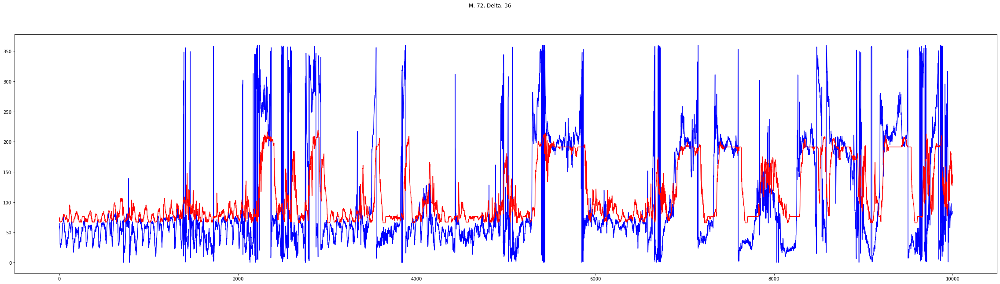

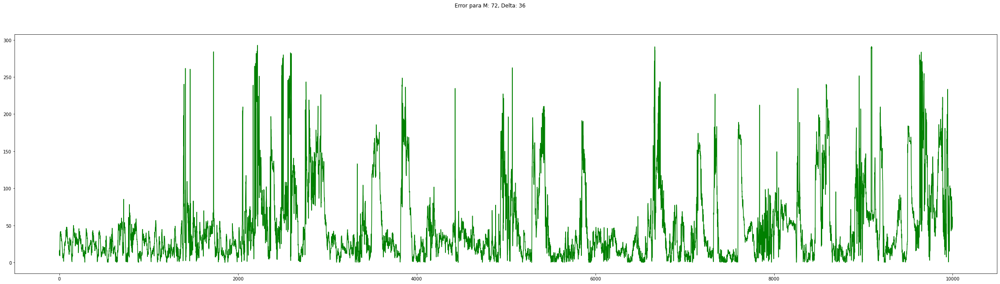

[0]	train-rmse:1.12279	eval-rmse:1.24529
[1]	train-rmse:1.12279	eval-rmse:1.24529
[2]	train-rmse:1.12279	eval-rmse:1.24529
[3]	train-rmse:1.12279	eval-rmse:1.24529
[4]	train-rmse:1.12279	eval-rmse:1.24529
[5]	train-rmse:1.12279	eval-rmse:1.24529
[0]	train-rmse:1.10078	eval-rmse:1.21018
[1]	train-rmse:1.08262	eval-rmse:1.17956
[2]	train-rmse:1.06768	eval-rmse:1.15285
[3]	train-rmse:1.05543	eval-rmse:1.12955
[4]	train-rmse:1.04540	eval-rmse:1.10922
[5]	train-rmse:1.03721	eval-rmse:1.09147
[6]	train-rmse:1.03052	eval-rmse:1.07595
[7]	train-rmse:1.02507	eval-rmse:1.06238
[8]	train-rmse:1.02064	eval-rmse:1.05050
[9]	train-rmse:1.01703	eval-rmse:1.04008
[10]	train-rmse:1.01410	eval-rmse:1.03093
[11]	train-rmse:1.01172	eval-rmse:1.02289
[12]	train-rmse:1.00979	eval-rmse:1.01581
[13]	train-rmse:1.00822	eval-rmse:1.00957
[14]	train-rmse:1.00695	eval-rmse:1.00407
[15]	train-rmse:1.00592	eval-rmse:0.99920
[16]	train-rmse:1.00509	eval-rmse:0.99490
[17]	train-rmse:1.00441	eval-rmse:0.99108
[18]	tra

[19]	train-rmse:1.00151	eval-rmse:0.95959
[20]	train-rmse:1.00151	eval-rmse:0.95954
[21]	train-rmse:1.00151	eval-rmse:0.95951
[22]	train-rmse:1.00151	eval-rmse:0.95948
[23]	train-rmse:1.00151	eval-rmse:0.95947
[24]	train-rmse:1.00151	eval-rmse:0.95946
[25]	train-rmse:1.00151	eval-rmse:0.95945
[26]	train-rmse:1.00151	eval-rmse:0.95944
[27]	train-rmse:1.00151	eval-rmse:0.95944
[28]	train-rmse:1.00151	eval-rmse:0.95944
[29]	train-rmse:1.00151	eval-rmse:0.95943
[30]	train-rmse:1.00151	eval-rmse:0.95943
[31]	train-rmse:1.00151	eval-rmse:0.95943
[32]	train-rmse:1.00151	eval-rmse:0.95943
[33]	train-rmse:1.00151	eval-rmse:0.95943
[34]	train-rmse:1.00151	eval-rmse:0.95943
[35]	train-rmse:1.00151	eval-rmse:0.95943
[36]	train-rmse:1.00151	eval-rmse:0.95943
[37]	train-rmse:1.00151	eval-rmse:0.95943
[38]	train-rmse:1.00151	eval-rmse:0.95943
[0]	train-rmse:1.04680	eval-rmse:1.11213
[1]	train-rmse:1.01805	eval-rmse:1.04310
[2]	train-rmse:1.00750	eval-rmse:1.00649
[3]	train-rmse:1.00367	eval-rmse:0.98

[24]	train-rmse:0.89767	eval-rmse:0.80632
[25]	train-rmse:0.89739	eval-rmse:0.80619
[26]	train-rmse:0.89706	eval-rmse:0.80690
[27]	train-rmse:0.89679	eval-rmse:0.80679
[0]	train-rmse:0.95699	eval-rmse:0.94482
[1]	train-rmse:0.92007	eval-rmse:0.85574
[2]	train-rmse:0.91123	eval-rmse:0.82897
[3]	train-rmse:0.90871	eval-rmse:0.81967
[4]	train-rmse:0.90751	eval-rmse:0.81604
[5]	train-rmse:0.90651	eval-rmse:0.81469
[6]	train-rmse:0.90580	eval-rmse:0.81344
[7]	train-rmse:0.90511	eval-rmse:0.81221
[8]	train-rmse:0.90432	eval-rmse:0.81122
[9]	train-rmse:0.90373	eval-rmse:0.80877
[10]	train-rmse:0.90303	eval-rmse:0.81027
[11]	train-rmse:0.90246	eval-rmse:0.80995
[12]	train-rmse:0.90202	eval-rmse:0.80917
[13]	train-rmse:0.90149	eval-rmse:0.80848
[14]	train-rmse:0.90103	eval-rmse:0.80790
[15]	train-rmse:0.90059	eval-rmse:0.80777
[16]	train-rmse:0.90017	eval-rmse:0.80909
[17]	train-rmse:0.89972	eval-rmse:0.80853
[18]	train-rmse:0.89929	eval-rmse:0.80766
[19]	train-rmse:0.89892	eval-rmse:0.80796
[2

[13]	train-rmse:0.86728	eval-rmse:0.81254
[14]	train-rmse:0.86452	eval-rmse:0.81244
[15]	train-rmse:0.86262	eval-rmse:0.81245
[0]	train-rmse:0.98733	eval-rmse:1.01586
[1]	train-rmse:0.93024	eval-rmse:0.90631
[2]	train-rmse:0.90582	eval-rmse:0.85798
[3]	train-rmse:0.89386	eval-rmse:0.83464
[4]	train-rmse:0.88731	eval-rmse:0.82414
[5]	train-rmse:0.88206	eval-rmse:0.81730
[6]	train-rmse:0.87890	eval-rmse:0.81510
[7]	train-rmse:0.87605	eval-rmse:0.81509
[8]	train-rmse:0.87337	eval-rmse:0.81564
[9]	train-rmse:0.87109	eval-rmse:0.81652
[10]	train-rmse:0.86741	eval-rmse:0.81586
[11]	train-rmse:0.86564	eval-rmse:0.81617
[0]	train-rmse:0.96212	eval-rmse:0.96818
[1]	train-rmse:0.91221	eval-rmse:0.86968
[2]	train-rmse:0.89476	eval-rmse:0.83779
[3]	train-rmse:0.88654	eval-rmse:0.82503
[4]	train-rmse:0.88144	eval-rmse:0.81827
[5]	train-rmse:0.87841	eval-rmse:0.81680
[6]	train-rmse:0.87412	eval-rmse:0.81538
[7]	train-rmse:0.87087	eval-rmse:0.81627
[8]	train-rmse:0.86607	eval-rmse:0.81815
[9]	train-r

[5]	train-rmse:0.80939	eval-rmse:0.84289
[6]	train-rmse:0.79905	eval-rmse:0.83766
[7]	train-rmse:0.78504	eval-rmse:0.83674
[8]	train-rmse:0.77652	eval-rmse:0.83826
[9]	train-rmse:0.77076	eval-rmse:0.83763
[10]	train-rmse:0.75981	eval-rmse:0.83880
[11]	train-rmse:0.74914	eval-rmse:0.84505
[0]	train-rmse:0.96298	eval-rmse:1.01702
[1]	train-rmse:0.88367	eval-rmse:0.90967
[2]	train-rmse:0.84089	eval-rmse:0.86791
[3]	train-rmse:0.80960	eval-rmse:0.84828
[4]	train-rmse:0.79338	eval-rmse:0.84430
[5]	train-rmse:0.78260	eval-rmse:0.84131
[6]	train-rmse:0.76377	eval-rmse:0.84328
[7]	train-rmse:0.75033	eval-rmse:0.84839
[8]	train-rmse:0.74782	eval-rmse:0.84866
[9]	train-rmse:0.73966	eval-rmse:0.85248
[0]	train-rmse:0.93268	eval-rmse:0.97172
[1]	train-rmse:0.86069	eval-rmse:0.87869
[2]	train-rmse:0.82216	eval-rmse:0.85316
[3]	train-rmse:0.79853	eval-rmse:0.84522
[4]	train-rmse:0.77151	eval-rmse:0.85147
[5]	train-rmse:0.76168	eval-rmse:0.85359
[6]	train-rmse:0.74020	eval-rmse:0.85486
[7]	train-rmse

[0]	train-rmse:1.01870	eval-rmse:1.12300
[1]	train-rmse:0.93935	eval-rmse:1.03744
[2]	train-rmse:0.87818	eval-rmse:0.97618
[3]	train-rmse:0.83542	eval-rmse:0.93433
[4]	train-rmse:0.79385	eval-rmse:0.90697
[5]	train-rmse:0.76466	eval-rmse:0.88788
[6]	train-rmse:0.74064	eval-rmse:0.87573
[7]	train-rmse:0.71644	eval-rmse:0.86763
[8]	train-rmse:0.69913	eval-rmse:0.86197
[9]	train-rmse:0.67692	eval-rmse:0.85954
[10]	train-rmse:0.66065	eval-rmse:0.85848
[11]	train-rmse:0.64437	eval-rmse:0.85739
[12]	train-rmse:0.63378	eval-rmse:0.85746
[13]	train-rmse:0.61966	eval-rmse:0.85918
[14]	train-rmse:0.60412	eval-rmse:0.86044
[15]	train-rmse:0.58998	eval-rmse:0.86035
[16]	train-rmse:0.57738	eval-rmse:0.86122
[0]	train-rmse:0.97190	eval-rmse:1.06870
[1]	train-rmse:0.87547	eval-rmse:0.96679
[2]	train-rmse:0.81212	eval-rmse:0.91137
[3]	train-rmse:0.75257	eval-rmse:0.88911
[4]	train-rmse:0.71752	eval-rmse:0.87290
[5]	train-rmse:0.68082	eval-rmse:0.87019
[6]	train-rmse:0.66036	eval-rmse:0.86652
[7]	train

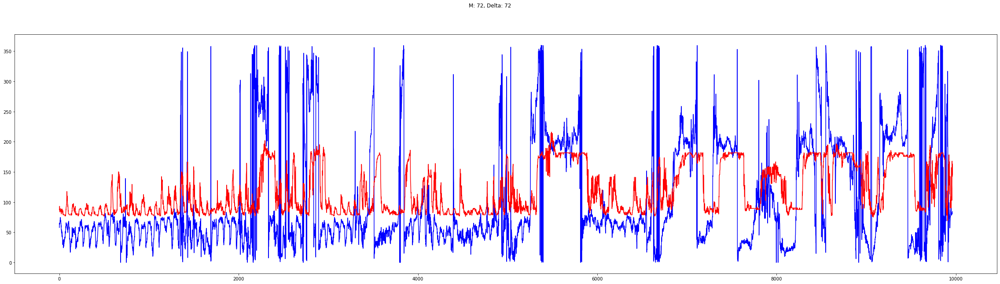

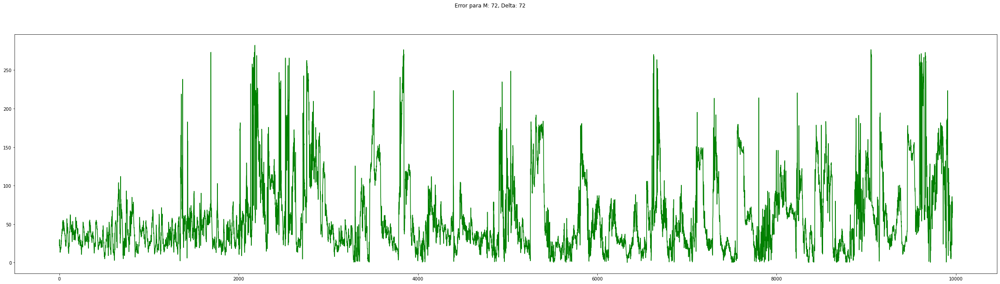

[0]	train-rmse:1.12546	eval-rmse:1.24369
[1]	train-rmse:1.12546	eval-rmse:1.24369
[2]	train-rmse:1.12546	eval-rmse:1.24369
[3]	train-rmse:1.12546	eval-rmse:1.24369
[4]	train-rmse:1.12546	eval-rmse:1.24369
[0]	train-rmse:1.10325	eval-rmse:1.20852
[1]	train-rmse:1.08492	eval-rmse:1.17786
[2]	train-rmse:1.06985	eval-rmse:1.15114
[3]	train-rmse:1.05748	eval-rmse:1.12784
[4]	train-rmse:1.04736	eval-rmse:1.10752
[5]	train-rmse:1.03908	eval-rmse:1.08979
[6]	train-rmse:1.03233	eval-rmse:1.07430
[7]	train-rmse:1.02683	eval-rmse:1.06077
[8]	train-rmse:1.02235	eval-rmse:1.04892
[9]	train-rmse:1.01871	eval-rmse:1.03854
[10]	train-rmse:1.01575	eval-rmse:1.02943
[11]	train-rmse:1.01335	eval-rmse:1.02143
[12]	train-rmse:1.01140	eval-rmse:1.01439
[13]	train-rmse:1.00982	eval-rmse:1.00820
[14]	train-rmse:1.00853	eval-rmse:1.00273
[15]	train-rmse:1.00749	eval-rmse:0.99790
[16]	train-rmse:1.00665	eval-rmse:0.99362
[17]	train-rmse:1.00596	eval-rmse:0.98984
[18]	train-rmse:1.00541	eval-rmse:0.98648
[19]	tr

[12]	train-rmse:1.00305	eval-rmse:0.96038
[13]	train-rmse:1.00305	eval-rmse:0.95982
[14]	train-rmse:1.00304	eval-rmse:0.95943
[15]	train-rmse:1.00304	eval-rmse:0.95915
[16]	train-rmse:1.00304	eval-rmse:0.95896
[17]	train-rmse:1.00304	eval-rmse:0.95883
[18]	train-rmse:1.00304	eval-rmse:0.95873
[19]	train-rmse:1.00304	eval-rmse:0.95867
[20]	train-rmse:1.00304	eval-rmse:0.95862
[21]	train-rmse:1.00304	eval-rmse:0.95859
[22]	train-rmse:1.00304	eval-rmse:0.95857
[23]	train-rmse:1.00304	eval-rmse:0.95855
[24]	train-rmse:1.00304	eval-rmse:0.95854
[25]	train-rmse:1.00304	eval-rmse:0.95853
[26]	train-rmse:1.00304	eval-rmse:0.95853
[27]	train-rmse:1.00304	eval-rmse:0.95852
[28]	train-rmse:1.00304	eval-rmse:0.95852
[29]	train-rmse:1.00304	eval-rmse:0.95852
[30]	train-rmse:1.00304	eval-rmse:0.95852
[31]	train-rmse:1.00304	eval-rmse:0.95852
[32]	train-rmse:1.00304	eval-rmse:0.95852
[33]	train-rmse:1.00304	eval-rmse:0.95851
[34]	train-rmse:1.00304	eval-rmse:0.95851
[35]	train-rmse:1.00304	eval-rmse:

[52]	train-rmse:0.56544	eval-rmse:0.47476
[53]	train-rmse:0.56499	eval-rmse:0.47421
[54]	train-rmse:0.56458	eval-rmse:0.47414
[55]	train-rmse:0.56417	eval-rmse:0.47336
[56]	train-rmse:0.56378	eval-rmse:0.47314
[57]	train-rmse:0.56339	eval-rmse:0.47300
[58]	train-rmse:0.56300	eval-rmse:0.47279
[59]	train-rmse:0.56264	eval-rmse:0.47238
[60]	train-rmse:0.56230	eval-rmse:0.47171
[61]	train-rmse:0.56195	eval-rmse:0.47153
[62]	train-rmse:0.56162	eval-rmse:0.47150
[63]	train-rmse:0.56129	eval-rmse:0.47130
[64]	train-rmse:0.56098	eval-rmse:0.47127
[65]	train-rmse:0.56067	eval-rmse:0.47072
[66]	train-rmse:0.56038	eval-rmse:0.47058
[67]	train-rmse:0.56009	eval-rmse:0.47054
[68]	train-rmse:0.55980	eval-rmse:0.47020
[69]	train-rmse:0.55952	eval-rmse:0.46988
[70]	train-rmse:0.55925	eval-rmse:0.46987
[71]	train-rmse:0.55899	eval-rmse:0.46975
[72]	train-rmse:0.55873	eval-rmse:0.46921
[73]	train-rmse:0.55847	eval-rmse:0.46923
[74]	train-rmse:0.55823	eval-rmse:0.46908
[75]	train-rmse:0.55801	eval-rmse:

[4]	train-rmse:0.58727	eval-rmse:0.48928
[5]	train-rmse:0.58378	eval-rmse:0.48806
[6]	train-rmse:0.58032	eval-rmse:0.48153
[7]	train-rmse:0.57704	eval-rmse:0.47973
[8]	train-rmse:0.57353	eval-rmse:0.47912
[9]	train-rmse:0.57130	eval-rmse:0.47928
[10]	train-rmse:0.57012	eval-rmse:0.47991
[11]	train-rmse:0.56893	eval-rmse:0.47709
[12]	train-rmse:0.56786	eval-rmse:0.47680
[13]	train-rmse:0.56665	eval-rmse:0.47640
[14]	train-rmse:0.56575	eval-rmse:0.47777
[15]	train-rmse:0.56507	eval-rmse:0.47690
[16]	train-rmse:0.56421	eval-rmse:0.47683
[17]	train-rmse:0.56351	eval-rmse:0.47723
[18]	train-rmse:0.56285	eval-rmse:0.47694
[0]	train-rmse:0.69429	eval-rmse:0.64782
[1]	train-rmse:0.61941	eval-rmse:0.53862
[2]	train-rmse:0.59950	eval-rmse:0.50162
[3]	train-rmse:0.59034	eval-rmse:0.49168
[4]	train-rmse:0.58692	eval-rmse:0.49141
[5]	train-rmse:0.58376	eval-rmse:0.49086
[6]	train-rmse:0.58028	eval-rmse:0.48427
[7]	train-rmse:0.57686	eval-rmse:0.48258
[8]	train-rmse:0.57439	eval-rmse:0.48260
[9]	tra

[6]	train-rmse:0.55663	eval-rmse:0.47049
[7]	train-rmse:0.55387	eval-rmse:0.46920
[8]	train-rmse:0.55153	eval-rmse:0.47005
[9]	train-rmse:0.54887	eval-rmse:0.47056
[10]	train-rmse:0.54761	eval-rmse:0.47152
[11]	train-rmse:0.54564	eval-rmse:0.47163
[12]	train-rmse:0.54361	eval-rmse:0.47233
[0]	train-rmse:0.70695	eval-rmse:0.68619
[1]	train-rmse:0.60458	eval-rmse:0.52628
[2]	train-rmse:0.57864	eval-rmse:0.49045
[3]	train-rmse:0.56729	eval-rmse:0.47832
[4]	train-rmse:0.56144	eval-rmse:0.47731
[5]	train-rmse:0.55792	eval-rmse:0.47266
[6]	train-rmse:0.55487	eval-rmse:0.47381
[7]	train-rmse:0.55270	eval-rmse:0.47693
[8]	train-rmse:0.55077	eval-rmse:0.47919
[9]	train-rmse:0.54717	eval-rmse:0.47996
[0]	train-rmse:0.66019	eval-rmse:0.61428
[1]	train-rmse:0.58731	eval-rmse:0.49749
[2]	train-rmse:0.57086	eval-rmse:0.47793
[3]	train-rmse:0.56362	eval-rmse:0.47229
[4]	train-rmse:0.55813	eval-rmse:0.47333
[5]	train-rmse:0.55588	eval-rmse:0.47425
[6]	train-rmse:0.55222	eval-rmse:0.47350
[7]	train-rms

[4]	train-rmse:1.12546	eval-rmse:1.24369
[0]	train-rmse:1.04221	eval-rmse:1.14013
[1]	train-rmse:0.96911	eval-rmse:1.04823
[2]	train-rmse:0.90518	eval-rmse:0.96757
[3]	train-rmse:0.84972	eval-rmse:0.89662
[4]	train-rmse:0.80120	eval-rmse:0.83429
[5]	train-rmse:0.75960	eval-rmse:0.77981
[6]	train-rmse:0.72340	eval-rmse:0.73281
[7]	train-rmse:0.69243	eval-rmse:0.69148
[8]	train-rmse:0.66620	eval-rmse:0.65606
[9]	train-rmse:0.64367	eval-rmse:0.62640
[10]	train-rmse:0.62413	eval-rmse:0.60094
[11]	train-rmse:0.60755	eval-rmse:0.57912
[12]	train-rmse:0.59288	eval-rmse:0.56101
[13]	train-rmse:0.58099	eval-rmse:0.54510
[14]	train-rmse:0.57051	eval-rmse:0.53218
[15]	train-rmse:0.56162	eval-rmse:0.52161
[16]	train-rmse:0.55417	eval-rmse:0.51225
[17]	train-rmse:0.54770	eval-rmse:0.50477
[18]	train-rmse:0.54172	eval-rmse:0.49801
[19]	train-rmse:0.53687	eval-rmse:0.49291
[20]	train-rmse:0.53168	eval-rmse:0.48913
[21]	train-rmse:0.52746	eval-rmse:0.48574
[22]	train-rmse:0.52387	eval-rmse:0.48324
[23

[16]	train-rmse:0.45886	eval-rmse:0.47582
[17]	train-rmse:0.45270	eval-rmse:0.47546
[18]	train-rmse:0.44732	eval-rmse:0.47383
[19]	train-rmse:0.44373	eval-rmse:0.47554
[20]	train-rmse:0.44028	eval-rmse:0.47481
[21]	train-rmse:0.43871	eval-rmse:0.47471
[22]	train-rmse:0.43701	eval-rmse:0.47469
[23]	train-rmse:0.43569	eval-rmse:0.47490
[0]	train-rmse:0.87853	eval-rmse:0.93682
[1]	train-rmse:0.72044	eval-rmse:0.73825
[2]	train-rmse:0.62457	eval-rmse:0.61832
[3]	train-rmse:0.56689	eval-rmse:0.54929
[4]	train-rmse:0.53057	eval-rmse:0.51199
[5]	train-rmse:0.50633	eval-rmse:0.49094
[6]	train-rmse:0.49060	eval-rmse:0.48102
[7]	train-rmse:0.47968	eval-rmse:0.47696
[8]	train-rmse:0.47493	eval-rmse:0.47501
[9]	train-rmse:0.46839	eval-rmse:0.47392
[10]	train-rmse:0.46129	eval-rmse:0.47353
[11]	train-rmse:0.45482	eval-rmse:0.47523
[12]	train-rmse:0.44865	eval-rmse:0.47551
[13]	train-rmse:0.44583	eval-rmse:0.47538
[14]	train-rmse:0.44243	eval-rmse:0.47602
[0]	train-rmse:0.80351	eval-rmse:0.84066
[1]

[1]	train-rmse:1.12546	eval-rmse:1.24369
[2]	train-rmse:1.12546	eval-rmse:1.24369
[3]	train-rmse:1.12546	eval-rmse:1.24369
[4]	train-rmse:1.12546	eval-rmse:1.24369
[0]	train-rmse:1.03509	eval-rmse:1.13871
[1]	train-rmse:0.95495	eval-rmse:1.04607
[2]	train-rmse:0.88393	eval-rmse:0.96455
[3]	train-rmse:0.82143	eval-rmse:0.89279
[4]	train-rmse:0.76518	eval-rmse:0.83042
[5]	train-rmse:0.71552	eval-rmse:0.77596
[6]	train-rmse:0.67272	eval-rmse:0.72889
[7]	train-rmse:0.63458	eval-rmse:0.68818
[8]	train-rmse:0.60071	eval-rmse:0.65336
[9]	train-rmse:0.57120	eval-rmse:0.62414
[10]	train-rmse:0.54628	eval-rmse:0.59901
[11]	train-rmse:0.52406	eval-rmse:0.57912
[12]	train-rmse:0.50483	eval-rmse:0.56230
[13]	train-rmse:0.48850	eval-rmse:0.54648
[14]	train-rmse:0.47333	eval-rmse:0.53398
[15]	train-rmse:0.46023	eval-rmse:0.52381
[16]	train-rmse:0.44815	eval-rmse:0.51497
[17]	train-rmse:0.43882	eval-rmse:0.50711
[18]	train-rmse:0.42928	eval-rmse:0.50103
[19]	train-rmse:0.41914	eval-rmse:0.49633
[20]	t

[4]	train-rmse:0.41844	eval-rmse:0.51843
[5]	train-rmse:0.38685	eval-rmse:0.50025
[6]	train-rmse:0.36251	eval-rmse:0.49054
[7]	train-rmse:0.33912	eval-rmse:0.48654
[8]	train-rmse:0.32630	eval-rmse:0.48534
[9]	train-rmse:0.31421	eval-rmse:0.48348
[10]	train-rmse:0.30249	eval-rmse:0.48340
[11]	train-rmse:0.29195	eval-rmse:0.48393
[12]	train-rmse:0.27986	eval-rmse:0.48581
[13]	train-rmse:0.27359	eval-rmse:0.48624
[14]	train-rmse:0.26595	eval-rmse:0.48716
[0]	train-rmse:0.76546	eval-rmse:0.84268
[1]	train-rmse:0.56448	eval-rmse:0.63998
[2]	train-rmse:0.46190	eval-rmse:0.54837
[3]	train-rmse:0.40319	eval-rmse:0.51216
[4]	train-rmse:0.36325	eval-rmse:0.49984
[5]	train-rmse:0.34163	eval-rmse:0.49660
[6]	train-rmse:0.32312	eval-rmse:0.49598
[7]	train-rmse:0.30727	eval-rmse:0.49498
[8]	train-rmse:0.28903	eval-rmse:0.49616
[9]	train-rmse:0.27050	eval-rmse:0.49758
[10]	train-rmse:0.26306	eval-rmse:0.49779
[11]	train-rmse:0.25984	eval-rmse:0.49874
[12]	train-rmse:0.24983	eval-rmse:0.49899
[0]	trai

[5]	train-rmse:0.30075	eval-rmse:0.55800
Best Max. Depth:  2 , Best ETA:  0.1 ,Best RMSE:  0.465332
M:  216 , Delta:  3
RMSE:  44.64334212593481 , MAE:  20.65446262630241 , R2:  0.7256282927746152


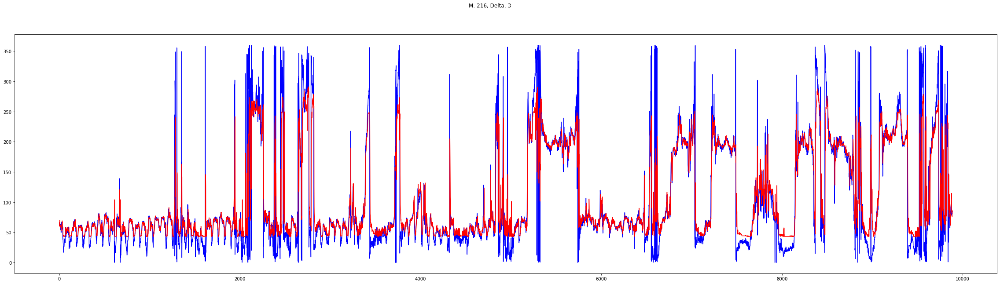

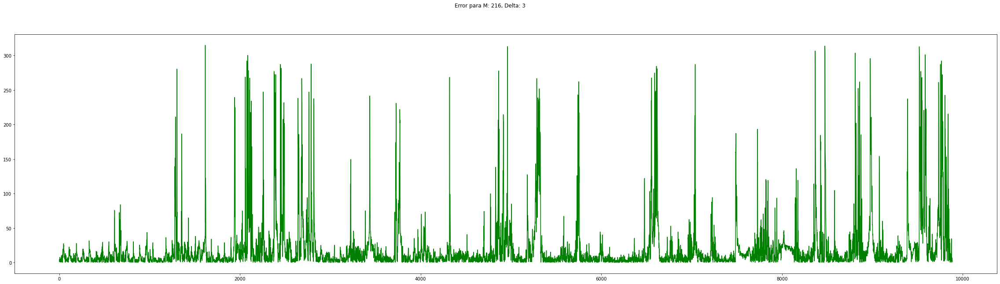

[0]	train-rmse:1.12602	eval-rmse:1.24362
[1]	train-rmse:1.12602	eval-rmse:1.24362
[2]	train-rmse:1.12602	eval-rmse:1.24362
[3]	train-rmse:1.12602	eval-rmse:1.24362
[4]	train-rmse:1.12602	eval-rmse:1.24362
[5]	train-rmse:1.12602	eval-rmse:1.24362
[0]	train-rmse:1.10376	eval-rmse:1.20843
[1]	train-rmse:1.08540	eval-rmse:1.17775
[2]	train-rmse:1.07029	eval-rmse:1.15102
[3]	train-rmse:1.05790	eval-rmse:1.12772
[4]	train-rmse:1.04775	eval-rmse:1.10740
[5]	train-rmse:1.03946	eval-rmse:1.08967
[6]	train-rmse:1.03270	eval-rmse:1.07419
[7]	train-rmse:1.02718	eval-rmse:1.06065
[8]	train-rmse:1.02270	eval-rmse:1.04881
[9]	train-rmse:1.01905	eval-rmse:1.03844
[10]	train-rmse:1.01608	eval-rmse:1.02934
[11]	train-rmse:1.01367	eval-rmse:1.02134
[12]	train-rmse:1.01172	eval-rmse:1.01431
[13]	train-rmse:1.01013	eval-rmse:1.00812
[14]	train-rmse:1.00885	eval-rmse:1.00266
[15]	train-rmse:1.00780	eval-rmse:0.99783
[16]	train-rmse:1.00696	eval-rmse:0.99356
[17]	train-rmse:1.00627	eval-rmse:0.98979
[18]	tra

[14]	train-rmse:1.00334	eval-rmse:0.95943
[15]	train-rmse:1.00334	eval-rmse:0.95915
[16]	train-rmse:1.00334	eval-rmse:0.95896
[17]	train-rmse:1.00334	eval-rmse:0.95883
[18]	train-rmse:1.00334	eval-rmse:0.95874
[19]	train-rmse:1.00334	eval-rmse:0.95867
[20]	train-rmse:1.00334	eval-rmse:0.95862
[21]	train-rmse:1.00334	eval-rmse:0.95859
[22]	train-rmse:1.00334	eval-rmse:0.95857
[23]	train-rmse:1.00334	eval-rmse:0.95855
[24]	train-rmse:1.00334	eval-rmse:0.95854
[25]	train-rmse:1.00334	eval-rmse:0.95853
[26]	train-rmse:1.00334	eval-rmse:0.95853
[27]	train-rmse:1.00334	eval-rmse:0.95852
[28]	train-rmse:1.00334	eval-rmse:0.95852
[29]	train-rmse:1.00334	eval-rmse:0.95852
[30]	train-rmse:1.00334	eval-rmse:0.95852
[31]	train-rmse:1.00334	eval-rmse:0.95852
[32]	train-rmse:1.00334	eval-rmse:0.95852
[33]	train-rmse:1.00334	eval-rmse:0.95852
[34]	train-rmse:1.00334	eval-rmse:0.95852
[35]	train-rmse:1.00334	eval-rmse:0.95852
[36]	train-rmse:1.00334	eval-rmse:0.95852
[37]	train-rmse:1.00334	eval-rmse:

[0]	train-rmse:0.85662	eval-rmse:0.83694
[1]	train-rmse:0.79401	eval-rmse:0.72311
[2]	train-rmse:0.77806	eval-rmse:0.69256
[3]	train-rmse:0.77193	eval-rmse:0.68640
[4]	train-rmse:0.76726	eval-rmse:0.67901
[5]	train-rmse:0.76492	eval-rmse:0.67918
[6]	train-rmse:0.76294	eval-rmse:0.67513
[7]	train-rmse:0.76123	eval-rmse:0.67300
[8]	train-rmse:0.75962	eval-rmse:0.67309
[9]	train-rmse:0.75829	eval-rmse:0.67347
[10]	train-rmse:0.75715	eval-rmse:0.67358
[11]	train-rmse:0.75598	eval-rmse:0.67212
[12]	train-rmse:0.75493	eval-rmse:0.67201
[13]	train-rmse:0.75370	eval-rmse:0.67066
[14]	train-rmse:0.75283	eval-rmse:0.67089
[15]	train-rmse:0.75196	eval-rmse:0.67138
[16]	train-rmse:0.75097	eval-rmse:0.67199
[17]	train-rmse:0.75012	eval-rmse:0.67303
[18]	train-rmse:0.74935	eval-rmse:0.67281
[0]	train-rmse:0.83023	eval-rmse:0.78788
[1]	train-rmse:0.78553	eval-rmse:0.70418
[2]	train-rmse:0.77555	eval-rmse:0.68437
[3]	train-rmse:0.76947	eval-rmse:0.68107
[4]	train-rmse:0.76671	eval-rmse:0.68155
[5]	tra

[9]	train-rmse:0.73733	eval-rmse:0.67188
[10]	train-rmse:0.73403	eval-rmse:0.67268
[0]	train-rmse:0.84088	eval-rmse:0.81910
[1]	train-rmse:0.77808	eval-rmse:0.71022
[2]	train-rmse:0.76221	eval-rmse:0.68289
[3]	train-rmse:0.75518	eval-rmse:0.67724
[4]	train-rmse:0.75060	eval-rmse:0.67328
[5]	train-rmse:0.74731	eval-rmse:0.67505
[6]	train-rmse:0.74329	eval-rmse:0.67540
[7]	train-rmse:0.74046	eval-rmse:0.67399
[8]	train-rmse:0.73757	eval-rmse:0.67412
[9]	train-rmse:0.73469	eval-rmse:0.67476
[0]	train-rmse:0.81261	eval-rmse:0.76921
[1]	train-rmse:0.76913	eval-rmse:0.68741
[2]	train-rmse:0.75845	eval-rmse:0.67562
[3]	train-rmse:0.75409	eval-rmse:0.67319
[4]	train-rmse:0.74967	eval-rmse:0.67342
[5]	train-rmse:0.74518	eval-rmse:0.67449
[6]	train-rmse:0.74190	eval-rmse:0.67378
[7]	train-rmse:0.73838	eval-rmse:0.67424
[0]	train-rmse:0.79180	eval-rmse:0.72904
[1]	train-rmse:0.76426	eval-rmse:0.68249
[2]	train-rmse:0.75606	eval-rmse:0.67220
[3]	train-rmse:0.75116	eval-rmse:0.67420
[4]	train-rmse:

[22]	train-rmse:0.69853	eval-rmse:0.67481
[23]	train-rmse:0.69465	eval-rmse:0.67318
[24]	train-rmse:0.69154	eval-rmse:0.67108
[25]	train-rmse:0.68829	eval-rmse:0.67036
[26]	train-rmse:0.68506	eval-rmse:0.66970
[27]	train-rmse:0.68264	eval-rmse:0.66929
[28]	train-rmse:0.68002	eval-rmse:0.66865
[29]	train-rmse:0.67787	eval-rmse:0.66815
[30]	train-rmse:0.67530	eval-rmse:0.66776
[31]	train-rmse:0.67311	eval-rmse:0.66715
[32]	train-rmse:0.67069	eval-rmse:0.66745
[33]	train-rmse:0.66813	eval-rmse:0.66736
[34]	train-rmse:0.66662	eval-rmse:0.66712
[35]	train-rmse:0.66468	eval-rmse:0.66742
[36]	train-rmse:0.66291	eval-rmse:0.66727
[37]	train-rmse:0.66141	eval-rmse:0.66745
[38]	train-rmse:0.65949	eval-rmse:0.66786
[39]	train-rmse:0.65826	eval-rmse:0.66779
[0]	train-rmse:1.00701	eval-rmse:1.08075
[1]	train-rmse:0.92103	eval-rmse:0.95970
[2]	train-rmse:0.85921	eval-rmse:0.87088
[3]	train-rmse:0.81473	eval-rmse:0.80742
[4]	train-rmse:0.78201	eval-rmse:0.76280
[5]	train-rmse:0.75886	eval-rmse:0.7321

[1]	train-rmse:0.71739	eval-rmse:0.70395
[2]	train-rmse:0.68345	eval-rmse:0.69422
[3]	train-rmse:0.66508	eval-rmse:0.68949
[4]	train-rmse:0.64703	eval-rmse:0.69177
[5]	train-rmse:0.62971	eval-rmse:0.69773
[6]	train-rmse:0.62018	eval-rmse:0.70173
[7]	train-rmse:0.61549	eval-rmse:0.70145
[0]	train-rmse:0.77468	eval-rmse:0.76390
[1]	train-rmse:0.70506	eval-rmse:0.69551
[2]	train-rmse:0.67452	eval-rmse:0.69394
[3]	train-rmse:0.66112	eval-rmse:0.69538
[4]	train-rmse:0.64095	eval-rmse:0.70146
[5]	train-rmse:0.62225	eval-rmse:0.71071
[6]	train-rmse:0.61068	eval-rmse:0.71454
[0]	train-rmse:0.75053	eval-rmse:0.72628
[1]	train-rmse:0.69525	eval-rmse:0.69577
[2]	train-rmse:0.67002	eval-rmse:0.70035
[3]	train-rmse:0.64462	eval-rmse:0.70932
[4]	train-rmse:0.63233	eval-rmse:0.71836
[5]	train-rmse:0.62423	eval-rmse:0.71940
[0]	train-rmse:0.73559	eval-rmse:0.70128
[1]	train-rmse:0.69112	eval-rmse:0.69821
[2]	train-rmse:0.66280	eval-rmse:0.70766
[3]	train-rmse:0.64191	eval-rmse:0.71895
[4]	train-rmse:0

[15]	train-rmse:0.46838	eval-rmse:0.68694
[16]	train-rmse:0.45642	eval-rmse:0.68797
[17]	train-rmse:0.44548	eval-rmse:0.68798
[18]	train-rmse:0.43463	eval-rmse:0.68802
[0]	train-rmse:0.92467	eval-rmse:1.00269
[1]	train-rmse:0.79268	eval-rmse:0.85736
[2]	train-rmse:0.70298	eval-rmse:0.77708
[3]	train-rmse:0.64457	eval-rmse:0.73804
[4]	train-rmse:0.60773	eval-rmse:0.71360
[5]	train-rmse:0.57271	eval-rmse:0.70316
[6]	train-rmse:0.55038	eval-rmse:0.69554
[7]	train-rmse:0.52376	eval-rmse:0.69429
[8]	train-rmse:0.49885	eval-rmse:0.69444
[9]	train-rmse:0.48386	eval-rmse:0.69664
[10]	train-rmse:0.46726	eval-rmse:0.69839
[11]	train-rmse:0.45074	eval-rmse:0.70107
[0]	train-rmse:0.86574	eval-rmse:0.93220
[1]	train-rmse:0.72839	eval-rmse:0.79110
[2]	train-rmse:0.65204	eval-rmse:0.72924
[3]	train-rmse:0.59424	eval-rmse:0.70740
[4]	train-rmse:0.55152	eval-rmse:0.69868
[5]	train-rmse:0.52230	eval-rmse:0.69912
[6]	train-rmse:0.50733	eval-rmse:0.69689
[7]	train-rmse:0.48734	eval-rmse:0.69963
[8]	train-

[22]	train-rmse:0.38836	eval-rmse:0.68691
[23]	train-rmse:0.37727	eval-rmse:0.68656
[24]	train-rmse:0.36504	eval-rmse:0.68555
[25]	train-rmse:0.35705	eval-rmse:0.68476
[26]	train-rmse:0.34613	eval-rmse:0.68465
[27]	train-rmse:0.33527	eval-rmse:0.68453
[28]	train-rmse:0.32618	eval-rmse:0.68443
[29]	train-rmse:0.31958	eval-rmse:0.68425
[30]	train-rmse:0.31420	eval-rmse:0.68454
[31]	train-rmse:0.30599	eval-rmse:0.68476
[32]	train-rmse:0.29966	eval-rmse:0.68513
[33]	train-rmse:0.29482	eval-rmse:0.68545
[0]	train-rmse:0.97389	eval-rmse:1.08085
[1]	train-rmse:0.85016	eval-rmse:0.96017
[2]	train-rmse:0.75628	eval-rmse:0.87384
[3]	train-rmse:0.68107	eval-rmse:0.81034
[4]	train-rmse:0.61496	eval-rmse:0.76627
[5]	train-rmse:0.56529	eval-rmse:0.73903
[6]	train-rmse:0.52268	eval-rmse:0.72134
[7]	train-rmse:0.48365	eval-rmse:0.70847
[8]	train-rmse:0.45427	eval-rmse:0.70068
[9]	train-rmse:0.43330	eval-rmse:0.69494
[10]	train-rmse:0.40783	eval-rmse:0.69302
[11]	train-rmse:0.39100	eval-rmse:0.69173
[1

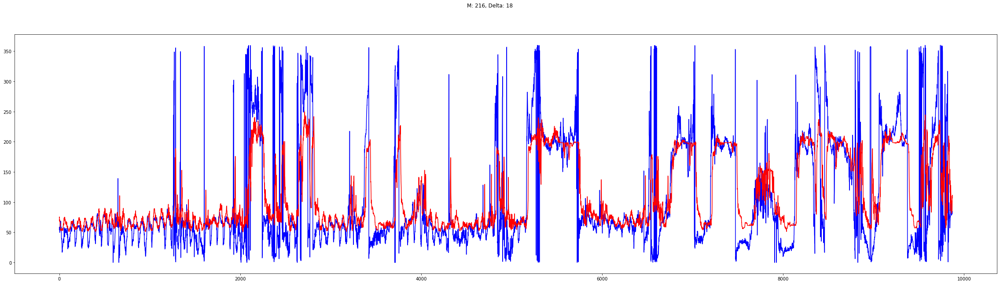

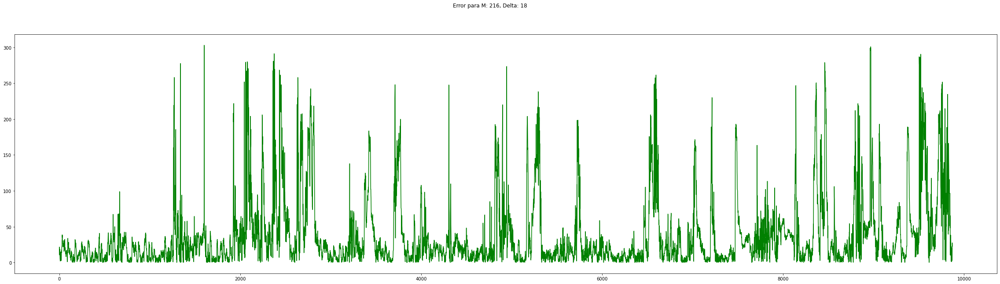

[0]	train-rmse:1.12657	eval-rmse:1.24350
[1]	train-rmse:1.12657	eval-rmse:1.24350
[2]	train-rmse:1.12657	eval-rmse:1.24350
[3]	train-rmse:1.12657	eval-rmse:1.24350
[4]	train-rmse:1.12657	eval-rmse:1.24350
[5]	train-rmse:1.12657	eval-rmse:1.24350
[0]	train-rmse:1.10429	eval-rmse:1.20830
[1]	train-rmse:1.08590	eval-rmse:1.17763
[2]	train-rmse:1.07077	eval-rmse:1.15091
[3]	train-rmse:1.05836	eval-rmse:1.12761
[4]	train-rmse:1.04820	eval-rmse:1.10730
[5]	train-rmse:1.03990	eval-rmse:1.08958
[6]	train-rmse:1.03312	eval-rmse:1.07411
[7]	train-rmse:1.02760	eval-rmse:1.06059
[8]	train-rmse:1.02311	eval-rmse:1.04876
[9]	train-rmse:1.01946	eval-rmse:1.03839
[10]	train-rmse:1.01649	eval-rmse:1.02930
[11]	train-rmse:1.01408	eval-rmse:1.02132
[12]	train-rmse:1.01212	eval-rmse:1.01430
[13]	train-rmse:1.01053	eval-rmse:1.00811
[14]	train-rmse:1.00924	eval-rmse:1.00266
[15]	train-rmse:1.00820	eval-rmse:0.99784
[16]	train-rmse:1.00735	eval-rmse:0.99358
[17]	train-rmse:1.00666	eval-rmse:0.98981
[18]	tra

[18]	train-rmse:1.00373	eval-rmse:0.95883
[19]	train-rmse:1.00373	eval-rmse:0.95876
[20]	train-rmse:1.00373	eval-rmse:0.95872
[21]	train-rmse:1.00373	eval-rmse:0.95869
[22]	train-rmse:1.00373	eval-rmse:0.95866
[23]	train-rmse:1.00373	eval-rmse:0.95865
[24]	train-rmse:1.00373	eval-rmse:0.95864
[25]	train-rmse:1.00373	eval-rmse:0.95863
[26]	train-rmse:1.00373	eval-rmse:0.95862
[27]	train-rmse:1.00373	eval-rmse:0.95862
[28]	train-rmse:1.00373	eval-rmse:0.95862
[29]	train-rmse:1.00373	eval-rmse:0.95862
[30]	train-rmse:1.00373	eval-rmse:0.95861
[31]	train-rmse:1.00373	eval-rmse:0.95861
[32]	train-rmse:1.00373	eval-rmse:0.95861
[33]	train-rmse:1.00373	eval-rmse:0.95861
[34]	train-rmse:1.00373	eval-rmse:0.95861
[35]	train-rmse:1.00373	eval-rmse:0.95861
[36]	train-rmse:1.00373	eval-rmse:0.95861
[37]	train-rmse:1.00373	eval-rmse:0.95861
[38]	train-rmse:1.00373	eval-rmse:0.95861
[39]	train-rmse:1.00373	eval-rmse:0.95861
[40]	train-rmse:1.00373	eval-rmse:0.95861
[41]	train-rmse:1.00373	eval-rmse:

[50]	train-rmse:0.82974	eval-rmse:0.73962
[51]	train-rmse:0.82949	eval-rmse:0.73947
[52]	train-rmse:0.82924	eval-rmse:0.73922
[53]	train-rmse:0.82899	eval-rmse:0.73889
[54]	train-rmse:0.82875	eval-rmse:0.73847
[55]	train-rmse:0.82851	eval-rmse:0.73816
[56]	train-rmse:0.82828	eval-rmse:0.73812
[57]	train-rmse:0.82805	eval-rmse:0.73797
[58]	train-rmse:0.82783	eval-rmse:0.73770
[59]	train-rmse:0.82761	eval-rmse:0.73765
[60]	train-rmse:0.82739	eval-rmse:0.73729
[61]	train-rmse:0.82719	eval-rmse:0.73696
[62]	train-rmse:0.82698	eval-rmse:0.73686
[63]	train-rmse:0.82678	eval-rmse:0.73685
[64]	train-rmse:0.82659	eval-rmse:0.73668
[65]	train-rmse:0.82639	eval-rmse:0.73657
[66]	train-rmse:0.82620	eval-rmse:0.73627
[67]	train-rmse:0.82600	eval-rmse:0.73605
[68]	train-rmse:0.82581	eval-rmse:0.73599
[69]	train-rmse:0.82562	eval-rmse:0.73606
[70]	train-rmse:0.82544	eval-rmse:0.73568
[71]	train-rmse:0.82526	eval-rmse:0.73533
[72]	train-rmse:0.82508	eval-rmse:0.73502
[73]	train-rmse:0.82491	eval-rmse:

[12]	train-rmse:0.80992	eval-rmse:0.74091
[13]	train-rmse:0.80765	eval-rmse:0.74194
[14]	train-rmse:0.80554	eval-rmse:0.74075
[0]	train-rmse:0.92427	eval-rmse:0.92110
[1]	train-rmse:0.86132	eval-rmse:0.80468
[2]	train-rmse:0.84026	eval-rmse:0.76697
[3]	train-rmse:0.83216	eval-rmse:0.74871
[4]	train-rmse:0.82584	eval-rmse:0.74477
[5]	train-rmse:0.82208	eval-rmse:0.74089
[6]	train-rmse:0.81883	eval-rmse:0.74090
[7]	train-rmse:0.81689	eval-rmse:0.74238
[8]	train-rmse:0.81397	eval-rmse:0.74195
[9]	train-rmse:0.81000	eval-rmse:0.74313
[0]	train-rmse:0.89692	eval-rmse:0.87100
[1]	train-rmse:0.84819	eval-rmse:0.77535
[2]	train-rmse:0.83515	eval-rmse:0.75352
[3]	train-rmse:0.82980	eval-rmse:0.74374
[4]	train-rmse:0.82495	eval-rmse:0.74083
[5]	train-rmse:0.82108	eval-rmse:0.74247
[6]	train-rmse:0.81726	eval-rmse:0.74259
[7]	train-rmse:0.81344	eval-rmse:0.74433
[8]	train-rmse:0.81029	eval-rmse:0.74736
[0]	train-rmse:0.87506	eval-rmse:0.82792
[1]	train-rmse:0.84170	eval-rmse:0.75742
[2]	train-rms

[2]	train-rmse:1.12657	eval-rmse:1.24350
[3]	train-rmse:1.12657	eval-rmse:1.24350
[4]	train-rmse:1.12657	eval-rmse:1.24350
[5]	train-rmse:1.12657	eval-rmse:1.24350
[0]	train-rmse:1.07548	eval-rmse:1.17064
[1]	train-rmse:1.03171	eval-rmse:1.10841
[2]	train-rmse:0.99401	eval-rmse:1.05449
[3]	train-rmse:0.96204	eval-rmse:1.00743
[4]	train-rmse:0.93443	eval-rmse:0.96873
[5]	train-rmse:0.91107	eval-rmse:0.93558
[6]	train-rmse:0.89093	eval-rmse:0.90668
[7]	train-rmse:0.87360	eval-rmse:0.88231
[8]	train-rmse:0.85876	eval-rmse:0.86039
[9]	train-rmse:0.84632	eval-rmse:0.84181
[10]	train-rmse:0.83559	eval-rmse:0.82626
[11]	train-rmse:0.82605	eval-rmse:0.81252
[12]	train-rmse:0.81724	eval-rmse:0.80178
[13]	train-rmse:0.80971	eval-rmse:0.79262
[14]	train-rmse:0.80331	eval-rmse:0.78394
[15]	train-rmse:0.79726	eval-rmse:0.77832
[16]	train-rmse:0.79166	eval-rmse:0.77182
[17]	train-rmse:0.78673	eval-rmse:0.76847
[18]	train-rmse:0.78217	eval-rmse:0.76418
[19]	train-rmse:0.77739	eval-rmse:0.76117
[20]	t

[1]	train-rmse:0.88320	eval-rmse:0.90668
[2]	train-rmse:0.82383	eval-rmse:0.83816
[3]	train-rmse:0.78929	eval-rmse:0.79865
[4]	train-rmse:0.76363	eval-rmse:0.77866
[5]	train-rmse:0.74262	eval-rmse:0.76522
[6]	train-rmse:0.72849	eval-rmse:0.76367
[7]	train-rmse:0.71921	eval-rmse:0.76031
[8]	train-rmse:0.70567	eval-rmse:0.75969
[9]	train-rmse:0.69439	eval-rmse:0.76094
[10]	train-rmse:0.68750	eval-rmse:0.76328
[11]	train-rmse:0.68190	eval-rmse:0.76167
[12]	train-rmse:0.67924	eval-rmse:0.76149
[0]	train-rmse:0.93315	eval-rmse:0.97337
[1]	train-rmse:0.83469	eval-rmse:0.84299
[2]	train-rmse:0.78713	eval-rmse:0.78777
[3]	train-rmse:0.75640	eval-rmse:0.76862
[4]	train-rmse:0.73736	eval-rmse:0.76506
[5]	train-rmse:0.71810	eval-rmse:0.76417
[6]	train-rmse:0.70322	eval-rmse:0.76337
[7]	train-rmse:0.69175	eval-rmse:0.76528
[8]	train-rmse:0.68378	eval-rmse:0.76835
[9]	train-rmse:0.67545	eval-rmse:0.77330
[10]	train-rmse:0.66924	eval-rmse:0.77391
[0]	train-rmse:0.89568	eval-rmse:0.91869
[1]	train-rm

[21]	train-rmse:0.57916	eval-rmse:0.76527
[22]	train-rmse:0.56934	eval-rmse:0.76380
[23]	train-rmse:0.55861	eval-rmse:0.76352
[24]	train-rmse:0.55116	eval-rmse:0.76338
[25]	train-rmse:0.54364	eval-rmse:0.76372
[26]	train-rmse:0.53571	eval-rmse:0.76360
[27]	train-rmse:0.52851	eval-rmse:0.76328
[28]	train-rmse:0.52487	eval-rmse:0.76309
[29]	train-rmse:0.51783	eval-rmse:0.76382
[30]	train-rmse:0.51252	eval-rmse:0.76397
[31]	train-rmse:0.50460	eval-rmse:0.76410
[32]	train-rmse:0.49690	eval-rmse:0.76522
[0]	train-rmse:1.00670	eval-rmse:1.10159
[1]	train-rmse:0.91393	eval-rmse:0.99747
[2]	train-rmse:0.84275	eval-rmse:0.92166
[3]	train-rmse:0.78555	eval-rmse:0.86826
[4]	train-rmse:0.73909	eval-rmse:0.83256
[5]	train-rmse:0.70425	eval-rmse:0.80945
[6]	train-rmse:0.67488	eval-rmse:0.79178
[7]	train-rmse:0.65209	eval-rmse:0.78123
[8]	train-rmse:0.63090	eval-rmse:0.77616
[9]	train-rmse:0.60998	eval-rmse:0.77258
[10]	train-rmse:0.59183	eval-rmse:0.77103
[11]	train-rmse:0.57777	eval-rmse:0.76984
[1

[4]	train-rmse:0.82952	eval-rmse:0.96713
[5]	train-rmse:0.78643	eval-rmse:0.93221
[6]	train-rmse:0.74991	eval-rmse:0.90376
[7]	train-rmse:0.71440	eval-rmse:0.87950
[8]	train-rmse:0.68115	eval-rmse:0.85868
[9]	train-rmse:0.65338	eval-rmse:0.84210
[10]	train-rmse:0.62734	eval-rmse:0.82811
[11]	train-rmse:0.60149	eval-rmse:0.81779
[12]	train-rmse:0.57661	eval-rmse:0.80799
[13]	train-rmse:0.55654	eval-rmse:0.79988
[14]	train-rmse:0.53509	eval-rmse:0.79364
[15]	train-rmse:0.51396	eval-rmse:0.78741
[16]	train-rmse:0.49603	eval-rmse:0.78398
[17]	train-rmse:0.47866	eval-rmse:0.78053
[18]	train-rmse:0.46455	eval-rmse:0.77807
[19]	train-rmse:0.44666	eval-rmse:0.77621
[20]	train-rmse:0.43268	eval-rmse:0.77538
[21]	train-rmse:0.42046	eval-rmse:0.77394
[22]	train-rmse:0.40680	eval-rmse:0.77215
[23]	train-rmse:0.39503	eval-rmse:0.77208
[24]	train-rmse:0.38508	eval-rmse:0.77201
[25]	train-rmse:0.37262	eval-rmse:0.77243
[26]	train-rmse:0.35913	eval-rmse:0.77287
[27]	train-rmse:0.34894	eval-rmse:0.7728

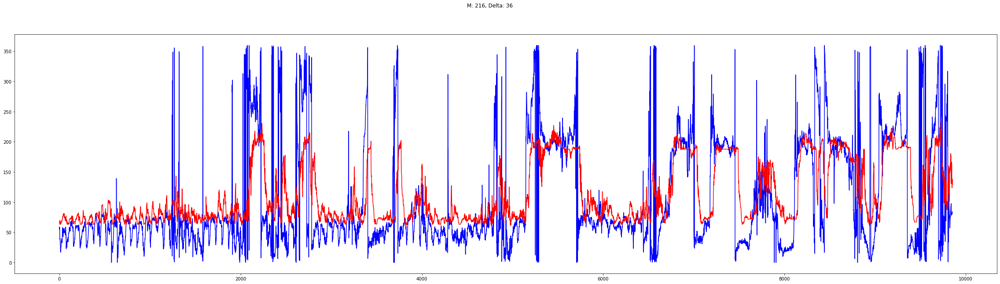

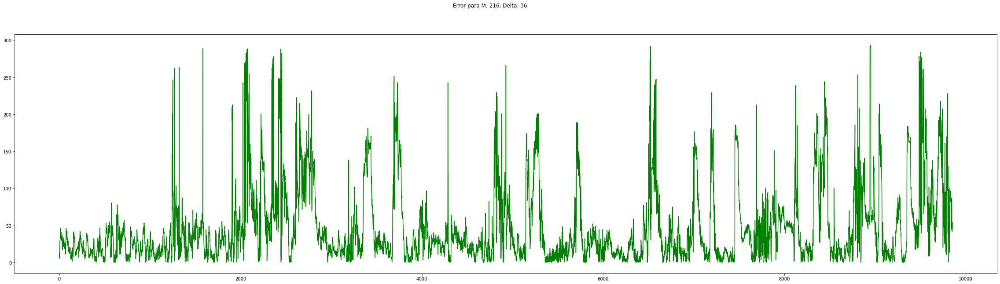

[0]	train-rmse:1.12531	eval-rmse:1.24218
[1]	train-rmse:1.12531	eval-rmse:1.24218
[2]	train-rmse:1.12531	eval-rmse:1.24218
[3]	train-rmse:1.12531	eval-rmse:1.24218
[4]	train-rmse:1.12531	eval-rmse:1.24218
[5]	train-rmse:1.12531	eval-rmse:1.24218
[0]	train-rmse:1.10319	eval-rmse:1.20721
[1]	train-rmse:1.08495	eval-rmse:1.17673
[2]	train-rmse:1.06995	eval-rmse:1.15017
[3]	train-rmse:1.05764	eval-rmse:1.12703
[4]	train-rmse:1.04756	eval-rmse:1.10685
[5]	train-rmse:1.03933	eval-rmse:1.08924
[6]	train-rmse:1.03261	eval-rmse:1.07387
[7]	train-rmse:1.02714	eval-rmse:1.06044
[8]	train-rmse:1.02268	eval-rmse:1.04868
[9]	train-rmse:1.01906	eval-rmse:1.03839
[10]	train-rmse:1.01612	eval-rmse:1.02936
[11]	train-rmse:1.01373	eval-rmse:1.02142
[12]	train-rmse:1.01178	eval-rmse:1.01444
[13]	train-rmse:1.01021	eval-rmse:1.00830
[14]	train-rmse:1.00893	eval-rmse:1.00288
[15]	train-rmse:1.00790	eval-rmse:0.99809
[16]	train-rmse:1.00706	eval-rmse:0.99386
[17]	train-rmse:1.00638	eval-rmse:0.99011
[18]	tra

[18]	train-rmse:1.00347	eval-rmse:0.95931
[19]	train-rmse:1.00347	eval-rmse:0.95925
[20]	train-rmse:1.00347	eval-rmse:0.95920
[21]	train-rmse:1.00347	eval-rmse:0.95917
[22]	train-rmse:1.00347	eval-rmse:0.95915
[23]	train-rmse:1.00347	eval-rmse:0.95913
[24]	train-rmse:1.00347	eval-rmse:0.95912
[25]	train-rmse:1.00347	eval-rmse:0.95911
[26]	train-rmse:1.00347	eval-rmse:0.95911
[27]	train-rmse:1.00347	eval-rmse:0.95910
[28]	train-rmse:1.00347	eval-rmse:0.95910
[29]	train-rmse:1.00347	eval-rmse:0.95910
[30]	train-rmse:1.00347	eval-rmse:0.95910
[31]	train-rmse:1.00347	eval-rmse:0.95910
[32]	train-rmse:1.00347	eval-rmse:0.95910
[33]	train-rmse:1.00347	eval-rmse:0.95910
[34]	train-rmse:1.00347	eval-rmse:0.95909
[35]	train-rmse:1.00347	eval-rmse:0.95909
[36]	train-rmse:1.00347	eval-rmse:0.95909
[37]	train-rmse:1.00347	eval-rmse:0.95909
[38]	train-rmse:1.00347	eval-rmse:0.95909
[0]	train-rmse:1.04897	eval-rmse:1.10974
[1]	train-rmse:1.02008	eval-rmse:1.04137
[2]	train-rmse:1.00948	eval-rmse:1.0

[5]	train-rmse:0.90312	eval-rmse:0.81442
[6]	train-rmse:0.90121	eval-rmse:0.81159
[7]	train-rmse:0.89963	eval-rmse:0.80878
[8]	train-rmse:0.89810	eval-rmse:0.81307
[9]	train-rmse:0.89660	eval-rmse:0.81250
[10]	train-rmse:0.89527	eval-rmse:0.81092
[11]	train-rmse:0.89402	eval-rmse:0.81045
[0]	train-rmse:0.94331	eval-rmse:0.90992
[1]	train-rmse:0.91601	eval-rmse:0.83933
[2]	train-rmse:0.91128	eval-rmse:0.82548
[3]	train-rmse:0.90737	eval-rmse:0.81812
[4]	train-rmse:0.90455	eval-rmse:0.81420
[5]	train-rmse:0.90233	eval-rmse:0.81158
[6]	train-rmse:0.90068	eval-rmse:0.80851
[7]	train-rmse:0.89894	eval-rmse:0.81362
[8]	train-rmse:0.89736	eval-rmse:0.81312
[9]	train-rmse:0.89606	eval-rmse:0.81269
[10]	train-rmse:0.89487	eval-rmse:0.81144
[0]	train-rmse:0.93228	eval-rmse:0.87913
[1]	train-rmse:0.91449	eval-rmse:0.82812
[2]	train-rmse:0.91027	eval-rmse:0.81921
[3]	train-rmse:0.90705	eval-rmse:0.81446
[4]	train-rmse:0.90482	eval-rmse:0.81177
[5]	train-rmse:0.90298	eval-rmse:0.81046
[6]	train-rms

[6]	train-rmse:0.87511	eval-rmse:0.80751
[7]	train-rmse:0.87049	eval-rmse:0.80854
[8]	train-rmse:0.86716	eval-rmse:0.81206
[9]	train-rmse:0.86472	eval-rmse:0.81115
[10]	train-rmse:0.86175	eval-rmse:0.81800
[0]	train-rmse:0.91135	eval-rmse:0.83905
[1]	train-rmse:0.89834	eval-rmse:0.81929
[2]	train-rmse:0.89163	eval-rmse:0.82085
[3]	train-rmse:0.88571	eval-rmse:0.82451
[4]	train-rmse:0.88167	eval-rmse:0.82700
[5]	train-rmse:0.87729	eval-rmse:0.83354
[0]	train-rmse:1.12531	eval-rmse:1.24218
[1]	train-rmse:1.12531	eval-rmse:1.24218
[2]	train-rmse:1.12531	eval-rmse:1.24218
[3]	train-rmse:1.12531	eval-rmse:1.24218
[4]	train-rmse:1.12531	eval-rmse:1.24218
[5]	train-rmse:1.12531	eval-rmse:1.24218
[0]	train-rmse:1.08602	eval-rmse:1.17959
[1]	train-rmse:1.05289	eval-rmse:1.12575
[2]	train-rmse:1.02487	eval-rmse:1.07910
[3]	train-rmse:1.00149	eval-rmse:1.04035
[4]	train-rmse:0.98173	eval-rmse:1.00704
[5]	train-rmse:0.96509	eval-rmse:0.97866
[6]	train-rmse:0.95079	eval-rmse:0.95509
[7]	train-rmse:

[39]	train-rmse:0.79706	eval-rmse:0.81451
[0]	train-rmse:1.04584	eval-rmse:1.11674
[1]	train-rmse:0.98930	eval-rmse:1.02508
[2]	train-rmse:0.94942	eval-rmse:0.96115
[3]	train-rmse:0.92027	eval-rmse:0.91658
[4]	train-rmse:0.89911	eval-rmse:0.88552
[5]	train-rmse:0.88148	eval-rmse:0.86249
[6]	train-rmse:0.86832	eval-rmse:0.84598
[7]	train-rmse:0.85868	eval-rmse:0.83584
[8]	train-rmse:0.85070	eval-rmse:0.82835
[9]	train-rmse:0.84438	eval-rmse:0.82333
[10]	train-rmse:0.83691	eval-rmse:0.82152
[11]	train-rmse:0.83201	eval-rmse:0.81865
[12]	train-rmse:0.82760	eval-rmse:0.81724
[13]	train-rmse:0.82450	eval-rmse:0.81662
[14]	train-rmse:0.81828	eval-rmse:0.81675
[15]	train-rmse:0.81453	eval-rmse:0.81581
[16]	train-rmse:0.80943	eval-rmse:0.81569
[17]	train-rmse:0.80467	eval-rmse:0.81717
[18]	train-rmse:0.79810	eval-rmse:0.81674
[19]	train-rmse:0.79480	eval-rmse:0.81697
[20]	train-rmse:0.78934	eval-rmse:0.81768
[0]	train-rmse:1.01088	eval-rmse:1.05922
[1]	train-rmse:0.94456	eval-rmse:0.95178
[2]	

[5]	train-rmse:0.76700	eval-rmse:0.83709
[6]	train-rmse:0.75669	eval-rmse:0.83662
[7]	train-rmse:0.73906	eval-rmse:0.83975
[8]	train-rmse:0.73013	eval-rmse:0.84448
[9]	train-rmse:0.71353	eval-rmse:0.84822
[0]	train-rmse:0.91072	eval-rmse:0.91532
[1]	train-rmse:0.84634	eval-rmse:0.85045
[2]	train-rmse:0.81010	eval-rmse:0.83991
[3]	train-rmse:0.79041	eval-rmse:0.83624
[4]	train-rmse:0.77167	eval-rmse:0.83863
[5]	train-rmse:0.75722	eval-rmse:0.84344
[6]	train-rmse:0.74440	eval-rmse:0.84756
[7]	train-rmse:0.72609	eval-rmse:0.85264
[8]	train-rmse:0.70721	eval-rmse:0.84897
[0]	train-rmse:0.89045	eval-rmse:0.88161
[1]	train-rmse:0.83728	eval-rmse:0.84044
[2]	train-rmse:0.80947	eval-rmse:0.84265
[3]	train-rmse:0.78304	eval-rmse:0.85512
[4]	train-rmse:0.76833	eval-rmse:0.85422
[5]	train-rmse:0.74508	eval-rmse:0.86219
[0]	train-rmse:0.87566	eval-rmse:0.85611
[1]	train-rmse:0.82944	eval-rmse:0.84574
[2]	train-rmse:0.80259	eval-rmse:0.84556
[3]	train-rmse:0.78786	eval-rmse:0.84760
[4]	train-rmse:0

[8]	train-rmse:0.67287	eval-rmse:0.83886
[9]	train-rmse:0.65314	eval-rmse:0.83691
[10]	train-rmse:0.63116	eval-rmse:0.83721
[11]	train-rmse:0.61534	eval-rmse:0.83827
[12]	train-rmse:0.60162	eval-rmse:0.83830
[13]	train-rmse:0.58605	eval-rmse:0.83696
[0]	train-rmse:0.96876	eval-rmse:1.05474
[1]	train-rmse:0.86793	eval-rmse:0.94892
[2]	train-rmse:0.80211	eval-rmse:0.88979
[3]	train-rmse:0.75026	eval-rmse:0.86244
[4]	train-rmse:0.71186	eval-rmse:0.84935
[5]	train-rmse:0.68245	eval-rmse:0.84503
[6]	train-rmse:0.65363	eval-rmse:0.84274
[7]	train-rmse:0.61756	eval-rmse:0.84114
[8]	train-rmse:0.59697	eval-rmse:0.84453
[9]	train-rmse:0.57179	eval-rmse:0.84727
[10]	train-rmse:0.55920	eval-rmse:0.84767
[11]	train-rmse:0.54547	eval-rmse:0.85186
[0]	train-rmse:0.92450	eval-rmse:1.00257
[1]	train-rmse:0.81604	eval-rmse:0.90019
[2]	train-rmse:0.74675	eval-rmse:0.85874
[3]	train-rmse:0.69407	eval-rmse:0.85399
[4]	train-rmse:0.65769	eval-rmse:0.85252
[5]	train-rmse:0.63603	eval-rmse:0.85299
[6]	train-

[26]	train-rmse:0.38444	eval-rmse:0.84298
[27]	train-rmse:0.37518	eval-rmse:0.84329
[28]	train-rmse:0.36525	eval-rmse:0.84393
[29]	train-rmse:0.35240	eval-rmse:0.84410
[0]	train-rmse:0.99328	eval-rmse:1.11554
[1]	train-rmse:0.88484	eval-rmse:1.02250
[2]	train-rmse:0.79678	eval-rmse:0.96563
[3]	train-rmse:0.72778	eval-rmse:0.92535
[4]	train-rmse:0.66659	eval-rmse:0.89672
[5]	train-rmse:0.62100	eval-rmse:0.88006
[6]	train-rmse:0.58160	eval-rmse:0.86936
[7]	train-rmse:0.54922	eval-rmse:0.86321
[8]	train-rmse:0.51606	eval-rmse:0.85974
[9]	train-rmse:0.48864	eval-rmse:0.85930
[10]	train-rmse:0.47090	eval-rmse:0.85741
[11]	train-rmse:0.44699	eval-rmse:0.85618
[12]	train-rmse:0.42396	eval-rmse:0.85709
[13]	train-rmse:0.39069	eval-rmse:0.85741
[14]	train-rmse:0.37210	eval-rmse:0.85875
[15]	train-rmse:0.34674	eval-rmse:0.85886
[0]	train-rmse:0.93250	eval-rmse:1.06059
[1]	train-rmse:0.80139	eval-rmse:0.95978
[2]	train-rmse:0.69984	eval-rmse:0.89912
[3]	train-rmse:0.62543	eval-rmse:0.87230
[4]	tr

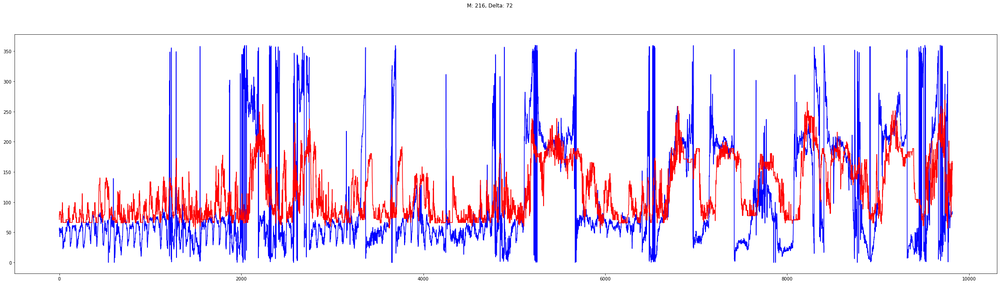

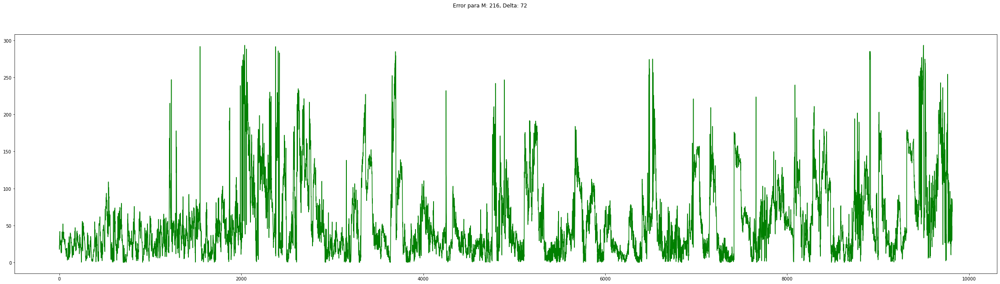

[0]	train-rmse:1.13025	eval-rmse:1.23751
[1]	train-rmse:1.13025	eval-rmse:1.23751
[2]	train-rmse:1.13025	eval-rmse:1.23751
[3]	train-rmse:1.13025	eval-rmse:1.23751
[4]	train-rmse:1.13025	eval-rmse:1.23751
[0]	train-rmse:1.10751	eval-rmse:1.20240
[1]	train-rmse:1.08874	eval-rmse:1.17185
[2]	train-rmse:1.07330	eval-rmse:1.14528
[3]	train-rmse:1.06063	eval-rmse:1.12217
[4]	train-rmse:1.05025	eval-rmse:1.10206
[5]	train-rmse:1.04177	eval-rmse:1.08455
[6]	train-rmse:1.03485	eval-rmse:1.06929
[7]	train-rmse:1.02921	eval-rmse:1.05599
[8]	train-rmse:1.02461	eval-rmse:1.04437
[9]	train-rmse:1.02088	eval-rmse:1.03421
[10]	train-rmse:1.01785	eval-rmse:1.02531
[11]	train-rmse:1.01538	eval-rmse:1.01752
[12]	train-rmse:1.01338	eval-rmse:1.01067
[13]	train-rmse:1.01176	eval-rmse:1.00465
[14]	train-rmse:1.01044	eval-rmse:0.99935
[15]	train-rmse:1.00937	eval-rmse:0.99467
[16]	train-rmse:1.00850	eval-rmse:0.99055
[17]	train-rmse:1.00780	eval-rmse:0.98690
[18]	train-rmse:1.00723	eval-rmse:0.98367
[19]	tr

[20]	train-rmse:1.00480	eval-rmse:0.95703
[21]	train-rmse:1.00480	eval-rmse:0.95700
[22]	train-rmse:1.00480	eval-rmse:0.95698
[23]	train-rmse:1.00480	eval-rmse:0.95696
[24]	train-rmse:1.00480	eval-rmse:0.95695
[25]	train-rmse:1.00480	eval-rmse:0.95694
[26]	train-rmse:1.00480	eval-rmse:0.95694
[27]	train-rmse:1.00480	eval-rmse:0.95693
[28]	train-rmse:1.00480	eval-rmse:0.95693
[29]	train-rmse:1.00480	eval-rmse:0.95693
[30]	train-rmse:1.00480	eval-rmse:0.95693
[31]	train-rmse:1.00480	eval-rmse:0.95693
[32]	train-rmse:1.00480	eval-rmse:0.95693
[33]	train-rmse:1.00480	eval-rmse:0.95693
[34]	train-rmse:1.00480	eval-rmse:0.95693
[35]	train-rmse:1.00480	eval-rmse:0.95693
[36]	train-rmse:1.00480	eval-rmse:0.95693
[37]	train-rmse:1.00480	eval-rmse:0.95693
[38]	train-rmse:1.00480	eval-rmse:0.95693
[0]	train-rmse:1.05169	eval-rmse:1.10493
[1]	train-rmse:1.02193	eval-rmse:1.03715
[2]	train-rmse:1.01100	eval-rmse:1.00168
[3]	train-rmse:1.00704	eval-rmse:0.98250
[4]	train-rmse:1.00561	eval-rmse:0.971

[54]	train-rmse:0.56536	eval-rmse:0.47987
[55]	train-rmse:0.56494	eval-rmse:0.47964
[56]	train-rmse:0.56454	eval-rmse:0.47950
[57]	train-rmse:0.56415	eval-rmse:0.47929
[58]	train-rmse:0.56376	eval-rmse:0.47885
[59]	train-rmse:0.56339	eval-rmse:0.47817
[60]	train-rmse:0.56303	eval-rmse:0.47814
[61]	train-rmse:0.56268	eval-rmse:0.47796
[62]	train-rmse:0.56234	eval-rmse:0.47792
[63]	train-rmse:0.56201	eval-rmse:0.47734
[64]	train-rmse:0.56169	eval-rmse:0.47731
[65]	train-rmse:0.56138	eval-rmse:0.47728
[66]	train-rmse:0.56108	eval-rmse:0.47712
[67]	train-rmse:0.56077	eval-rmse:0.47677
[68]	train-rmse:0.56048	eval-rmse:0.47647
[69]	train-rmse:0.56020	eval-rmse:0.47631
[70]	train-rmse:0.55993	eval-rmse:0.47619
[71]	train-rmse:0.55966	eval-rmse:0.47566
[72]	train-rmse:0.55938	eval-rmse:0.47568
[73]	train-rmse:0.55913	eval-rmse:0.47552
[74]	train-rmse:0.55889	eval-rmse:0.47548
[75]	train-rmse:0.55866	eval-rmse:0.47537
[76]	train-rmse:0.55842	eval-rmse:0.47523
[77]	train-rmse:0.55819	eval-rmse:

[15]	train-rmse:0.56432	eval-rmse:0.48522
[16]	train-rmse:0.56364	eval-rmse:0.48575
[17]	train-rmse:0.56300	eval-rmse:0.48586
[0]	train-rmse:0.69607	eval-rmse:0.65031
[1]	train-rmse:0.61872	eval-rmse:0.54228
[2]	train-rmse:0.60003	eval-rmse:0.50930
[3]	train-rmse:0.59080	eval-rmse:0.49942
[4]	train-rmse:0.58725	eval-rmse:0.49925
[5]	train-rmse:0.58400	eval-rmse:0.49871
[6]	train-rmse:0.58073	eval-rmse:0.49257
[7]	train-rmse:0.57738	eval-rmse:0.49091
[8]	train-rmse:0.57481	eval-rmse:0.49091
[9]	train-rmse:0.57362	eval-rmse:0.48958
[10]	train-rmse:0.57246	eval-rmse:0.49043
[11]	train-rmse:0.57133	eval-rmse:0.48984
[12]	train-rmse:0.57026	eval-rmse:0.48759
[13]	train-rmse:0.56931	eval-rmse:0.48930
[14]	train-rmse:0.56833	eval-rmse:0.48953
[15]	train-rmse:0.56745	eval-rmse:0.48938
[16]	train-rmse:0.56666	eval-rmse:0.48928
[17]	train-rmse:0.56589	eval-rmse:0.48977
[0]	train-rmse:0.66403	eval-rmse:0.59659
[1]	train-rmse:0.60823	eval-rmse:0.52274
[2]	train-rmse:0.59681	eval-rmse:0.50214
[3]	t

[1]	train-rmse:0.60590	eval-rmse:0.53211
[2]	train-rmse:0.57927	eval-rmse:0.49703
[3]	train-rmse:0.56779	eval-rmse:0.48566
[4]	train-rmse:0.56164	eval-rmse:0.48488
[5]	train-rmse:0.55817	eval-rmse:0.48173
[6]	train-rmse:0.55542	eval-rmse:0.48279
[7]	train-rmse:0.55103	eval-rmse:0.48539
[8]	train-rmse:0.54892	eval-rmse:0.48567
[9]	train-rmse:0.54615	eval-rmse:0.48625
[10]	train-rmse:0.54416	eval-rmse:0.48745
[0]	train-rmse:0.66292	eval-rmse:0.61875
[1]	train-rmse:0.59103	eval-rmse:0.51185
[2]	train-rmse:0.57163	eval-rmse:0.48323
[3]	train-rmse:0.56500	eval-rmse:0.47867
[4]	train-rmse:0.55997	eval-rmse:0.47988
[5]	train-rmse:0.55631	eval-rmse:0.48316
[6]	train-rmse:0.55299	eval-rmse:0.48336
[7]	train-rmse:0.55039	eval-rmse:0.48291
[8]	train-rmse:0.54788	eval-rmse:0.48442
[0]	train-rmse:0.62722	eval-rmse:0.56174
[1]	train-rmse:0.58228	eval-rmse:0.49517
[2]	train-rmse:0.57207	eval-rmse:0.49112
[3]	train-rmse:0.56198	eval-rmse:0.48765
[4]	train-rmse:0.55742	eval-rmse:0.49243
[5]	train-rmse:

[5]	train-rmse:0.76101	eval-rmse:0.77951
[6]	train-rmse:0.72501	eval-rmse:0.73272
[7]	train-rmse:0.69373	eval-rmse:0.69295
[8]	train-rmse:0.66729	eval-rmse:0.65845
[9]	train-rmse:0.64441	eval-rmse:0.62936
[10]	train-rmse:0.62422	eval-rmse:0.60429
[11]	train-rmse:0.60724	eval-rmse:0.58279
[12]	train-rmse:0.59251	eval-rmse:0.56527
[13]	train-rmse:0.57984	eval-rmse:0.55046
[14]	train-rmse:0.56933	eval-rmse:0.53716
[15]	train-rmse:0.56015	eval-rmse:0.52613
[16]	train-rmse:0.55241	eval-rmse:0.51753
[17]	train-rmse:0.54483	eval-rmse:0.51046
[18]	train-rmse:0.53892	eval-rmse:0.50443
[19]	train-rmse:0.53328	eval-rmse:0.49943
[20]	train-rmse:0.52823	eval-rmse:0.49554
[21]	train-rmse:0.52353	eval-rmse:0.49207
[22]	train-rmse:0.51935	eval-rmse:0.48944
[23]	train-rmse:0.51591	eval-rmse:0.48759
[24]	train-rmse:0.51237	eval-rmse:0.48591
[25]	train-rmse:0.50872	eval-rmse:0.48457
[26]	train-rmse:0.50578	eval-rmse:0.48357
[27]	train-rmse:0.50327	eval-rmse:0.48245
[28]	train-rmse:0.50098	eval-rmse:0.481

[49]	train-rmse:0.41450	eval-rmse:0.47876
[50]	train-rmse:0.41271	eval-rmse:0.47850
[51]	train-rmse:0.41215	eval-rmse:0.47851
[52]	train-rmse:0.41173	eval-rmse:0.47846
[53]	train-rmse:0.41100	eval-rmse:0.47840
[54]	train-rmse:0.40904	eval-rmse:0.47866
[55]	train-rmse:0.40713	eval-rmse:0.47880
[56]	train-rmse:0.40678	eval-rmse:0.47872
[57]	train-rmse:0.40646	eval-rmse:0.47868
[58]	train-rmse:0.40537	eval-rmse:0.47903
[0]	train-rmse:0.96141	eval-rmse:1.03295
[1]	train-rmse:0.83272	eval-rmse:0.87672
[2]	train-rmse:0.73541	eval-rmse:0.76027
[3]	train-rmse:0.66415	eval-rmse:0.67432
[4]	train-rmse:0.61140	eval-rmse:0.61391
[5]	train-rmse:0.57419	eval-rmse:0.57008
[6]	train-rmse:0.54214	eval-rmse:0.54041
[7]	train-rmse:0.52049	eval-rmse:0.51960
[8]	train-rmse:0.50552	eval-rmse:0.50546
[9]	train-rmse:0.49434	eval-rmse:0.49605
[10]	train-rmse:0.48492	eval-rmse:0.49095
[11]	train-rmse:0.47578	eval-rmse:0.48828
[12]	train-rmse:0.47140	eval-rmse:0.48508
[13]	train-rmse:0.46539	eval-rmse:0.48351
[1

[3]	train-rmse:0.47235	eval-rmse:0.50977
[4]	train-rmse:0.44495	eval-rmse:0.49680
[5]	train-rmse:0.43046	eval-rmse:0.49182
[6]	train-rmse:0.41459	eval-rmse:0.48987
[7]	train-rmse:0.40644	eval-rmse:0.48900
[8]	train-rmse:0.39302	eval-rmse:0.48791
[9]	train-rmse:0.38159	eval-rmse:0.48794
[10]	train-rmse:0.37765	eval-rmse:0.48813
[11]	train-rmse:0.36557	eval-rmse:0.49185
[12]	train-rmse:0.36185	eval-rmse:0.49192
[0]	train-rmse:0.72121	eval-rmse:0.75271
[1]	train-rmse:0.55596	eval-rmse:0.57123
[2]	train-rmse:0.48410	eval-rmse:0.51660
[3]	train-rmse:0.44720	eval-rmse:0.50791
[4]	train-rmse:0.43064	eval-rmse:0.50438
[5]	train-rmse:0.41067	eval-rmse:0.50437
[6]	train-rmse:0.40008	eval-rmse:0.50621
[7]	train-rmse:0.39092	eval-rmse:0.50731
[8]	train-rmse:0.38614	eval-rmse:0.50799
[9]	train-rmse:0.37933	eval-rmse:0.50944
[0]	train-rmse:0.65497	eval-rmse:0.67214
[1]	train-rmse:0.50975	eval-rmse:0.53325
[2]	train-rmse:0.45722	eval-rmse:0.50726
[3]	train-rmse:0.42972	eval-rmse:0.50737
[4]	train-rms

[11]	train-rmse:0.48383	eval-rmse:0.58854
[12]	train-rmse:0.46175	eval-rmse:0.57180
[13]	train-rmse:0.44027	eval-rmse:0.55782
[14]	train-rmse:0.42334	eval-rmse:0.54639
[15]	train-rmse:0.40671	eval-rmse:0.53604
[16]	train-rmse:0.39156	eval-rmse:0.52706
[17]	train-rmse:0.37976	eval-rmse:0.52036
[18]	train-rmse:0.36751	eval-rmse:0.51568
[19]	train-rmse:0.35720	eval-rmse:0.51124
[20]	train-rmse:0.34718	eval-rmse:0.50764
[21]	train-rmse:0.33900	eval-rmse:0.50434
[22]	train-rmse:0.33082	eval-rmse:0.50134
[23]	train-rmse:0.32345	eval-rmse:0.49896
[24]	train-rmse:0.31640	eval-rmse:0.49664
[25]	train-rmse:0.30842	eval-rmse:0.49510
[26]	train-rmse:0.30246	eval-rmse:0.49430
[27]	train-rmse:0.29650	eval-rmse:0.49354
[28]	train-rmse:0.29045	eval-rmse:0.49323
[29]	train-rmse:0.28608	eval-rmse:0.49268
[30]	train-rmse:0.28004	eval-rmse:0.49301
[31]	train-rmse:0.27577	eval-rmse:0.49287
[32]	train-rmse:0.27161	eval-rmse:0.49284
[33]	train-rmse:0.26665	eval-rmse:0.49246
[34]	train-rmse:0.26385	eval-rmse:

[1]	train-rmse:0.65603	eval-rmse:0.74484
[2]	train-rmse:0.51986	eval-rmse:0.63201
[3]	train-rmse:0.42962	eval-rmse:0.56752
[4]	train-rmse:0.36924	eval-rmse:0.53569
[5]	train-rmse:0.32664	eval-rmse:0.51774
[6]	train-rmse:0.29399	eval-rmse:0.50818
[7]	train-rmse:0.27250	eval-rmse:0.50375
[8]	train-rmse:0.25409	eval-rmse:0.50173
[9]	train-rmse:0.24073	eval-rmse:0.50030
[10]	train-rmse:0.22903	eval-rmse:0.49797
[11]	train-rmse:0.21887	eval-rmse:0.49878
[12]	train-rmse:0.20548	eval-rmse:0.49935
[13]	train-rmse:0.19732	eval-rmse:0.49955
[14]	train-rmse:0.18742	eval-rmse:0.49969
[0]	train-rmse:0.75843	eval-rmse:0.84197
[1]	train-rmse:0.54428	eval-rmse:0.64187
[2]	train-rmse:0.42361	eval-rmse:0.55470
[3]	train-rmse:0.35165	eval-rmse:0.51916
[4]	train-rmse:0.31099	eval-rmse:0.50850
[5]	train-rmse:0.28938	eval-rmse:0.50354
[6]	train-rmse:0.26867	eval-rmse:0.50543
[7]	train-rmse:0.24870	eval-rmse:0.50708
[8]	train-rmse:0.23170	eval-rmse:0.50678
[9]	train-rmse:0.21874	eval-rmse:0.50777
[10]	train-

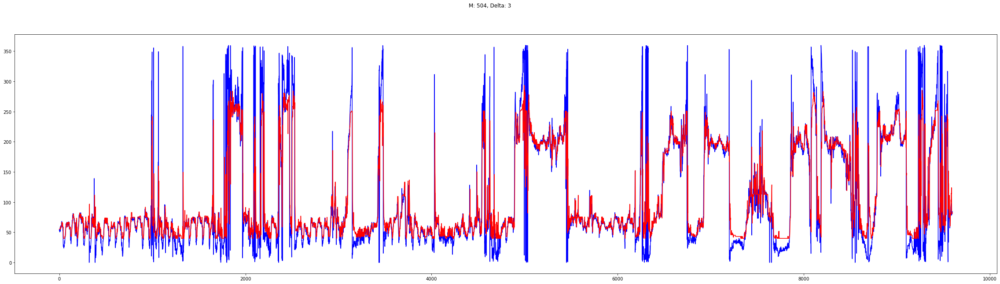

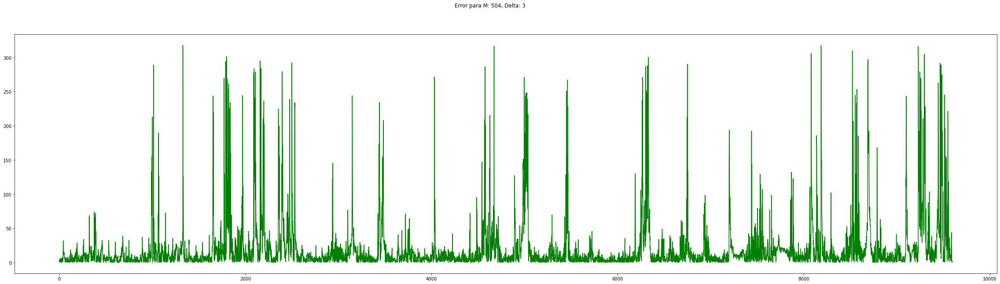

[0]	train-rmse:1.13078	eval-rmse:1.23727
[1]	train-rmse:1.13078	eval-rmse:1.23727
[2]	train-rmse:1.13078	eval-rmse:1.23727
[3]	train-rmse:1.13078	eval-rmse:1.23727
[4]	train-rmse:1.13078	eval-rmse:1.23727
[0]	train-rmse:1.10798	eval-rmse:1.20214
[1]	train-rmse:1.08916	eval-rmse:1.17157
[2]	train-rmse:1.07367	eval-rmse:1.14499
[3]	train-rmse:1.06097	eval-rmse:1.12187
[4]	train-rmse:1.05056	eval-rmse:1.10176
[5]	train-rmse:1.04205	eval-rmse:1.08425
[6]	train-rmse:1.03511	eval-rmse:1.06900
[7]	train-rmse:1.02946	eval-rmse:1.05570
[8]	train-rmse:1.02485	eval-rmse:1.04408
[9]	train-rmse:1.02111	eval-rmse:1.03393
[10]	train-rmse:1.01806	eval-rmse:1.02505
[11]	train-rmse:1.01559	eval-rmse:1.01726
[12]	train-rmse:1.01358	eval-rmse:1.01042
[13]	train-rmse:1.01196	eval-rmse:1.00441
[14]	train-rmse:1.01063	eval-rmse:0.99911
[15]	train-rmse:1.00956	eval-rmse:0.99445
[16]	train-rmse:1.00869	eval-rmse:0.99033
[17]	train-rmse:1.00799	eval-rmse:0.98668
[18]	train-rmse:1.00742	eval-rmse:0.98346
[19]	tr

[19]	train-rmse:1.00498	eval-rmse:0.95693
[20]	train-rmse:1.00498	eval-rmse:0.95688
[21]	train-rmse:1.00498	eval-rmse:0.95685
[22]	train-rmse:1.00498	eval-rmse:0.95683
[23]	train-rmse:1.00498	eval-rmse:0.95682
[24]	train-rmse:1.00498	eval-rmse:0.95681
[25]	train-rmse:1.00498	eval-rmse:0.95680
[26]	train-rmse:1.00498	eval-rmse:0.95679
[27]	train-rmse:1.00498	eval-rmse:0.95679
[28]	train-rmse:1.00498	eval-rmse:0.95679
[29]	train-rmse:1.00498	eval-rmse:0.95679
[30]	train-rmse:1.00498	eval-rmse:0.95679
[31]	train-rmse:1.00498	eval-rmse:0.95678
[32]	train-rmse:1.00498	eval-rmse:0.95678
[33]	train-rmse:1.00498	eval-rmse:0.95678
[34]	train-rmse:1.00498	eval-rmse:0.95678
[35]	train-rmse:1.00498	eval-rmse:0.95678
[36]	train-rmse:1.00498	eval-rmse:0.95678
[37]	train-rmse:1.00498	eval-rmse:0.95678
[0]	train-rmse:1.05201	eval-rmse:1.10464
[1]	train-rmse:1.02216	eval-rmse:1.03687
[2]	train-rmse:1.01120	eval-rmse:1.00144
[3]	train-rmse:1.00723	eval-rmse:0.98229
[4]	train-rmse:1.00579	eval-rmse:0.971

[50]	train-rmse:0.75296	eval-rmse:0.67535
[51]	train-rmse:0.75263	eval-rmse:0.67506
[52]	train-rmse:0.75232	eval-rmse:0.67488
[53]	train-rmse:0.75200	eval-rmse:0.67456
[54]	train-rmse:0.75168	eval-rmse:0.67409
[55]	train-rmse:0.75137	eval-rmse:0.67412
[56]	train-rmse:0.75108	eval-rmse:0.67380
[57]	train-rmse:0.75079	eval-rmse:0.67362
[58]	train-rmse:0.75051	eval-rmse:0.67358
[59]	train-rmse:0.75023	eval-rmse:0.67353
[60]	train-rmse:0.74996	eval-rmse:0.67342
[61]	train-rmse:0.74969	eval-rmse:0.67337
[62]	train-rmse:0.74942	eval-rmse:0.67338
[63]	train-rmse:0.74915	eval-rmse:0.67299
[64]	train-rmse:0.74888	eval-rmse:0.67259
[65]	train-rmse:0.74862	eval-rmse:0.67234
[66]	train-rmse:0.74837	eval-rmse:0.67208
[67]	train-rmse:0.74812	eval-rmse:0.67199
[68]	train-rmse:0.74788	eval-rmse:0.67195
[69]	train-rmse:0.74764	eval-rmse:0.67157
[70]	train-rmse:0.74738	eval-rmse:0.67136
[71]	train-rmse:0.74715	eval-rmse:0.67124
[72]	train-rmse:0.74691	eval-rmse:0.67117
[73]	train-rmse:0.74669	eval-rmse:

[31]	train-rmse:0.71753	eval-rmse:0.66808
[32]	train-rmse:0.71578	eval-rmse:0.66883
[33]	train-rmse:0.71507	eval-rmse:0.66869
[34]	train-rmse:0.71385	eval-rmse:0.66870
[0]	train-rmse:0.96566	eval-rmse:1.00863
[1]	train-rmse:0.87217	eval-rmse:0.86891
[2]	train-rmse:0.81880	eval-rmse:0.78487
[3]	train-rmse:0.78947	eval-rmse:0.73740
[4]	train-rmse:0.77276	eval-rmse:0.70906
[5]	train-rmse:0.76333	eval-rmse:0.69463
[6]	train-rmse:0.75643	eval-rmse:0.68670
[7]	train-rmse:0.75173	eval-rmse:0.68130
[8]	train-rmse:0.74813	eval-rmse:0.67685
[9]	train-rmse:0.74463	eval-rmse:0.67463
[10]	train-rmse:0.74197	eval-rmse:0.67214
[11]	train-rmse:0.73931	eval-rmse:0.67074
[12]	train-rmse:0.73664	eval-rmse:0.66930
[13]	train-rmse:0.73406	eval-rmse:0.66846
[14]	train-rmse:0.73200	eval-rmse:0.66892
[15]	train-rmse:0.72987	eval-rmse:0.66907
[16]	train-rmse:0.72723	eval-rmse:0.66917
[17]	train-rmse:0.72548	eval-rmse:0.67025
[18]	train-rmse:0.72315	eval-rmse:0.66933
[0]	train-rmse:0.91883	eval-rmse:0.94020
[1]

[11]	train-rmse:0.68695	eval-rmse:0.67304
[12]	train-rmse:0.68206	eval-rmse:0.67168
[13]	train-rmse:0.67800	eval-rmse:0.67576
[14]	train-rmse:0.67275	eval-rmse:0.67903
[15]	train-rmse:0.66777	eval-rmse:0.67972
[16]	train-rmse:0.66521	eval-rmse:0.67980
[17]	train-rmse:0.66103	eval-rmse:0.68076
[0]	train-rmse:0.86999	eval-rmse:0.87232
[1]	train-rmse:0.78218	eval-rmse:0.73709
[2]	train-rmse:0.74936	eval-rmse:0.69361
[3]	train-rmse:0.73496	eval-rmse:0.68148
[4]	train-rmse:0.72515	eval-rmse:0.68003
[5]	train-rmse:0.71739	eval-rmse:0.67607
[6]	train-rmse:0.70853	eval-rmse:0.67723
[7]	train-rmse:0.70085	eval-rmse:0.67843
[8]	train-rmse:0.69445	eval-rmse:0.68205
[9]	train-rmse:0.68793	eval-rmse:0.68196
[10]	train-rmse:0.68192	eval-rmse:0.68022
[0]	train-rmse:0.83322	eval-rmse:0.81573
[1]	train-rmse:0.76354	eval-rmse:0.70873
[2]	train-rmse:0.74137	eval-rmse:0.68505
[3]	train-rmse:0.73014	eval-rmse:0.68200
[4]	train-rmse:0.72159	eval-rmse:0.68337
[5]	train-rmse:0.71385	eval-rmse:0.68318
[6]	trai

[1]	train-rmse:1.13078	eval-rmse:1.23727
[2]	train-rmse:1.13078	eval-rmse:1.23727
[3]	train-rmse:1.13078	eval-rmse:1.23727
[4]	train-rmse:1.13078	eval-rmse:1.23727
[0]	train-rmse:1.06575	eval-rmse:1.15589
[1]	train-rmse:1.00907	eval-rmse:1.08484
[2]	train-rmse:0.95926	eval-rmse:1.02210
[3]	train-rmse:0.91603	eval-rmse:0.96803
[4]	train-rmse:0.87930	eval-rmse:0.92280
[5]	train-rmse:0.84764	eval-rmse:0.88233
[6]	train-rmse:0.81882	eval-rmse:0.84937
[7]	train-rmse:0.79438	eval-rmse:0.82078
[8]	train-rmse:0.77238	eval-rmse:0.79603
[9]	train-rmse:0.75326	eval-rmse:0.77509
[10]	train-rmse:0.73659	eval-rmse:0.75823
[11]	train-rmse:0.72191	eval-rmse:0.74283
[12]	train-rmse:0.70938	eval-rmse:0.73021
[13]	train-rmse:0.69755	eval-rmse:0.72030
[14]	train-rmse:0.68647	eval-rmse:0.71135
[15]	train-rmse:0.67687	eval-rmse:0.70353
[16]	train-rmse:0.66761	eval-rmse:0.69768
[17]	train-rmse:0.65929	eval-rmse:0.69210
[18]	train-rmse:0.65193	eval-rmse:0.68717
[19]	train-rmse:0.64482	eval-rmse:0.68407
[20]	t

[6]	train-rmse:0.52929	eval-rmse:0.70591
[7]	train-rmse:0.51153	eval-rmse:0.70851
[8]	train-rmse:0.49354	eval-rmse:0.71045
[9]	train-rmse:0.47896	eval-rmse:0.71268
[0]	train-rmse:0.82395	eval-rmse:0.86955
[1]	train-rmse:0.70060	eval-rmse:0.74901
[2]	train-rmse:0.63304	eval-rmse:0.71337
[3]	train-rmse:0.59325	eval-rmse:0.70595
[4]	train-rmse:0.55779	eval-rmse:0.70890
[5]	train-rmse:0.52994	eval-rmse:0.70999
[6]	train-rmse:0.51490	eval-rmse:0.71541
[7]	train-rmse:0.49508	eval-rmse:0.72044
[8]	train-rmse:0.47736	eval-rmse:0.72699
[0]	train-rmse:0.77891	eval-rmse:0.81575
[1]	train-rmse:0.66690	eval-rmse:0.72882
[2]	train-rmse:0.61306	eval-rmse:0.71420
[3]	train-rmse:0.57558	eval-rmse:0.72013
[4]	train-rmse:0.54018	eval-rmse:0.72663
[5]	train-rmse:0.51882	eval-rmse:0.72998
[6]	train-rmse:0.49054	eval-rmse:0.73513
[7]	train-rmse:0.47828	eval-rmse:0.73992
[0]	train-rmse:0.74190	eval-rmse:0.77214
[1]	train-rmse:0.65338	eval-rmse:0.72625
[2]	train-rmse:0.60355	eval-rmse:0.72473
[3]	train-rmse:0

[34]	train-rmse:0.30761	eval-rmse:0.68604
[35]	train-rmse:0.30091	eval-rmse:0.68647
[36]	train-rmse:0.29691	eval-rmse:0.68668
[0]	train-rmse:0.97706	eval-rmse:1.07740
[1]	train-rmse:0.85388	eval-rmse:0.96062
[2]	train-rmse:0.75818	eval-rmse:0.87264
[3]	train-rmse:0.68290	eval-rmse:0.81259
[4]	train-rmse:0.62343	eval-rmse:0.76993
[5]	train-rmse:0.57356	eval-rmse:0.74387
[6]	train-rmse:0.53139	eval-rmse:0.72716
[7]	train-rmse:0.49485	eval-rmse:0.71726
[8]	train-rmse:0.46046	eval-rmse:0.70973
[9]	train-rmse:0.43345	eval-rmse:0.70520
[10]	train-rmse:0.41240	eval-rmse:0.70179
[11]	train-rmse:0.39194	eval-rmse:0.69945
[12]	train-rmse:0.37192	eval-rmse:0.69771
[13]	train-rmse:0.34954	eval-rmse:0.69716
[14]	train-rmse:0.33822	eval-rmse:0.69757
[15]	train-rmse:0.32703	eval-rmse:0.69691
[16]	train-rmse:0.31556	eval-rmse:0.69758
[17]	train-rmse:0.30236	eval-rmse:0.69815
[18]	train-rmse:0.28764	eval-rmse:0.69892
[19]	train-rmse:0.28027	eval-rmse:0.69991
[0]	train-rmse:0.90516	eval-rmse:1.00482
[1]

[2]	train-rmse:0.37761	eval-rmse:0.78858
[3]	train-rmse:0.32114	eval-rmse:0.80297
[4]	train-rmse:0.26752	eval-rmse:0.81672
[5]	train-rmse:0.25111	eval-rmse:0.81932
[6]	train-rmse:0.23809	eval-rmse:0.82017
[0]	train-rmse:0.56564	eval-rmse:0.78135
[1]	train-rmse:0.44124	eval-rmse:0.81171
[2]	train-rmse:0.36513	eval-rmse:0.82929
[3]	train-rmse:0.32295	eval-rmse:0.83580
[4]	train-rmse:0.30456	eval-rmse:0.83683
[5]	train-rmse:0.28055	eval-rmse:0.84272
Best Max. Depth:  2 , Best ETA:  0.1 ,Best RMSE:  0.66634
M:  504 , Delta:  18
RMSE:  63.92773642556255 , MAE:  38.92913544323845 , R2:  0.44744362713657415


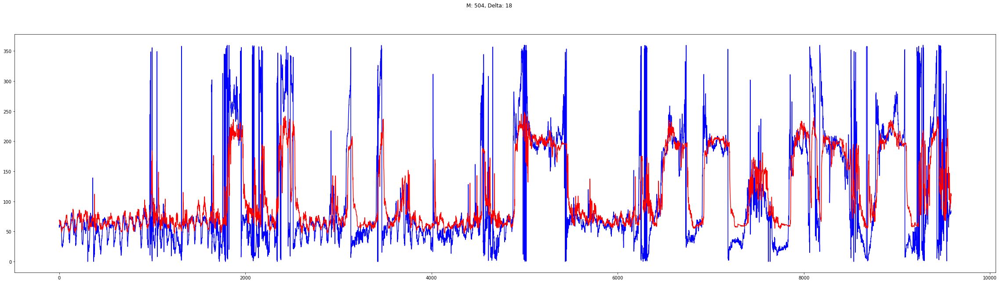

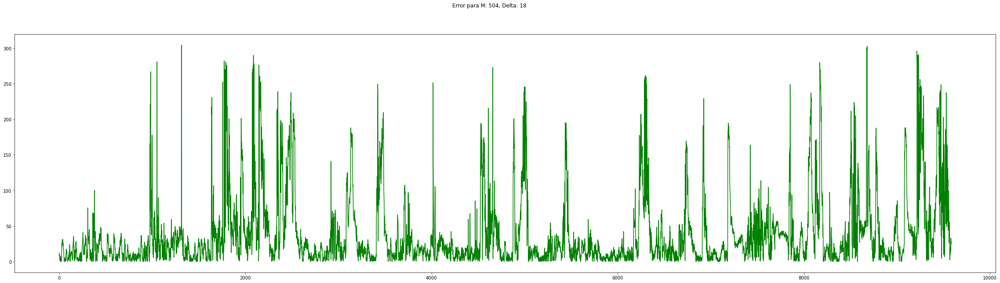

[0]	train-rmse:1.13144	eval-rmse:1.23717
[1]	train-rmse:1.13144	eval-rmse:1.23717
[2]	train-rmse:1.13144	eval-rmse:1.23717
[3]	train-rmse:1.13144	eval-rmse:1.23717
[4]	train-rmse:1.13144	eval-rmse:1.23717
[0]	train-rmse:1.10858	eval-rmse:1.20201
[1]	train-rmse:1.08971	eval-rmse:1.17143
[2]	train-rmse:1.07418	eval-rmse:1.14484
[3]	train-rmse:1.06143	eval-rmse:1.12171
[4]	train-rmse:1.05100	eval-rmse:1.10160
[5]	train-rmse:1.04247	eval-rmse:1.08409
[6]	train-rmse:1.03551	eval-rmse:1.06885
[7]	train-rmse:1.02983	eval-rmse:1.05555
[8]	train-rmse:1.02522	eval-rmse:1.04394
[9]	train-rmse:1.02146	eval-rmse:1.03380
[10]	train-rmse:1.01841	eval-rmse:1.02492
[11]	train-rmse:1.01593	eval-rmse:1.01714
[12]	train-rmse:1.01391	eval-rmse:1.01031
[13]	train-rmse:1.01228	eval-rmse:1.00431
[14]	train-rmse:1.01096	eval-rmse:0.99902
[15]	train-rmse:1.00988	eval-rmse:0.99437
[16]	train-rmse:1.00901	eval-rmse:0.99025
[17]	train-rmse:1.00831	eval-rmse:0.98662
[18]	train-rmse:1.00773	eval-rmse:0.98340
[19]	tr

[18]	train-rmse:1.00529	eval-rmse:0.95700
[19]	train-rmse:1.00529	eval-rmse:0.95694
[20]	train-rmse:1.00529	eval-rmse:0.95690
[21]	train-rmse:1.00529	eval-rmse:0.95687
[22]	train-rmse:1.00529	eval-rmse:0.95685
[23]	train-rmse:1.00529	eval-rmse:0.95683
[24]	train-rmse:1.00529	eval-rmse:0.95682
[25]	train-rmse:1.00529	eval-rmse:0.95681
[26]	train-rmse:1.00529	eval-rmse:0.95681
[27]	train-rmse:1.00529	eval-rmse:0.95681
[28]	train-rmse:1.00529	eval-rmse:0.95680
[29]	train-rmse:1.00529	eval-rmse:0.95680
[30]	train-rmse:1.00529	eval-rmse:0.95680
[31]	train-rmse:1.00529	eval-rmse:0.95680
[32]	train-rmse:1.00529	eval-rmse:0.95680
[33]	train-rmse:1.00529	eval-rmse:0.95680
[34]	train-rmse:1.00529	eval-rmse:0.95680
[35]	train-rmse:1.00529	eval-rmse:0.95680
[36]	train-rmse:1.00529	eval-rmse:0.95680
[37]	train-rmse:1.00529	eval-rmse:0.95680
[0]	train-rmse:1.05245	eval-rmse:1.10447
[1]	train-rmse:1.02252	eval-rmse:1.03673
[2]	train-rmse:1.01153	eval-rmse:1.00135
[3]	train-rmse:1.00754	eval-rmse:0.98

[63]	train-rmse:0.82046	eval-rmse:0.74306
[64]	train-rmse:0.82020	eval-rmse:0.74272
[65]	train-rmse:0.81995	eval-rmse:0.74252
[66]	train-rmse:0.81970	eval-rmse:0.74258
[67]	train-rmse:0.81945	eval-rmse:0.74252
[68]	train-rmse:0.81920	eval-rmse:0.74214
[69]	train-rmse:0.81896	eval-rmse:0.74203
[70]	train-rmse:0.81872	eval-rmse:0.74179
[71]	train-rmse:0.81847	eval-rmse:0.74168
[72]	train-rmse:0.81824	eval-rmse:0.74137
[73]	train-rmse:0.81801	eval-rmse:0.74127
[74]	train-rmse:0.81778	eval-rmse:0.74120
[75]	train-rmse:0.81756	eval-rmse:0.74105
[76]	train-rmse:0.81733	eval-rmse:0.74115
[77]	train-rmse:0.81711	eval-rmse:0.74106
[78]	train-rmse:0.81689	eval-rmse:0.74044
[79]	train-rmse:0.81666	eval-rmse:0.74085
[80]	train-rmse:0.81644	eval-rmse:0.74081
[81]	train-rmse:0.81622	eval-rmse:0.74046
[82]	train-rmse:0.81600	eval-rmse:0.74036
[83]	train-rmse:0.81579	eval-rmse:0.74047
[84]	train-rmse:0.81559	eval-rmse:0.74047
[85]	train-rmse:0.81538	eval-rmse:0.74007
[86]	train-rmse:0.81517	eval-rmse:

[7]	train-rmse:0.88590	eval-rmse:0.88207
[8]	train-rmse:0.87222	eval-rmse:0.86052
[9]	train-rmse:0.86055	eval-rmse:0.84419
[10]	train-rmse:0.85021	eval-rmse:0.82884
[11]	train-rmse:0.84152	eval-rmse:0.81683
[12]	train-rmse:0.83421	eval-rmse:0.80604
[13]	train-rmse:0.82729	eval-rmse:0.79730
[14]	train-rmse:0.82154	eval-rmse:0.78939
[15]	train-rmse:0.81646	eval-rmse:0.78394
[16]	train-rmse:0.81180	eval-rmse:0.77941
[17]	train-rmse:0.80773	eval-rmse:0.77451
[18]	train-rmse:0.80381	eval-rmse:0.77029
[19]	train-rmse:0.80015	eval-rmse:0.76684
[20]	train-rmse:0.79688	eval-rmse:0.76480
[21]	train-rmse:0.79407	eval-rmse:0.76156
[22]	train-rmse:0.79122	eval-rmse:0.75961
[23]	train-rmse:0.78863	eval-rmse:0.75876
[24]	train-rmse:0.78622	eval-rmse:0.75665
[25]	train-rmse:0.78405	eval-rmse:0.75501
[26]	train-rmse:0.78199	eval-rmse:0.75461
[27]	train-rmse:0.77999	eval-rmse:0.75357
[28]	train-rmse:0.77774	eval-rmse:0.75242
[29]	train-rmse:0.77605	eval-rmse:0.75191
[30]	train-rmse:0.77426	eval-rmse:0.7

[12]	train-rmse:0.70502	eval-rmse:0.80385
[13]	train-rmse:0.69149	eval-rmse:0.79637
[14]	train-rmse:0.67739	eval-rmse:0.78905
[15]	train-rmse:0.66510	eval-rmse:0.78402
[16]	train-rmse:0.65588	eval-rmse:0.77894
[17]	train-rmse:0.64494	eval-rmse:0.77430
[18]	train-rmse:0.63669	eval-rmse:0.77088
[19]	train-rmse:0.62683	eval-rmse:0.76834
[20]	train-rmse:0.61681	eval-rmse:0.76765
[21]	train-rmse:0.60737	eval-rmse:0.76626
[22]	train-rmse:0.60045	eval-rmse:0.76567
[23]	train-rmse:0.59345	eval-rmse:0.76526
[24]	train-rmse:0.58694	eval-rmse:0.76426
[25]	train-rmse:0.57820	eval-rmse:0.76367
[26]	train-rmse:0.57074	eval-rmse:0.76269
[27]	train-rmse:0.56598	eval-rmse:0.76258
[28]	train-rmse:0.55965	eval-rmse:0.76318
[29]	train-rmse:0.55294	eval-rmse:0.76408
[30]	train-rmse:0.54761	eval-rmse:0.76301
[31]	train-rmse:0.54124	eval-rmse:0.76383
[32]	train-rmse:0.53580	eval-rmse:0.76317
[0]	train-rmse:1.01212	eval-rmse:1.10134
[1]	train-rmse:0.92324	eval-rmse:0.99589
[2]	train-rmse:0.85405	eval-rmse:0.9

[6]	train-rmse:0.44126	eval-rmse:0.90675
[0]	train-rmse:0.71062	eval-rmse:0.84564
[1]	train-rmse:0.62713	eval-rmse:0.85504
[2]	train-rmse:0.56293	eval-rmse:0.87781
[3]	train-rmse:0.52113	eval-rmse:0.89265
[4]	train-rmse:0.48702	eval-rmse:0.90762
[5]	train-rmse:0.44935	eval-rmse:0.91861
[0]	train-rmse:1.13144	eval-rmse:1.23717
[1]	train-rmse:1.13144	eval-rmse:1.23717
[2]	train-rmse:1.13144	eval-rmse:1.23717
[3]	train-rmse:1.13144	eval-rmse:1.23717
[4]	train-rmse:1.13144	eval-rmse:1.23717
[0]	train-rmse:1.05747	eval-rmse:1.16692
[1]	train-rmse:0.99131	eval-rmse:1.10442
[2]	train-rmse:0.93562	eval-rmse:1.05007
[3]	train-rmse:0.88197	eval-rmse:1.00433
[4]	train-rmse:0.83472	eval-rmse:0.96490
[5]	train-rmse:0.79088	eval-rmse:0.93302
[6]	train-rmse:0.75330	eval-rmse:0.90405
[7]	train-rmse:0.72105	eval-rmse:0.88129
[8]	train-rmse:0.68842	eval-rmse:0.86220
[9]	train-rmse:0.65865	eval-rmse:0.84686
[10]	train-rmse:0.63042	eval-rmse:0.83308
[11]	train-rmse:0.60471	eval-rmse:0.82207
[12]	train-rms

[2]	train-rmse:0.53339	eval-rmse:0.83290
[3]	train-rmse:0.44216	eval-rmse:0.83077
[4]	train-rmse:0.39008	eval-rmse:0.82613
[5]	train-rmse:0.34415	eval-rmse:0.82865
[6]	train-rmse:0.31046	eval-rmse:0.83020
[7]	train-rmse:0.27722	eval-rmse:0.83312
[8]	train-rmse:0.26184	eval-rmse:0.83290
[0]	train-rmse:0.76791	eval-rmse:0.94000
[1]	train-rmse:0.57932	eval-rmse:0.84806
[2]	train-rmse:0.46742	eval-rmse:0.83455
[3]	train-rmse:0.37881	eval-rmse:0.83732
[4]	train-rmse:0.31420	eval-rmse:0.84339
[5]	train-rmse:0.28224	eval-rmse:0.84219
[6]	train-rmse:0.25910	eval-rmse:0.84572
[0]	train-rmse:0.71106	eval-rmse:0.90702
[1]	train-rmse:0.52094	eval-rmse:0.84597
[2]	train-rmse:0.41529	eval-rmse:0.84901
[3]	train-rmse:0.36550	eval-rmse:0.85468
[4]	train-rmse:0.31181	eval-rmse:0.86694
[5]	train-rmse:0.28507	eval-rmse:0.87126
[6]	train-rmse:0.26759	eval-rmse:0.87352
[0]	train-rmse:0.66296	eval-rmse:0.88576
[1]	train-rmse:0.51831	eval-rmse:0.85486
[2]	train-rmse:0.40907	eval-rmse:0.86892
[3]	train-rmse:0

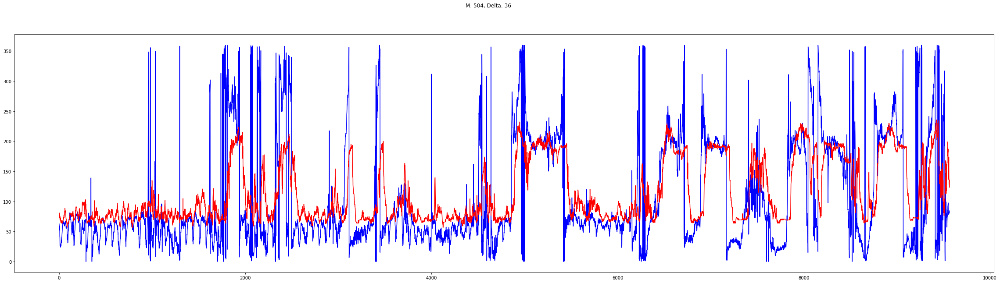

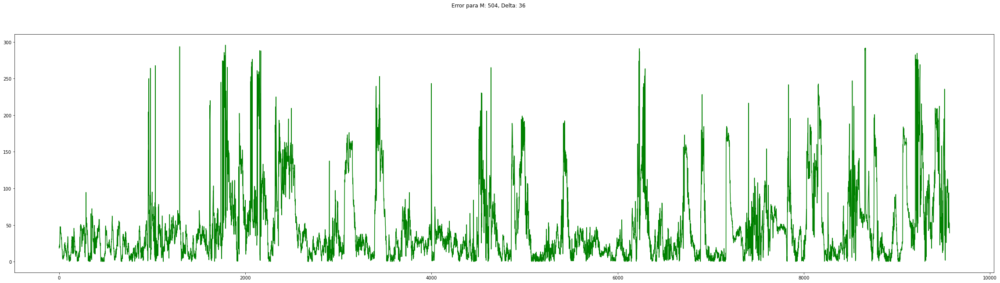

[0]	train-rmse:1.13253	eval-rmse:1.23590
[1]	train-rmse:1.13253	eval-rmse:1.23590
[2]	train-rmse:1.13253	eval-rmse:1.23590
[3]	train-rmse:1.13253	eval-rmse:1.23590
[4]	train-rmse:1.13253	eval-rmse:1.23590
[0]	train-rmse:1.10947	eval-rmse:1.20064
[1]	train-rmse:1.09043	eval-rmse:1.16999
[2]	train-rmse:1.07476	eval-rmse:1.14336
[3]	train-rmse:1.06190	eval-rmse:1.12021
[4]	train-rmse:1.05137	eval-rmse:1.10008
[5]	train-rmse:1.04276	eval-rmse:1.08256
[6]	train-rmse:1.03574	eval-rmse:1.06732
[7]	train-rmse:1.03001	eval-rmse:1.05403
[8]	train-rmse:1.02535	eval-rmse:1.04244
[9]	train-rmse:1.02155	eval-rmse:1.03232
[10]	train-rmse:1.01847	eval-rmse:1.02346
[11]	train-rmse:1.01597	eval-rmse:1.01570
[12]	train-rmse:1.01394	eval-rmse:1.00889
[13]	train-rmse:1.01229	eval-rmse:1.00291
[14]	train-rmse:1.01095	eval-rmse:0.99765
[15]	train-rmse:1.00987	eval-rmse:0.99301
[16]	train-rmse:1.00899	eval-rmse:0.98891
[17]	train-rmse:1.00827	eval-rmse:0.98530
[18]	train-rmse:1.00770	eval-rmse:0.98210
[19]	tr

[12]	train-rmse:1.00524	eval-rmse:0.95744
[13]	train-rmse:1.00523	eval-rmse:0.95691
[14]	train-rmse:1.00523	eval-rmse:0.95654
[15]	train-rmse:1.00523	eval-rmse:0.95629
[16]	train-rmse:1.00523	eval-rmse:0.95611
[17]	train-rmse:1.00523	eval-rmse:0.95598
[18]	train-rmse:1.00523	eval-rmse:0.95589
[19]	train-rmse:1.00523	eval-rmse:0.95583
[20]	train-rmse:1.00523	eval-rmse:0.95579
[21]	train-rmse:1.00523	eval-rmse:0.95576
[22]	train-rmse:1.00523	eval-rmse:0.95574
[23]	train-rmse:1.00523	eval-rmse:0.95572
[24]	train-rmse:1.00523	eval-rmse:0.95571
[25]	train-rmse:1.00523	eval-rmse:0.95571
[26]	train-rmse:1.00523	eval-rmse:0.95570
[27]	train-rmse:1.00523	eval-rmse:0.95570
[28]	train-rmse:1.00523	eval-rmse:0.95570
[29]	train-rmse:1.00523	eval-rmse:0.95569
[30]	train-rmse:1.00523	eval-rmse:0.95569
[31]	train-rmse:1.00523	eval-rmse:0.95569
[32]	train-rmse:1.00523	eval-rmse:0.95569
[33]	train-rmse:1.00523	eval-rmse:0.95569
[34]	train-rmse:1.00523	eval-rmse:0.95569
[35]	train-rmse:1.00523	eval-rmse:

[53]	train-rmse:0.89396	eval-rmse:0.81440
[54]	train-rmse:0.89363	eval-rmse:0.81405
[55]	train-rmse:0.89330	eval-rmse:0.81386
[56]	train-rmse:0.89298	eval-rmse:0.81354
[57]	train-rmse:0.89268	eval-rmse:0.81377
[58]	train-rmse:0.89238	eval-rmse:0.81327
[59]	train-rmse:0.89207	eval-rmse:0.81314
[60]	train-rmse:0.89177	eval-rmse:0.81295
[61]	train-rmse:0.89148	eval-rmse:0.81232
[62]	train-rmse:0.89119	eval-rmse:0.81269
[63]	train-rmse:0.89091	eval-rmse:0.81259
[64]	train-rmse:0.89063	eval-rmse:0.81215
[65]	train-rmse:0.89035	eval-rmse:0.81185
[66]	train-rmse:0.89007	eval-rmse:0.81185
[67]	train-rmse:0.88980	eval-rmse:0.81176
[68]	train-rmse:0.88953	eval-rmse:0.81154
[69]	train-rmse:0.88927	eval-rmse:0.81139
[70]	train-rmse:0.88900	eval-rmse:0.81162
[71]	train-rmse:0.88874	eval-rmse:0.81146
[72]	train-rmse:0.88848	eval-rmse:0.81122
[73]	train-rmse:0.88823	eval-rmse:0.81106
[74]	train-rmse:0.88798	eval-rmse:0.81145
[75]	train-rmse:0.88773	eval-rmse:0.81146
[76]	train-rmse:0.88748	eval-rmse:

[5]	train-rmse:0.90236	eval-rmse:0.82029
[6]	train-rmse:0.90014	eval-rmse:0.81892
[7]	train-rmse:0.89831	eval-rmse:0.81792
[8]	train-rmse:0.89658	eval-rmse:0.81617
[9]	train-rmse:0.89487	eval-rmse:0.81642
[10]	train-rmse:0.89321	eval-rmse:0.81610
[11]	train-rmse:0.89165	eval-rmse:0.81876
[12]	train-rmse:0.89011	eval-rmse:0.81834
[13]	train-rmse:0.88868	eval-rmse:0.81624
[14]	train-rmse:0.88752	eval-rmse:0.81533
[15]	train-rmse:0.88640	eval-rmse:0.81466
[16]	train-rmse:0.88532	eval-rmse:0.81432
[17]	train-rmse:0.88425	eval-rmse:0.81971
[18]	train-rmse:0.88323	eval-rmse:0.81965
[19]	train-rmse:0.88224	eval-rmse:0.82123
[20]	train-rmse:0.88132	eval-rmse:0.82025
[21]	train-rmse:0.88038	eval-rmse:0.82211
[0]	train-rmse:0.94503	eval-rmse:0.91091
[1]	train-rmse:0.91653	eval-rmse:0.84366
[2]	train-rmse:0.91162	eval-rmse:0.82982
[3]	train-rmse:0.90773	eval-rmse:0.82299
[4]	train-rmse:0.90424	eval-rmse:0.82124
[5]	train-rmse:0.90151	eval-rmse:0.81925
[6]	train-rmse:0.89907	eval-rmse:0.81873
[7]	

[4]	train-rmse:0.87609	eval-rmse:0.82504
[5]	train-rmse:0.87186	eval-rmse:0.82677
[6]	train-rmse:0.86801	eval-rmse:0.82543
[0]	train-rmse:0.91940	eval-rmse:0.86678
[1]	train-rmse:0.90021	eval-rmse:0.82981
[2]	train-rmse:0.88892	eval-rmse:0.81876
[3]	train-rmse:0.87962	eval-rmse:0.82588
[4]	train-rmse:0.87300	eval-rmse:0.83477
[5]	train-rmse:0.86783	eval-rmse:0.83823
[6]	train-rmse:0.86252	eval-rmse:0.84068
[7]	train-rmse:0.85715	eval-rmse:0.84437
[0]	train-rmse:0.91193	eval-rmse:0.84440
[1]	train-rmse:0.89608	eval-rmse:0.84698
[2]	train-rmse:0.88562	eval-rmse:0.84427
[3]	train-rmse:0.88030	eval-rmse:0.84625
[4]	train-rmse:0.87315	eval-rmse:0.85020
[5]	train-rmse:0.86823	eval-rmse:0.84896
[6]	train-rmse:0.86403	eval-rmse:0.85454
[0]	train-rmse:1.13253	eval-rmse:1.23590
[1]	train-rmse:1.13253	eval-rmse:1.23590
[2]	train-rmse:1.13253	eval-rmse:1.23590
[3]	train-rmse:1.13253	eval-rmse:1.23590
[4]	train-rmse:1.13253	eval-rmse:1.23590
[0]	train-rmse:1.09177	eval-rmse:1.17456
[1]	train-rmse:1

[3]	train-rmse:0.86458	eval-rmse:0.86560
[4]	train-rmse:0.84470	eval-rmse:0.84830
[5]	train-rmse:0.82930	eval-rmse:0.84344
[6]	train-rmse:0.81684	eval-rmse:0.84062
[7]	train-rmse:0.80966	eval-rmse:0.83928
[8]	train-rmse:0.80095	eval-rmse:0.84115
[9]	train-rmse:0.79021	eval-rmse:0.84301
[10]	train-rmse:0.78112	eval-rmse:0.84578
[11]	train-rmse:0.77067	eval-rmse:0.85210
[12]	train-rmse:0.76448	eval-rmse:0.85417
[0]	train-rmse:0.97640	eval-rmse:1.00646
[1]	train-rmse:0.90360	eval-rmse:0.90184
[2]	train-rmse:0.86359	eval-rmse:0.86035
[3]	train-rmse:0.83925	eval-rmse:0.84076
[4]	train-rmse:0.82281	eval-rmse:0.83642
[5]	train-rmse:0.81339	eval-rmse:0.83400
[6]	train-rmse:0.80180	eval-rmse:0.83700
[7]	train-rmse:0.78564	eval-rmse:0.84284
[8]	train-rmse:0.77543	eval-rmse:0.84620
[9]	train-rmse:0.76480	eval-rmse:0.85126
[0]	train-rmse:0.94696	eval-rmse:0.96056
[1]	train-rmse:0.87784	eval-rmse:0.87738
[2]	train-rmse:0.84587	eval-rmse:0.84693
[3]	train-rmse:0.82257	eval-rmse:0.84513
[4]	train-rms

[9]	train-rmse:0.67339	eval-rmse:0.86130
[10]	train-rmse:0.65936	eval-rmse:0.86304
[11]	train-rmse:0.64503	eval-rmse:0.86181
[12]	train-rmse:0.63012	eval-rmse:0.86295
[13]	train-rmse:0.61471	eval-rmse:0.86474
[14]	train-rmse:0.59819	eval-rmse:0.86757
[0]	train-rmse:0.97727	eval-rmse:1.06171
[1]	train-rmse:0.88049	eval-rmse:0.95904
[2]	train-rmse:0.81843	eval-rmse:0.90542
[3]	train-rmse:0.76622	eval-rmse:0.87705
[4]	train-rmse:0.72885	eval-rmse:0.86903
[5]	train-rmse:0.69979	eval-rmse:0.86174
[6]	train-rmse:0.67560	eval-rmse:0.86514
[7]	train-rmse:0.65695	eval-rmse:0.86623
[8]	train-rmse:0.62865	eval-rmse:0.86961
[9]	train-rmse:0.61426	eval-rmse:0.87394
[10]	train-rmse:0.60601	eval-rmse:0.87481
[0]	train-rmse:0.93350	eval-rmse:1.01423
[1]	train-rmse:0.83176	eval-rmse:0.91789
[2]	train-rmse:0.77002	eval-rmse:0.87871
[3]	train-rmse:0.71728	eval-rmse:0.86771
[4]	train-rmse:0.68283	eval-rmse:0.86504
[5]	train-rmse:0.64934	eval-rmse:0.86819
[6]	train-rmse:0.62912	eval-rmse:0.87288
[7]	train-

[6]	train-rmse:0.58799	eval-rmse:0.88764
[7]	train-rmse:0.54912	eval-rmse:0.88185
[8]	train-rmse:0.51567	eval-rmse:0.87818
[9]	train-rmse:0.48964	eval-rmse:0.87663
[10]	train-rmse:0.46650	eval-rmse:0.87706
[11]	train-rmse:0.44528	eval-rmse:0.87977
[12]	train-rmse:0.42534	eval-rmse:0.88067
[13]	train-rmse:0.40467	eval-rmse:0.88158
[14]	train-rmse:0.38958	eval-rmse:0.88232
[0]	train-rmse:0.93215	eval-rmse:1.06571
[1]	train-rmse:0.79642	eval-rmse:0.97341
[2]	train-rmse:0.69884	eval-rmse:0.93419
[3]	train-rmse:0.62290	eval-rmse:0.91033
[4]	train-rmse:0.56817	eval-rmse:0.90081
[5]	train-rmse:0.52078	eval-rmse:0.89962
[6]	train-rmse:0.48049	eval-rmse:0.90001
[7]	train-rmse:0.44988	eval-rmse:0.90207
[8]	train-rmse:0.42733	eval-rmse:0.90285
[9]	train-rmse:0.40235	eval-rmse:0.90477
[10]	train-rmse:0.38552	eval-rmse:0.90580
[0]	train-rmse:0.87345	eval-rmse:1.02233
[1]	train-rmse:0.72417	eval-rmse:0.93264
[2]	train-rmse:0.62180	eval-rmse:0.90771
[3]	train-rmse:0.54520	eval-rmse:0.90458
[4]	train-

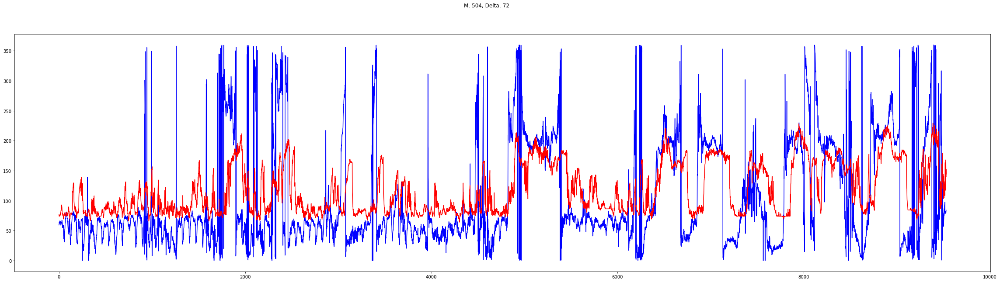

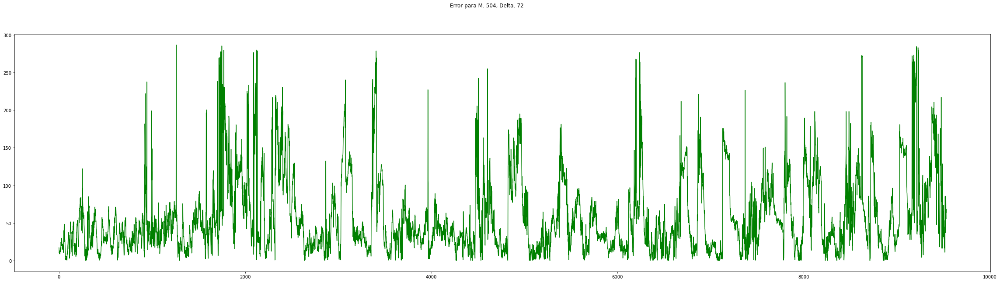

In [13]:
# Para cada parámetro, ejecutamos el código
for column in data:
    # Mostramos la gráfica con la tendencia anual de la velocidad del viento
    data.plot(y = column, kind = 'line')
    # Transformamos la columna a un array para poder tratarlo mejor
    X = data[column].to_numpy()
    # Dividimos los datos en un dataset para entrenar al algoritmo y otro para probar su rendimiento
    X_train, X_test = train_test_split(X, test_size = test_size, shuffle=False)
    # Generamos el estandarizador, usando los valores del dataset de train
    scaler = preprocessing.StandardScaler().fit(X_train.reshape(-1, 1))
    # Estandarizamos los datos de X_train
    X_train = scaler.transform(X_train.reshape(-1, 1))
    X_train = X_train[:, 0]
    # Estandarizamos los datos de X_test
    X_test = scaler.transform(X_test.reshape(-1, 1))
    X_test = X_test[:, 0]
    # Mostramos el nombre del parámetro que usaremos
    print(column)
    # Para todas las combinaciones de m y delta, se busca el mejor algoritmo
    for m in m_values:
        for delta in delta_values:
            # Damos formato a los datos de entrenamiento
            X_train_fixed, y_train_fixed = fix_parameters(X_train, m, delta)
            dtrain  = xgb.DMatrix(X_train_fixed, label=y_train_fixed)
            # Damos formato a los datos de prueba
            X_test_fixed, y_test_fixed = fix_parameters(X_test, m, delta)
            dtest = xgb.DMatrix(X_test_fixed, label=y_test_fixed)
            # Obtenemos el algoritmo optimo
            bst = find_optimal_algorithm(md_values, eta_values, dtrain, dtest)
            # Obtener las medidas de rendimiento para esta combinacion de tiempos
            print('M: ', m, ", Delta: ", delta)
            # Predecimos los resultados para mostrarlos mediante una gráfica
            pred = bst.predict(dtest, iteration_range=(0, bst.best_iteration + 1))
            # Desestandarizamos tanto los resultados reales como los predichos
            y_test_fixed = scaler.inverse_transform(y_test_fixed.reshape(-1, 1))
            y_test_fixed = y_test_fixed[:, 0]
            pred = scaler.inverse_transform(pred.reshape(-1, 1))
            pred = pred[:, 0]
            # Calculamos el RMSE y la MAE
            print('RMSE: ', rmse(y_test_fixed, pred, squared= False), ", MAE: ", mae(y_test_fixed, pred), ", R2: ", r2(y_test_fixed, pred))
            # Mostramos las gráficas de comparación y error
            print_comparative_plot(m, delta, y_test_fixed, pred)
            print_error_plot(m, delta, y_test_fixed, pred)